In [3957]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib
from sklearn.linear_model import LinearRegression
from datetime import date, timedelta
from scipy.optimize import leastsq
#from sklearn.linear_model import LinearRegression
from matplotlib.dates import DateFormatter
from scipy.stats import chisquare

#from datetime import date, timedelta
yesterday = date.today() - timedelta(days=1)
d1 = yesterday.strftime("%Y-%m-%d")
#yesterday1 = date.today() - timedelta(days=3)
d12f = lambda x:(date.today() - timedelta(days=x)).strftime("%Y-%m-%d")

countriesEU = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania",\
               "Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands",\
               "Denmark","Poland","Estonia","Portugal","Finland","Romania","France",\
               "Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
#x = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
d0 = date(2020, 3, 29)
d2 = date.today()
deltaT = d2 - d0
print(deltaT.days)
dT = deltaT.days
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
RkoreaCoeffs=[ 0.36242246,  2.56241634,  1.84890887,  0.13324732]
%matplotlib inline
expPopWorld = 2.67152730e+06
def moving_average(a, n=3) :
    ret = np.cumsum(a, dtype=float)
    ret[n:] = ret[n:] - ret[:-n]
    return ret[n - 1:] / n

def linreg(dfLT,population):
    
    dfLT['date'] = pd.to_datetime(dfLT['date'])
    yy = np.log(dfLT['cases'].values*10000./population)
    xx = np.array(range(dfLT['cases'].size)).reshape((-1, 1))
    model1 = LinearRegression().fit(xx, yy)
    r_sq1 = model1.score(xx, yy)
    return model1, r_sq1, dfLT

def plotpred(dfLT1, population, dateStart, dateEnd, filename, model1, country,level):
    
    #fig, ax = plt.subplots(figsize=(12, 12))
    plt.plot(dfLT1['date'].values,dfLT1['cases']*10000./population)
    date_form = DateFormatter("%m-%d")
    ax = plt.axes()
    ax.xaxis.set_major_formatter(date_form)
    ix1 = pd.date_range(dateStart, dateEnd, freq='D')
    ss1 = pd.DataFrame({'date': ix1},index=range(len(ix1)))
    y_pred1 = np.exp(model1.intercept_ + model1.coef_ * range(len(ix1)))
    ax.plot(ss1['date'].values,y_pred1)
    plt.xticks(rotation=90)
    plt.title(country)
    plt.ylabel('Tolat COVID-19 cases per 10000')
    ax.fill_between(ss1['date'].values, 1,level, facecolor='red', alpha=0.3)
    ax.fill_between(ss1['date'].values, yc,1, facecolor='m', alpha=0.3)
    ax.fill_between(ss1['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
    plt.xlabel('Date')
    #plt.yscale('log')
    plt.yscale('log')
    plt.grid()
    plt.savefig(filename)
    plt.show()
    ss1a = pd.DataFrame({'cases': (y_pred1*population/10000).astype(int)},index=range(len(y_pred1)))
    ss1t = pd.concat([ss1,ss1a], axis=1)
    return ss1t

def forecast(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases',pMAPE=True):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))#+coeffs[0]*.25/(1 + np.exp( - coeffs[1] * (t - 3.5*coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    if pMAPE:
        print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: logistic')
    print('coeffs: ',x)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    if cases=='cases':
        print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0)) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print(output)
    return x

def forecast2(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'bi-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: bi-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("bi-logistic approximation splitting point: %d"%(vL))
    print(output0)
    print(output)
    return x

def forecast3(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))+coeffsUS[3]/(1 + np.exp( - coeffsUS[4] * (t - coeffsUS[5])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logistic','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendS0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendS1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d.png"%(cases,Cntr,int(xcoef[0]*100)),dpi=300)
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('+3 day model MAPE:', abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)])
    print('model: tri-logistic')
    print('coeffs: ',x,coeffs2)
    if addpred:
        print("scenario coeffs: ",xcoef)
    print('forecast rational stdev: ',np.std(residualsR(x, waveform_1, t)))
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDay%s: '%(cases),int(allmodel[-1]-allmodel[-2]))  
    print('\t total %s: '%(cases),int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        print('\t total death: ', deathV,'±',int(deathV*diffStd0*3))
    print ("tri-logistic approximation splitting points: %d,%d"%(vL[0],vL[1]))
    print(output0)
    print(output1)
    print(output)
    
    return x

def trend3(dfLV,dfLT1,dfES,lLV,lLT,lES,pLV,pLT,pES):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #dfLT1 = pd.read_csv("~/Desktop/coronaLT1.csv",",")
    y = np.log(np.diff(dfLT1["cases"].values)[:]/dfLT1["cases"].values[1:]**2)
    x = np.array(range(len(dfLT1["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLT)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLT) 
    plt.plot(range(len(x)+pLT),y_pred12,label='%s tr'%(lLT))

    y = np.log(np.diff(dfES["cases"].values)[:]/dfES["cases"].values[1:]**2)
    x = np.array(range(len(dfES["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lES)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pES) 
    plt.plot(range(len(x)+pES),y_pred12,label='%s tr'%(lES))
    plt.xlabel('t, days')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s%s%s.png"%(lLV,lLT,lES))
    plt.show()
    
def trend(dfLV,lLV,pLV):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    print (x.size,y.size)
    model = LinearRegression().fit(x, y)
    r_sq = model.score(x, y)
    print('coefficient of determination:', r_sq)
    print('intercept:', model.intercept_)
    print('slope:', model.coef_)
    plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    plt.xlabel('t [days]')
    plt.ylabel('G(t)')
    plt.grid()
    plt.legend()
    plt.savefig("pictures/logdifflogcorna%s.png"%(lLV))
    plt.show()

def trendS(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendS0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend0 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x[:vL])+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL])+pLV,y_pred12, output

def trendS1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output
    
def forecastR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t, output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: Richards')
    print('coeffs: ',x)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1])) 
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print (output)
    return x

def forecast2R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] *coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])-coeffs2[0]/(1 + np.exp( - coeffs2[3] *coeffs2[1] * (tt - coeffs2[2])))**(1./coeffs2[3])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model'],loc='lower right') 
    ax2.set_xlabel('t, days')
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.set_ylim([0,max(np.diff(allmodel)*(1+3*diffStd))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s%d_R.png"%(Cntr,int(xcoef[0]*100)))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    print('model: bi-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    print('\t total death: ', deathV,'±',int(deathV*diffStd0))
    print(output)
    return x

def forecast3R(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.]):
    Cntr1 = Cntr
    waveform_1 = dfSP['cases'].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3] * coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3] * coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7] * coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2]])
    else:
        allmodel = model(tt, x)
    ax2.plot(t, waveform_1, tt, allmodel)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(waveform_1-model(tt[:len(waveform_1)], x))
    ax2.fill_between(tt, allmodel-6*diffStd0*np.ones(len(tt)),allmodel+6*diffStd0*np.ones(len(tt)), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'model']) 
    ax2.set_xlabel('t, days')
    ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(np.diff(waveform_1)-np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)-3*diffStd*np.ones(len(tt)-1), np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1), alpha=0.2)
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of invected dayly')
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendS(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t [days]')
    ax5.set_ylabel('G(t)')
    ax5.grid()
    plt.savefig("pictures/covid%s_R.png"%(Cntr))
    plt.show()
    print(Cntr,'data at: %s'%(date))
    print('data correction for delay:', shift)
    rint('model: tri-Richards')
    print('coeffs: ',x,coeffs2)
    print("scenario coeffs: ",xcoef)
    print('forecast stdev: ',np.std(residuals(x, waveform_1, t)))
    print('forecast at the end of period: +%d days'%(period))
    print('\t deltaDayInfected: ',int(allmodel[-1]-allmodel[-2]))  
    print('\t total infected: ',int(allmodel[-1]))
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    print('\t total death: ', int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0]))
    print(output)
    return x

def get_cases(df,threshold):    
    dfA = df[df[['Country','TotCasesper1Mpop']].TotCasesper1Mpop>=threshold]
    #y = df[df['Country','TotCasesper1Mpop'].TotCasesper1Mpop>=56.]
    dfA = dfA.sort_values(by=['TotCasesper1Mpop'], ascending=False)
    country = dfA['Country']
    #country = country.tolist()
    cases = dfA['TotCasesper1Mpop']/100
    #case = cases.tolist()
    return country, cases

def stat_picture(country, cases, high=35, picname="pictures/coronage0.png"):
# Import the necessary packages and modules


    # Prepare the data
    #x = dfA['Country']
    fig = plt.figure( figsize=(6, high))
    fig.subplots_adjust(bottom=0.2, left=0.1)
    # Plot the data
    y_pos = cases
    #barh(y_pos, performance, xerr=error, align='center')
    plt.barh(country,y_pos)
    #plt.xticks(rotation=90)
    plt.xlabel('COVID-19 cases per 10000')
    # Add a legend
    plt.legend()
    ax = plt.axes() 
    x = range(len(country))
    ax.fill_betweenx(x, 1,1000, facecolor='red', alpha=0.3)
    yc = 0.56
    ax.fill_betweenx(x, yc,1, facecolor='m', alpha=0.3)
    ax.fill_betweenx(x, 1e-4,yc, facecolor='y', alpha=0.3)
    plt.vlines(yc, 0, len(country)-1, colors='g', linestyles='solid')
    #plt.ylim([1e-2,60])
    ax.xaxis.grid() # horizontal lines
    #ax.xaxis.grid() # vertical lines

    ax.set_yticks(range(len(country)))
    ax.set_yticklabels(country)
    #ax.invert_yaxis()
    plt.xscale("log")
    # Show the plot

    plt.savefig(picname, bbox_inches='tight')
    plt.show()
    
def read_df(dfRM,lRM):
    dfRM = pd.read_csv("data/corona%s.csv"%(lRM),",")
    dfRM['date'] = pd.to_datetime(dfRM['date'])
    print("%s\n"%(lRM),dfRM.tail())
    return dfRM

127


In [3958]:
from sklearn.linear_model import Ridge
from sklearn.preprocessing import PolynomialFeatures
from sklearn.pipeline import make_pipeline

def forecastRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    locStr = 'upper left'
    if Cntr in ['New Zealand']:
        locStr = 'lower right'
    ax2.legend(['COVID-19 %s'%(Cntr), 'Richards','-3days'],loc=locStr) 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecastRRR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]) )))#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2RRR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * ((t- coeffsUS[2])*(t- coeffsUS[3]))))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * ((t- coeffs[2])*(t- coeffs[3]))))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    24.31714688, 0.00530186**2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RRR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))+coeffsUS[4]/(1 + np.exp( - coeffsUS[5] * (t - coeffsUS[6])* (t - coeffsUS[7])))
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.01 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-logisticQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    #ax3.set_ylim([0,max(np.diff(allmodel)+3*diffStd*np.ones(len(tt)-1))*1.2])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP,vL[1])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSQ0(dfSP,vL[0])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSQ1(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_Q.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_Q.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-logisticQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def trendSQ(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL:], y[vL:]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSQ0(dfLV,vL=0,pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL:], y[vL:])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[:vL], y[:vL]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL, np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL]),y_pred12, output

def trendSQ1(dfLV,vL=[0,3],pLV=5):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    #model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    degree = 2
    model = make_pipeline(PolynomialFeatures(degree), Ridge())
    model.fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]]) 
    x_plot =  np.linspace(0, len(x)+pLV-1, len(x)+pLV)
    X_plot = x_plot[:vL[1], np.newaxis]
    y_pred12 = model.predict(X_plot)
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend1 coefficient of determination: %f\n intercept_: %s\n coeffs_: %s'%(r_sq, model.steps[1][1].intercept_,model.steps[1][1].coef_)
    #plt.plot(x,y,label=lLV)
    #y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x[:vL[1]]),y_pred12, output

def trendSS(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL:], y[vL:])
    r_sq = model.score(x[vL:], y[vL:])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS0(dfLV,vL=0,pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[:vL], y[:vL])
    r_sq = model.score(x[:vL], y[:vL])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

def trendSS1(dfLV,vL=[0,1],pLV=5,nu=1.):
    #dfLV = pd.read_csv("~/Desktop/coronaLV.csv",",")
    y = np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**(1.+nu))
    x = np.array(range(len(dfLV["cases"].values)-1)).reshape((-1, 1))
    #print (x.size,y.size)
    model = LinearRegression().fit(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    r_sq = model.score(x[vL[0]:vL[1]], y[vL[0]:vL[1]])
    output = 'trend coefficient of determination: %f\n intercept: %f\n slope: %f'%(r_sq, model.intercept_,model.coef_)
    #plt.plot(x,y,label=lLV)
    y_pred12 = model.intercept_ + model.coef_ * range(len(x)+pLV) 
    #plt.plot(range(len(x)+pLV),y_pred12,label='%s tr'%(lLV))

    #plt.xlabel('t [days]')
    #plt.ylabel('G(t)')
    #plt.grid()
    #plt.legend()
    #plt.savefig("logdifflogcorna%s.png"%(lLV))
    #plt.show()
    return x,y,len(x)+pLV,y_pred12, output

In [3959]:
def forecastQR(Cntr,dfSP,date,period, shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #ax1.set_yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)
    def model(t, coeffs):
        #coeffsUS=[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[1] * coeffs[4] * ((t- coeffs[2])**0.5*(t- coeffs[3])**0.5 )))**(1./coeffs[4])#+coeffsUS[0]/(1 + np.exp( - coeffsUS[1] * (t - coeffsUS[2])))
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3],xcoef[4]*x[4]])
        allmodel_1 = model(tt, x_1) + model(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3],xcoef[4]*x_1[4]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1) 
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1) 
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=0)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=0)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'RichardsQ','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_yscale('log')
    plt.yscale("linear")
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    #print(diffStd)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    ax4.set_xlabel('t, days')
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSQ(dfSP)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_QR.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_QR.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: RichardsQ' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x


def forecast2RR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    if Cntr=="UAE":
        Cntr1='United Arab Emirates'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, 0.9], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL,nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-Richards approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast3RR(Cntr,dfSP,date,period, coeffs2, shift=1.,addpred=False,xcoef=[1.,1.,1.,1],vL=[0,3],cases='cases',zoom=1.):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])+coeffsUS[0]/(1 + np.exp( - coeffsUS[3]*coeffsUS[1] * (t - coeffsUS[2])))**(1./coeffsUS[3])+coeffsUS[4]/(1 + np.exp( - coeffsUS[7]*coeffsUS[5] * (t - coeffsUS[6])))**(1./coeffsUS[7])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop/4,  2.61212092e+01, -9.65961409e-01,  5.96529356e-03], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel, tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=2)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['COVID-19 %s'%(Cntr), 'tri-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel+6*diffStd0*np.ones(len(tt)))*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1), tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,1.1*max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    ax3.grid()
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    if zoom != 1.:
        ax3.set_ylim([0,zoom])
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL[1],nu=x[3])
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL[0],nu=x[3])
    xt1,yt1,x_pred12t1,y_pred12t1,output1 = trendSS1(dfSP,vL,nu=x[3])
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.plot(range(x_pred12t1),y_pred12t1,label='%s tr1'%(Cntr1))
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.axvline(vL[0], color="red", linestyle="--")
    ax5.axvline(vL[1], color="red", linestyle="--")
    ax5.set_xlabel('t days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: tri-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "tri-logisticQ approximation splitting points: %d,%d"%(vL[0],vL[1])
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output1)
    ff.write(output1.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

def forecast2QR(Cntr,dfSP,date,period, coeffs2,shift=1.,addpred=False,xcoef=[1.,1.,1.,1.,1.],vL=10,cases='cases'):
    Cntr1 = Cntr
    waveform_1 = dfSP[cases].values*shift
    t = np.arange(-8,len(waveform_1)-8)
    fig, ((ax3, ax2), (ax5, ax4)) = plt.subplots(2, 2,figsize=(8,8), sharex=False, sharey=False)
    #ax1.plot(t, waveform_1) 
    #plt.yscale("log")
    #ax1.set_xlabel('t, days')
    #ax1.set_ylabel('total infected')
    #ax1.grid()
    #plt.show()
    sign = lambda a: a/abs(a)   
    def model(t, coeffs):
        coeffsUS=coeffs2#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])+coeffsUS[0]/(1 + np.exp( - coeffsUS[4]*coeffsUS[1] * (t - coeffsUS[2])* (t - coeffsUS[3])))**(1./coeffsUS[4])
    def model0(t, coeffs):
        #coeffsUS=coeffs#[1.33362427e+05, 3.63186065e-01, 1.59695379e+01]
        return  coeffs[0]/(1 + np.exp( - coeffs[4]*coeffs[1] * (t - coeffs[2])* (t - coeffs[3])))**(1./coeffs[4])
    if Cntr=='USA':
        Cntr1='United States'
    expPop = dfp[dfp['Country (or dependency)']==Cntr1].Population.tolist()[0]*expPopWorld/np.sum(dfp['Population'].values)
    x0 = np.array([expPop, 0.23,    6.31714688, -0.0001, 5.0e-2 ], dtype=float)
    def residuals(coeffs, y, t):
        return y - model(t, coeffs)
    def residualsR(coeffs, y, t):
        return 1 - y/model(t, coeffs)
    #from scipy.optimize import leastsq
    x, flag = leastsq(residuals, x0, args=(waveform_1, t))
    x_1, flag_1 = leastsq(residuals, x0, args=(waveform_1[:-3], t[:-3]))
    #period = +17+14
    tt = np.arange(-8,len(waveform_1)-8+period)
    if addpred==True:
        allmodel = model(tt, x) + model0(tt, [xcoef[0]*x[0],xcoef[1]*x[1],xcoef[2]*x[2],xcoef[3]*x[3]])#-coeffs2[0]/(1 + np.exp( - coeffs2[1] * (tt - coeffs2[2])))
        allmodel_1 = model(tt, x_1) + model0(tt, [xcoef[0]*x_1[0],xcoef[1]*x_1[1],xcoef[2]*x_1[2],xcoef[3]*x_1[3]])
    else:
        allmodel = model(tt, x)
        allmodel_1 = model(tt, x_1)
    ax2.plot(t, waveform_1, tt, allmodel,tt, allmodel_1)
    ax2.plot(t[-1],waveform_1[-1],'ro') 
    diffStd0 = np.std(1-waveform_1/model(tt[:len(waveform_1)], x))
    #chisqtot = chisquare(waveform_1, f_exp=model(tt[:len(waveform_1)], x),ddof=1)
    #chisqdiff = chisquare(np.diff(waveform_1), f_exp=np.diff(model(tt[:len(waveform_1)], x)),ddof=1)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+2*diffStd0), alpha=0.2)
    ax2.fill_between(tt, allmodel*(1-diffStd0), allmodel*(1+3*diffStd0), alpha=0.2)
    ax2.legend(['%s'%(Cntr), 'bi-Richards','-3days'],loc='upper left') 
    ax2.set_xlabel('t, days')
    ax2.set_ylabel('Total %s'%(cases))
    ax2.yaxis.tick_right()
    ax2.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #ax2.set_ylim([0,max(allmodel*(1+diffStd0)*1.2])
    #ax2.set_yscale('log')
    plt.yscale("linear")
    ax2.grid()
    ax3.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(allmodel))
    ax3.plot(t[-1], np.diff(waveform_1)[-1],'ro')
    diffStd = np.std(1-np.diff(waveform_1)/np.diff(model(tt[:len(waveform_1)], x)))
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-diffStd), np.diff(allmodel)*(1+diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+2*diffStd), alpha=0.2)
    ax3.fill_between(tt[:-1], np.diff(allmodel)*(1-2*diffStd), np.diff(allmodel)*(1+3*diffStd), alpha=0.2)
    ax3.set_ylim([0,max(max(np.diff(waveform_1)),max(np.diff(allmodel)*(1+3*diffStd)))])
    #ax3.set_yscale("log")
    #ax3.set_xscale("log")
    ax3.legend([r'$\Delta$ %s'%(Cntr), 'model']) 
    ax3.grid()
    ax3.set_xlabel('t, days')
    ax3.set_ylabel(r'$\Delta$ of %s dayly'%(cases))
    ax3.ticklabel_format(style='sci', axis='y', scilimits=(0,0))
    #if Cntr in ['South Korea','China','USA','United Kingdom','World']:
    waveform_A = dfSP['active'].values*shift
    z = np.diff(moving_average(waveform_A, n=3))/np.diff(moving_average(waveform_1, n=3))
    ax4.plot(t[:-3],z)
    #ax4.axhline(y=2.2587741081036339/2, color='r')
    ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
    #ax4.set_yscale("log")
    if cases=='death':
        ax4.set_ylabel('1/S(t)')
    ax4.set_ylabel('S(t)')
    ax4.set_xlabel('t, days')
    ax4.yaxis.tick_right()
    ax4.grid()
    xt,yt,x_pred12t,y_pred12t,output = trendSS(dfSP,vL)
    xt0,yt0,x_pred12t0,y_pred12t0,output0 = trendSS0(dfSP,vL)
    ax5.plot(xt,yt,label=Cntr1)
    ax5.plot(range(x_pred12t),y_pred12t,label='%s tr'%(Cntr1))
    ax5.plot(range(x_pred12t0),y_pred12t0,label='%s tr0'%(Cntr1))
    ax5.axvline(vL, color="red", linestyle="--")
    ax5.set_xlabel('t, days')
    ax5.set_ylabel('G(t)')
    ax5.legend()
    ax5.grid()
    plt.savefig("pictures/covid%s%s%d_R.png"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),dpi=300)
    plt.show()
    ff = open("_includes/covid%s%s%d_R.txt"%(cases,Cntr.replace(" ", "_"),int(xcoef[0]*100)),'w')
    prnStr = '%s data at: %s'%(Cntr,date) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = '+3 day model MAPE: %f'%(abs(allmodel[len(t+2)]-allmodel_1[len(t+2)])/allmodel_1[len(t+2)]) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'model: bi-Richards' 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    prnStr = 'coeffs: %s'%(x) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if addpred:
        prnStr = "S.Korea scenario coeffs: %s"%(xcoef) 
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = 'rational stdev: %f'%(np.std(residualsR(x, waveform_1, t))) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    #print('chisq %s: (%s%e,%s%e)'%(cases,'statistic=',chisqtot[0],'p-value=',chisqtot[1]))
    #print('chisq cases delta: (%s,%e,%s,%e)'%('statistic=',chisqdiff[0],'p-value=',chisqdiff[1]))
    prnStr = 'forecast at the end of period: +%d days'%(period) 
    print(prnStr)
    ff.write(prnStr+'<br />\n')
    if cases=='cases':
        prnStr = '\t deltaDay%s: %d'%(cases,int(allmodel[-1]-allmodel[-2])) 
        print(prnStr)  
        ff.write(prnStr+'<br />\n')
    prnStr = '\t total %s: %d %s %d'%(cases,int(allmodel[-1]),'±',int(allmodel[-1]*diffStd0))
    print(prnStr) 
    ff.write(prnStr+'<br />\n')
    if Cntr=='South Korea':
        Cntr='S. Korea'
    if Cntr=='United Kingdom':
        Cntr='UK'
    
    deathV = int(allmodel[-1]*dfTT[dfTT.Country=='%s'%(Cntr)][0].values[0])
    if cases=='cases':
        prnStr = '\t total death: %d %s %d'%(deathV,'±',int(deathV*diffStd0*3))
        print(prnStr)
        ff.write(prnStr+'<br />\n')
    prnStr = "bi-logisticQ approximation splitting point: %d"%(vL) 
    print (prnStr)
    ff.write(prnStr+'<br />\n')
    print(output0)
    ff.write(output0.replace("\n", " <br />\n")+'<br />')
    print(output)
    ff.write(output.replace("\n", " <br />\n")+'<br />')
    ff.close()
    return x

In [3979]:
dfp = pd.read_csv("data/population.csv",",")
#dfp[dfp['Country (or dependency)']=='China'].Population.tolist()[0]
dfp.head()

,Country (or dependency),Population,Yearly\nChange,Net\nChange,Density\n(P/Km²),Land Area\n(Km²),Migrants\n(net),Fert.\nRate,Med.\nAge,Urban\nPop %,World\nShare
0,World,7774108745,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,European Union,445250514,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,China,1439323776,0.39 %,5540090.0,153.0,9388211.0,-348399.0,1.7,38,61 %,18.47 %
3,India,1380004385,0.99 %,13586631.0,464.0,2973190.0,-532687.0,2.2,28,35 %,17.70 %
4,United States,331002651,0.59 %,1937734.0,36.0,9147420.0,954806.0,1.8,38,83 %,4.25 %


In [3980]:
popEU = sum(dfp[dfp["Country (or dependency)"].isin(countriesEU) ].Population)

In [3981]:
#df = pd.read_csv("~/Desktop/coronaAllT.csv","\t")
df = pd.read_csv("data/coronaAll_%s.csv"%(d1),",")
dfAll = df#pd.read_csv("~/Desktop/coronaAll_2020-03-28.csv",",")

In [3982]:
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,961453,65.0,20350.0,NaN,615476.0,132,325627,1150.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [3983]:
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
225,NaN,Total:,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,NaN,Europe,,NaN,NaN
226,NaN,Total:,961453,65.0,20350.0,NaN,615476.0,NaN,325627,1150.0,NaN,NaN,NaN,NaN,NaN,Africa,,NaN,NaN
227,NaN,Total:,20106,397.0,246.0,13.0,12276.0,202,7584,43.0,NaN,NaN,NaN,NaN,NaN,Australia/Oceania,,NaN,NaN
228,NaN,Total:,721,NaN,15.0,NaN,651.0,NaN,55,4.0,NaN,NaN,NaN,NaN,NaN,NaN,,NaN,NaN
229,NaN,European Union,1470739,480.0,136329.0,0.0,696586.0,NaN,207039,2072.0,3303.171931,306.184936,40829983.0,91701.147368,NaN,Europe,NaN,NaN,NaN


In [3984]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,NaN,North America,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,NaN,NaN,NaN,NaN,NaN,North America,\n,NaN,NaN
1,NaN,South America,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,NaN,NaN,NaN,NaN,NaN,South America,\n,NaN,NaN
2,NaN,Asia,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,NaN,NaN,NaN,NaN,NaN,Asia,\n,NaN,NaN
3,NaN,Europe,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,NaN,Europe,\n,NaN,NaN
4,NaN,Africa,961453,65.0,20350.0,NaN,615476.0,132,325627,1150.0,NaN,NaN,NaN,NaN,NaN,Africa,\n,NaN,NaN


In [3985]:
dfAll.fillna(0, inplace=True)
dfAll[dfAll["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
129,123.0,Lithuania,2120,10.0,80.0,0.0,1645.0,1,395,6.0,780.0,29.0,527729.0,194123.0,"2,718,533",Europe,"1,282","33,982",5


No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


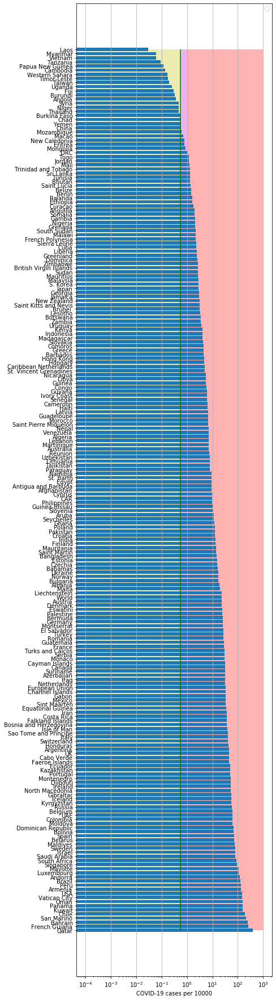

In [3986]:
country, cases = get_cases(df,0.01)
country.values, cases.values
stat_picture(country.values, cases.values, high=35, picname="pictures/coronage0.png")

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:815: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


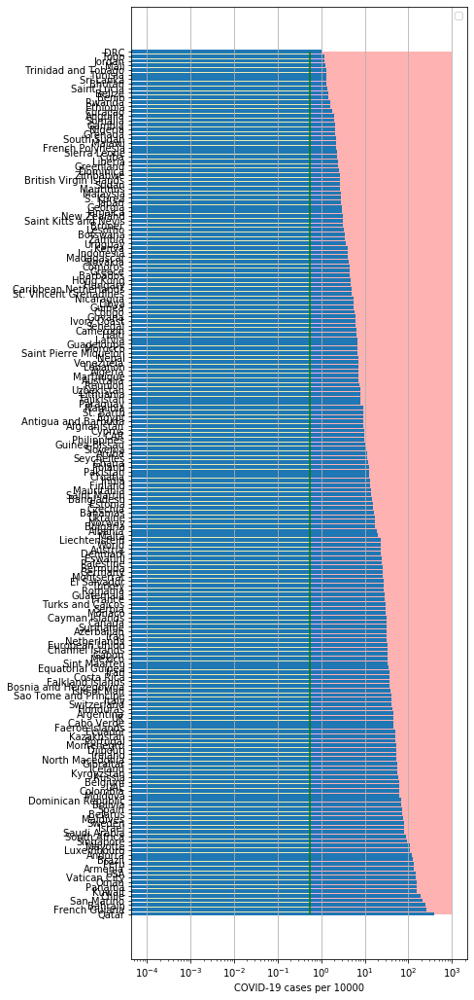

In [3987]:
country, cases = get_cases(df,100.0)
stat_picture(country.values, cases.values, high=20, picname="pictures/coronage1.png")

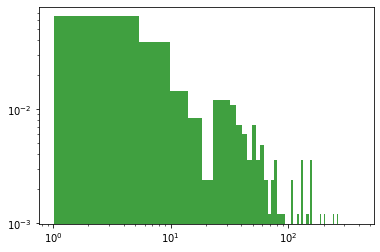

In [3988]:
n, bins, patches = plt.hist(cases, 90, density=True,facecolor='g', alpha=0.75)
plt.yscale("log")
plt.xscale("log")

In [3989]:
dfSP = read_df(pd.DataFrame(),"SP")
dfGB = read_df(pd.DataFrame(),"GB")
dfIT = read_df(pd.DataFrame(),"IT")
dfLT = read_df(pd.DataFrame(),"LT")
dfUkr = read_df(pd.DataFrame(),"Ukr")
dfUS = read_df(pd.DataFrame(),"US")
dfCN = read_df(pd.DataFrame(),"CN")
dfFR = read_df(pd.DataFrame(),"FR")
dfKR = read_df(pd.DataFrame(),"KR")
dfW = read_df(pd.DataFrame(),"World")
dfDK = read_df(pd.DataFrame(),"DK")
dfNG = read_df(pd.DataFrame(),"NG")
dfGR = read_df(pd.DataFrame(),"GR")
dfES = read_df(pd.DataFrame(),"ES")
dfSW = read_df(pd.DataFrame(),"SW")
dfPL = read_df(pd.DataFrame(),"PL")
dfIS = read_df(pd.DataFrame(),"IS")
dfUR = read_df(pd.DataFrame(),"Ukr")
dfSZ = read_df(pd.DataFrame(),"SZ")
dfIN = read_df(pd.DataFrame(),"IN")
#dfKRA = read_df(pd.DataFrame(),"KRA")
dfRS = read_df(pd.DataFrame(),"RS")
dfJP = read_df(pd.DataFrame(),"JP")
dfNL = read_df(pd.DataFrame(),"NL")
dfAT = read_df(pd.DataFrame(),"AT")
dfBG = read_df(pd.DataFrame(),"BG")
dfSG = read_df(pd.DataFrame(),"SG")
dfLV = read_df(pd.DataFrame(),"LV")
dfCA = read_df(pd.DataFrame(),"CA")
dfPT = read_df(pd.DataFrame(),"PT")
dfTR = read_df(pd.DataFrame(),"TR")
dfBZ = read_df(pd.DataFrame(),"BZ")
dfAS = read_df(pd.DataFrame(),"AS")
dfML = read_df(pd.DataFrame(),"ML")
dfZL = read_df(pd.DataFrame(),"ZL")
dfBR = read_df(pd.DataFrame(),"BR")
dfIR = read_df(pd.DataFrame(),"IR")
dfCL = read_df(pd.DataFrame(),"CL")
dfCH = read_df(pd.DataFrame(),"CH")
dfRM = read_df(pd.DataFrame(),"RM")
dfFI = read_df(pd.DataFrame(),"FI")
dfID = read_df(pd.DataFrame(),"ID")
dfED = read_df(pd.DataFrame(),"ED")
dfPH = read_df(pd.DataFrame(),"PH")
#dfPK = read_df(pd.DataFrame(),"PK")
dfLX = read_df(pd.DataFrame(),"LX")
dfTH = read_df(pd.DataFrame(),"TH")
dfIE = read_df(pd.DataFrame(),"IE")
dfMX = read_df(pd.DataFrame(),"MX")
dfPM = read_df(pd.DataFrame(),"PM")
dfPU = read_df(pd.DataFrame(),"PU")
dfSB = read_df(pd.DataFrame(),"SB")
dfAG = read_df(pd.DataFrame(),"AG")
dfCT = read_df(pd.DataFrame(),"CT")
dfEG = read_df(pd.DataFrame(),"EG")
dfSV = read_df(pd.DataFrame(),"SV")
dfMR = read_df(pd.DataFrame(),"MR")
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIC = read_df(pd.DataFrame(),"IC")
dfQR = read_df(pd.DataFrame(),"QR")
dfCB = read_df(pd.DataFrame(),"CB")
dfBL = read_df(pd.DataFrame(),"BL")
dfAG = read_df(pd.DataFrame(),"AR")
dfEU = read_df(pd.DataFrame(),"EU")
dfMT = read_df(pd.DataFrame(),"MT")
dfCP = read_df(pd.DataFrame(),"CP")

SP
           date   cases  active    death
155 2020-07-29  329721       0  28441.0
156 2020-07-30  332510       0  28443.0
157 2020-07-31  335602       0  28445.0
158 2020-08-01  335602       0  28445.0
159 2020-08-02  335602       0  28445.0
GB
           date   cases  active    death
154 2020-07-29  301455       0  45961.0
155 2020-07-30  302301       0  45999.0
156 2020-07-31  303181       0  46119.0
157 2020-08-01  303952       0  46193.0
158 2020-08-02  304695       0  46201.0
IT
           date   cases  active    death
157 2020-07-29  246776   12616  35129.0
158 2020-07-30  247158   12230  35132.0
159 2020-07-31  247537   12422  35141.0
160 2020-08-01  247832   12457  35146.0
161 2020-08-02  248070   12456  35154.0
LT
           date   cases  active  death     tests
142 2020-07-29  2062.0     339   80.0  515662.0
143 2020-07-30  2075.0     351   80.0  519929.0
144 2020-07-31  2093.0     369   80.0  524483.0
145 2020-08-01  2110.0     386   80.0       NaN
146 2020-08-02  2120.0  

156 2020-08-02  1567.0      27   22.0
BR
           date    cases  active  death
152 2020-07-29  67518.0    5528  548.0
153 2020-07-30  67665.0    5347  553.0
154 2020-07-31  67808.0    4805  559.0
155 2020-08-01  67946.0    4697  563.0
156 2020-08-02  68067.0    4604  567.0
IR
           date    cases  active   death
151 2020-07-29  25942.0     814  1764.0
152 2020-07-30  26027.0     900  1763.0
153 2020-07-31  26065.0     938  1763.0
154 2020-08-01  26109.0     982  1763.0
155 2020-08-02  26162.0    1035  1763.0
CL
           date   cases  active   death
148 2020-07-29  351575   17740  9278.0
149 2020-07-30  353536   17531  9377.0
150 2020-07-31  355667   17883  9457.0
151 2020-08-01  357658   17618  9533.0
152 2020-08-02  359731   17712  9608.0
CH
           date    cases  active  death
150 2020-07-29  16093.0    4286  378.0
151 2020-07-30  16371.0    4510  379.0
152 2020-07-31  16574.0    4623  382.0
153 2020-08-01  16699.0    4729  383.0
154 2020-08-02  16800.0    4811  384.0
RM
 

In [3990]:
dfBL = dfBL.fillna(0)
dfRM = dfRM.fillna(0)
dfSV = dfSV.fillna(0)
dfCT = dfCT.fillna(0)
#dfAR = dfAR.fillna(0)
dfSB = dfSB.fillna(0)
dfCP = dfCP.fillna(0)
dfID = dfID.fillna(0)
dfAG = dfAG.fillna(0)
dfMX = dfMX.fillna(0)
dfPU = dfPU.fillna(0)
dfIQ = dfIQ.fillna(0)
dfIE = dfIE.fillna(0)
dfPH = dfPH.fillna(0)
dfTH = dfTH.fillna(0)
dfMR = dfMR.fillna(0)
dfCP = dfCP.fillna(0)

In [3991]:
from sklearn.linear_model import LinearRegression
populationSp = dfp[dfp['Country (or dependency)']=='Spain'].Population.tolist()[0]
y = np.log(dfSP['cases'].values*10000./populationSp)
x = np.array(range(dfSP['cases'].size)).reshape((-1, 1))
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)


coefficient of determination: 0.4959987556106662
intercept: 0.1342332007835365
slope: [0.03575511]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:6: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  


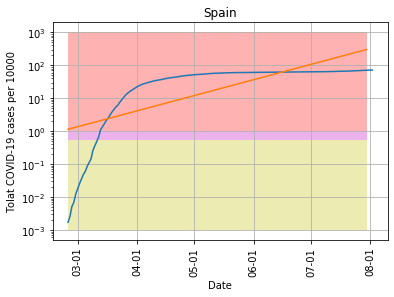

In [3992]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
yc = 0.56
plt.plot(dfSP['date'].values,dfSP['cases']*10000./populationSp)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix = pd.date_range('2020-02-25', '2020-07-30', freq='D')
ss = pd.DataFrame({'date': ix})
y_pred = np.exp(model.intercept_ + model.coef_ * range(len(ix)))
ax.plot(ss['date'].values,y_pred)
plt.xticks(rotation=90)
plt.title('Spain')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss['date'].values, 1e-3,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaSP.png")
plt.show()

In [3993]:
populationUK = dfp[dfp['Country (or dependency)']=='United Kingdom'].Population.tolist()[0]
model1, r_sql, dfGB1 = linreg(dfGB,populationUK)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.6268258051631919
intercept: -1.4401289488528466
slope: [0.04501452]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


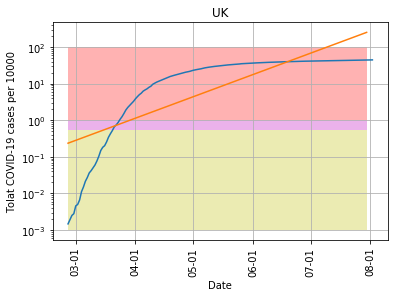

In [3994]:
ss1t = plotpred(dfGB1,populationUK,'2020-02-26', '2020-07-30', "pictures/coronaGB.png", model1, 'UK',100)

In [3995]:
populationIT = dfp[dfp['Country (or dependency)']=='Italy'].Population.tolist()[0]
coefIT = 4.0378751-0.3
yy1 = np.log(coefIT-np.log(dfIT['cases'].values*10000./populationIT))
xx1 = np.array(range(dfIT['cases'].size)).reshape((-1, 1))
model11 = LinearRegression().fit(xx1, yy1)
r_sq1 = model11.score(xx1, yy1)
print('coefficient of determination:', r_sq1)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.9393298119194314
intercept: 1.2008281323571803
slope: [-0.03339194]


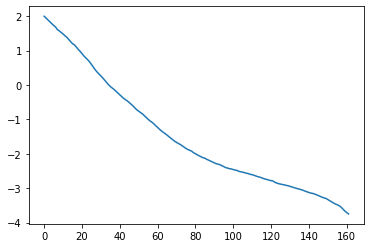

In [3996]:
plt.plot(xx1,yy1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:5: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  """


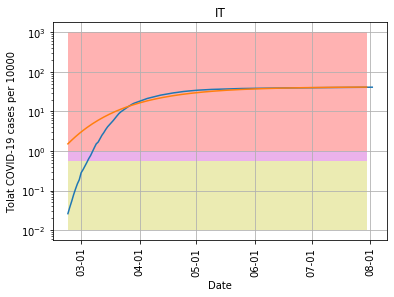

In [3997]:
from matplotlib.dates import DateFormatter
#fig, ax = plt.subplots(figsize=(12, 12))
plt.plot(dfIT['date'].values,dfIT['cases']*10000./populationIT)
date_form = DateFormatter("%m-%d")
ax = plt.axes()
ax.xaxis.set_major_formatter(date_form)
ix11 = pd.date_range('2020-02-23', '2020-07-30', freq='D')
ss11 = pd.DataFrame({'date': ix11})
y_pred11 = np.exp(coefIT-np.exp(model11.intercept_ + model11.coef_ * range(len(ix11))))
ax.plot(ss11['date'].values,y_pred11)
plt.xticks(rotation=90)
plt.title('IT')
plt.ylabel('Tolat COVID-19 cases per 10000')
ax.fill_between(ss11['date'].values, 1,1000, facecolor='red', alpha=0.3)
ax.fill_between(ss11['date'].values, yc,1, facecolor='m', alpha=0.3)
ax.fill_between(ss11['date'].values, 1e-2,yc, facecolor='y', alpha=0.3)
plt.xlabel('Date')
plt.yscale('log')
#plt.yscale('log')
plt.grid()
plt.savefig("pictures/coronaIT.png")
plt.show()

In [3998]:
cs=y_pred11[-1]/10000.*populationIT

In [3999]:
cs

249712.84963313863

In [4000]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
model1, r_sql, dfLT1 = linreg(dfLT[1:],populationLT)
print('coefficient of determination:', r_sql)
print('intercept:', model1.intercept_)
print('slope:', model1.coef_)

coefficient of determination: 0.44512093373122724
intercept: -0.43868873348037773
slope: [0.02289886]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:39: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


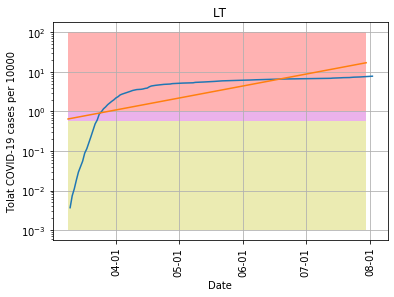

In [4001]:
populationLT = dfp[dfp['Country (or dependency)']=='Lithuania'].Population.tolist()[0]
ss1t = plotpred(dfLT[1:],populationLT,'2020-03-09', '2020-07-30', "pictures/coronaLT.png", model1, 'LT',100)

In [4002]:
populationUKr = dfp[dfp['Country (or dependency)']=='Ukraine'].Population.tolist()[0]
model11, r_sql, dfUkr1 = linreg(dfUkr, populationUKr)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.7187627428008871
intercept: -3.286621989247352
slope: [0.05234167]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


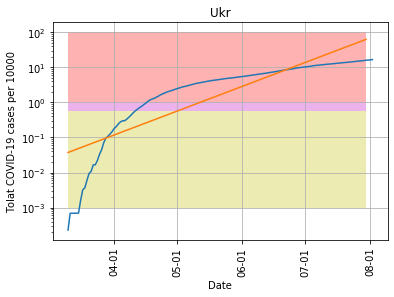

In [4003]:
ss1t1 = plotpred(dfUkr1,populationUKr,'2020-03-10', '2020-07-30', "pictures/coronaUkr.png", model11, 'Ukr',100)

No handles with labels found to put in legend.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:16: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.
  app.launch_new_instance()


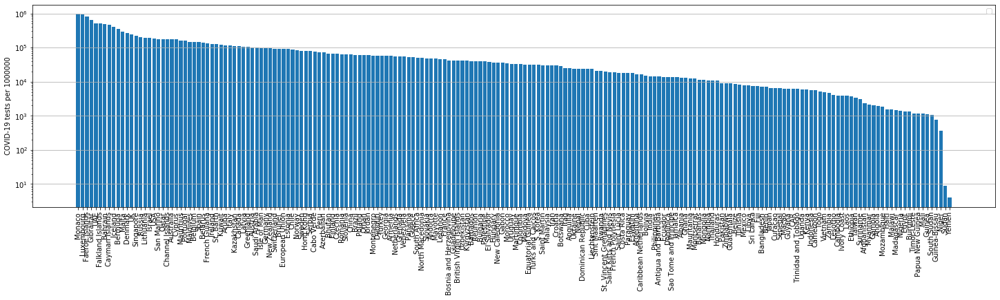

In [4004]:
# Prepare the data
dfTs = dfAll
dfTs = dfTs.sort_values(by=['Testsper1Mpop'], ascending=False)
dfTs = dfTs[dfTs['Testsper1Mpop']>0]
x = dfTs['Country']
y = dfTs['Testsper1Mpop']
fig = plt.figure( figsize=(25, 6))
fig.subplots_adjust(bottom=0.2)
# Plot the data
plt.bar(x, y)

plt.xticks(rotation=90)
plt.ylabel('COVID-19 tests per 1000000')
# Add a legend
plt.legend()
ax = plt.axes() 
#ax.fill_between(x, 1,10, facecolor='red', alpha=0.3)
yc = 0.56
#ax.fill_between(x, yc,1, facecolor='m', alpha=0.3)
#ax.fill_between(x, 1e-4,yc, facecolor='y', alpha=0.3)
#plt.hlines(yc, 0, len(df)-1, colors='g', linestyles='solid')
#plt.ylim([1e-4,10])
ax.yaxis.grid() # horizontal lines
#ax.xaxis.grid() # vertical lines
plt.yscale("log")
# Show the plot
plt.savefig("pictures/coronaTests.png")
plt.show()

In [4005]:
populationUS= dfp[dfp['Country (or dependency)']=='United States'].Population.tolist()[0]
model11, r_sql, dfUS1 = linreg(dfUS, populationUS)
print('coefficient of determination:', r_sql)
print('intercept:', model11.intercept_)
print('slope:', model11.coef_)

coefficient of determination: 0.6558212609740139
intercept: -0.9332757686863844
slope: [0.04805128]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:51: MatplotlibDeprecationWarning: Adding an axes using the same arguments as a previous axes currently reuses the earlier instance.  In a future version, a new instance will always be created and returned.  Meanwhile, this warning can be suppressed, and the future behavior ensured, by passing a unique label to each axes instance.


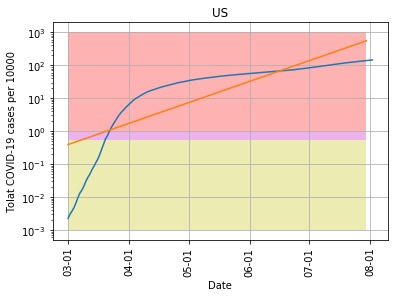

In [4006]:
ss1t = plotpred(dfUS1,populationUS,'2020-03-01', '2020-07-30', "pictures/coronaUS.png", model11, 'US',1000)

In [4007]:
dfAll[dfAll["Country"]=="Latvia"]
dfAll.fillna(0, inplace=True)

North America
            Country         0
229  European Union  0.092694


(0, 0.15)

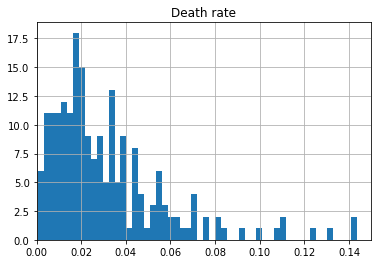

In [4008]:
dfT1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
print(dfTT.Country[0])
print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
hist = dfTTh[dfTTh[0]>0].hist(bins=9*12)
plt.title("Death rate")
plt.xlim([0,0.15])

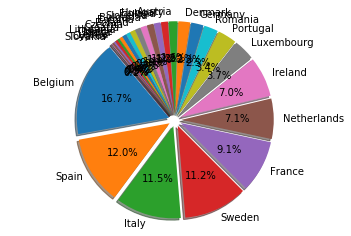

In [4009]:
cLst = countriesEU
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
#dfD1 = dfAll#[dfAll["Total Cases"]>0]
dfTT = pd.concat([dfT1["Country"],dfT1["Deathsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfTTh = dfTT.sort_values(by=["Deathsper1Mpop"], ascending=False)
dfTTh.rename(columns={0: "DeathRate"})
#hist = dfTTh.hist(bins=9*16)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])
#plt.show()
#import matplotlib.pyplot as plt

labels = dfTTh.Country.tolist()#'apple', 'banana', 'cherry', 'durian', 'elderberries', 'figs', 'grapes'
sizes = dfTTh.Deathsper1Mpop.values#[32, 20, 15, 10, 10, 8, 5]

p = plt.pie(sizes, labels=labels, explode=(.07,)*len(sizes), autopct='%1.1f%%', startangle=130, shadow=True)
plt.axis('equal')

            
plt.show()

In [4010]:
dfTTh.head()

,Country,Deathsper1Mpop
41,Belgium,849.0
15,Spain,608.0
21,Italy,582.0
35,Sweden,568.0
26,France,464.0


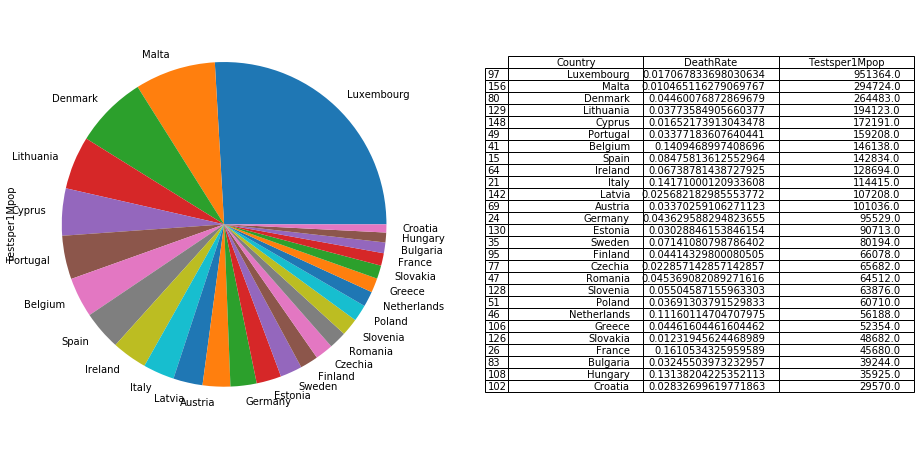

In [4011]:
dfT1 = dfAll[dfAll['Country'].isin(cLst)]
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=["Testsper1Mpop"], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
#import matplotlib.pyplot as plt
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfTTh.plot.pie(y=["Testsper1Mpop"],ax=ax1,labels=dfTTh['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfTTh, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate2.png")
plt.show()

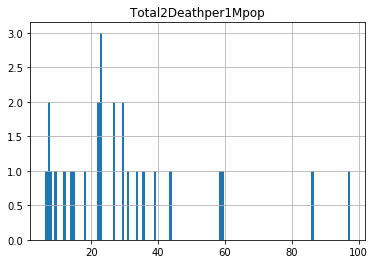

In [4012]:
dfD1 = dfAll[dfAll['Country'].isin(cLst)]#[dfAll["Total Cases"]>0]
dfDD = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"],dfD1["Deathsper1Mpop"]], axis=1)
dfDD2 = pd.concat([dfD1["Country"],dfD1["TotCasesper1Mpop"]/dfD1["Testsper1Mpop"]], axis=1)
dfDD = dfDD[dfDD["Deathsper1Mpop"]>0]
#print(dfDD.Country[0])
#print(dfDD[dfDD.Country=="Latvia"])
dfDD1 = pd.concat([dfDD["Country"],dfDD["TotCasesper1Mpop"]/dfDD["Deathsper1Mpop"]], axis=1)
dfDDh = dfDD1.sort_values(by=[0], ascending=False)
dfDDh=dfDDh.rename(columns={0:"Total2Deathper1Mpop"})
dfDDh2=dfDD2.rename(columns={0:"Cases2Testsper1Mpop"})
hist = dfDDh.hist(bins=9*15)
#plt.yscale("log")
#plt.xscale("log")
#plt.xlim([0,200])

In [4013]:
dfDD.head()

,Country,TotCasesper1Mpop,Deathsper1Mpop
15,Spain,7178.0,608.0
21,Italy,4103.0,582.0
24,Germany,2523.0,110.0
26,France,2878.0,464.0
35,Sweden,7959.0,568.0


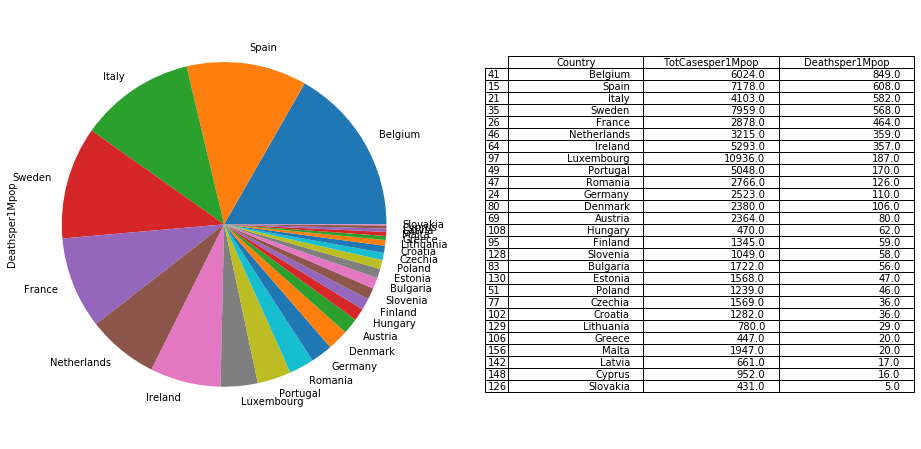

In [4014]:
from pandas.plotting import table
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDD = dfDD.sort_values(by=['Deathsper1Mpop'], ascending=False)
dfDD.plot.pie(y='Deathsper1Mpop',ax=ax1,labels=dfDD['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDD, loc='center')
tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.savefig("pictures/DeathRate1.png")
plt.show()

In [4015]:
dfAll.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,0.0,North America,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,0.0,0.0,0.0,0.0,0,North America,\n,0,0
1,0.0,South America,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,0.0,0.0,0.0,0.0,0,South America,\n,0,0
2,0.0,Asia,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,0.0,0.0,0.0,0.0,0,Asia,\n,0,0
3,0.0,Europe,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,0.0,0.0,0.0,0.0,0,Europe,\n,0,0
4,0.0,Africa,961453,65.0,20350.0,0.0,615476.0,132,325627,1150.0,0.0,0.0,0.0,0.0,0,Africa,\n,0,0


In [4016]:
dfDDh2.head()

,Country,Cases2Testsper1Mpop
15,Spain,0.050254
21,Italy,0.035861
24,Germany,0.026411
26,France,0.063004
35,Sweden,0.099247


In [4017]:
dfDDh2 = dfDDh2.sort_values(by=["Cases2Testsper1Mpop"], ascending=False)

     Country  Cases2Testsper1Mpop
      Sweden             0.099247
      France             0.063004
 Netherlands             0.057219
       Spain             0.050254
    Bulgaria             0.043879
     Croatia             0.043355
     Romania             0.042876
     Belgium             0.041221
     Ireland             0.041129
       Italy             0.035861
    Portugal             0.031707
     Germany             0.026411
     Czechia             0.023888
     Austria             0.023398
      Poland             0.020408
     Finland             0.020355
     Estonia             0.017285
    Slovenia             0.016422
     Hungary             0.013083
  Luxembourg             0.011495
     Denmark             0.008999
    Slovakia             0.008853
      Greece             0.008538
       Malta             0.006606
      Latvia             0.006166
      Cyprus             0.005529
   Lithuania             0.004018


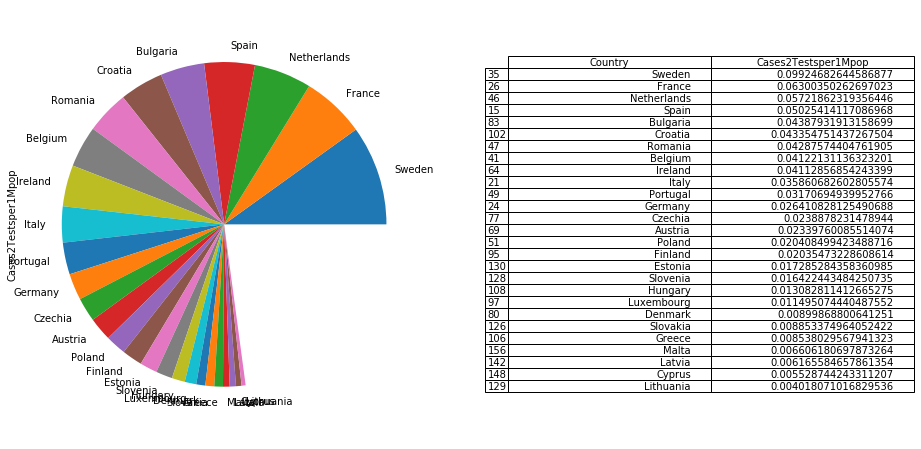

In [4018]:
print (dfDDh2[dfDDh2["Cases2Testsper1Mpop"]<1000].to_string(index=False))
plt.figure(figsize=(16,8))
# plot chart
ax1 = plt.subplot(121, aspect='equal')
dfDDh2.plot.pie(y='Cases2Testsper1Mpop',ax=ax1,labels=dfDDh2['Country'],legend = False)
ax2 = plt.subplot(122)
plt.axis('off')
tbl = table(ax2, dfDDh2, loc='center')
#tbl.auto_set_font_size(False)
#tbl.set_fontsize(14)
plt.show()

In [4019]:
dfT1 = dfAll
dfTT = pd.concat([dfT1["Country"],dfT1["TotalDeaths"]/dfT1["TotalCases"],dfT1["Testsper1Mpop"]], axis=1)
dfTT = dfTT[dfTT[0]>=0]
#print(dfTT.Country[0])
#print(dfTT[dfTT.Country=="European Union"])
dfTTh = dfTT.sort_values(by=[0], ascending=False)
dfTTh = dfTTh.rename(columns={0: "DeathRate"})
dfTT[dfTT[0]>=0.000001].sort_values(by=[0], ascending=True)
#dfTT[dfTT.Country=="France"]

,Country,0,Testsper1Mpop
48,Singapore,0.000509,225657.0
30,Qatar,0.001593,178266.0
131,Rwanda,0.002425,20950.0
158,Botswana,0.002488,29047.0
170,Burundi,0.002532,1310.0
...,...,...,...
21,Italy,0.141710,114415.0
18,UK,0.151630,242929.0
26,France,0.161053,45680.0
216,MS Zaandam,0.222222,0.0


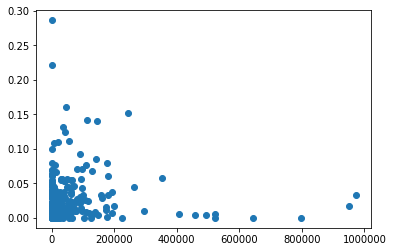

In [4020]:
plt.plot(dfTTh["Testsper1Mpop"],dfTTh['DeathRate'],'o')

/usr/local/lib/python3.7/site-packages/matplotlib/patches.py:715: RuntimeWarning: invalid value encountered in double_scalars
  self._x1 = self._x0 + self._width
/usr/local/lib/python3.7/site-packages/matplotlib/projections/polar.py:55: RuntimeWarning: invalid value encountered in greater_equal
  r = np.where(r >= 0, r, np.nan)


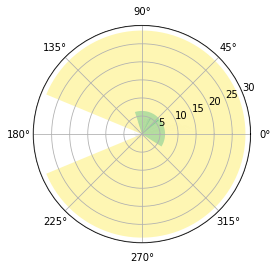

In [4021]:
import numpy as np
import matplotlib.pyplot as plt


# Fixing random state for reproducibility
np.random.seed(19680801)

# Compute pie slices
N = len(dfTTh)
theta = np.linspace(0.0, 2*np.pi, N, endpoint=False)
radii = 100 * dfTTh['DeathRate']
width = 2*np.pi* 3.5/ dfTTh["Testsper1Mpop"]
colors = plt.cm.viridis(radii / 10.)

ax = plt.subplot(111, projection='polar')
ax.bar(theta, radii, width=width, bottom=0.0, color=colors, alpha=0.35)

plt.show()

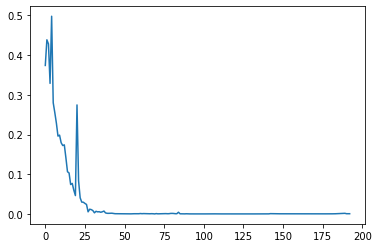

In [4022]:
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)))

In [4023]:
#np.diff(np.log(dfCN["cases"].values))

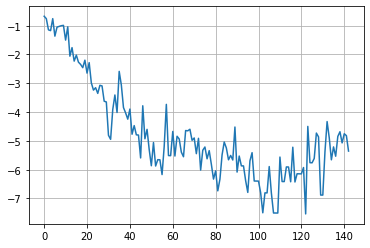

In [4024]:
plt.plot(range(len(dfLT["cases"].values[3:])-1),np.log(np.diff(np.log(dfLT["cases"].values[3:]))))
plt.grid()

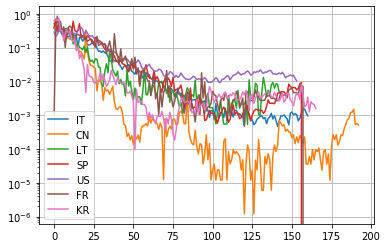

In [4025]:
plt.plot(range(len(dfIT["cases"].values)-1),np.diff(np.log(dfIT["cases"].values))[:],label='IT')
plt.plot(range(len(dfCN["cases"].values)-1),np.diff(np.log(dfCN["cases"].values)),label='CN')
plt.plot(range(len(dfLT["cases"].values)-4),np.diff(np.log(dfLT["cases"].values))[3:],label='LT')
plt.plot(range(len(dfSP["cases"].values)-1),np.diff(np.log(dfSP["cases"].values)),label='SP')
plt.plot(range(len(dfUS["cases"].values)-1),np.diff(np.log(dfUS["cases"].values)),label='US')
plt.plot(range(len(dfFR["cases"].values)-10),np.diff(np.log(dfFR["cases"].values))[9:],label='FR')
plt.plot(range(len(dfKR["cases"].values)-4),np.diff(np.log(dfKR["cases"].values))[3:],label='KR')
plt.yscale('log')
plt.grid()
plt.legend()
plt.show()

154 154
coefficient of determination: 0.7054099311072659
intercept: -11.512070853047707
slope: [-0.06742646]


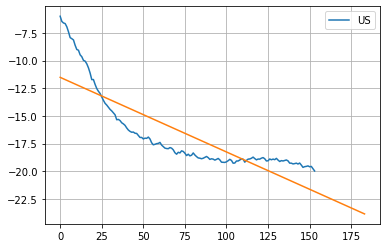

In [4026]:
y = np.log(np.diff(dfUS["cases"].values)[:]/dfUS["cases"].values[1:]**2)
x = np.array(range(len(dfUS["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='US')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+30) 
plt.plot(range(len(x)+30),y_pred11)
plt.grid()
plt.legend()
plt.savefig("pictures/logdiffUS.png")
plt.show()

In [4027]:
#np.diff(dfIT["cases"])

161 161
coefficient of determination: 0.809918748724901
intercept: -11.441006066767784
slope: [-0.0644836]


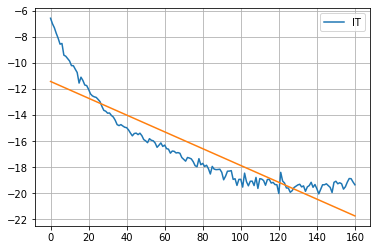

In [4028]:
y = np.log(np.diff(dfIT["cases"].values)[:]/dfIT["cases"].values[1:]**2)
x = np.array(range(len(dfIT["cases"].values)-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='IT')
y_pred12 = model.intercept_ + model.coef_ * range(len(x)) 
plt.plot(x,y_pred12)
plt.grid()
plt.legend()
plt.show()

In [4029]:
#model11.coef_

In [4030]:
#np.log(np.diff(dfLV["cases"].values)[:]/dfLV["cases"].values[1:]**2)

143 143
coefficient of determination: 0.8595778538413159
intercept: -15.954578421038573
slope: [-0.04072484]


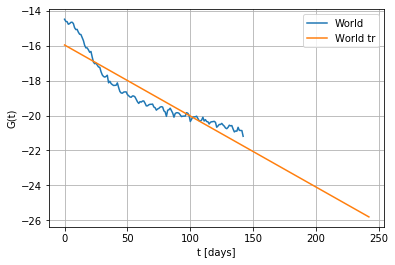

In [4031]:
y = np.log(np.diff(dfW["cases"].values)[50:]/dfW["cases"].values[51:]**2)
x = np.array(range(len(dfW["cases"].values[50:])-1)).reshape((-1, 1))
print (x.size,y.size)
model = LinearRegression().fit(x, y)
r_sq = model.score(x, y)
print('coefficient of determination:', r_sq)
print('intercept:', model.intercept_)
print('slope:', model.coef_)
plt.plot(x,y,label='World')
y_pred11 = model.intercept_ + model.coef_ * range(len(x)+100)
plt.plot(range(len(x)+100),y_pred11,label='World tr')
plt.legend()
plt.xlabel('t [days]')
plt.ylabel('G(t)')
plt.grid()
plt.savefig("pictures/logdifflogcoronaW.png")

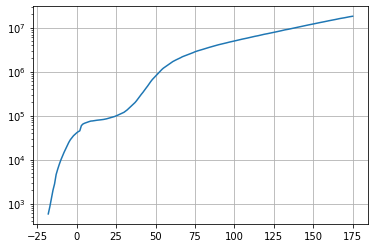

In [4032]:
waveform_1 = dfW['cases'].values
waveform_A = dfW['active'].values
t = np.arange(-18,len(waveform_1)-18)
plt.plot(t, waveform_1) 
plt.yscale("log")
plt.grid()
plt.show()

In [4033]:
dfW['cases'].values

array([     580,      845,     1317,     2015,     2800,     4581,
           6058,     7813,     9823,    11950,    14553,    17391,
          20630,    24545,    28266,    31439,    34876,    37552,
          40553,    43099,    45134,    59287,    64438,    67100,
          69197,    71329,    73332,    75184,    75700,    76677,
          77673,    78651,    79205,    80087,    80828,    81820,
          83112,    84615,    86604,    88585,    90443,    93016,
          95314,    98425,   102050,   106099,   109991,   114381,
         118948,   126214,   134576,   145483,   156653,   169593,
         182490,   198238,   218822,   244933,   275597,   305036,
         337489,   378860,   422629,   471035,   531864,   596366,
         663079,   723279,   784738,   858355,   936237,  1016330,
        1117928,  1203058,  1274578,  1347566,  1432869,  1519195,
        1605277,  1700004,  1780713,  1853505,  1925330,  2000065,
        2084633,  2183942,  2252370,  2332650,  2407467,  2482

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: overflow encountered in exp
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:4: RuntimeWarning: divide by zero encountered in true_divide
  after removing the cwd from sys.path.
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


[ 8.50166961e+07  5.38360186e-01 -2.65757059e+02  1.55880367e-02]


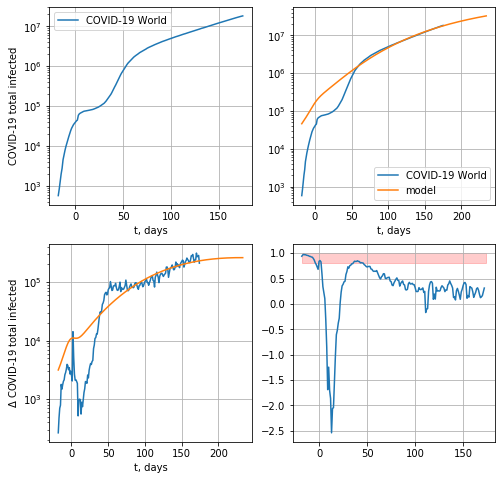

282624.81414522254


In [4034]:
def model(t, coeffs):
    coeffsCN = [ 8.08213515e+04,  2.21924344e-01, -7.12649833e-01]
    #coeffsCN = [2.06174475e+06, 1.67277852e-01, 5.36255447e+01]
    return coeffs[0]/(1 + np.exp( - coeffs[3]*coeffs[1] * (t - coeffs[2])))**(1./coeffs[3]) + coeffsCN[0]/(1 + np.exp( - coeffsCN[1] * (t - coeffsCN[2])))

x0 = np.array([2.06174475e+06, 1.67277852e-01, 5.36255447e+01, 0.9 ], dtype=float)
#x0 = np.array([8.08757112e+04,  2.24114193e-01, -6.94900467e-01 ], dtype=float)
def residuals(coeffs, y, t):
    return y - model(t, coeffs)
from scipy.optimize import leastsq
x, flag = leastsq(residuals, x0, args=(waveform_1, t))
print(x)
tt = np.arange(-18,len(waveform_1)-18+59)
fig, ((ax3,ax1),(ax2,ax4)) = plt.subplots(2,2,figsize=(8,8), sharex=False, sharey=False)
ax3.plot(t, waveform_1) 
ax3.legend(['COVID-19 World']) 
ax3.set_xlabel('t, days')
ax3.set_yscale("log")
ax3.set_ylabel(r'COVID-19 total infected')
ax3.grid()
ax1.plot(t, waveform_1, tt, model(tt, x)) 
ax1.legend(['COVID-19 World', 'model']) 
ax1.set_xlabel('t, days')
ax1.set_yscale("log")
ax1.grid()
ax2.plot(t[:-1], np.diff(waveform_1),tt[:-1], np.diff(model(tt, x)))
ax2.set_ylabel(r'$\Delta$ COVID-19 total infected')
ax2.set_yscale("log")
ax2.grid()
ax2.set_xlabel('t, days')
z = np.diff(moving_average(waveform_A, n=3) )/np.diff(moving_average(waveform_1, n=3))
ax4.plot(t[:-3],z)
#ax4.axhline(y=2.2587741081036339/2, color='r')
ax4.fill_between(t[:-1], 0.8078285535018691, 1.,color='r',alpha=0.2)
#ax4.set_yscale("log")
ax4.grid()
plt.savefig("pictures/covidworld.png")

plt.show()
print(np.std(residuals(x, waveform_1, t)))
#expPopWorld = x[0]
expPopWorld = 2.67152730e+06

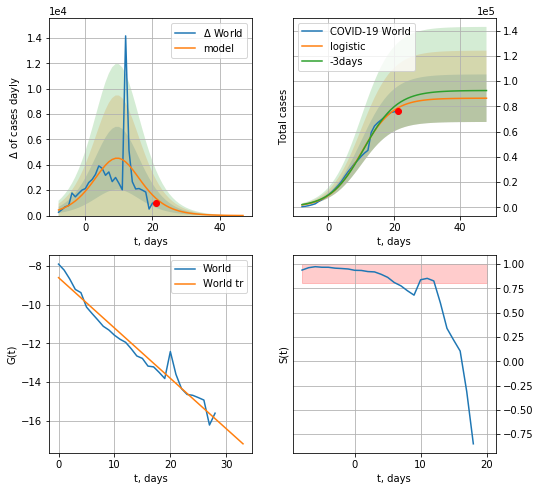

World data at: 2020-08-02
+3 day model MAPE: 0.04256770161128604
model: logistic
coeffs:  [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.2178111789766563
forecast at the end of period: +27 days
	 deltaDaycases:  6
	 total cases:  86443 ± 18828
	 total death:  3282 ± 2144
trend coefficient of determination: 0.960820
 intercept: -8.598458
 slope: -0.260482


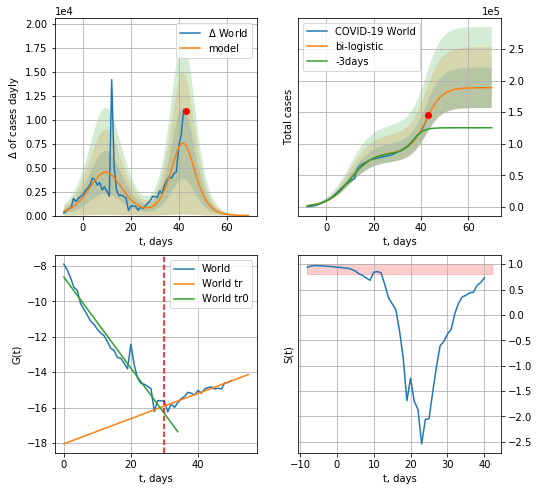

World data at: 2020-08-02
+3 day model MAPE: 0.21572977405755475
model: bi-logistic
coeffs:  [1.02227620e+05 2.95650803e-01 4.22367007e+01] [8.64735804e+04 2.09600360e-01 9.98515269e+00]
rational stdev:  0.16992860967254475
forecast at the end of period: +27 days
	 deltaDaycases:  9
	 total cases:  188673 ± 32060
	 total death:  7164 ± 3652
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend coefficient of determination: 0.868835
 intercept: -18.049568
 slope: 0.071157


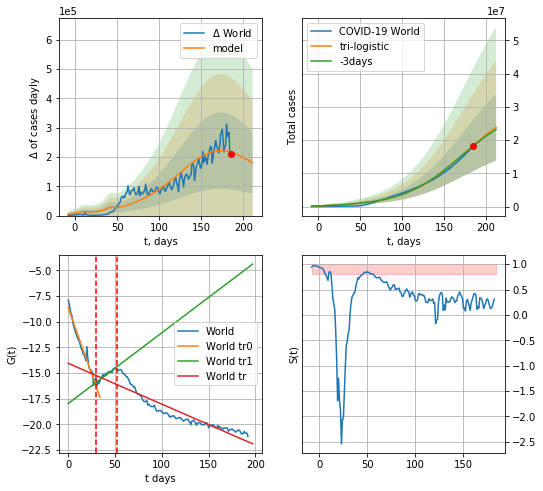

World data at: 2020-08-02
+3 day model MAPE: 0.013578824998418835
model: tri-logistic
coeffs:  [2.83878609e+07 2.90006335e-02 1.68992643e+02] [8.64735804e+04 2.09600360e-01 9.98515269e+00 1.02227620e+05
 2.95650803e-01 4.22367007e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.4204750053032667
forecast at the end of period: +27 days
	 deltaDaycases:  180139
	 total cases:  23879738 ± 10040833
	 total death:  906811 ± 1143874
tri-logistic approximation splitting points: 30,52
trend0 coefficient of determination: 0.961986
 intercept: -8.630711
 slope: -0.257026
trend1 coefficient of determination: 0.872494
 intercept: -17.970431
 slope: 0.068998
trend coefficient of determination: 0.857442
 intercept: -14.045835
 slope: -0.039847


In [4035]:
vL = 30
T18 = 22
x = forecast("World",dfW[:vL],d1,7*T18-dT,1.0,False)
xx = forecast2("World",dfW[:52],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("World",dfW,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,52])

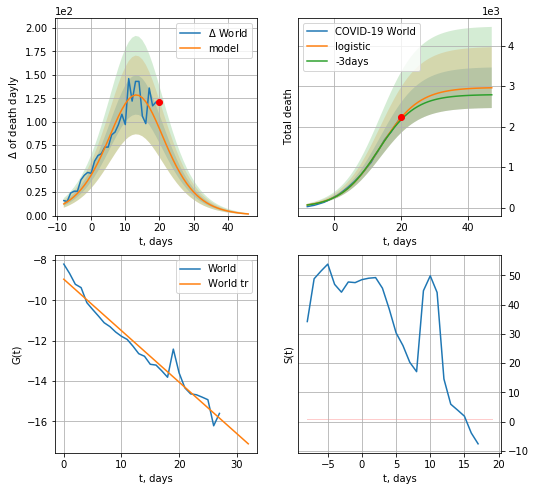

World data at: 2020-08-02
+3 day model MAPE: 0.027312195038559757
model: logistic
coeffs:  [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.16928081921473714
forecast at the end of period: +27 days
	 total death:  2960 ± 501
trend coefficient of determination: 0.959176
 intercept: -8.958870
 slope: -0.254930


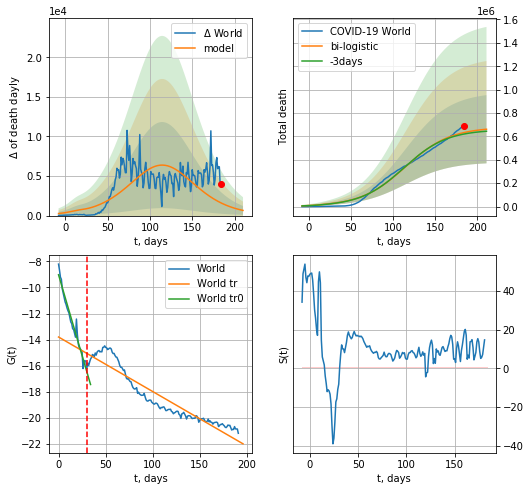

World data at: 2020-08-02
+3 day model MAPE: 0.02044544866409576
model: bi-logistic
coeffs:  [6.75955420e+05 3.77631038e-02 1.14902915e+02] [2.96959017e+03 1.73350949e-01 1.36930068e+01]
rational stdev:  0.4408343545011401
forecast at the end of period: +27 days
	 deltaDaydeath:  654
	 total death:  661445 ± 291588
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.960969
 intercept: -9.026339
 slope: -0.247583
trend coefficient of determination: 0.891140
 intercept: -13.801218
 slope: -0.041803


In [4036]:
vL = 30
vL1=52
x = forecast("World",dfW[1:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2("World",dfW[1:],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("World",dfW,d1,7*20-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

In [4037]:
#vL = 30
#x = forecast("World",dfW[:vL],d1,7*9-dT,1.0,False)
#xx = forecast2("World",dfW,d1,7*15-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.7],vL=vL)
#trend(dfW,"W",10)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


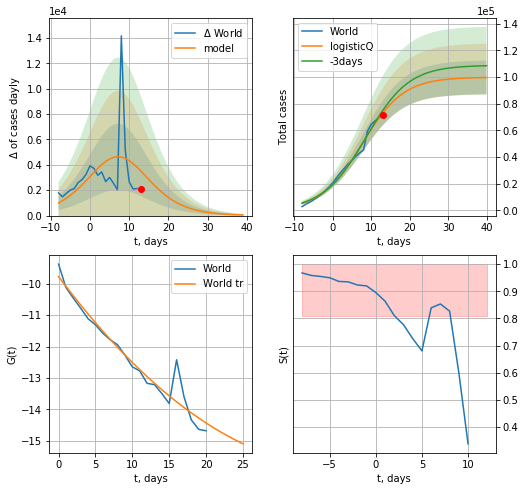

World data at: 2020-08-02
+3 day model MAPE: 0.031856
model: logisticQ
coeffs: [ 9.98643061e+04  1.79654926e-05  7.63889443e+00 -1.03374511e+04]
rational stdev: 0.126959
forecast at the end of period: +27 days
	 deltaDaycases: 48
	 total cases: 99625 ± 12648
	 total death: 3783 ± 1440
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


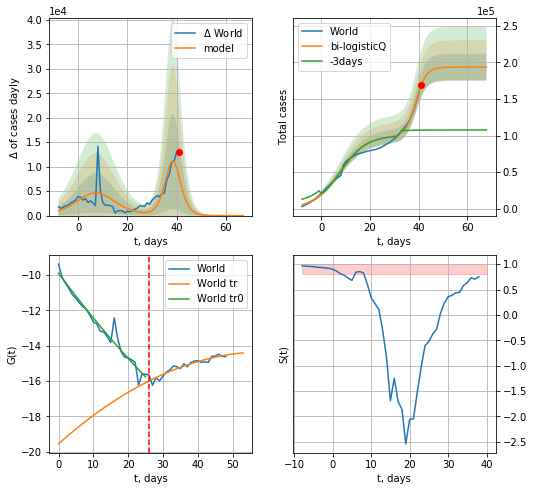

World data at: 2020-08-02
+3 day model MAPE: 0.635592
model: bi-logisticQ
coeffs: [ 9.37621522e+04  2.37764402e-05  3.89555041e+01 -2.00834102e+04]
rational stdev: 0.094698
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 193625 ± 18335
	 total death: 7352 ± 2088
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.893677
 intercept_: -19.558019139425994
 coeffs_: [ 0.          0.17538587 -0.00147405]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


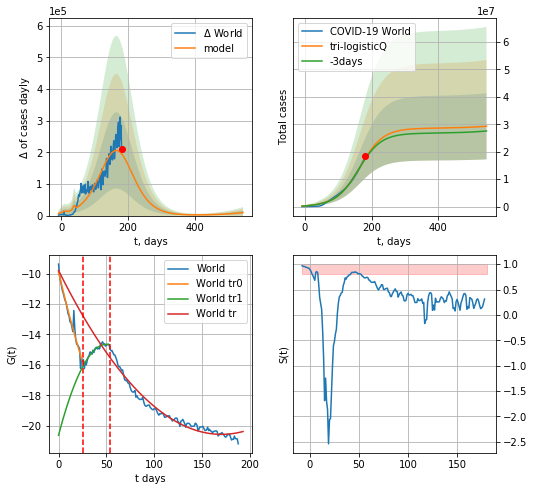

World data at: 2020-08-02
+3 day model MAPE: 0.017173
model: tri-logisticQ
coeffs: [ 2.83481557e+07  2.08673989e-07  1.64918417e+02 -1.38993265e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.412000
forecast at the end of period: +363 days
	 deltaDaycases: 9783
	 total cases: 29267459 ± 12058207
	 total death: 1111405 ± 1373698
tri-logisticQ approximation splitting points: 26,54
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.900515
 intercept_: -20.622215746086294
 coeffs_: [ 0.          0.23801537 -0.00236922]
trend coefficient of determination: 0.966435
 intercept_: -9.79404152576889
 coeffs_: [ 0.         -0.12632779  0.00037038]


In [4038]:
vL=30 - 4
vL1=59 - 5
koreaCoeffs = [  0.35416971,   0.02606324,   4.35859408,  19.30413219]
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False)
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL)#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*70-dT, xx, shift=1.,addpred=True,xcoef=koreaCoeffs,vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


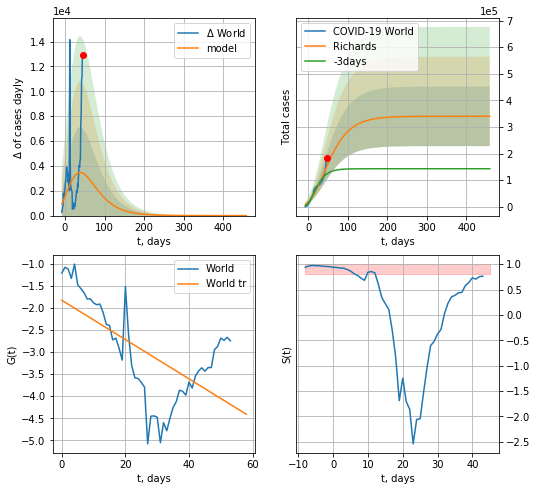

World data at: 2020-08-02
+3 day model MAPE: 0.241623
model: Richards
coeffs: [ 3.40076103e+05  3.50838629e+00 -1.35190892e+02  7.92527881e-03]
rational stdev: 0.329278
forecast at the end of period: +413 days
	 deltaDaycases: 0
	 total cases: 340073 ± 111978
	 total death: 12913 ± 12755
trend coefficient of determination: 0.389869
 intercept: -1.829859
 slope: -0.044449


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


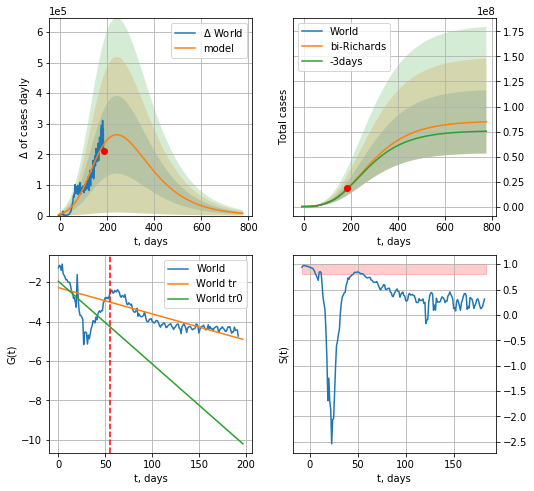

World data at: 2020-08-02
+3 day model MAPE: 0.010056
model: bi-Richards
coeffs: [ 8.52658667e+07  5.22883994e-01 -2.44285714e+02  1.62464351e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.373038
forecast at the end of period: +593 days
	 deltaDaycases: 7499
	 total cases: 84722597 ± 31604750
	 total death: 3217265 ± 3600486
bi-Richards approximation splitting point: 55
trend coefficient of determination: 0.360484
 intercept: -1.958209
 slope: -0.041914
trend coefficient of determination: 0.722153
 intercept: -2.277993
 slope: -0.013339


In [4039]:
vL = 55
x = forecastRR("World",dfW[:vL],d1,60*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[:],d1,80*9-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

194


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


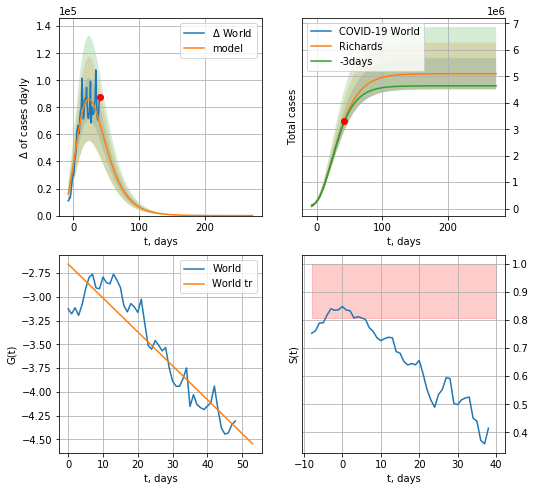

World data at: 2020-08-02
+3 day model MAPE: 0.014871
model: Richards
coeffs: [ 5.10253376e+06  1.04389323e+00 -4.20529569e+01  4.49999517e-02]
rational stdev: 0.115528
forecast at the end of period: +233 days
	 deltaDaycases: 1
	 total cases: 5102493 ± 589479
	 total death: 193762 ± 67154
trend coefficient of determination: 0.854894
 intercept: -2.655671
 slope: -0.035657


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


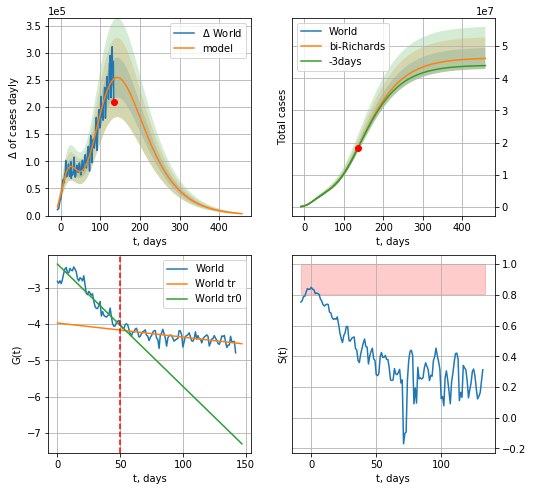

World data at: 2020-08-02
+3 day model MAPE: 0.004632
model: bi-Richards
coeffs: [ 4.12776710e+07  8.67745481e-01 -8.96033504e+01  1.94443992e-02]
rational stdev: 0.070902
forecast at the end of period: +323 days
	 deltaDaycases: 3490
	 total cases: 46174563 ± 3273879
	 total death: 1753438 ± 372967
bi-Richards approximation splitting point: 50
trend coefficient of determination: 0.843774
 intercept: -2.347297
 slope: -0.033695
trend coefficient of determination: 0.452122
 intercept: -3.971671
 slope: -0.003876


In [4040]:
print (len(dfW))
vL = 100
x = forecastRR("World",dfW[50:vL],d1,40*9-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("World",dfW[50:],d1,50*9-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-50)
#x = forecastQR("World",dfW[50:],d1,30*9-dT,1.0,addpred=False)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


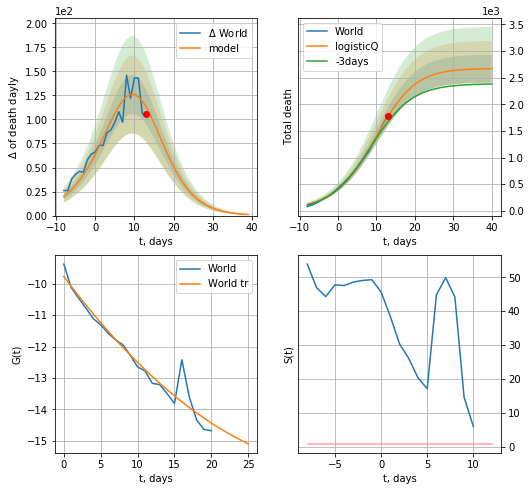

World data at: 2020-08-02
+3 day model MAPE: 0.067194
model: logisticQ
coeffs: [ 2.67018329e+03  8.28113131e-04  9.49649422e+00 -2.18461064e+02]
rational stdev: 0.098000
forecast at the end of period: +27 days
	 total death: 2666 ± 261
trend coefficient of determination: 0.944130
 intercept_: -9.771844228006898
 coeffs_: [ 0.         -0.31384117  0.00402719]


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


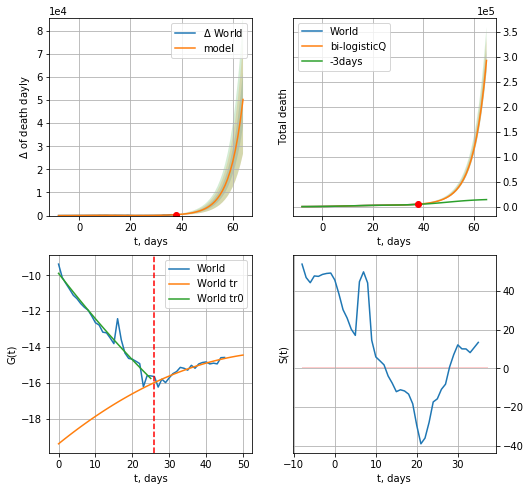

World data at: 2020-08-02
+3 day model MAPE: 0.105641
model: bi-logisticQ
coeffs: [ 6.44010385e+06  6.89934025e-04  7.95796325e+01 -2.38740330e+02]
rational stdev: 0.076590
forecast at the end of period: +27 days
	 total death: 292400 ± 22394
bi-logisticQ approximation splitting point: 26
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend coefficient of determination: 0.866834
 intercept_: -19.41123113056416
 coeffs_: [ 0.          0.16686573 -0.0013545 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:435: RuntimeWarning: overflow encountered in exp


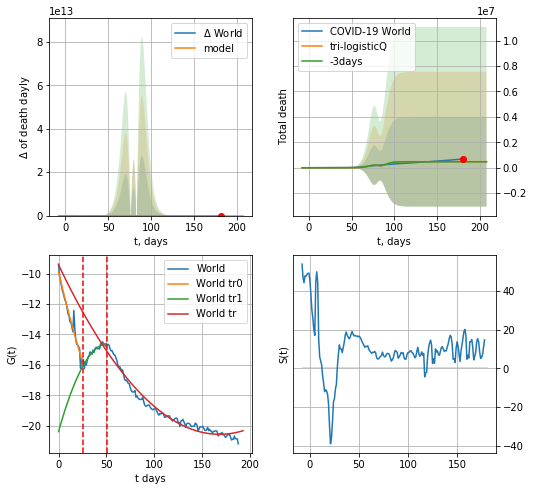

World data at: 2020-08-02
+3 day model MAPE: 0.016117
model: tri-logisticQ
coeffs: [-5.96622656e+06  1.70480545e-03 -6.41307405e+01  7.94427867e+01]
rational stdev: 7.411795
forecast at the end of period: +27 days
	 total death: 476547 ± 3532072
tri-logisticQ approximation splitting points: 26,51
trend coefficient of determination: 0.957216
 intercept_: -9.890425229004336
 coeffs_: [ 0.         -0.26614025  0.00124975]
trend1 coefficient of determination: 0.890965
 intercept_: -20.382525077358043
 coeffs_: [ 0.          0.22422642 -0.00217733]
trend coefficient of determination: 0.968447
 intercept_: -9.425700249407207
 coeffs_: [ 0.         -0.13219205  0.00039227]


In [4041]:
vL=30 - 4
vL1=51
x = forecastRRR("World",dfW[4:vL],d1,7*T18-dT,1.0,False,cases='death')
xx = forecast2RRR("World",dfW[4:vL1],d1,7*T18-dT,x,1.0,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,1.5]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3RRR("World",dfW[4:],d1,7*22-dT, xx, shift=1.,addpred=False,xcoef=[.35,.5,4.,1.],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


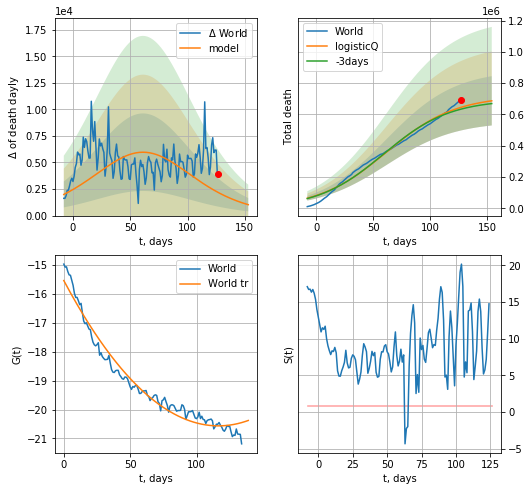

World data at: 2020-08-02
+3 day model MAPE: 0.018648
model: logisticQ
coeffs: [ 7.18918773e+05  3.74878278e-07  6.15482090e+01 -8.84918826e+04]
rational stdev: 0.229046
forecast at the end of period: +27 days
	 total death: 687096 ± 157376
trend coefficient of determination: 0.966435
 intercept_: -15.535486667410225
 coeffs_: [ 0.         -0.08633763  0.00037045]


In [4042]:
x = forecastRRR("World",dfW[58:],d1,7*T18-dT,1.0,False,cases='death')

In [4043]:
#trend(dfSP,'SP',10)

In [4044]:
#vL = len(dfSP[:])-16-dT
#x = forecast('Spain',dfSP[:vL],d1,30-dT,1.0)
#xx = forecast2('Spain',dfSP,d1,7*6-dT,x,1.0,addpred=True,xcoef=[3.,1.,1.8],vL=vL)

SP
           date   cases  active    death
155 2020-07-29  329721       0  28441.0
156 2020-07-30  332510       0  28443.0
157 2020-07-31  335602       0  28445.0
158 2020-08-01  335602       0  28445.0
159 2020-08-02  335602       0  28445.0


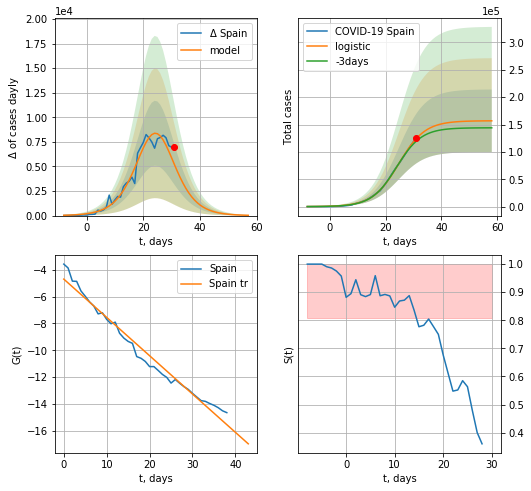

Spain data at: 2020-08-02
+3 day model MAPE: 0.04562670003340739
model: logistic
coeffs:  [1.56957534e+05 2.13812412e-01 2.47399190e+01]
rational stdev:  0.3648922799439526
forecast at the end of period: +27 days
	 deltaDaycases:  30
	 total cases:  156829 ± 57225
	 total death:  13292 ± 14550
trend coefficient of determination: 0.974785
 intercept: -4.699916
 slope: -0.285083
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


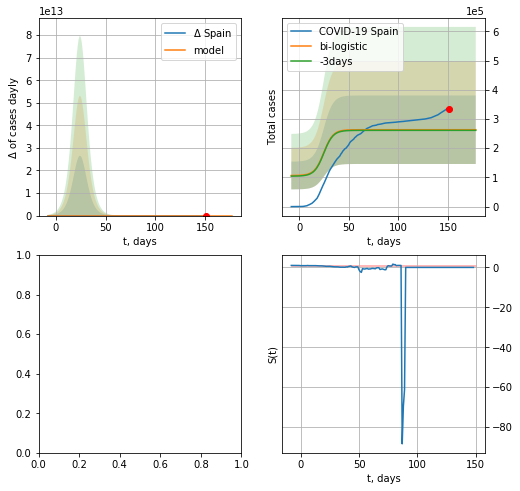

In [4045]:
try:
    dfSP = read_df(pd.DataFrame(),"SP")
    vL = 40#len(dfSP[:])-7-dT
    x = forecast('Spain',dfSP[:vL],d1,7*T18-dT,1.0,cases='cases')
    xx = forecast2('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,1.6],vL=vL,cases='cases')
except:
    print("Exception occurs")

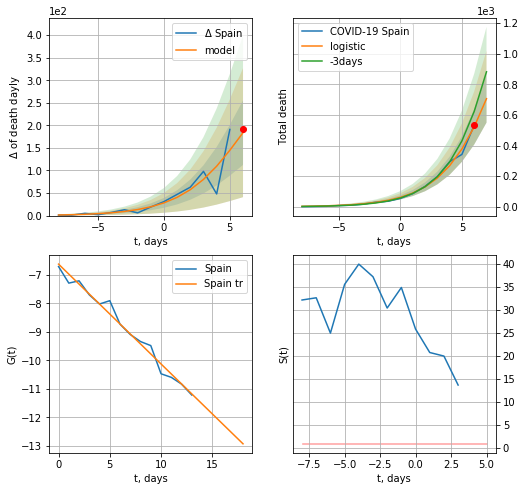

Spain data at: 2020-07-31
+3 day model MAPE: 0.19925761196778652
model: logistic
coeffs:  [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.22139702081914042
forecast at the end of period: +1 days
	 total death:  706 ± 156
trend coefficient of determination: 0.980020
 intercept: -6.621221
 slope: -0.350134


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: invalid value encountered in true_divide


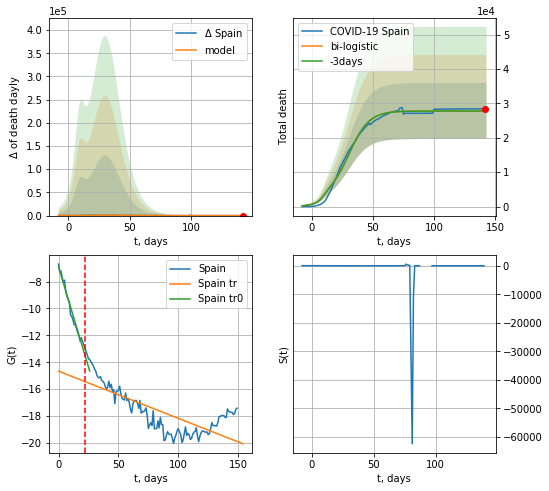

Spain data at: 2020-07-31
+3 day model MAPE: 0.0008986252560508113
model: bi-logistic
coeffs:  [2.50646982e+04 1.21212086e-01 3.04038360e+01] [2.74529161e+03 3.87912521e-01 9.73356211e+00]
rational stdev:  0.2928270531387874
forecast at the end of period: +1 days
	 deltaDaydeath:  0
	 total death:  27809 ± 8143
bi-logistic approximation splitting point: 22
trend0 coefficient of determination: 0.976968
 intercept: -6.910878
 slope: -0.297821
trend coefficient of determination: 0.565822
 intercept: -14.662935
 slope: -0.035058


In [3232]:
vL = 22#len(dfSP[:])-7-dT
#dfSP = read_df(pd.DataFrame(),"SP")
x = forecast('Spain',dfSP[7:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Spain',dfSP[7:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.8],vL=vL,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


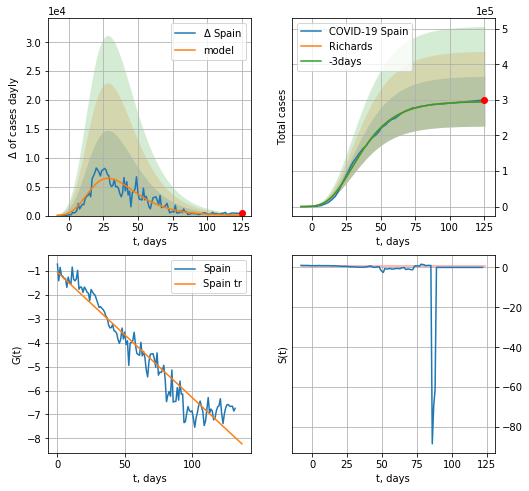

Spain data at: 2020-07-31
+3 day model MAPE: 0.001287
model: Richards
coeffs: [ 2.95785082e+05  9.22503712e+00 -5.55202934e+01  6.46024277e-03]
rational stdev: 0.237556
forecast at the end of period: +1 days
	 deltaDaycases: 56
	 total cases: 294869 ± 70047
	 total death: 24992 ± 17810
trend coefficient of determination: 0.934307
 intercept: -1.050927
 slope: -0.052394


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


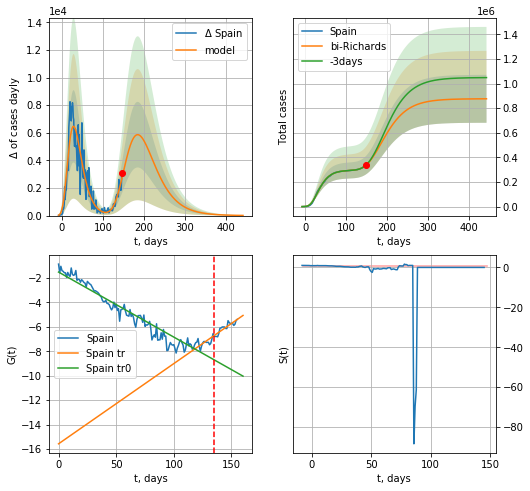

Spain data at: 2020-07-31
+3 day model MAPE: 0.003191
model: bi-Richards
coeffs: [5.80519219e+05 5.11717629e-01 8.26801557e+01 5.50834316e-02]
rational stdev: 0.222316
forecast at the end of period: +295 days
	 deltaDaycases: 11
	 total cases: 875895 ± 194725
	 total death: 74239 ± 49513
bi-Richards approximation splitting point: 135
trend coefficient of determination: 0.923035
 intercept: -1.518460
 slope: -0.053240
trend coefficient of determination: 0.802196
 intercept: -15.575620
 slope: 0.065669


In [3233]:
vL = 135+1
x = forecastRR('Spain',dfSP[1:vL-1],d1,7*T18-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Spain',dfSP[1:],d1,7*60-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-1)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


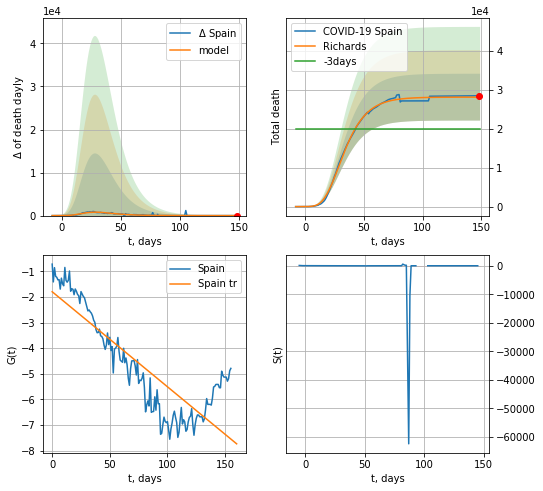

Spain data at: 2020-07-31
+3 day model MAPE: 0.409681
model: Richards
coeffs: [ 2.80913478e+04  9.64162765e+00 -3.35705640e+01  8.03144522e-03]
rational stdev: 0.213898
forecast at the end of period: +1 days
	 total death: 28088 ± 6008
trend coefficient of determination: 0.723559
 intercept: -1.797338
 slope: -0.037111


In [3234]:
x = forecastRR('Spain',dfSP[1:],d1,7*T18-dT,1.0,addpred=False,xcoef=[.25,1.,3.,1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


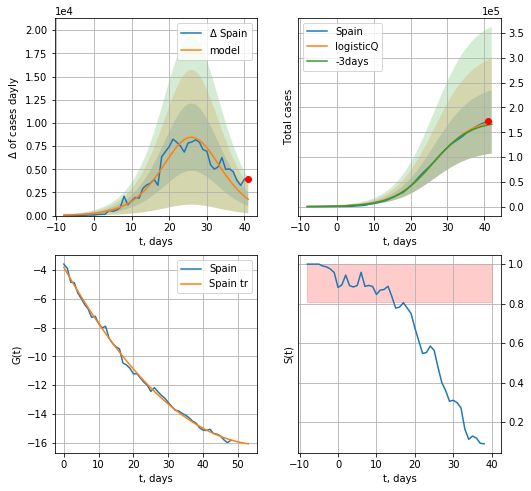

Spain data at: 2020-07-31
+3 day model MAPE: 0.028162
model: logisticQ
coeffs: [ 1.79944312e+05  4.82958618e-06  2.63952862e+01 -3.89568174e+04]
rational stdev: 0.373922
forecast at the end of period: +1 days
	 deltaDaycases: 1762
	 total cases: 170901 ± 63903
	 total death: 14485 ± 16248
trend coefficient of determination: 0.997334
 intercept_: -3.7990007659330134
 coeffs_: [ 0.         -0.42831531  0.00370949]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


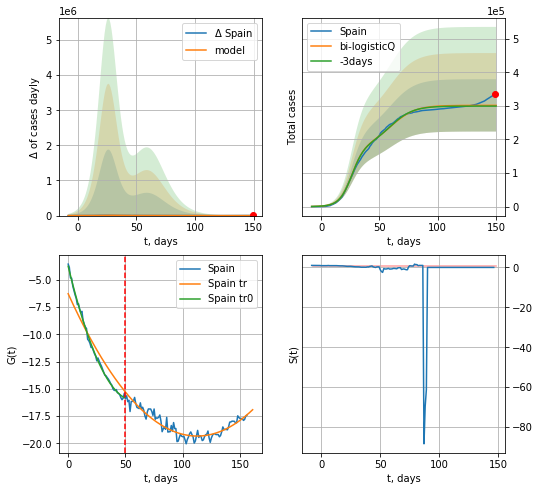

Spain data at: 2020-07-31
+3 day model MAPE: 0.007183
model: bi-logisticQ
coeffs: [ 1.21677301e+05  1.31699041e-07  6.01760462e+01 -7.48479942e+05]
rational stdev: 0.258354
forecast at the end of period: +1 days
	 deltaDaycases: 1
	 total cases: 301604 ± 77920
	 total death: 25563 ± 19812
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.997131
 intercept_: -3.7751216617675887
 coeffs_: [ 0.         -0.43240435  0.00381547]
trend coefficient of determination: 0.873944
 intercept_: -6.295224592006624
 coeffs_: [ 0.         -0.23140816  0.00102782]


In [3235]:
x = forecastRRR('Spain',dfSP[:50],d1,7*T18-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[:],d1,7*T18-dT,x,1.0,addpred=False,xcoef=koreaCoeffs,vL=50)#[.35,.5,3.,1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


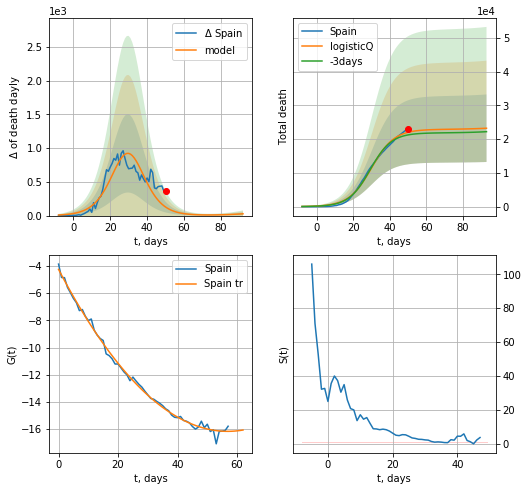

Spain data at: 2020-07-31
+3 day model MAPE: 0.037625
model: logisticQ
coeffs: [ 2.28798060e+04  1.92558820e-06  3.00460867e+01 -8.38208205e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430820
forecast at the end of period: +43 days
	 total death: 23234 ± 10009
trend coefficient of determination: 0.995937
 intercept_: -4.2575122176431694
 coeffs_: [ 0.         -0.41856419  0.00368029]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:347: RuntimeWarning: invalid value encountered in true_divide


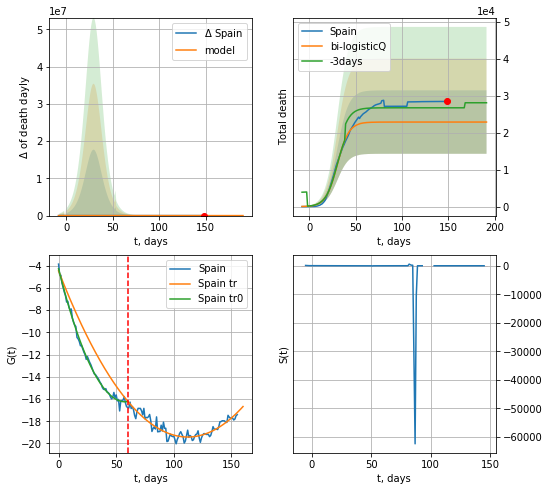

Spain data at: 2020-07-31
+3 day model MAPE: 0.144289
model: bi-logisticQ
coeffs: [-36.95408469  -2.59089958  53.28242173  -0.40753193]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.375072
forecast at the end of period: +43 days
	 total death: 22866 ± 8576
bi-logisticQ approximation splitting point: 60
trend coefficient of determination: 0.995783
 intercept_: -4.28878212009627
 coeffs_: [ 0.         -0.41413346  0.00358475]
trend coefficient of determination: 0.849045
 intercept_: -4.483392477208145
 coeffs_: [ 0.         -0.26671788  0.00119066]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [3236]:
x = forecastRRR('Spain',dfSP[1:60],d1,7*24-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1])
xx = forecast2RRR('Spain',dfSP[1:],d1,7*24-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,cases='death',vL=60)

In [3237]:
#x = forecastQR('Spain',dfSP[5:],d1,7*16-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[.35,.5,3.,1])

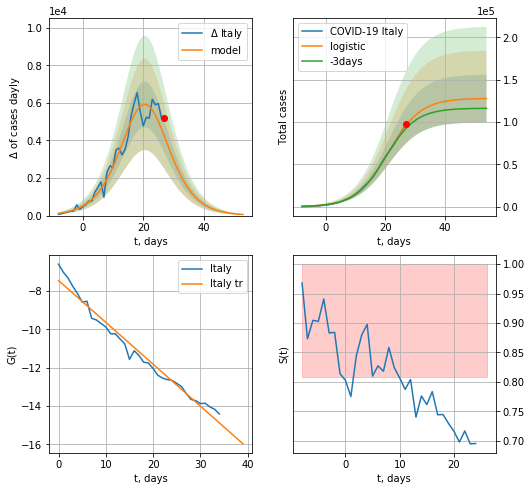

Italy data at: 2020-08-02
+3 day model MAPE: 0.0455783779571316
model: logistic
coeffs:  [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.22065596629973358
forecast at the end of period: +27 days
	 deltaDaycases:  57
	 total cases:  127854 ± 28211
	 total death:  18118 ± 11993
trend coefficient of determination: 0.974872
 intercept: -7.448746
 slope: -0.218671


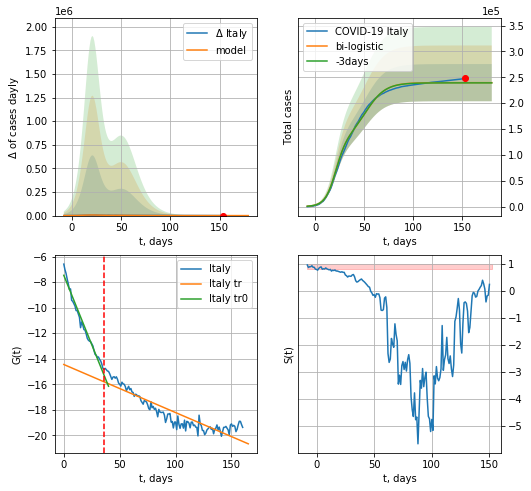

Italy data at: 2020-08-02
+3 day model MAPE: 0.0017878996821542941
model: bi-logistic
coeffs:  [1.11590828e+05 9.92458673e-02 5.18246064e+01] [1.28139025e+05 1.85112184e-01 2.10100291e+01]
rational stdev:  0.1498171048186561
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  239729 ± 35915
	 total death:  33972 ± 15268
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975965
 intercept: -7.466589
 slope: -0.217097
trend coefficient of determination: 0.827062
 intercept: -14.448455
 slope: -0.037627


In [4046]:
vL = 36#len(dfIT)-6-dT
x = forecast('Italy',dfIT[:vL],d1,T18*7-dT,1.0)
xx = forecast2('Italy',dfIT,d1,T18*7-dT,x,1.0,vL=vL)

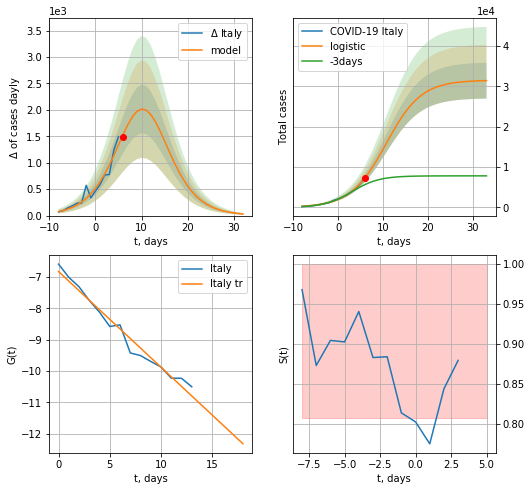

Italy data at: 2020-08-02
+3 day model MAPE: 0.4426444096966454
model: logistic
coeffs:  [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.1414781796365507
forecast at the end of period: +27 days
	 deltaDaycases:  29
	 total cases:  31395 ± 4441
	 total death:  4448 ± 1887
trend coefficient of determination: 0.972594
 intercept: -6.827533
 slope: -0.305163


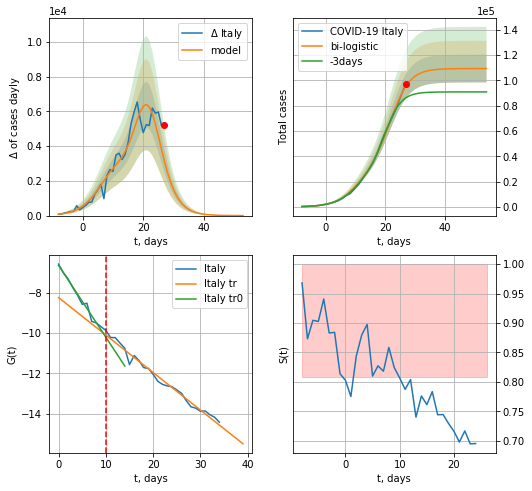

Italy data at: 2020-08-02
+3 day model MAPE: 0.1273932630183904
model: bi-logistic
coeffs:  [7.78644566e+04 3.07215545e-01 2.18188310e+01] [3.14978219e+04 2.56455865e-01 1.06869170e+01]
rational stdev:  0.10049358712471239
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  109357 ± 10989
	 total death:  15497 ± 4672
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:311: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:353: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


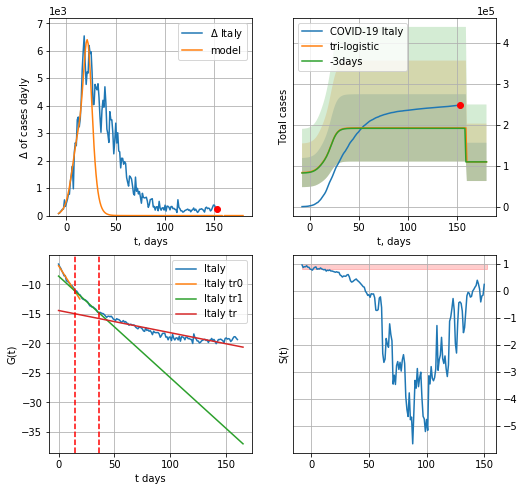

Italy data at: 2020-08-02
+3 day model MAPE: 0.005466969968518557
model: tri-logistic
coeffs:  [ 8.30131314e+04 -4.97497154e+01  1.59638504e+02] [3.14978219e+04 2.56455865e-01 1.06869170e+01 7.78644566e+04
 3.07215545e-01 2.18188310e+01]
forecast rational stdev:  0.42722808113738237
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  109362 ± 46722
	 total death:  15497 ± 19862
tri-logistic approximation splitting points: 15,36
trend0 coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498
trend1 coefficient of determination: 0.980669
 intercept: -8.621660
 slope: -0.172200
trend coefficient of determination: 0.827062
 intercept: -14.448455
 slope: -0.037627


In [4047]:
vL = 15#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0)#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=False,xcoef=[.35,1.,1.5],vL=[vL,vL1])

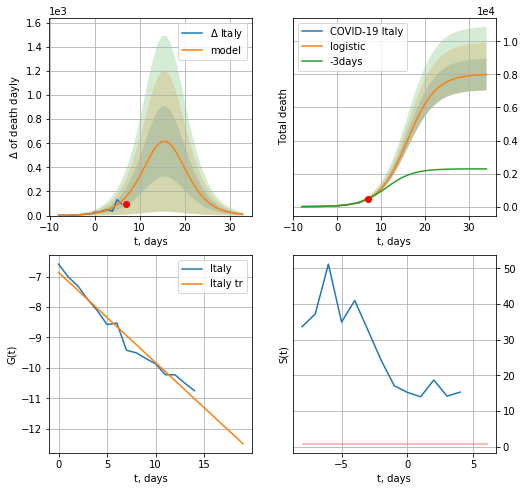

Italy data at: 2020-08-02
+3 day model MAPE: 0.04050488963495004
model: logistic
coeffs:  [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12009378173020563
forecast at the end of period: +27 days
	 total death:  7991 ± 959
trend coefficient of determination: 0.972806
 intercept: -6.865084
 slope: -0.296498


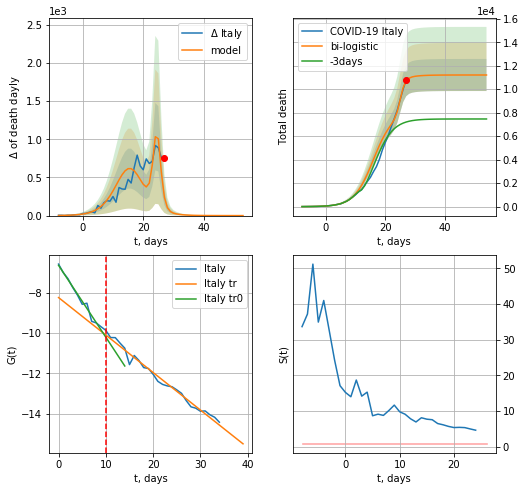

Italy data at: 2020-08-02
+3 day model MAPE: 0.5045402783114736
model: bi-logistic
coeffs:  [3.18986478e+03 1.24682064e+00 2.50159742e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01]
rational stdev:  0.12176299197618909
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  11211 ± 1365
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.980937
 intercept: -6.650494
 slope: -0.355987
trend coefficient of determination: 0.983083
 intercept: -8.246651
 slope: -0.185682


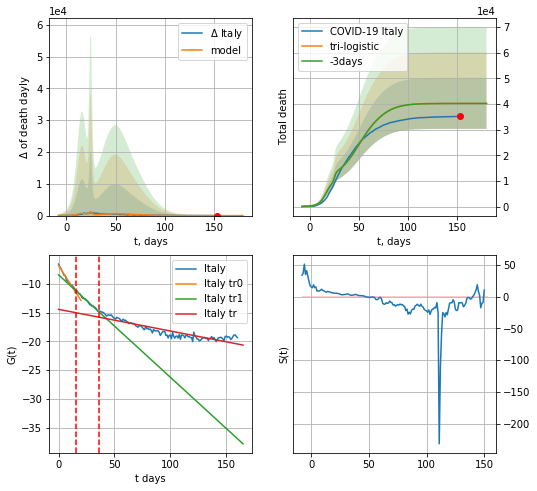

Italy data at: 2020-08-02
+3 day model MAPE: 0.0011259590739237072
model: tri-logistic
coeffs:  [2.32107463e+04 9.76552888e-02 4.85498983e+01] [8.02165383e+03 3.09187965e-01 1.60041387e+01 3.18986478e+03
 1.24682064e+00 2.50159742e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
forecast rational stdev:  0.24692805163694842
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  40224 ± 9932
tri-logistic approximation splitting points: 16,36
trend0 coefficient of determination: 0.976775
 intercept: -6.838969
 slope: -0.302094
trend1 coefficient of determination: 0.986358
 intercept: -8.457993
 slope: -0.177909
trend coefficient of determination: 0.827062
 intercept: -14.448455
 slope: -0.037627


In [4048]:
vL = 16#len(dfSP[:])-11-dT
vL1=36
x = forecast('Italy',dfIT[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('Italy',dfIT[:vL1],d1,7*T18-dT,x,1.0,cases='death')#,addpred=True,xcoef=[.25,1.,1.8],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Italy",dfIT,d1,7*T18-dT, xx, shift=1.,addpred=True,xcoef=[.25,1.,1.5],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


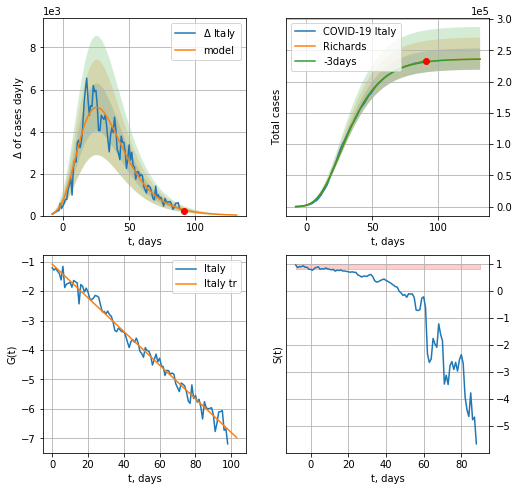

Italy data at: 2020-08-02
+3 day model MAPE: 0.001012
model: Richards
coeffs: [ 2.36456205e+05  5.89140521e+00 -5.11699403e+01  1.01015563e-02]
rational stdev: 0.072463
forecast at the end of period: +41 days
	 deltaDaycases: 26
	 total cases: 236024 ± 17103
	 total death: 33447 ± 7271
trend coefficient of determination: 0.985008
 intercept: -1.086112
 slope: -0.057138


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


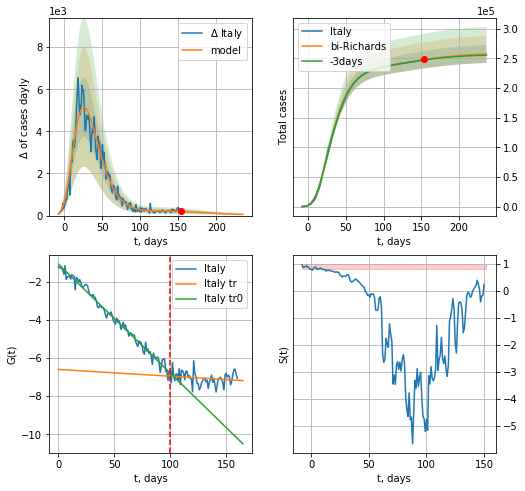

Italy data at: 2020-08-02
+3 day model MAPE: 0.001269
model: bi-Richards
coeffs: [ 2.35234333e+04  2.51144100e+00 -6.54673767e+01  9.10382070e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.058865
forecast at the end of period: +83 days
	 deltaDaycases: 54
	 total cases: 257497 ± 15157
	 total death: 36490 ± 6443
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.985393
 intercept: -1.077885
 slope: -0.057076
trend coefficient of determination: 0.034802
 intercept: -6.598733
 slope: -0.003542


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:62: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:183: RuntimeWarning: invalid value encountered in reduce
  arrmean = umr_sum(arr, axis, dtype, keepdims=True)


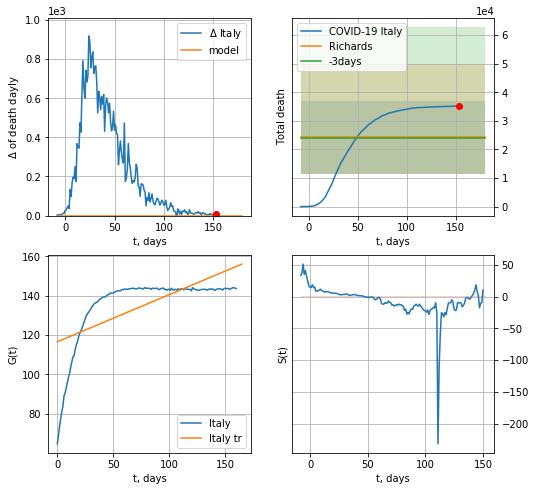

Italy data at: 2020-08-02
+3 day model MAPE: 0.008622
model: Richards
coeffs: [ 2.41885617e+04 -2.38661082e-01 -1.92857505e+01 -1.21229886e+01]
rational stdev: 0.533031
forecast at the end of period: +27 days
	 total death: 24188 ± 12893
trend coefficient of determination: 0.440377
 intercept: 116.570441
 slope: 0.239260


In [4049]:
vL=100
x = forecastRR('Italy',dfIT[:vL],d1,24*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Italy',dfIT[:],d1,30*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Italy',dfIT[:],d1,T18*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


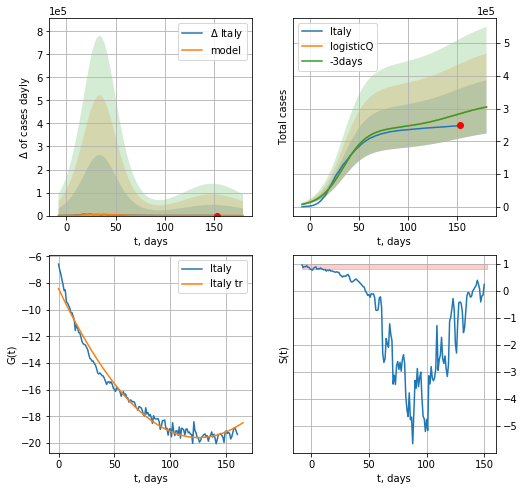

Italy data at: 2020-08-02
+3 day model MAPE: 0.000742
model: logisticQ
coeffs: [ 2.38163043e+05  2.13305844e-07  3.40185388e+01 -3.90786793e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.267373
forecast at the end of period: +27 days
	 deltaDaycases: 592
	 total cases: 304878 ± 81516
	 total death: 43204 ± 34654
trend coefficient of determination: 0.979517
 intercept_: -8.431302984033625
 coeffs_: [ 0.         -0.17805833  0.00070985]


In [4050]:
x = forecastRRR('Italy',dfIT[:],d1,7*T18-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


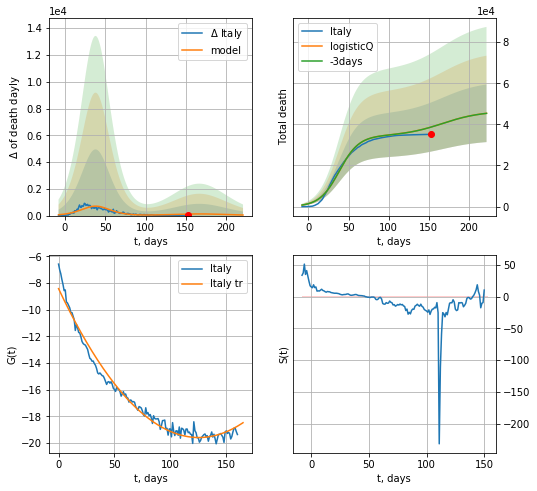

Italy data at: 2020-08-02
+3 day model MAPE: 0.000614
model: logisticQ
coeffs: [ 3.43624315e+04  1.87586724e-07  3.83597021e+01 -4.36844322e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.308622
forecast at the end of period: +69 days
	 total death: 45382 ± 14005
trend coefficient of determination: 0.979517
 intercept_: -8.431302984033625
 coeffs_: [ 0.         -0.17805833  0.00070985]


In [4051]:
x = forecastRRR('Italy',dfIT[:],d1,7*28-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

In [4052]:
dT

127

FR
           date     cases  active    death
165 2020-07-29  185196.0   73647  30238.0
166 2020-07-30  186573.0   74819  30254.0
167 2020-07-31  187919.0   76154  30265.0
168 2020-08-01  187919.0   76154  30265.0
169 2020-08-02  187919.0   76154  30265.0


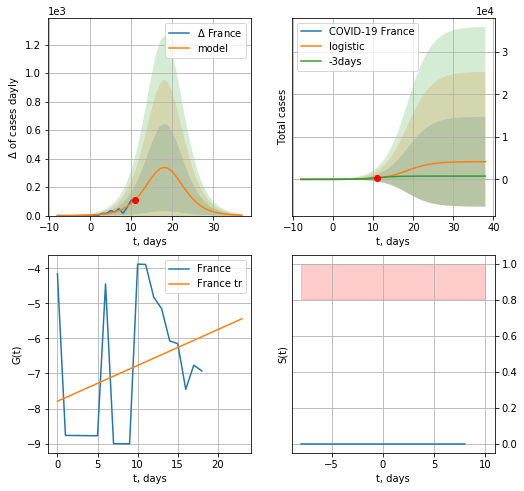

France data at: 2020-08-02
+3 day model MAPE: 0.04053351776025477
model: logistic
coeffs:  [4.17382756e+03 3.25568782e-01 1.85948993e+01]
rational stdev:  2.5390566064289986
forecast at the end of period: +27 days
	 deltaDaycases:  2
	 total cases:  4166 ± 10578
	 total death:  670 ± 5103
trend coefficient of determination: 0.083417
 intercept: -7.793073
 slope: 0.102246
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


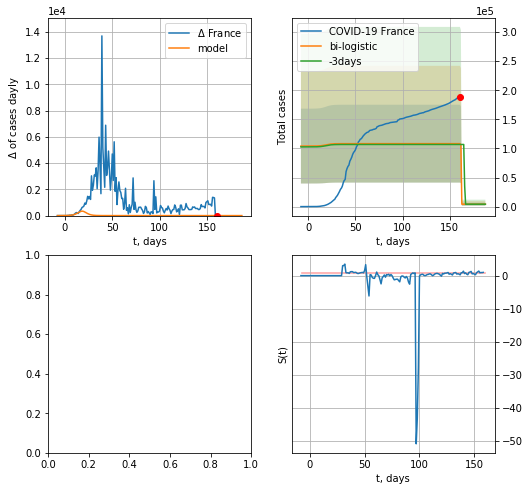

In [4054]:
# prideta 1990 2020-04-17
# prideta 3824 2020-04-18
dfFR = read_df(pd.DataFrame(),"FR")
vL=20
try:
    x = forecast('France',dfFR[:vL],d1,T18*7-dT,1.0)
    xx = forecast2('France',dfFR,d1,T18*7-dT,x,1.0,addpred=False,xcoef=[.25,1.,1.5],vL=vL)
except:
    print ("Exception occurs")

In [4055]:
#vL=len(dfFR)-9-5-dT
#x = forecast('France',dfFR[10:-9-dT],d1,7*5-dT-4,1.0)
#xx = forecast2('France',dfFR[10:],d1,7*7-dT-4,x,1.0,addpred=True,xcoef=[.25,1.,1.4],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

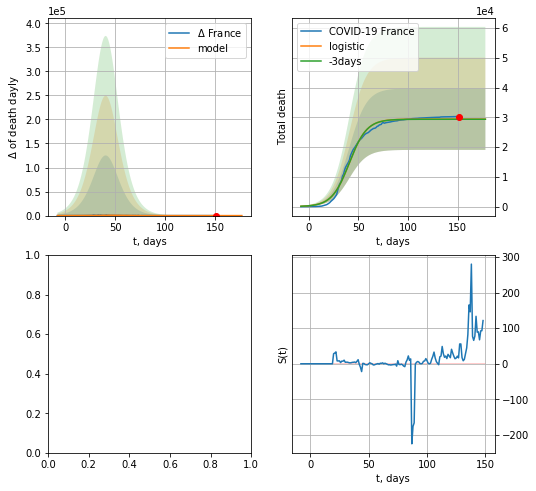

In [4056]:
#dfFR = read_df(pd.DataFrame(),"FR")
x = forecast('France',dfFR[10:],d1,7*T18-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


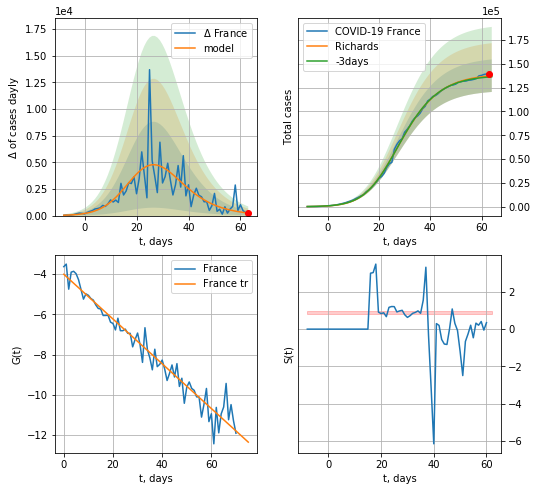

France data at: 2020-07-31
+3 day model MAPE: 0.007986
model: Richards
coeffs: [1.39530078e+05 2.42709601e-01 2.04374292e+01 4.70589913e-01]
rational stdev: 0.124192
forecast at the end of period: +1 days
	 deltaDaycases: 242
	 total cases: 137504 ± 17076
	 total death: 22145 ± 8250
trend coefficient of determination: 0.951177
 intercept: -4.003023
 slope: -0.111381


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


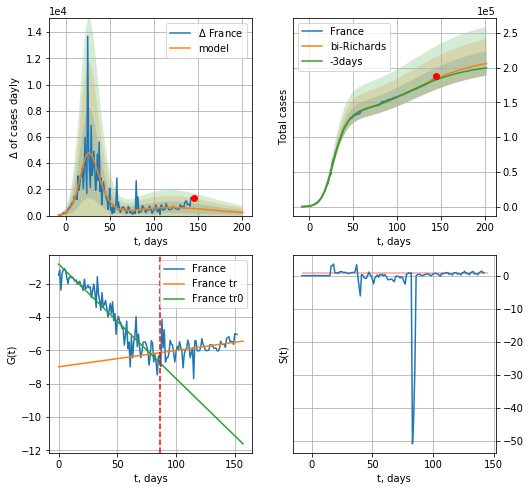

France data at: 2020-07-31
+3 day model MAPE: 0.008811
model: bi-Richards
coeffs: [ 7.80448382e+04  2.45147554e+00 -9.86104933e+01  8.87712117e-03]
rational stdev: 0.085151
forecast at the end of period: +57 days
	 deltaDaycases: 236
	 total cases: 205883 ± 17531
	 total death: 33158 ± 8470
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.903591
 intercept: -0.824639
 slope: -0.068697
trend coefficient of determination: 0.124930
 intercept: -6.987456
 slope: 0.009797


In [3250]:
vL = 86+14
x = forecastRR('France',dfFR[14:vL-14],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('France',dfFR[14:],d1,26*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-14)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


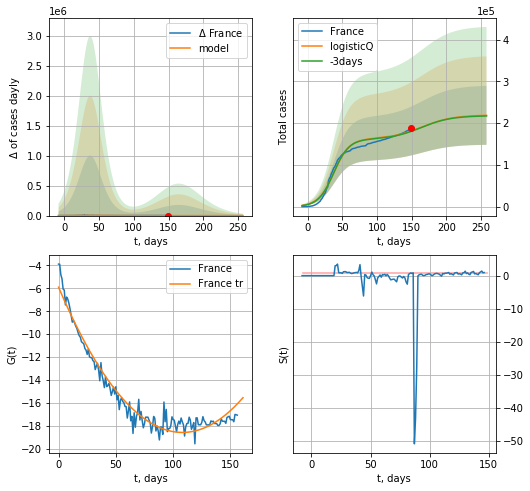

France data at: 2020-07-31
+3 day model MAPE: 0.004522
model: logisticQ
coeffs: [ 1.62226025e+05  1.10663159e-07  3.78881066e+01 -8.07074013e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322897
forecast at the end of period: +109 days
	 deltaDaycases: 39
	 total cases: 218809 ± 70652
	 total death: 35240 ± 34136
trend coefficient of determination: 0.959389
 intercept_: -5.898641911103935
 coeffs_: [ 0.         -0.23487031  0.00108627]


In [3251]:
x = forecastRRR('France',dfFR[10:],d1,34*7-dT-4,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


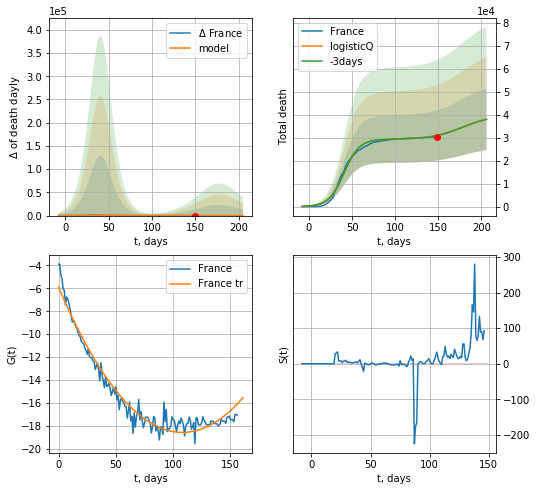

France data at: 2020-07-31
+3 day model MAPE: 0.001138
model: logisticQ
coeffs: [ 2.93619992e+04  2.80597785e-07  4.08127785e+01 -4.04907576e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.352923
forecast at the end of period: +57 days
	 total death: 38024 ± 13419
trend coefficient of determination: 0.959389
 intercept_: -5.898641911103935
 coeffs_: [ 0.         -0.23487031  0.00108627]


In [3252]:
x = forecastRRR('France',dfFR[10:],d1,26*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,3.,1.])

In [3253]:
#x = forecastR('France',dfFR[:],d1,8*7-dT-4,1.0,addpred=True,xcoef=[0.25,1.,20.,1])

In [3254]:
#trend3(dfGR,dfUS,dfGB[:],'GR','US','GB',40,40,40)

GR
           date   cases  active   death
156 2020-07-29  208811    7599  9212.0
157 2020-07-30  209653    8432  9221.0
158 2020-07-31  210665    7841  9224.0
159 2020-08-01  211077    8251  9226.0
160 2020-08-02  211462    8636  9226.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


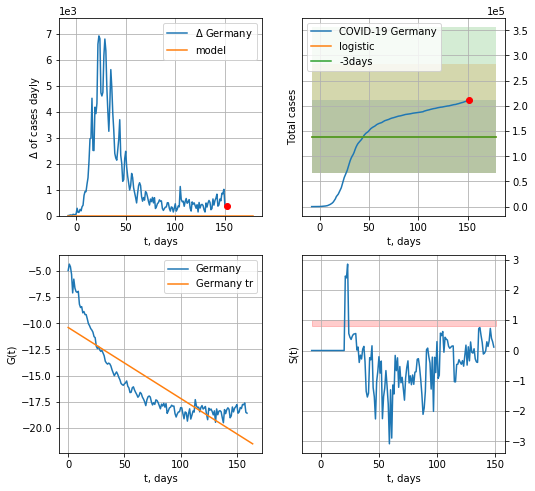

Germany data at: 2020-08-02
+3 day model MAPE: 0.010005212026225906
model: logistic
coeffs:  [ 1.38703460e+05 -7.19171721e+01  2.20269808e+02]
rational stdev:  0.5239555008684854
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  138703 ± 72674
	 total death:  6051 ± 9511
trend coefficient of determination: 0.702761
 intercept: -10.402667
 slope: -0.067634


In [4057]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[:],d1,7*T18-dT,1.0)
#xx = forecast2('Germany',dfGR,d1,7*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


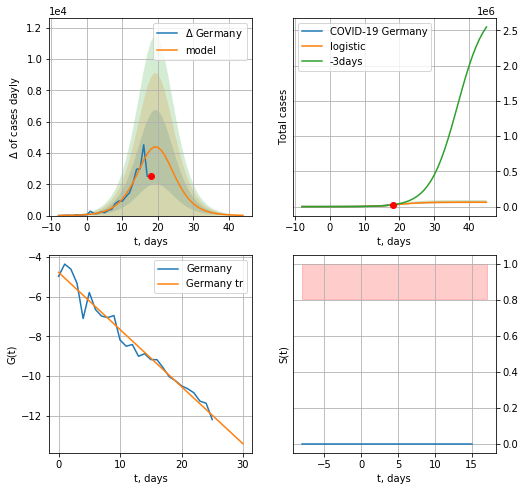

Germany data at: 2020-08-02
+3 day model MAPE: 0.1832688253569737
model: logistic
coeffs:  [6.15503848e+04 2.86340373e-01 1.98405530e+01]
rational stdev:  0.17812668621711658
forecast at the end of period: +27 days
	 deltaDaycases:  15
	 total cases:  61504 ± 10955
	 total death:  2683 ± 1433
trend coefficient of determination: 0.966755
 intercept: -4.774386
 slope: -0.288157


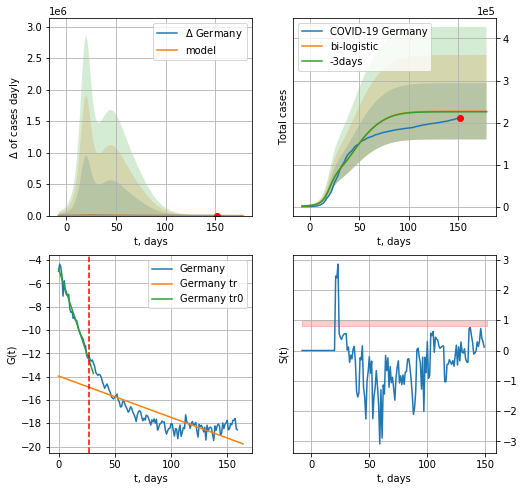

Germany data at: 2020-08-02
+3 day model MAPE: 0.005189473698665839
model: bi-logistic
coeffs:  [1.32201913e+05 9.07501777e-02 4.39252411e+01] [6.15503848e+04 2.86340373e-01 1.98405530e+01]
scenario coeffs:  [0.25, 1.0, 1.6]
rational stdev:  0.29503767003354
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  226800 ± 66914
	 total death:  9895 ± 8758
bi-logistic approximation splitting point: 27
trend0 coefficient of determination: 0.970316
 intercept: -4.764587
 slope: -0.289333
trend coefficient of determination: 0.662147
 intercept: -13.958427
 slope: -0.035416


In [4058]:
vL = 27
x = forecast('Germany',dfGR[:vL],d1,T18*7-dT,1.0)#,addpred=True,xcoef=[0.25,1.,2.0,1])
xx = forecast2('Germany',dfGR,d1,7*T18-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.6],vL=vL)

GR
           date   cases  active   death
156 2020-07-29  208811    7599  9212.0
157 2020-07-30  209653    8432  9221.0
158 2020-07-31  210665    7841  9224.0
159 2020-08-01  211077    8251  9226.0
160 2020-08-02  211462    8636  9226.0


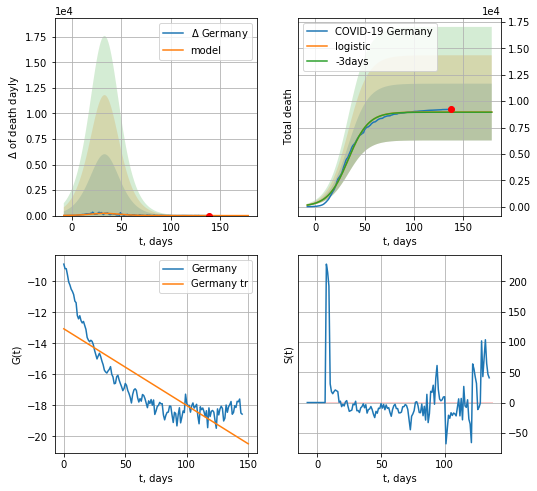

Germany data at: 2020-08-02
+3 day model MAPE: 0.0014149585120108435
model: logistic
coeffs:  [8.96703878e+03 9.79435275e-02 3.35761853e+01]
rational stdev:  0.30012644831393853
forecast at the end of period: +41 days
	 total death:  8967 ± 2691
trend coefficient of determination: 0.684935
 intercept: -13.058830
 slope: -0.049529


In [4059]:
dfGR = read_df(pd.DataFrame(),"GR")
x = forecast('Germany',dfGR[14:],d1,24*7-dT,1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


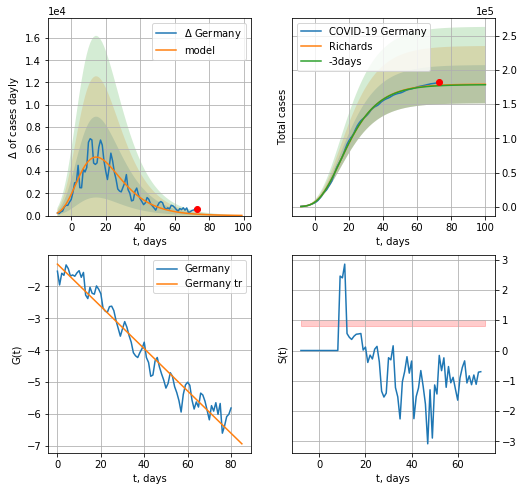

Germany data at: 2020-08-02
+3 day model MAPE: 0.003910
model: Richards
coeffs: [ 1.79110642e+05  9.15687169e+00 -4.39392677e+01  8.78226811e-03]
rational stdev: 0.155919
forecast at the end of period: +27 days
	 deltaDaycases: 16
	 total cases: 178919 ± 27896
	 total death: 7806 ± 3651
trend coefficient of determination: 0.956451
 intercept: -1.304276
 slope: -0.066178


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


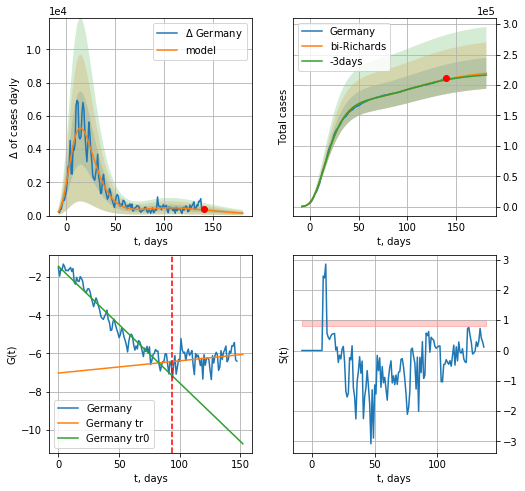

Germany data at: 2020-08-02
+3 day model MAPE: 0.004849
model: bi-Richards
coeffs: [ 4.56894579e+04  3.61424247e+00 -6.88926027e+01  7.63441121e-03]
rational stdev: 0.115977
forecast at the end of period: +41 days
	 deltaDaycases: 148
	 total cases: 219126 ± 25413
	 total death: 9560 ± 3326
bi-Richards approximation splitting point: 94
trend coefficient of determination: 0.950727
 intercept: -1.435518
 slope: -0.061173
trend coefficient of determination: 0.045812
 intercept: -7.026526
 slope: 0.006414


In [4060]:
vL = 94+12
x = forecastRR('Germany',dfGR[12:vL-12],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Germany',dfGR[12:],d1,24*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


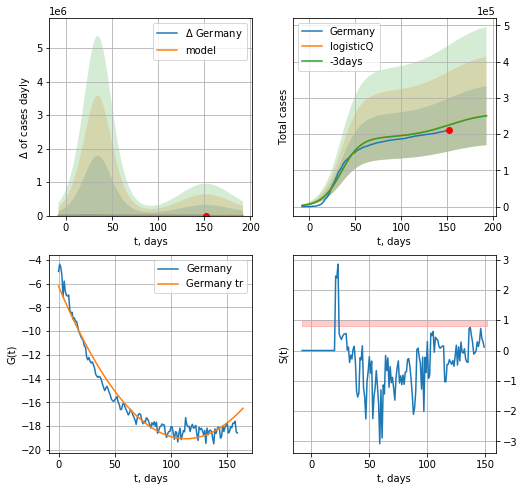

Germany data at: 2020-08-02
+3 day model MAPE: 0.001706
model: logisticQ
coeffs: [ 1.91721088e+05  1.50081975e-07  3.48942870e+01 -6.29563140e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324728
forecast at the end of period: +41 days
	 deltaDaycases: 359
	 total cases: 251127 ± 81548
	 total death: 10956 ± 10673
trend coefficient of determination: 0.965020
 intercept_: -6.215169080135011
 coeffs_: [ 0.         -0.22665401  0.00100013]


In [4061]:
x = forecastRRR('Germany',dfGR[:],d1,24*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.0,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


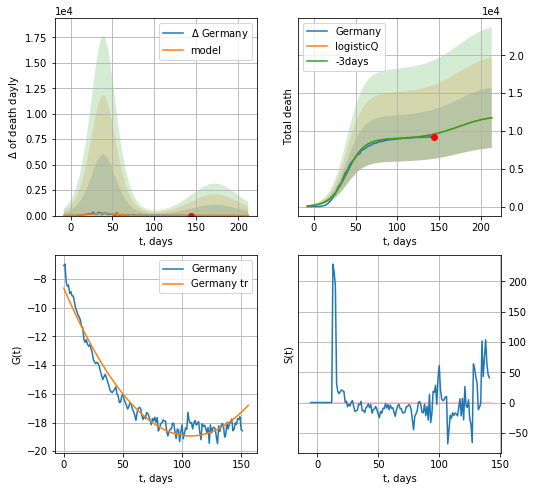

Germany data at: 2020-08-02
+3 day model MAPE: 0.001127
model: logisticQ
coeffs: [ 8.96587262e+03  2.85002679e-07  3.95755893e+01 -3.44220471e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.339913
forecast at the end of period: +69 days
	 total death: 11762 ± 3998
trend coefficient of determination: 0.960590
 intercept_: -8.631251522926288
 coeffs_: [ 0.         -0.19229503  0.00089708]


In [4062]:
x = forecastRRR('Germany',dfGR[8:],d1,28*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.0,1])

US
           date    cases   active     death
150 2020-07-29  4568375  2169006  153848.0
151 2020-07-30  4634985  2194735  155285.0
152 2020-07-31  4705889  2221570  156747.0
153 2020-08-01  4764588  2243518  157905.0
154 2020-08-02  4813647  2275065  158365.0


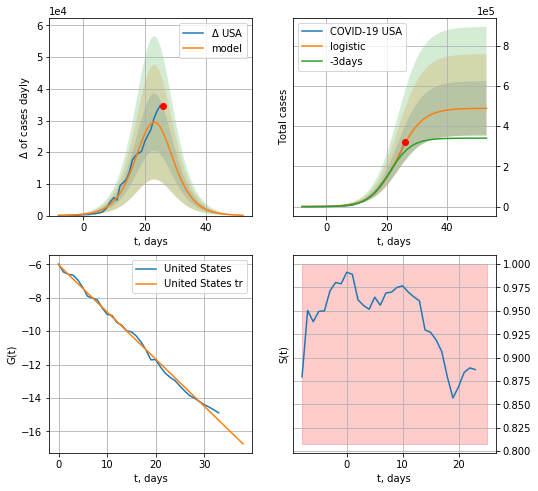

USA data at: 2020-08-02
+3 day model MAPE: 0.17962965905806133
model: logistic
coeffs:  [4.89025787e+05 2.41973856e-01 2.36121759e+01]
rational stdev:  0.27607026078318453
forecast at the end of period: +27 days
	 deltaDaycases:  109
	 total cases:  488627 ± 134895
	 total death:  16075 ± 13313
trend coefficient of determination: 0.995387
 intercept: -6.036925
 slope: -0.281840


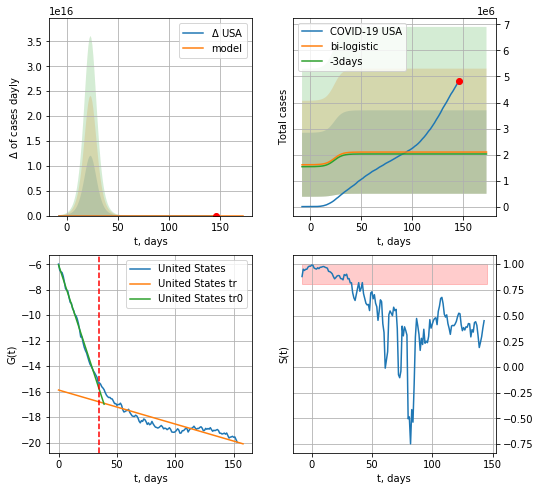

USA data at: 2020-08-02
+3 day model MAPE: 0.036424151646649396
model: bi-logistic
coeffs:  [ 1.28594091e+06 -1.56888494e+01  3.83202524e+02] [4.89025787e+05 2.41973856e-01 2.36121759e+01]
scenario coeffs:  [0.25, 1.0, 1.5]
rational stdev:  0.7645662968168107
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2096451 ± 1602876
	 total death:  68971 ± 158198
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.995488
 intercept: -6.051468
 slope: -0.280518
trend coefficient of determination: 0.776449
 intercept: -15.877912
 slope: -0.026732


In [4063]:
vL=35
dfUS = read_df(pd.DataFrame(),"US")
x = forecast('USA',dfUS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=[0.25,1.,2.])
xx = forecast2('USA',dfUS[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.5],vL=vL)

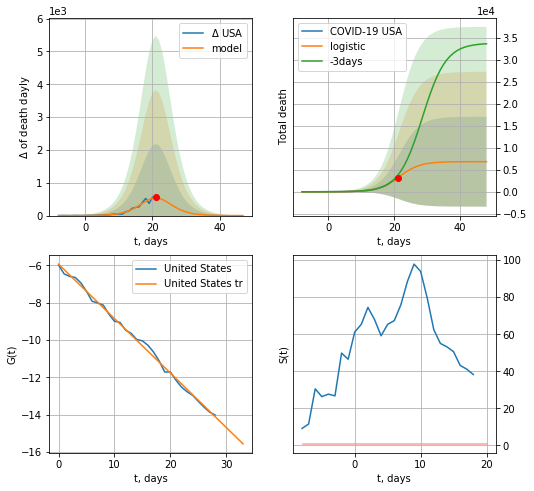

USA data at: 2020-08-02
+3 day model MAPE: 0.21421329662103625
model: logistic
coeffs:  [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  1.4929056707100332
forecast at the end of period: +27 days
	 total death:  6832 ± 10200
trend coefficient of determination: 0.996549
 intercept: -5.938291
 slope: -0.291586


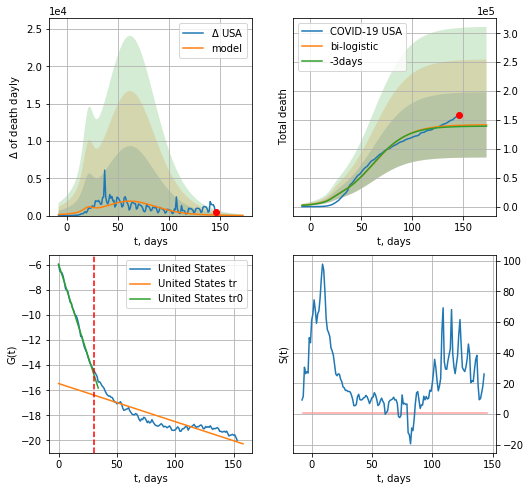

USA data at: 2020-08-02
+3 day model MAPE: 0.015416283995983332
model: bi-logistic
coeffs:  [1.34925008e+05 5.74254949e-02 6.22218049e+01] [6.83398319e+03 3.16137728e-01 2.14876356e+01]
rational stdev:  0.3993737385056303
forecast at the end of period: +27 days
	 deltaDaydeath:  13
	 total death:  141526 ± 56521
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.996707
 intercept: -5.949158
 slope: -0.290421
trend coefficient of determination: 0.763559
 intercept: -15.463416
 slope: -0.030402


In [4064]:
vL=30
x = forecast('USA',dfUS[:vL],d1,7*T18-dT,1.0,cases='death')
xx = forecast2('USA',dfUS,d1,7*T18-dT,x,1.0,cases='death',vL=vL)
#x = forecast('USA',dfUS[:],d1,28*3-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


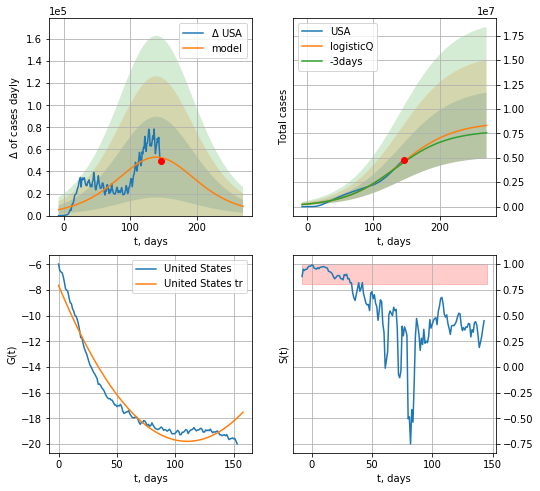

USA data at: 2020-08-02
+3 day model MAPE: 0.021270
model: logisticQ
coeffs: [ 8.59539872e+06  2.09497386e-07  1.39712549e+02 -1.17257386e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.404514
forecast at the end of period: +125 days
	 deltaDaycases: 8382
	 total cases: 8315113 ± 3363578
	 total death: 273560 ± 331976
trend coefficient of determination: 0.949966
 intercept_: -7.6421038468200635
 coeffs_: [ 0.         -0.22018977  0.00099846]


In [4065]:
x = forecastRRR('USA',dfUS[:],d1,7*36-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


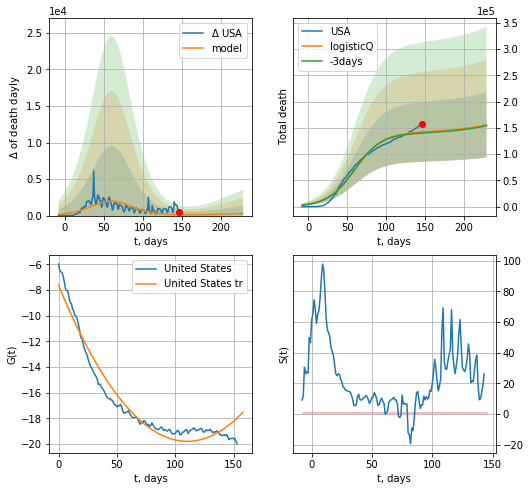

USA data at: 2020-08-02
+3 day model MAPE: 0.015052
model: logisticQ
coeffs: [ 1.41553758e+05  9.31576676e-08  6.00865483e+01 -6.02720263e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.399692
forecast at the end of period: +83 days
	 total death: 155735 ± 62246
trend coefficient of determination: 0.949966
 intercept_: -7.6421038468200635
 coeffs_: [ 0.         -0.22018977  0.00099846]


In [4066]:
x = forecastRRR('USA',dfUS[:],d1,7*30-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[0.35,.5,3.,1.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


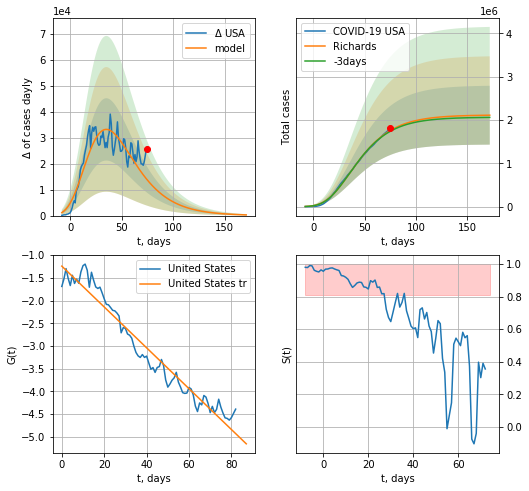

USA data at: 2020-08-02
+3 day model MAPE: 0.011172
model: Richards
coeffs: [ 2.11547275e+06  4.55740072e+00 -7.32299429e+01  9.40207859e-03]
rational stdev: 0.321873
forecast at the end of period: +97 days
	 deltaDaycases: 268
	 total cases: 2109334 ± 678937
	 total death: 69395 ± 67009
trend coefficient of determination: 0.952323
 intercept: -1.242017
 slope: -0.044961


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


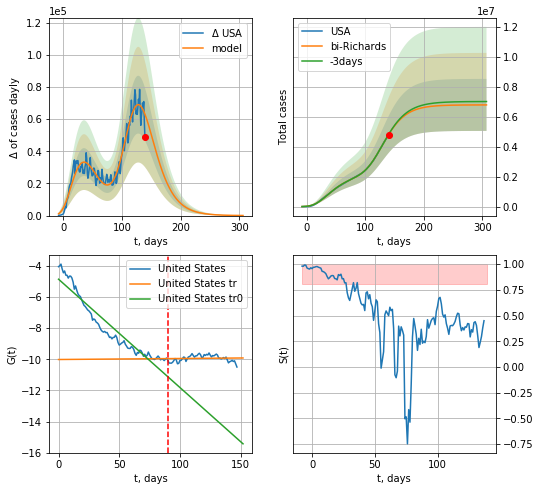

USA data at: 2020-08-02
+3 day model MAPE: 0.002804
model: bi-Richards
coeffs: [4.68381316e+06 1.20700104e-01 1.08221321e+02 3.84199143e-01]
rational stdev: 0.255692
forecast at the end of period: +167 days
	 deltaDaycases: 58
	 total cases: 6798057 ± 1738208
	 total death: 223650 ± 171556
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.908744
 intercept: -4.853479
 slope: -0.069597
trend coefficient of determination: 0.002725
 intercept: -10.013883
 slope: 0.000646


In [4067]:
iL = 6
vL = 90+iL
x = forecastRR('USA',dfUS[iL:vL-iL],d1,7*32-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('USA',dfUS[iL:],d1,7*42-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4068]:
#x = forecastQR('USA',dfUS[20:],d1,7*18-dT,1.0,addpred=False,xcoef=[0.35,.5,3.,1.,1.])

GB
           date   cases  active    death
154 2020-07-29  301455       0  45961.0
155 2020-07-30  302301       0  45999.0
156 2020-07-31  303181       0  46119.0
157 2020-08-01  303952       0  46193.0
158 2020-08-02  304695       0  46201.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


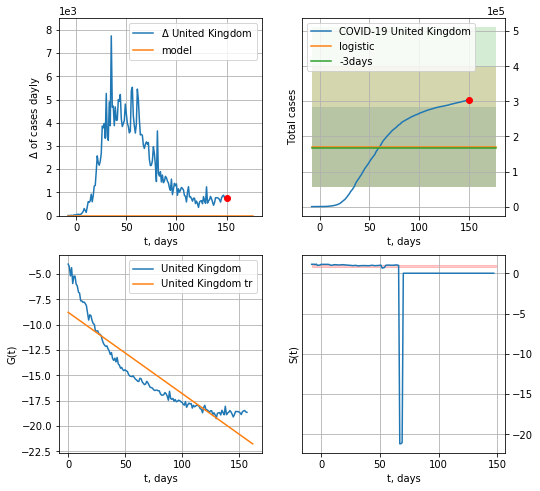

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.01534326884676949
model: logistic
coeffs:  [ 1.70200359e+05 -9.44176007e+00  2.42697415e+02]
rational stdev:  0.669942016640821
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  170200 ± 114024
	 total death:  25807 ± 51867
trend coefficient of determination: 0.830504
 intercept: -8.785672
 slope: -0.080013


In [4069]:
dfGB = read_df(pd.DataFrame(),"GB")
x = forecast('United Kingdom',dfGB[:],d1,7*T18-dT,1.)
#x = forecast('United Kingdom',dfGB[:-8-dT],d1,4*7-dT,1.)
#xx = forecast2('United Kingdom',dfGB[:],d1,4*7-dT,x,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


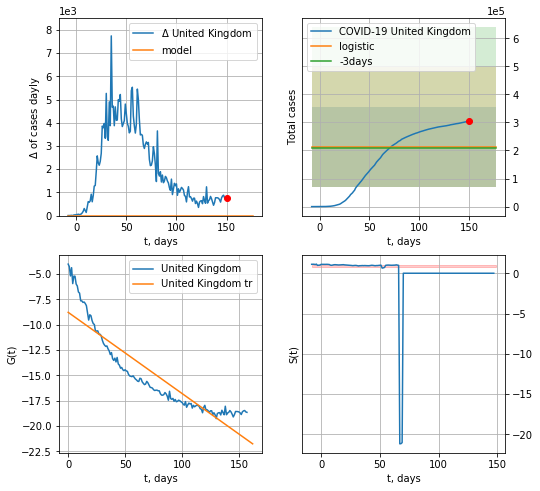

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.01534326884676949
model: logistic
coeffs:  [ 1.70200359e+05 -9.44176007e+00  2.42697415e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.669942016640821
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  212750 ± 142530
	 total death:  32259 ± 64834
trend coefficient of determination: 0.830504
 intercept: -8.785672
 slope: -0.080013


In [4070]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,addpred=True,xcoef=[0.25,1.,1.8])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


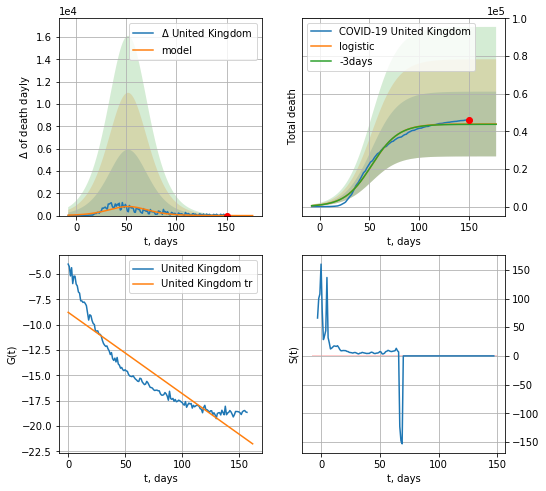

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.003662473977126282
model: logistic
coeffs:  [4.39079615e+04 7.42152721e-02 5.22006724e+01]
rational stdev:  0.39193278891465494
forecast at the end of period: +27 days
	 total death:  43903 ± 17207
trend coefficient of determination: 0.830504
 intercept: -8.785672
 slope: -0.080013


In [4071]:
x = forecast('United Kingdom',dfGB[:],d1,T18*7-dT,1.,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


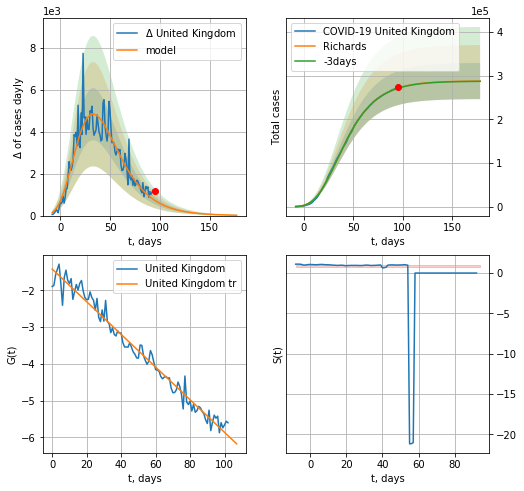

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.001530
model: Richards
coeffs: [ 2.88040344e+05  3.82469918e+00 -6.26359665e+01  1.20178265e-02]
rational stdev: 0.143621
forecast at the end of period: +83 days
	 deltaDaycases: 17
	 total cases: 287663 ± 41314
	 total death: 43618 ± 18793
trend coefficient of determination: 0.974342
 intercept: -1.421044
 slope: -0.044452


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


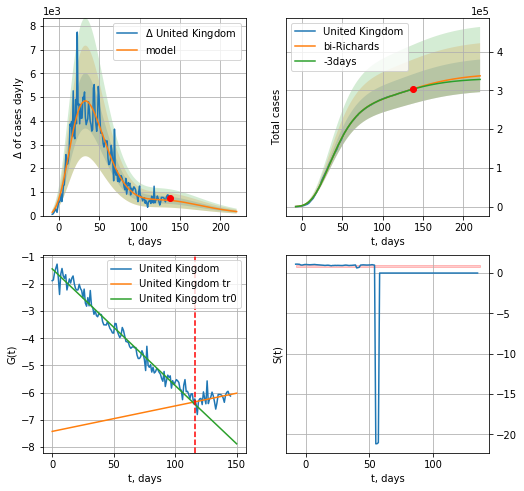

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.002332
model: bi-Richards
coeffs: [ 5.63403998e+04  2.96764997e+00 -3.82287330e+01  8.82101334e-03]
rational stdev: 0.124619
forecast at the end of period: +83 days
	 deltaDaycases: 170
	 total cases: 337560 ± 42066
	 total death: 51184 ± 19135
bi-Richards approximation splitting point: 116
trend coefficient of determination: 0.976753
 intercept: -1.439765
 slope: -0.043006
trend coefficient of determination: 0.129675
 intercept: -7.432994
 slope: 0.009391


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: divide by zero encountered in true_divide


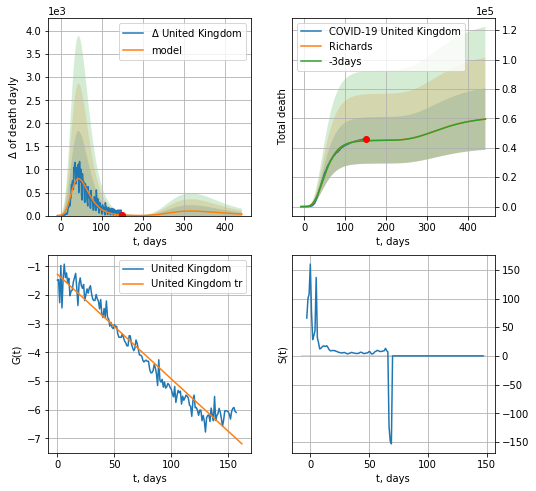

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.002514
model: Richards
coeffs: [ 4.51532868e+04  8.01305983e+00 -6.17957845e+01  6.02506232e-03]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.350726
forecast at the end of period: +293 days
	 total death: 59556 ± 20888
trend coefficient of determination: 0.949688
 intercept: -1.274700
 slope: -0.036492


In [4072]:
vL = 116+12
x = forecastRR('United Kingdom',dfGB[12:vL-12],d1,30*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('United Kingdom',dfGB[12:],d1,30*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
x = forecastRR('United Kingdom',dfGB[:],d1,60*7-dT,1.,addpred=True,xcoef=RkoreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


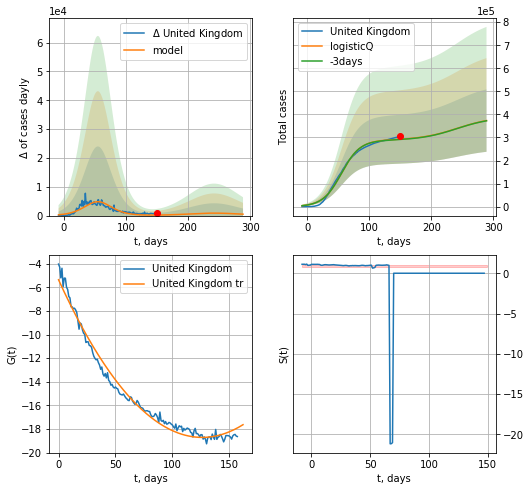

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.004392
model: logisticQ
coeffs: [ 2.88505834e+05  1.56475690e-07  5.55241679e+01 -4.25961964e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.362913
forecast at the end of period: +139 days
	 deltaDaycases: 491
	 total cases: 373175 ± 135429
	 total death: 56584 ± 61605
trend coefficient of determination: 0.982645
 intercept_: -5.358999136361996
 coeffs_: [ 0.         -0.21180982  0.00083947]


In [4073]:
x = forecastRRR('United Kingdom',dfGB[:],d1,38*7-dT,1.,addpred=True,xcoef=koreaCoeffs)#[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


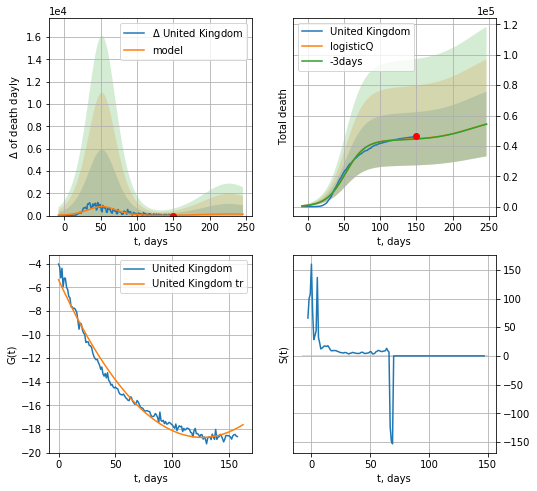

United Kingdom data at: 2020-08-02
+3 day model MAPE: 0.003646
model: logisticQ
coeffs: [ 4.39078193e+04  1.47533289e-07  5.22018023e+01 -5.02847610e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391955
forecast at the end of period: +97 days
	 total death: 54390 ± 21318
trend coefficient of determination: 0.982645
 intercept_: -5.358999136361996
 coeffs_: [ 0.         -0.21180982  0.00083947]


In [4074]:
x = forecastRRR('United Kingdom',dfGB[:],d1,32*7-dT,1.,addpred=True,xcoef=koreaCoeffs,cases='death')

In [ ]:
#x = forecastQR('United Kingdom',dfGB[:],d1,18*7-dT,1.,addpred=True,xcoef=[0.35,.5,3,1,1])

In [ ]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,2.4,1])

In [ ]:
#trend3(dfDK,dfNG,dfSW[:],'DK','NG','SW',40,40,40)

In [ ]:
#x = forecastR('United Kingdom',dfGB[:],d1,20*7-dT,1.,addpred=True,xcoef=[0.25,1.,4.,1])

In [ ]:
#x = forecast('Denmark',dfDK[:15],d1,2*7-dT,1.0)
#xx = forecast2('Denmark',dfDK[:],d1,4*7-dT, x,1.0)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3('Denmark',dfDK[:],d1,14-dT, xx)

DK
           date    cases  active  death
153 2020-07-29  13634.0     535  614.0
154 2020-07-30  13725.0     584  615.0
155 2020-07-31  13789.0     596  615.0
156 2020-08-01  13789.0     596  615.0
157 2020-08-02  13789.0     596  615.0


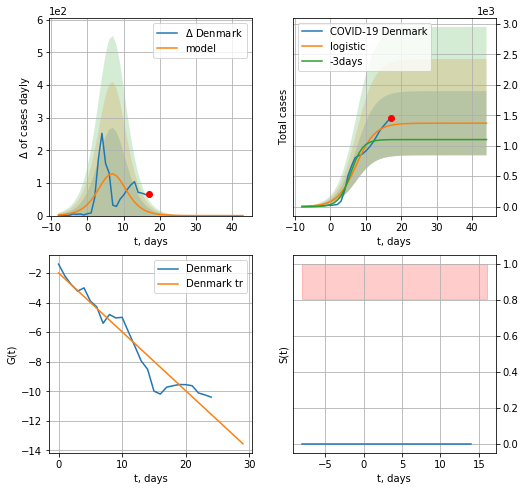

Denmark data at: 2020-08-02
+3 day model MAPE: 0.22309164797181072
model: logistic
coeffs:  [1.36966074e+03 3.75718857e-01 7.30059730e+00]
rational stdev:  0.3847660616131427
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1369 ± 526
	 total death:  61 ± 70
trend coefficient of determination: 0.928037
 intercept: -1.984791
 slope: -0.399221
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


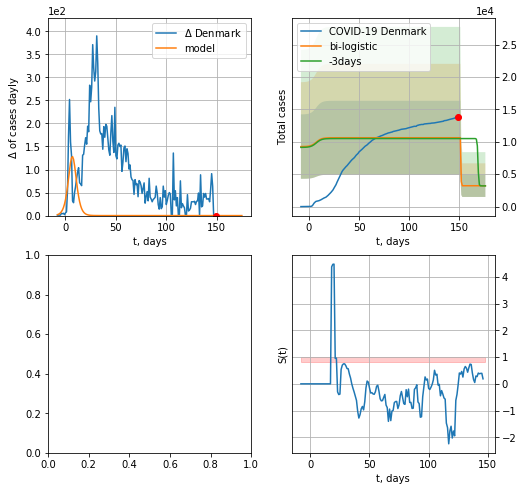

In [4075]:
dfDK = read_df(pd.DataFrame(),"DK")
vL = 26
try:
    x = forecast('Denmark',dfDK[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Denmark',dfDK[:],d1,T18*7-dT, x,1.0,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

In [4084]:
d12f(4)

'2020-07-30'

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


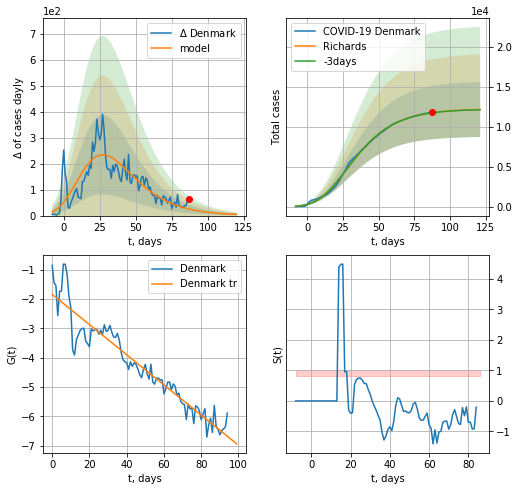

Denmark data at: 2020-08-02
+3 day model MAPE: 0.002072
model: Richards
coeffs: [ 1.22659587e+04  7.57412552e-01 -2.17374784e+01  7.08529699e-02]
rational stdev: 0.283101
forecast at the end of period: +34 days
	 deltaDaycases: 4
	 total cases: 12184 ± 3449
	 total death: 543 ± 461
trend coefficient of determination: 0.907675
 intercept: -1.842227
 slope: -0.051439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


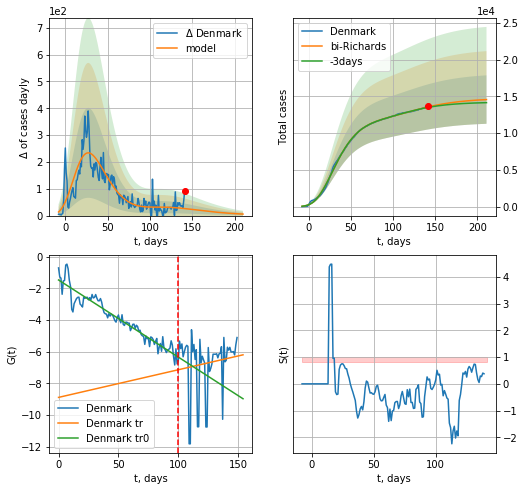

Denmark data at: 2020-07-30
+3 day model MAPE: 0.005662
model: bi-Richards
coeffs: [ 2.50835340e+03  2.88602370e+00 -2.95699795e+01  1.02165555e-02]
rational stdev: 0.226220
forecast at the end of period: +69 days
	 deltaDaycases: 5
	 total cases: 14577 ± 3297
	 total death: 650 ± 441
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.911734
 intercept: -1.479831
 slope: -0.048690
trend coefficient of determination: 0.019462
 intercept: -8.892414
 slope: 0.017450


In [4087]:
vL = 100+4
x = forecastRR('Denmark',dfDK[4:vL-4],d1,23*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Denmark',dfDK[4:-3],d12f(4),28*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)
#x2 = forecast2R('Denmark',dfDK[:],d1,16*7-dT,x,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


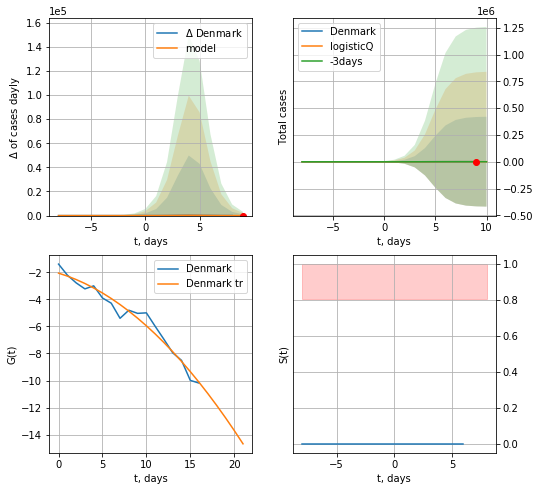

Denmark data at: 2020-07-31
+3 day model MAPE: 2.879608
model: logisticQ
coeffs: [ 8.62480486e+02  2.49394711e-04  4.73670535e+00 -4.50101209e+03]
rational stdev: 487.273007
forecast at the end of period: +1 days
	 deltaDaycases: 4
	 total cases: 860 ± 419139
	 total death: 38 ± 55549
trend coefficient of determination: 0.965266
 intercept_: -2.0557034713075613
 coeffs_: [ 0.         -0.1970759  -0.01925246]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


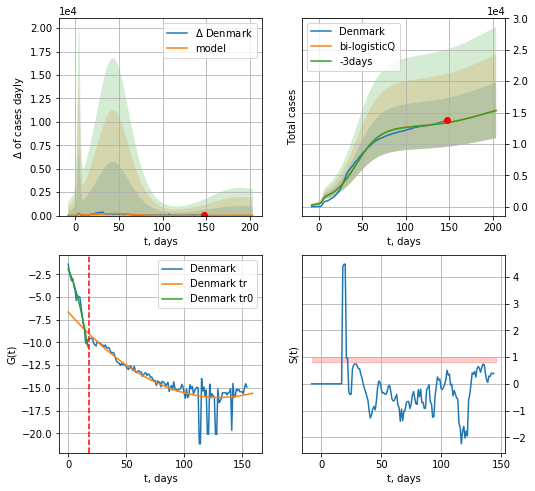

Denmark data at: 2020-07-31
+3 day model MAPE: 0.004280
model: bi-logisticQ
coeffs: [ 1.18420349e+04  1.26524792e-07  4.35857917e+01 -5.84674575e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.289271
forecast at the end of period: +57 days
	 deltaDaycases: 36
	 total cases: 15336 ± 4436
	 total death: 684 ± 593
bi-logisticQ approximation splitting point: 18
trend coefficient of determination: 0.963211
 intercept_: -1.9308894789691964
 coeffs_: [ 0.         -0.26605777 -0.01390014]
trend coefficient of determination: 0.779337
 intercept_: -6.643466499702098
 coeffs_: [ 0.         -0.14463081  0.00055597]


In [3278]:
x = forecastRRR('Denmark',dfDK[:18],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)#[0.35,0.5,4.5,1.])
x = forecast2RRR('Denmark',dfDK[:],d1,26*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=18)

NG
           date   cases  active  death
154 2020-07-29  9172.0     165  255.0
155 2020-07-30  9208.0     201  255.0
156 2020-07-31  9240.0     233  255.0
157 2020-08-01  9253.0     246  255.0
158 2020-08-02  9268.0     261  255.0


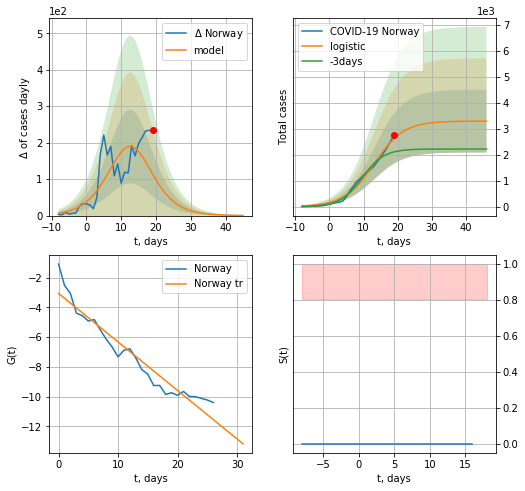

Norway data at: 2020-08-02
+3 day model MAPE: 0.28148190042351234
model: logistic
coeffs:  [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.36743919108062534
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  3296 ± 1211
	 total death:  90 ± 99
trend coefficient of determination: 0.927855
 intercept: -3.067798
 slope: -0.326083


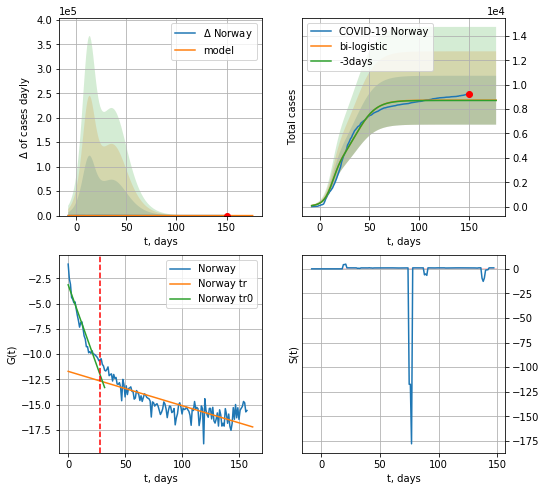

Norway data at: 2020-08-02
+3 day model MAPE: 0.0027597200739960625
model: bi-logistic
coeffs:  [5.43135214e+03 9.99988171e-02 3.70917481e+01] [3.29798793e+03 2.30651156e-01 1.30696563e+01]
rational stdev:  0.22954347110412932
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  8729 ± 2003
	 total death:  240 ± 165
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.643383
 intercept: -11.695513
 slope: -0.033896


In [4088]:
dfNG = read_df(pd.DataFrame(),"NG")
vL=28
x = forecast('Norway',dfNG[:vL],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,vL=vL)
#xx = np.concatenate((x, xx), axis=0)

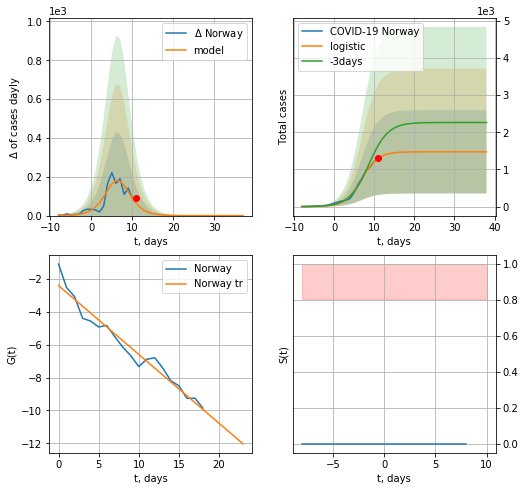

Norway data at: 2020-08-02
+3 day model MAPE: 0.24765534865647335
model: logistic
coeffs:  [1.47478892e+03 4.95866797e-01 6.87524750e+00]
rational stdev:  0.7596156046192828
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1474 ± 1120
	 total death:  40 ± 91
trend coefficient of determination: 0.956890
 intercept: -2.403448
 slope: -0.418410


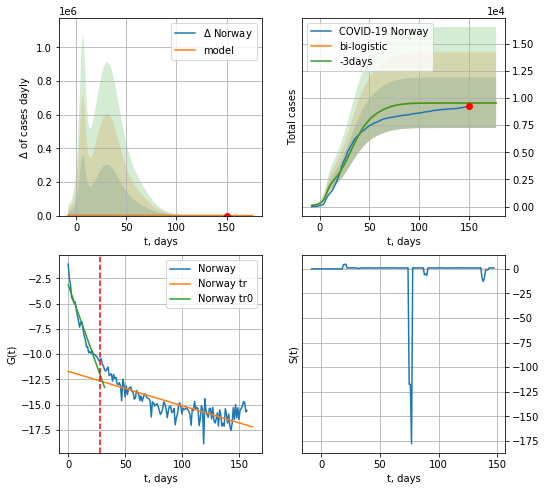

Norway data at: 2020-08-02
+3 day model MAPE: 0.002784985378925306
model: bi-logistic
coeffs:  [7.19354071e+03 1.07311641e-01 3.12158723e+01] [1.47478892e+03 4.95866797e-01 6.87524750e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.24336264919159784
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  9567 ± 2328
	 total death:  263 ± 192
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.925279
 intercept: -3.146002
 slope: -0.317060
trend coefficient of determination: 0.643383
 intercept: -11.695513
 slope: -0.033896


In [4089]:
vL = 28#len(dfNG)-13-dT
x = forecast('Norway',dfNG[:-12-dT],d1,7*T18-dT,1.0)
xx = forecast2('Norway',dfNG[:],d1,T18*7-dT,x,1.0,addpred=True,xcoef=[0.25/2,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


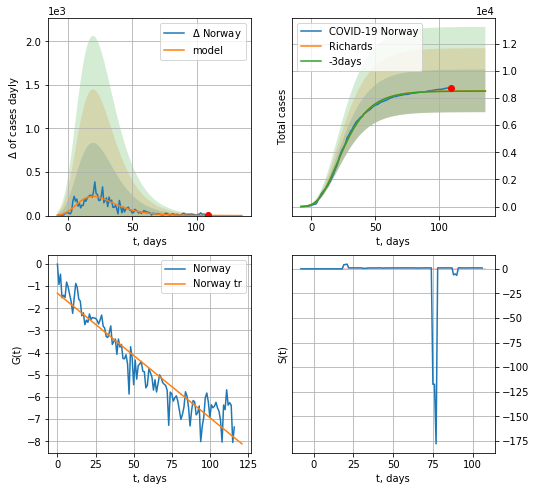

Norway data at: 2020-08-02
+3 day model MAPE: 0.002361
model: Richards
coeffs: [ 8.52499195e+03  9.37771031e+00 -4.88936203e+01  7.55410869e-03]
rational stdev: 0.184152
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 8522 ± 1569
	 total death: 234 ± 129
trend coefficient of determination: 0.896005
 intercept: -1.322492
 slope: -0.056086


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


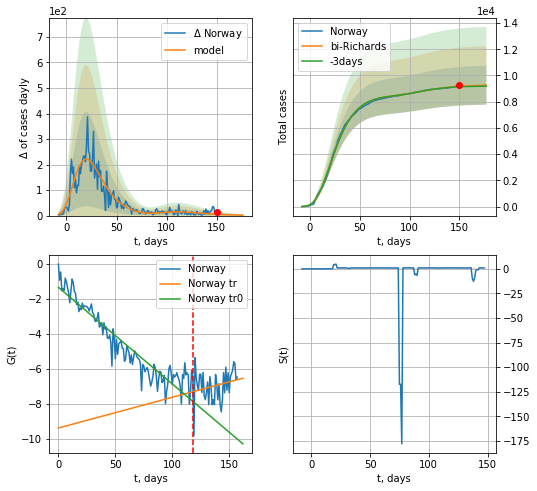

Norway data at: 2020-08-02
+3 day model MAPE: 0.004606
model: bi-Richards
coeffs: [7.63630820e+02 1.03160086e+01 2.11067734e+00 4.70596652e-03]
rational stdev: 0.160116
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 9255 ± 1482
	 total death: 254 ± 122
bi-Richards approximation splitting point: 118
trend coefficient of determination: 0.890070
 intercept: -1.334688
 slope: -0.055223
trend coefficient of determination: 0.051917
 intercept: -9.377430
 slope: 0.017575


In [4090]:
vL = 96+22
x = forecastRR('Norway',dfNG[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Norway',dfNG[:],d1,22*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Norway',dfNG[:],d1,8*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


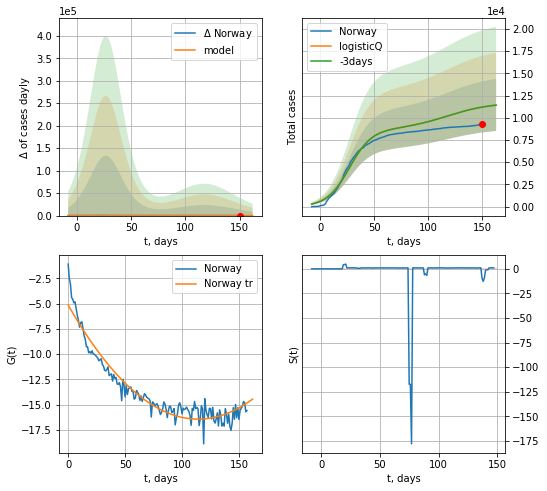

Norway data at: 2020-08-02
+3 day model MAPE: 0.001385
model: logisticQ
coeffs: [ 8.67301970e+03  1.67923951e-07  2.70462134e+01 -5.75898393e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.256134
forecast at the end of period: +13 days
	 deltaDaycases: 13
	 total cases: 11436 ± 2929
	 total death: 314 ± 241
trend coefficient of determination: 0.927113
 intercept_: -5.149018139766406
 coeffs_: [ 0.         -0.19743865  0.00086494]


In [4091]:
x = forecastRRR('Norway',dfNG[:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)#[.35,.5,4.,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


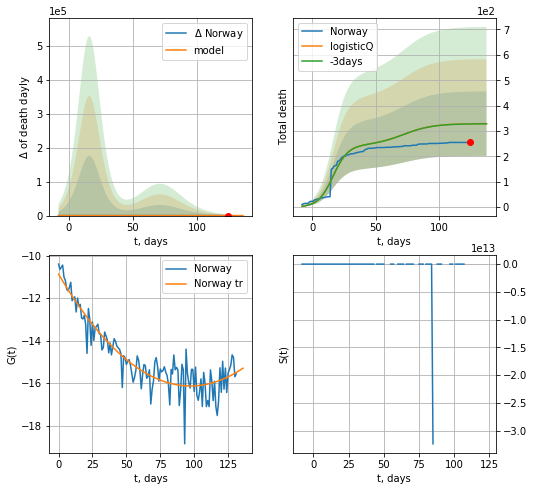

Norway data at: 2020-08-02
+3 day model MAPE: 0.001750
model: logisticQ
coeffs: [ 2.43254826e+02  5.25779818e-07  1.64326555e+01 -3.24898968e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.385915
forecast at the end of period: +13 days
	 total death: 329 ± 127
trend coefficient of determination: 0.846462
 intercept_: -10.875137241142284
 coeffs_: [ 0.         -0.10815091  0.00055612]


In [4092]:
x = forecastRRR('Norway',dfNG[26:],d1,20*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')#[.35,.5,4.,1])

SW
           date  cases  active   death
155 2020-07-29  79782       0  5730.0
156 2020-07-30  80100       0  5739.0
157 2020-07-31  80422       0  5743.0
158 2020-08-01  80422       0  5743.0
159 2020-08-02  80422       0  5743.0


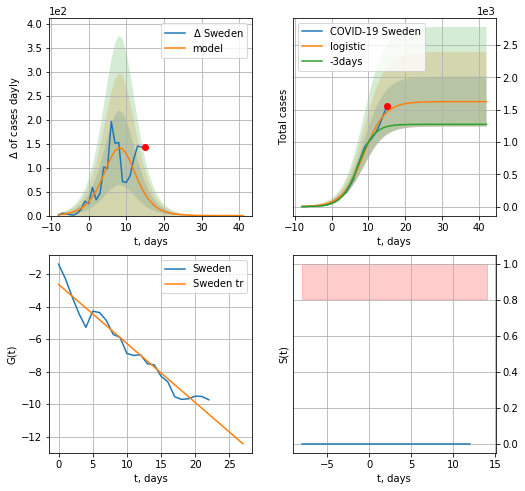

Sweden data at: 2020-08-02
+3 day model MAPE: 0.2037446768605221
model: logistic
coeffs:  [1.62331286e+03 3.49719159e-01 8.72648648e+00]
rational stdev:  0.2371580380027054
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1623 ± 384
	 total death:  115 ± 81
trend coefficient of determination: 0.947996
 intercept: -2.632493
 slope: -0.363132
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


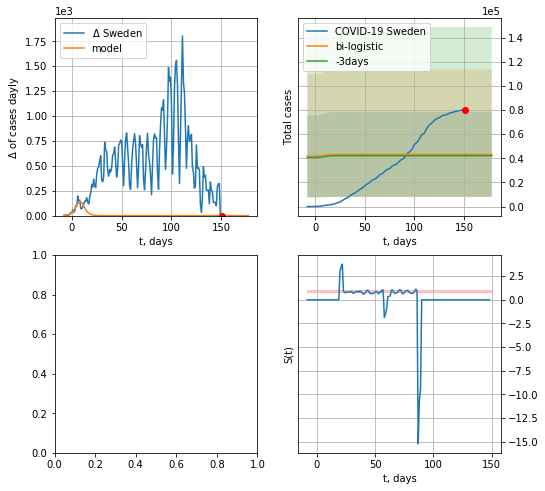

In [4093]:
vL = 15#len(dfSW)-12-dT
dfSW = read_df(pd.DataFrame(),"SW")
try:
    x = forecast('Sweden',dfSW[:-9-dT],d1,7*T18-dT,1.0)
    xx = forecast2('Sweden',dfSW[:],d1,7*T18-dT,x,1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)
except:
    print ("Exception occurs")

SW
           date  cases  active   death
153 2020-07-27  79395       0  5700.0
154 2020-07-28  79494       0  5702.0
155 2020-07-29  79782       0  5730.0
156 2020-07-30  80100       0  5739.0
157 2020-07-31  80422       0  5743.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


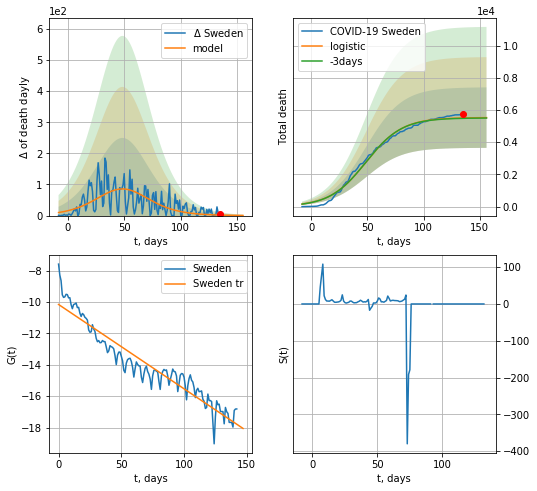

Sweden data at: 2020-07-31
+3 day model MAPE: 0.004364349716547669
model: logistic
coeffs:  [5.53390000e+03 6.19755811e-02 4.89221241e+01]
rational stdev:  0.3398530259505396
forecast at the end of period: +21 days
	 total death:  5526 ± 1878
trend coefficient of determination: 0.905517
 intercept: -10.153931
 slope: -0.053767


In [3285]:
dfSW = read_df(pd.DataFrame(),"SW")
x = forecast('Sweden',dfSW[14:],d1,3*7,shift=1.0,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


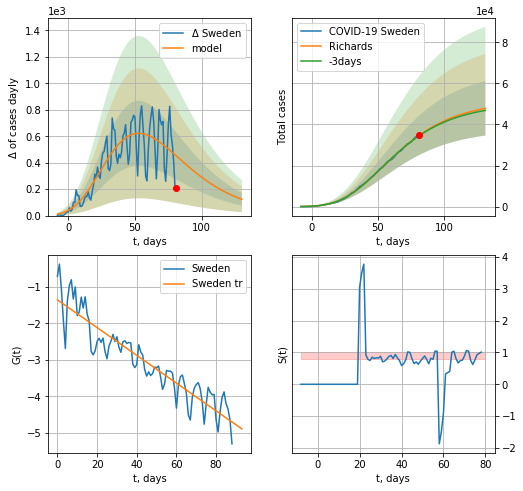

Sweden data at: 2020-07-31
+3 day model MAPE: 0.006966
model: Richards
coeffs: [ 5.16330878e+04  1.82860246e+00 -6.81695942e+01  1.80708945e-02]
rational stdev: 0.276601
forecast at the end of period: +50 days
	 deltaDaycases: 122
	 total cases: 47823 ± 13228
	 total death: 3415 ± 2833
trend coefficient of determination: 0.851661
 intercept: -1.351552
 slope: -0.038050


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


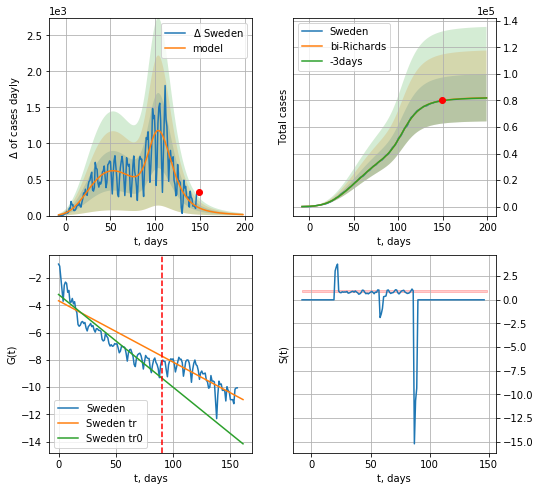

Sweden data at: 2020-07-31
+3 day model MAPE: 0.001624
model: bi-Richards
coeffs: [3.07908005e+04 2.42088258e-01 9.55495869e+01 4.00762974e-01]
rational stdev: 0.217078
forecast at the end of period: +50 days
	 deltaDaycases: 14
	 total cases: 82003 ± 17801
	 total death: 5855 ± 3812
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.878457
 intercept: -3.198960
 slope: -0.068041
trend coefficient of determination: 0.696962
 intercept: -3.658522
 slope: -0.045027


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:75: RuntimeWarning: invalid value encountered in true_divide


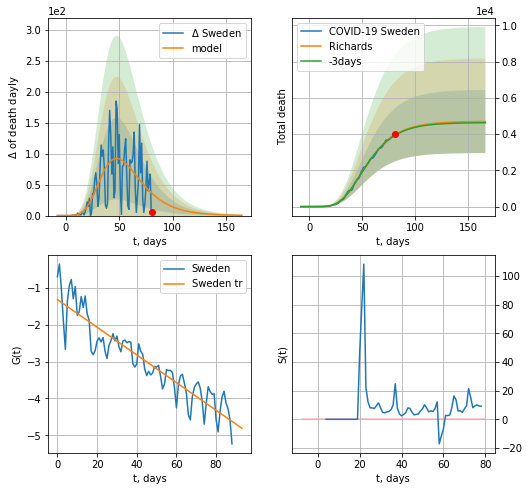

Sweden data at: 2020-07-31
+3 day model MAPE: 0.006764
model: Richards
coeffs: [ 4.70118584e+03  4.74513928e+00 -3.55284189e+01  1.13087458e-02]
rational stdev: 0.370499
forecast at the end of period: +85 days
	 total death: 4692 ± 1738
trend coefficient of determination: 0.849328
 intercept: -1.319237
 slope: -0.037509


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:209: RuntimeWarning: invalid value encountered in true_divide


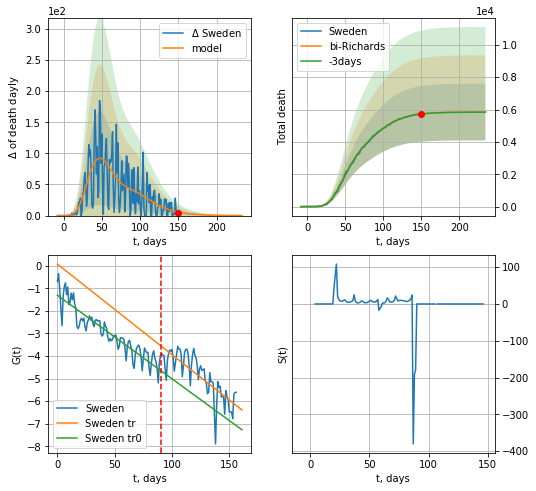

Sweden data at: 2020-07-31
+3 day model MAPE: 0.001169
model: bi-Richards
coeffs: [1.14802996e+03 6.22116243e+00 1.33506198e-01 7.77669339e-03]
rational stdev: 0.299708
forecast at the end of period: +85 days
	 total death: 5847 ± 1752
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.850052
 intercept: -1.308850
 slope: -0.037005
trend coefficient of determination: 0.638487
 intercept: 0.069098
 slope: -0.040108


In [3286]:
vL = 90
x = forecastRR('Sweden',dfSW[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sweden',dfSW[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRR('Sweden',dfSW[:vL],d1,30*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death')
xx = forecast2RR('Sweden',dfSW[:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,cases='death',vL=vL)
#x = forecastQR('Sweden',dfSW[:],d1,16*7-dT,1.0)
#xx = forecast2R('Sweden',dfSW[:],d1,12*7-dT,x,1.0)#,addpred=True,xcoef=[0.25,1.,2.3,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


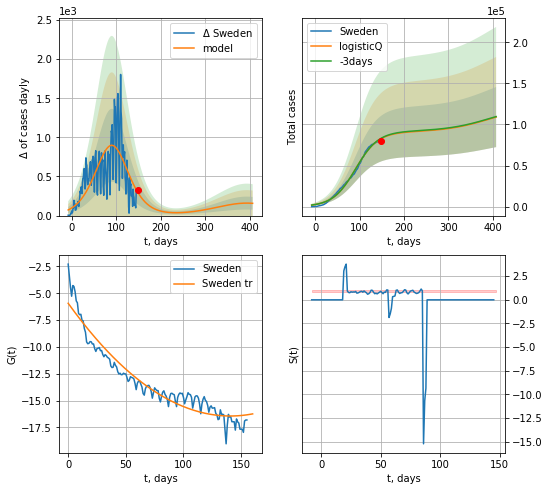

Sweden data at: 2020-07-31
+3 day model MAPE: 0.005477
model: logisticQ
coeffs: [ 9.07569705e+04  4.58627070e-07  9.04502433e+01 -8.61004673e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.335668
forecast at the end of period: +260 days
	 deltaDaycases: 156
	 total cases: 109012 ± 36592
	 total death: 7784 ± 7838
trend coefficient of determination: 0.921491
 intercept_: -5.933802409250737
 coeffs_: [ 0.         -0.14944802  0.00053117]


In [3287]:
x = forecastRRR('Sweden',dfSW[1:],d1,55*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


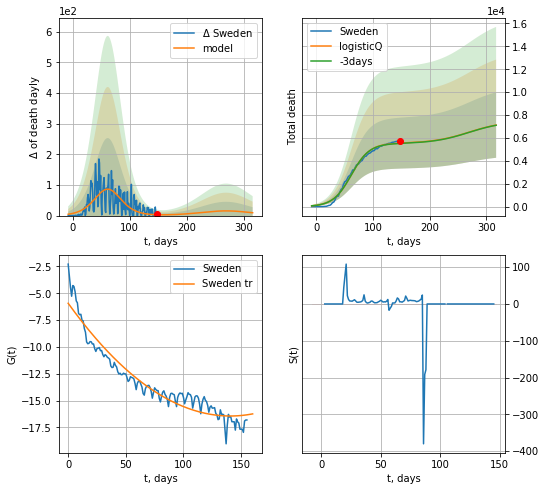

Sweden data at: 2020-07-31
+3 day model MAPE: 0.004429
model: logisticQ
coeffs: [ 5.52739081e+03  1.46777554e-07  6.18816257e+01 -4.25244060e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.401153
forecast at the end of period: +169 days
	 total death: 7123 ± 2857
trend coefficient of determination: 0.921491
 intercept_: -5.933802409250737
 coeffs_: [ 0.         -0.14944802  0.00053117]


In [3288]:
x = forecastRRR('Sweden',dfSW[1:],d1,42*7-dT,1.0,addpred=True,xcoef=koreaCoeffs,cases='death')

CN
           date    cases  active   death
189 2020-07-29  84165.0     574  4634.0
190 2020-07-30  84292.0     684  4634.0
191 2020-07-31  84337.0     714  4634.0
192 2020-08-01  84385.0     748  4634.0
193 2020-08-02  84428.0     781  4634.0


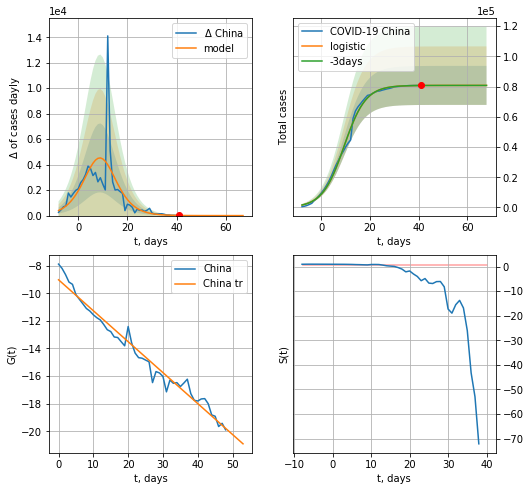

China data at: 2020-08-02
+3 day model MAPE: 0.00012785692963974442
model: logistic
coeffs:  [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.159713160092933
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  80810 ± 12906
	 total death:  4435 ± 2124
trend coefficient of determination: 0.972183
 intercept: -9.021396
 slope: -0.224243


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


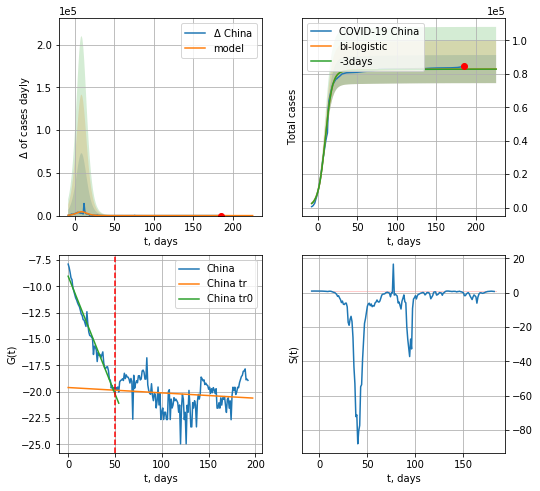

China data at: 2020-08-02
+3 day model MAPE: 0.00042697758154986955
model: bi-logistic
coeffs:  [2.10215842e+03 2.16404502e-02 1.10957630e+01] [8.08101838e+04 2.24512818e-01 9.29453373e+00]
rational stdev:  0.10147151838155764
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  82892 ± 8411
	 total death:  4549 ± 1384
bi-logistic approximation splitting point: 50
trend0 coefficient of determination: 0.973282
 intercept: -9.036652
 slope: -0.223289
trend coefficient of determination: 0.020994
 intercept: -19.609182
 slope: -0.005076


In [4094]:
dfCN = read_df(pd.DataFrame(),"CN")
try:
    x = forecast('China',dfCN[:50],d1,7*T18-dT,1.0)
    #xx = forecast('China',dfCN[21:-32],d1,17)
    #xx = np.concatenate((x, xx), axis=0)
    xx = forecast2('China',dfCN[:],d1,24*7-dT,x,1.0,vL=50)
except:
    print ("Exception occurs")

In [4095]:
#dfTT[dfTT.Country=='%s'%('China')][0].values[0]

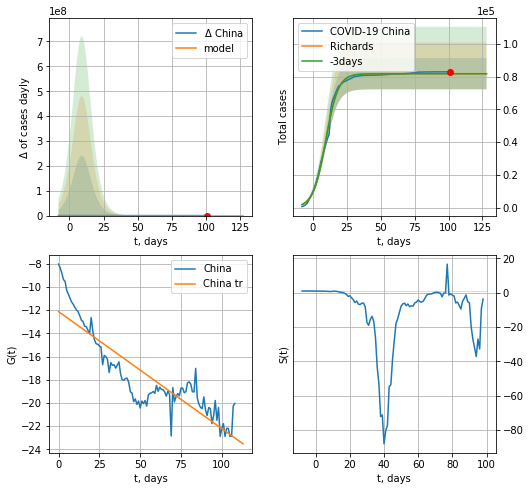

China data at: 2020-08-02
+3 day model MAPE: 0.000627
model: Richards
coeffs: [8.17736184e+04 2.15574455e-01 9.59539709e+00 1.02116174e+00]
rational stdev: 0.116457
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 81773 ± 9523
	 total death: 4488 ± 1567
trend coefficient of determination: 0.785239
 intercept: -12.125055
 slope: -0.100960


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


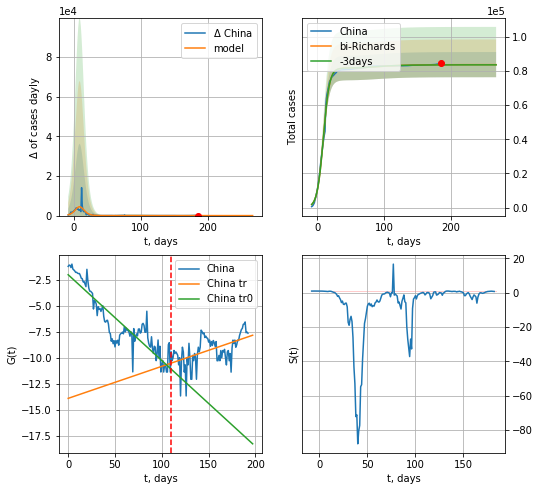

China data at: 2020-08-02
+3 day model MAPE: 0.001274
model: bi-Richards
coeffs: [ 1.96769951e+03  8.94084219e+00 -5.94283896e+01  4.15289948e-03]
rational stdev: 0.088003
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 83738 ± 7369
	 total death: 4596 ± 1213
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.820995
 intercept: -1.994929
 slope: -0.082706
trend coefficient of determination: 0.280392
 intercept: -13.907777
 slope: 0.030874


In [4096]:
vL = 110
x = forecastRR('China',dfCN[:vL],d1,T18*7-dT,1.0)
xx = forecast2RR('China',dfCN[:],d1,30*7-dT,x,1.0,vL=vL)
#x = forecastQR('China',dfCN[:],d1,6*7-dT,1.0)
#xx = forecast('China',dfCN[21:-32],d1,17)
#xx = np.concatenate((x, xx), axis=0)
#xx = forecast2R('China',dfCN[:],d1,6*7-dT,x,1.0)

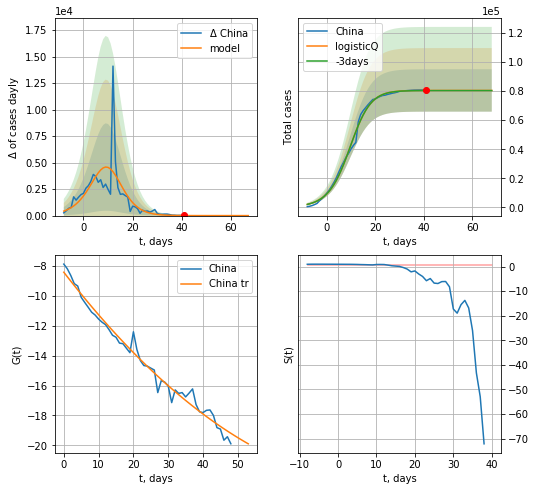

China data at: 2020-08-02
+3 day model MAPE: 0.001323
model: logisticQ
coeffs: [ 8.04175259e+04  1.07650464e-03  9.35257489e+00 -2.02425637e+02]
rational stdev: 0.181019
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 80417 ± 14557
	 total death: 4413 ± 2396
trend coefficient of determination: 0.979964
 intercept_: -8.428864441790822
 coeffs_: [ 0.         -0.29994819  0.00157784]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


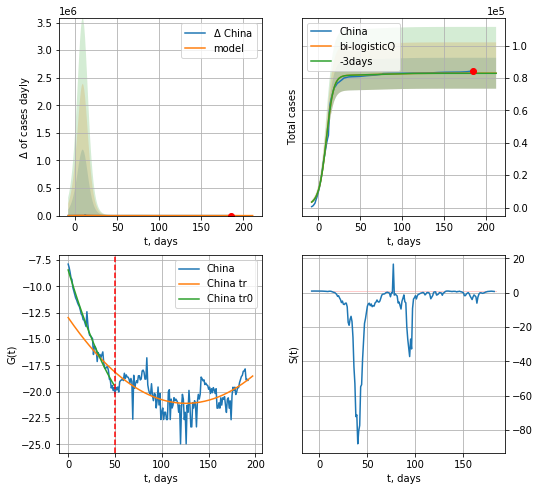

China data at: 2020-08-02
+3 day model MAPE: 0.000571
model: bi-logisticQ
coeffs: [ 2.51893745e+03  2.93831569e-04  2.47799772e+01 -5.08288432e-02]
rational stdev: 0.114969
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 82936 ± 9535
	 total death: 4552 ± 1570
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.980847
 intercept_: -8.442415731989867
 coeffs_: [ 0.         -0.29762768  0.00151769]
trend coefficient of determination: 0.314170
 intercept_: -12.963267515095257
 coeffs_: [ 0.         -0.12939558  0.00051372]


In [4097]:
x = forecastRRR('China',dfCN[:50],d1,7*T18-dT,1.0)
xx=forecast2RRR('China',dfCN[:],d1,T18*7-dT,x,1.0,vL=50)

In [4098]:
#x = forecastQR('China',dfCN[50:],d1,6*7-dT,1.0)

KR
           date  cases  active  death
165 2020-07-29  14269   837.0  300.0
166 2020-07-30  14305   821.0  301.0
167 2020-07-31  14336   802.0  301.0
168 2020-08-01  14366   806.0  301.0
169 2020-08-02  14389   808.0  301.0


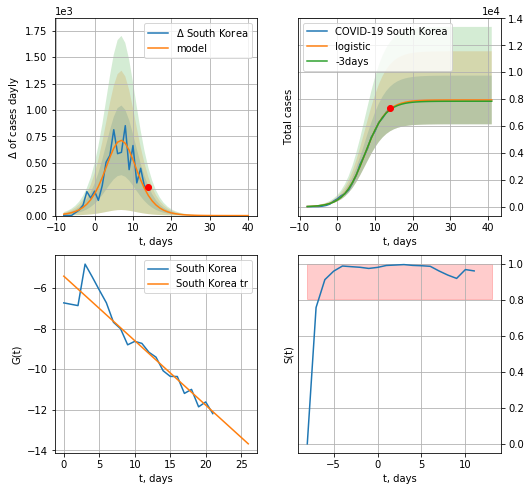

South Korea data at: 2020-08-02
model: logistic
coeffs:  [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.2275932520547523
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  7941 ± 1807
	 total death:  166 ± 113
trend coefficient of determination: 0.904554
 intercept: -5.419235
 slope: -0.317547


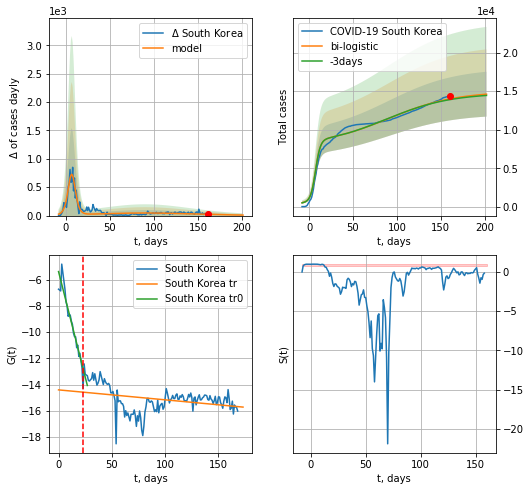

South Korea data at: 2020-08-02
+3 day model MAPE: 0.006850990584782961
model: bi-logistic
coeffs:  [7.02599653e+03 2.61375480e-02 9.04283948e+01] [7.94116797e+03 3.59786702e-01 7.37445793e+00]
rational stdev:  0.19903241310357717
forecast at the end of period: +41 days
	 deltaDaycases:  9
	 total cases:  14606 ± 2907
	 total death:  305 ± 182
bi-logistic approximation splitting point: 23
trend0 coefficient of determination: 0.916463
 intercept: -5.394262
 slope: -0.321115
trend coefficient of determination: 0.107017
 intercept: -14.401992
 slope: -0.007575


In [4099]:
dfKR = read_df(pd.DataFrame(),"KR")
x = forecast('South Korea',dfKR[:23],d1,7*T18-dT,1.0,pMAPE=False)
xx=forecast2('South Korea',dfKR[:],d1,24*7-dT,x,1.0,vL=23)

In [4100]:
#vL = 30
#x = forecastRRR('South Korea',dfKR[:vL],d1,8*7-dT,1.0)
#x1 = forecastRRR('South Korea',dfKR[39:],d1,12*7-dT,1.0)
#xx = np.concatenate((x, x1), axis=0)
#xx=forecast2RRR('South Korea',dfKR[:],d1,8*7-dT,x,1.0,vL=vL)

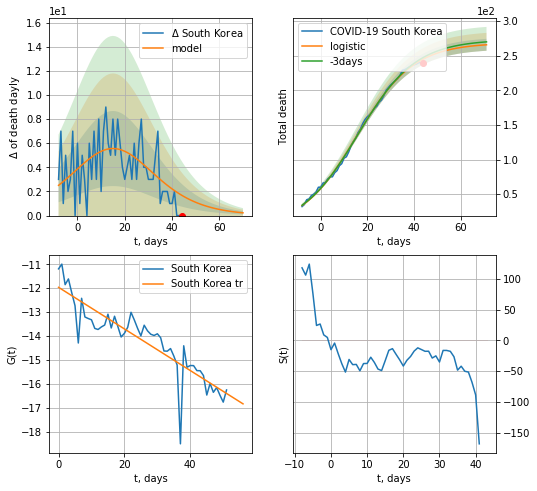

South Korea data at: 2020-08-02
model: logistic
coeffs:  [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.032418936831668854
forecast at the end of period: +27 days
	 total death:  265 ± 8
trend coefficient of determination: 0.782213
 intercept: -11.965009
 slope: -0.087016


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:251: RuntimeWarning: divide by zero encountered in true_divide


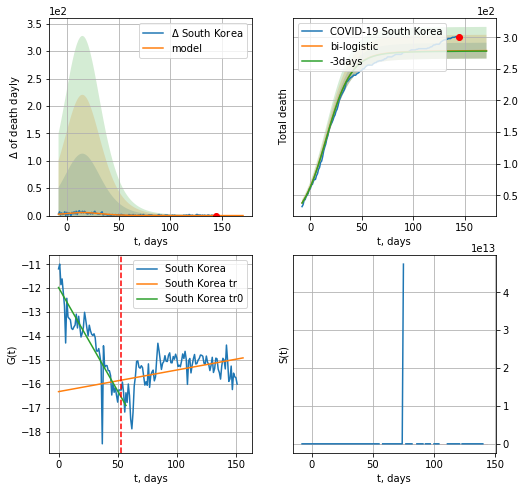

South Korea data at: 2020-08-02
+3 day model MAPE: 0.002579470287633997
model: bi-logistic
coeffs:  [10.82727884  0.01982217  9.96025684] [2.68513907e+02 8.28168907e-02 1.55065021e+01]
rational stdev:  0.04488698263315508
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  278 ± 12
bi-logistic approximation splitting point: 53
trend0 coefficient of determination: 0.789613
 intercept: -11.973248
 slope: -0.086531
trend coefficient of determination: 0.163140
 intercept: -16.326447
 slope: 0.009036


In [4101]:
x = forecast('South Korea',dfKR[17:70],d1,T18*7-dT,1.0,cases='death',pMAPE=False)
xx=forecast2('South Korea',dfKR[17:],d1,T18*7-dT,x,1.0,vL=70-17,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


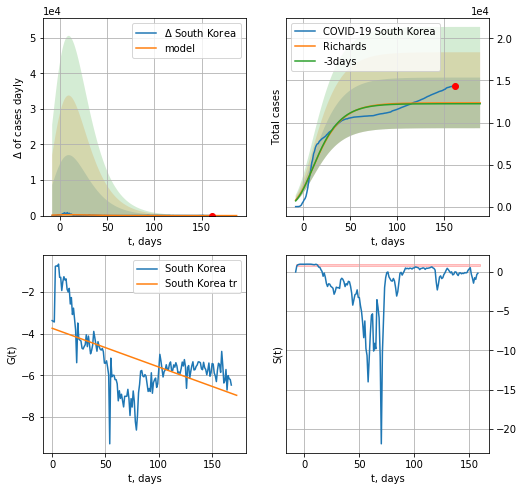

South Korea data at: 2020-08-02
+3 day model MAPE: 0.008335
model: Richards
coeffs: [ 1.23434883e+04  2.13670618e+01 -9.53324555e+01  2.63986408e-03]
rational stdev: 0.243591
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 12342 ± 3006
	 total death: 258 ± 188
trend coefficient of determination: 0.322716
 intercept: -3.743125
 slope: -0.018565


In [4102]:
x = forecastRR('South Korea',dfKR[:],d1,T18*7-dT,1.0)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


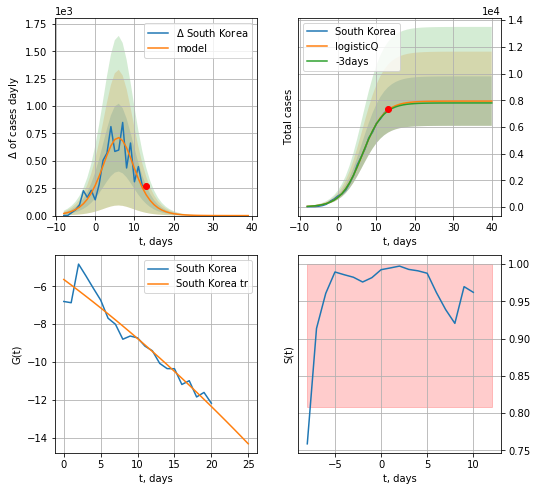

South Korea data at: 2020-08-02
+3 day model MAPE: 0.011158
model: logisticQ
coeffs: [ 7.93644740e+03  5.70893336e-05  6.37140939e+00 -6.30084107e+03]
rational stdev: 0.233522
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 7936 ± 1853
	 total death: 166 ± 116
trend coefficient of determination: 0.923340
 intercept_: -5.639271391154587
 coeffs_: [ 0.         -0.28882126 -0.00235709]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


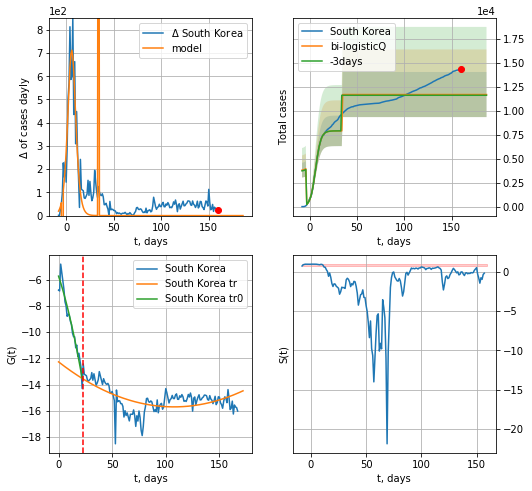

South Korea data at: 2020-08-02
+3 day model MAPE: 0.006638
model: bi-logisticQ
coeffs: [ 3.79067569e+03  1.11356694e+01  3.43977098e+01 -3.20564309e+00]
rational stdev: 0.200619
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 11727 ± 2352
	 total death: 245 ± 147
bi-logisticQ approximation splitting point: 23
trend coefficient of determination: 0.939645
 intercept_: -5.742054822567119
 coeffs_: [ 0.         -0.24685696 -0.00483449]
trend coefficient of determination: 0.328053
 intercept_: -12.269132072871438
 coeffs_: [ 0.         -0.06366362  0.00029563]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [4103]:
vL=23
x = forecastRRR('South Korea',dfKR[1:vL],d1,T18*7-dT,1.0)
xx=forecast2RRR('South Korea',dfKR[1:],d1,T18*7-dT,x,1.0,vL=vL)

In [4104]:
#x = forecastRR('South Korea',dfKR[68:],d1,10*7-dT,1.0)

In [4105]:
#vL=25
#x = forecastQR('South Korea',dfKR[1:vL],d1,16*7-dT,1.0)
#xx=forecast2QR('South Korea',dfKR[1:],d1,16*7-dT,x,1.0,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


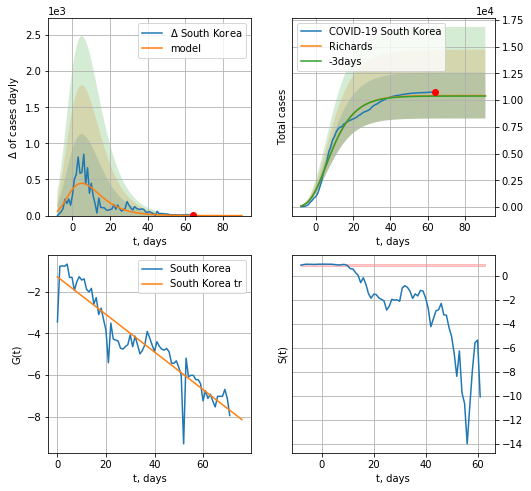

South Korea data at: 2020-08-02
+3 day model MAPE: 0.004436
model: Richards
coeffs: [ 1.04317316e+04  3.08211996e+01 -4.22121900e+01  3.79550844e-03]
rational stdev: 0.205414
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 10431 ± 2142
	 total death: 218 ± 134
trend coefficient of determination: 0.863607
 intercept: -1.289212
 slope: -0.090002


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


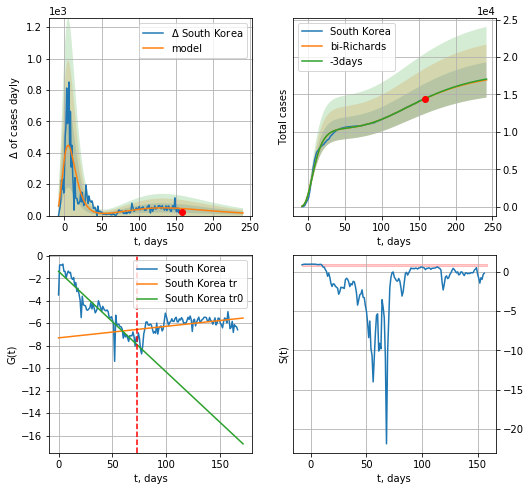

South Korea data at: 2020-08-02
+3 day model MAPE: 0.001344
model: bi-Richards
coeffs: [ 7.49941612e+03  1.21311938e+00 -1.01345807e+02  1.48186161e-02]
rational stdev: 0.139171
forecast at the end of period: +83 days
	 deltaDaycases: 16
	 total cases: 16947 ± 2358
	 total death: 354 ± 147
bi-Richards approximation splitting point: 73
trend coefficient of determination: 0.866170
 intercept: -1.384905
 slope: -0.089738
trend coefficient of determination: 0.194574
 intercept: -7.303655
 slope: 0.010298


In [4106]:
vL = 2
vL1 = 75
x = forecastRR('South Korea',dfKR[vL:vL1],d1,T18*7-dT,1.0)
xx=forecast2RR('South Korea',dfKR[vL:],d1,30*7-dT,x,1.0,vL=vL1-vL)
#xx = np.concatenate((x, xx), axis=0)
#print (xx)
#xxx=forecast3RR('South Korea',dfKR[1:],d1,12*7-dT,xx,1.0,vL=[vL,vL1],zoom=1e3)

In [4107]:
a = np.array([ 7.90607495e+03,  3.14377481e-03, -1.32150046e+02,  5.22462480e+00, 7.59593205e-01])
b = np.array([ 2.91876181e+03,  1.43325056e-01, -3.99886263e+01, -3.39427361e+02, 1.77367535e-03])
QRkoreaCoeffs=b/a
QRkoreaCoeffs,RkoreaCoeffs,koreaCoeffs

(array([ 3.69179628e-01,  4.55901153e+01,  3.02600169e-01, -6.49668395e+01,
         2.33503320e-03]),
 [0.36242246, 2.56241634, 1.84890887, 0.13324732],
 [0.35416971, 0.02606324, 4.35859408, 19.30413219])

In [4108]:
#x = forecastQR('South Korea',dfKR[:],d1,16*7-dT,1.0)

SG
           date    cases  active  death
188 2020-07-29  51809.0    5684   27.0
189 2020-07-30  52205.0    5870   27.0
190 2020-07-31  52512.0    5994   27.0
191 2020-08-01  52825.0    6058   27.0
192 2020-08-02  53051.0    6098   27.0


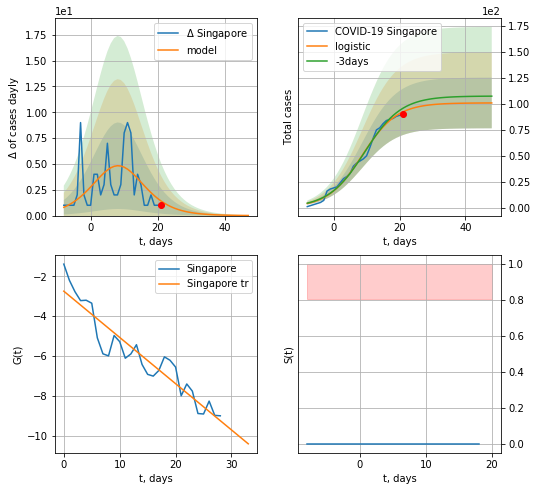

Singapore data at: 2020-08-02
+3 day model MAPE: 0.03963437966370839
model: logistic
coeffs:  [101.02990869   0.19128696   8.67555654]
rational stdev:  0.24212715882466435
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  100 ± 24
	 total death:  0 ± 0
trend coefficient of determination: 0.887345
 intercept: -2.744831
 slope: -0.232145


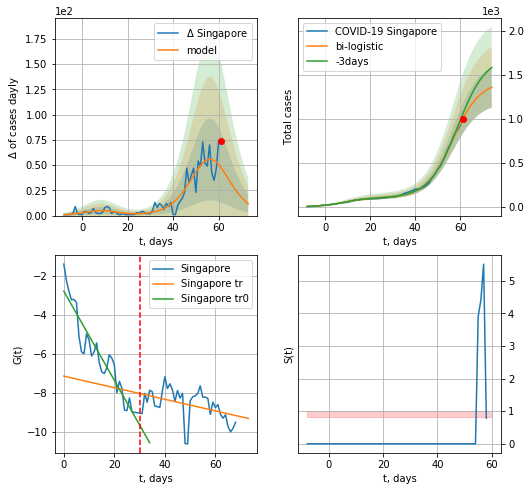

Singapore data at: 2020-08-02
+3 day model MAPE: 0.06119827726371909
model: bi-logistic
coeffs:  [1.32695355e+03 1.68329223e-01 5.66911530e+01] [101.02990869   0.19128696   8.67555654]
rational stdev:  0.16894112356490856
forecast at the end of period: +13 days
	 deltaDaycases:  11
	 total cases:  1359 ± 229
	 total death:  0 ± 0
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend coefficient of determination: 0.177815
 intercept: -7.138791
 slope: -0.029776


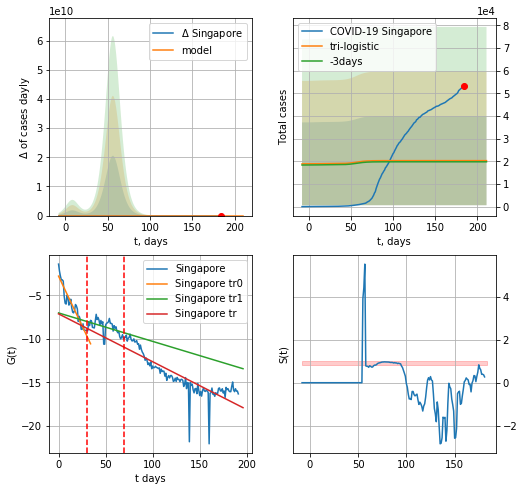

Singapore data at: 2020-08-02
+3 day model MAPE: 0.02597101847823698
model: tri-logistic
coeffs:  [ 1.88532517e+04 -1.24394073e+01  3.04030018e+02] [1.01029909e+02 1.91286963e-01 8.67555654e+00 1.32695355e+03
 1.68329223e-01 5.66911530e+01]
forecast rational stdev:  0.969568526312066
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  20281 ± 19664
	 total death:  10 ± 29
tri-logistic approximation splitting points: 30,70
trend0 coefficient of determination: 0.893525
 intercept: -2.772249
 slope: -0.229208
trend1 coefficient of determination: 0.215531
 intercept: -7.009854
 slope: -0.032798
trend coefficient of determination: 0.717216
 intercept: -7.117929
 slope: -0.055151


In [4109]:
vL = 30
vL1 = 70
try:
    dfSG = read_df(pd.DataFrame(),"SG")
    x = forecast('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
    xx = forecast2('Singapore',dfSG[:vL1],d1,20*7-dT,x,1.0,vL=vL)
    xx = np.concatenate((x, xx), axis=0)
    xxx = forecast3("Singapore",dfSG,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])
except:
    print ("Exception occurs")

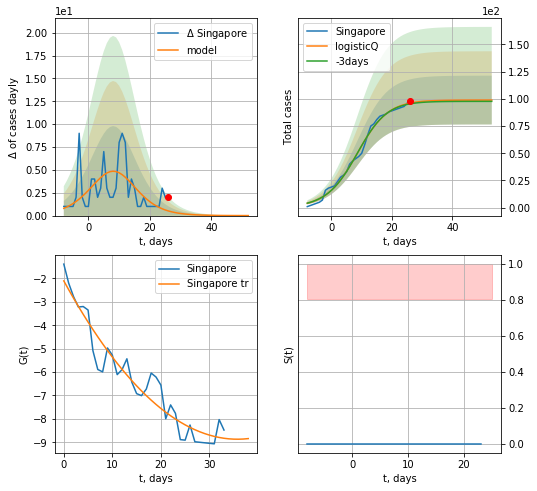

Singapore data at: 2020-08-02
+3 day model MAPE: 0.007575
model: logisticQ
coeffs: [ 9.88556613e+01  2.70689941e-04  8.43151450e+00 -7.17657610e+02]
rational stdev: 0.226599
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 98 ± 22
	 total death: 0 ± 0
trend coefficient of determination: 0.918167
 intercept_: -2.103369555726971
 coeffs_: [ 0.         -0.37832792  0.00528917]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


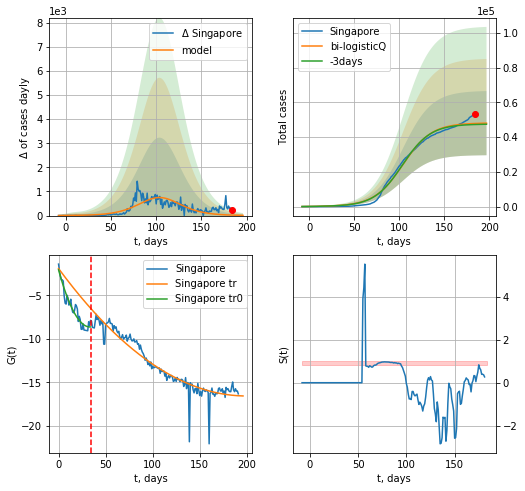

Singapore data at: 2020-08-02
+3 day model MAPE: 0.012630
model: bi-logisticQ
coeffs: [ 4.80367350e+04  1.43175446e-07  1.04045286e+02 -4.36117517e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.384406
forecast at the end of period: +13 days
	 deltaDaycases: 9
	 total cases: 47996 ± 18450
	 total death: 24 ± 27
bi-logisticQ approximation splitting point: 35
trend coefficient of determination: 0.914568
 intercept_: -2.036640634366525
 coeffs_: [ 0.         -0.39517788  0.00592335]
trend coefficient of determination: 0.901498
 intercept_: -1.8949459612876787
 coeffs_: [ 0.         -0.14698219  0.00036774]


In [4110]:
vL = 35
x = forecastRRR('Singapore',dfSG[:vL],d1,7*T18-dT,1.0)
xx = forecast2RRR('Singapore',dfSG[:],d1,20*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

In [4111]:
#vL = 31
#x = forecast('Singapore',dfSG[:vL],d1,6*7-dT,1.0)
#xx = forecast2('Singapore',dfSG[:],d1,12*7-dT,x,1.0,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


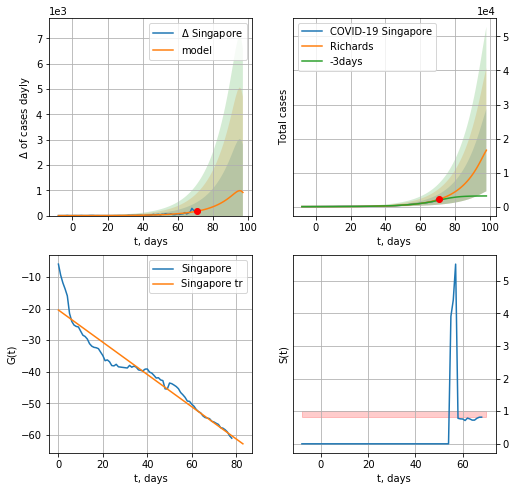

Singapore data at: 2020-08-02
+3 day model MAPE: 0.158856
model: Richards
coeffs: [1.92302023e+04 7.72500001e-02 9.92482833e+01 7.56752958e+00]
rational stdev: 0.728321
forecast at the end of period: +27 days
	 deltaDaycases: 913
	 total cases: 16577 ± 12073
	 total death: 8 ± 17
trend coefficient of determination: 0.919778
 intercept: -20.482187
 slope: -0.510333


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


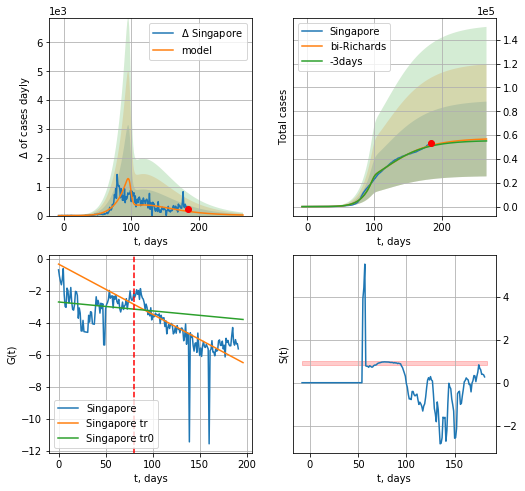

Singapore data at: 2020-08-02
+3 day model MAPE: 0.010794
model: bi-Richards
coeffs: [ 3.82572300e+04  1.60519522e+00 -3.67010498e+01  1.64929485e-02]
rational stdev: 0.552758
forecast at the end of period: +83 days
	 deltaDaycases: 19
	 total cases: 56747 ± 31367
	 total death: 28 ± 46
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.018691
 intercept: -2.709550
 slope: -0.005571
trend coefficient of determination: 0.497271
 intercept: -0.344167
 slope: -0.031391


In [4112]:
iL = 0
vL = 80+iL
x = forecastRR('Singapore',dfSG[iL:vL+iL],d1,T18*7-dT,1.0)
x = forecast2RR('Singapore',dfSG[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecast2R('Singapore',dfSG[:],d1,28*7-dT,x,1.0)
#x = forecastQR('Singapore',dfSG[60:],d1,16*7-dT,1.0)

ES
           date   cases  active  death
139 2020-07-29  2051.0      56   69.0
140 2020-07-30  2064.0      65   69.0
141 2020-07-31  2072.0      69   69.0
142 2020-08-01  2079.0      76   69.0
143 2020-08-02  2080.0      82   63.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


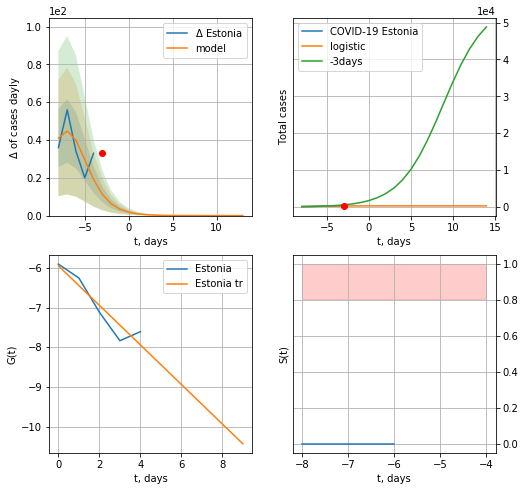

Estonia data at: 2020-08-02
+3 day model MAPE: 0.6707560325989319
model: logistic
coeffs:  [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.028784635369283593
forecast at the end of period: +17 days
	 deltaDaycases:  0
	 total cases:  277 ± 7
	 total death:  8 ± 0
trend coefficient of determination: 0.881874
 intercept: -5.949047
 slope: -0.498463


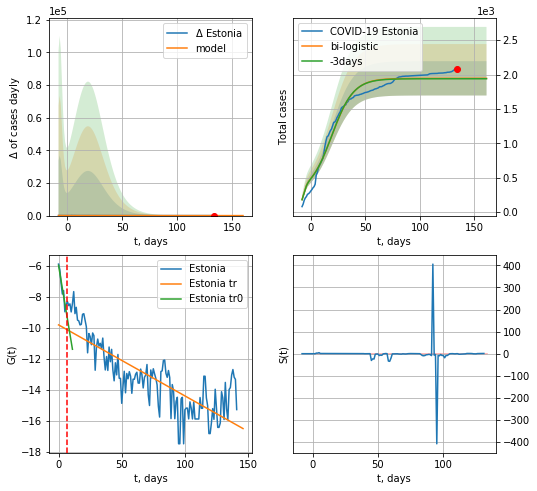

Estonia data at: 2020-08-02
+3 day model MAPE: 0.0031558847340742943
model: bi-logistic
coeffs:  [1.66725004e+03 9.97059003e-02 1.92832539e+01] [277.64023437   0.65084323  -6.57074778]
rational stdev:  0.12817648612224794
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1944 ± 249
	 total death:  58 ± 22
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.894917
 intercept: -5.986038
 slope: -0.491580
trend coefficient of determination: 0.655467
 intercept: -9.821979
 slope: -0.045758


In [4113]:
shift = 1.0
try:
    dfES = read_df(pd.DataFrame(),"ES")
    x = forecast('Estonia',dfES[1:7],d1,17,1.)
    xx = forecast2('Estonia',dfES[1:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.5],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


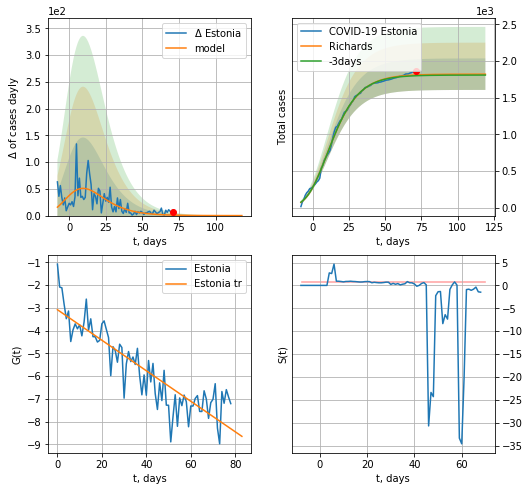

Estonia data at: 2020-08-02
+3 day model MAPE: 0.005922
model: Richards
coeffs: [ 1.82012417e+03  4.28258281e-01 -9.68149429e+00  1.94635009e-01]
rational stdev: 0.117893
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 1819 ± 214
	 total death: 55 ± 19
trend coefficient of determination: 0.779595
 intercept: -3.079612
 slope: -0.067018


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


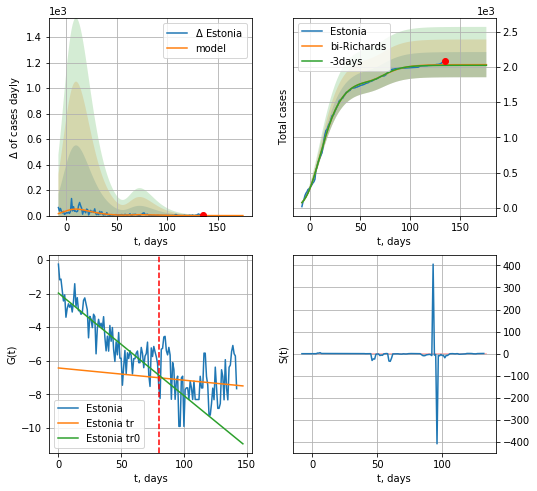

Estonia data at: 2020-08-02
+3 day model MAPE: 0.004085
model: bi-Richards
coeffs: [2.10754119e+02 2.73373733e+01 3.55642556e+00 2.99499146e-03]
rational stdev: 0.087945
forecast at the end of period: +41 days
	 deltaDaycases: 0
	 total cases: 2030 ± 178
	 total death: 61 ± 16
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.765075
 intercept: -1.966103
 slope: -0.061135
trend coefficient of determination: 0.009693
 intercept: -6.432064
 slope: -0.007270


In [4114]:
vL=80
x = forecastRR('Estonia',dfES[:vL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Estonia',dfES[10:],d1,7*10-dT,1.)
xx = forecast2RR('Estonia',dfES[:],d1,7*24-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


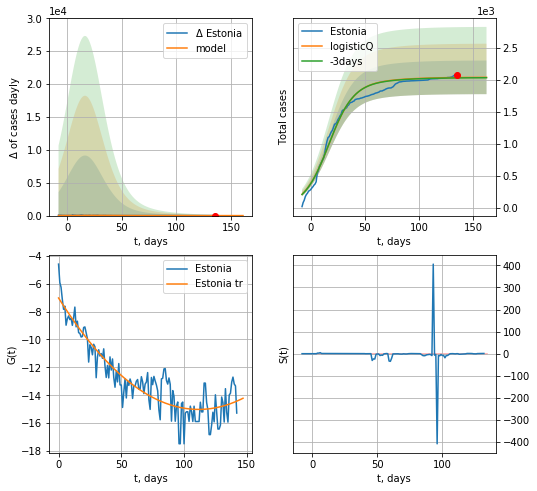

Estonia data at: 2020-08-02
+3 day model MAPE: 0.002897
model: logisticQ
coeffs: [ 1.95185654e+03  1.27255847e-07  1.66296430e+01 -6.82982843e+05]
S.Korea scenario coeffs: [0.04375, 0.5, 4.0, 1]
rational stdev: 0.129020
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2035 ± 262
	 total death: 61 ± 23
trend coefficient of determination: 0.839678
 intercept_: -7.025948687615253
 coeffs_: [ 0.         -0.1431716   0.00064116]


In [4115]:
x = forecastRRR('Estonia',dfES[:],d1,7*T18-dT,1.,addpred=True,xcoef=[0.35/8,.5,4.,1])

LV
           date   cases  active  death
144 2020-07-29  1228.0     145   31.0
145 2020-07-30  1231.0     147   32.0
146 2020-07-31  1238.0     154   32.0
147 2020-08-01  1243.0     159   32.0
148 2020-08-02  1246.0     162   32.0


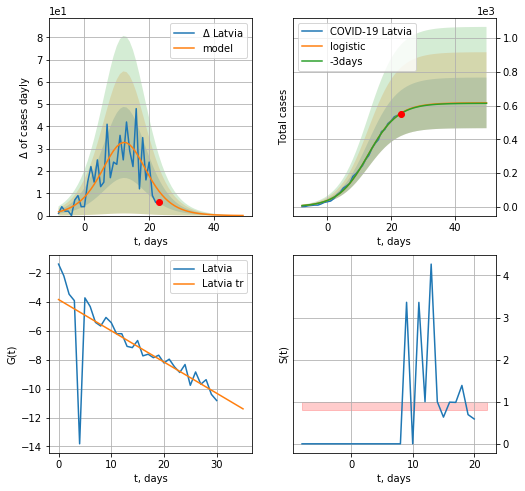

Latvia data at: 2020-08-02
+3 day model MAPE: 0.003263338184172393
model: logistic
coeffs:  [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.24373797630646024
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  615 ± 150
	 total death:  15 ± 10
trend coefficient of determination: 0.538666
 intercept: -3.837099
 slope: -0.216023


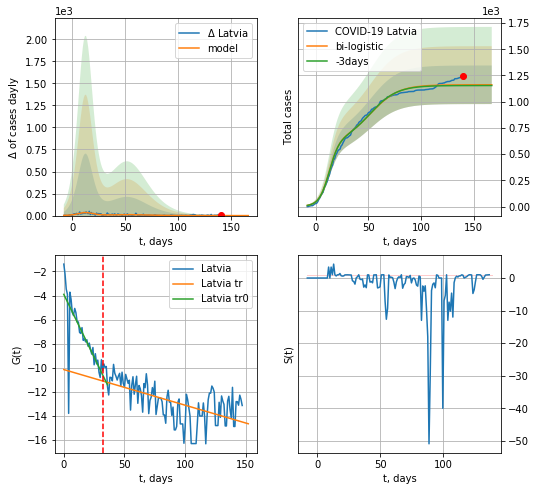

Latvia data at: 2020-08-02
+3 day model MAPE: 0.006130215650914581
model: bi-logistic
coeffs:  [5.45396558e+02 7.66190693e-02 5.21102986e+01] [6.16080291e+02 2.13516215e-01 1.27871959e+01]
rational stdev:  0.1581946256561522
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1161 ± 183
	 total death:  29 ± 13
bi-logistic approximation splitting point: 32
trend0 coefficient of determination: 0.543521
 intercept: -3.904452
 slope: -0.209287
trend coefficient of determination: 0.361435
 intercept: -10.166031
 slope: -0.029684


In [4116]:
vL=32
dfLV = read_df(pd.DataFrame(),"LV")
try:
    x = forecast('Latvia',dfLV[:vL],d1,T18*7-dT,1.)
    xx=forecast2('Latvia',dfLV[:],d1,T18*7-dT,x,1.,addpred=False,xcoef=[0.25,1.,3.],vL=vL)
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


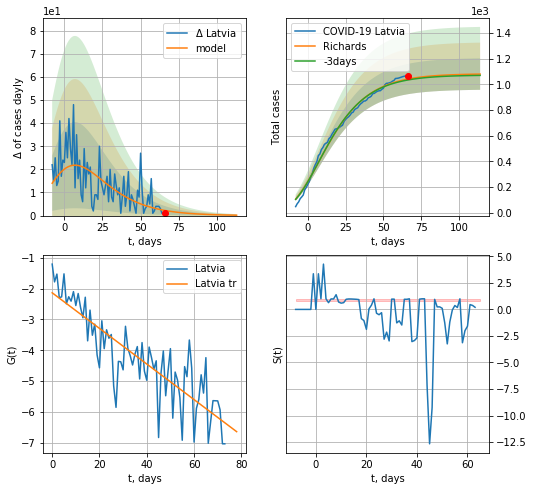

Latvia data at: 2020-08-02
+3 day model MAPE: 0.006926
model: Richards
coeffs: [ 1.08327891e+03  6.55865808e+00 -7.95752157e+01  8.38168173e-03]
rational stdev: 0.113290
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 1080 ± 122
	 total death: 27 ± 9
trend coefficient of determination: 0.723415
 intercept: -2.136856
 slope: -0.057686


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


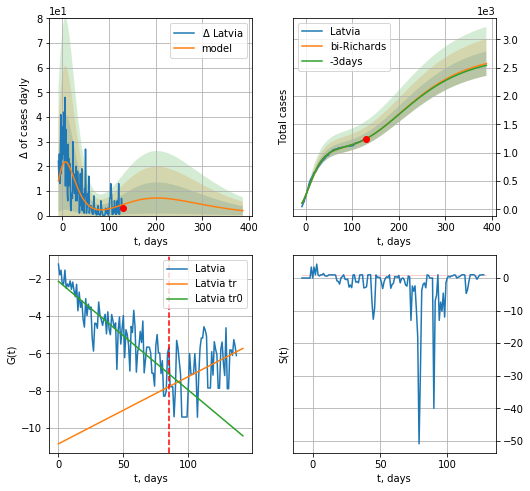

Latvia data at: 2020-08-02
+3 day model MAPE: 0.000278
model: bi-Richards
coeffs: [ 1.66879026e+03  8.88079786e-01 -1.67180521e+02  1.31638386e-02]
rational stdev: 0.083924
forecast at the end of period: +258 days
	 deltaDaycases: 2
	 total cases: 2570 ± 215
	 total death: 66 ± 16
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.758014
 intercept: -2.149873
 slope: -0.058205
trend coefficient of determination: 0.152608
 intercept: -10.841078
 slope: 0.035940


In [4117]:
iL=10
vL = 85+iL
x = forecastRR('Latvia',dfLV[iL:vL-iL],d1,7*25-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Latvia',dfLV[iL:],d1,7*55-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Latvia',dfLV[:],d1,7*16-dT,1.)
#xx=forecast2R('Latvia',dfLV[:],d1,10*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


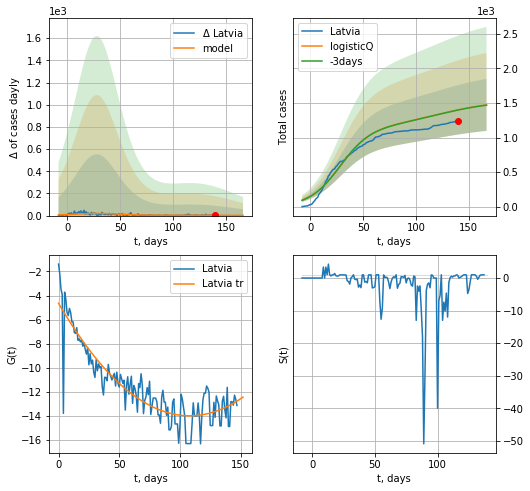

Latvia data at: 2020-08-02
+3 day model MAPE: 0.002128
model: logisticQ
coeffs: [ 1.14159071e+03  1.11919415e-07  2.81405159e+01 -6.09038762e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.255271
forecast at the end of period: +27 days
	 deltaDaycases: 2
	 total cases: 1473 ± 376
	 total death: 37 ± 28
trend coefficient of determination: 0.805787
 intercept_: -4.651307572225901
 coeffs_: [ 0.         -0.1734722   0.00080327]


In [4118]:
#trend3(dfCA[12:],dfPT,dfTR[4:],'CA','PT','TR',40,40,40)
x = forecastRRR('Latvia',dfLV[:],d1,7*T18-dT,1.,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


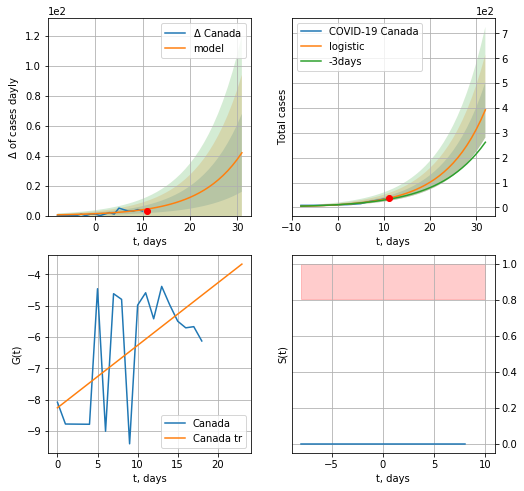

Canada data at: 2020-08-02
+3 day model MAPE: 0.14133490187696762
model: logistic
coeffs:  [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2833740936364515
forecast at the end of period: +21 days
	 deltaDaycases:  41
	 total cases:  392 ± 111
	 total death:  30 ± 25
trend coefficient of determination: 0.348503
 intercept: -8.254919
 slope: 0.199271


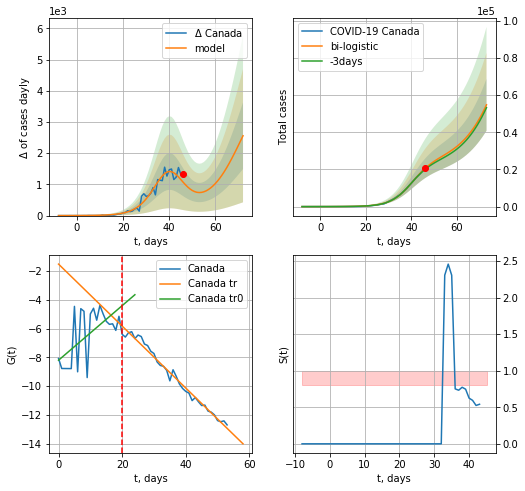

Canada data at: 2020-08-02
+3 day model MAPE: 0.029367009846107475
model: bi-logistic
coeffs:  [2.40153999e+04 2.16961374e-01 4.02658690e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01]
rational stdev:  0.2549294005106464
forecast at the end of period: +27 days
	 deltaDaycases:  2559
	 total cases:  54805 ± 13971
	 total death:  4194 ± 3207
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend coefficient of determination: 0.982767
 intercept: -1.518979
 slope: -0.215271


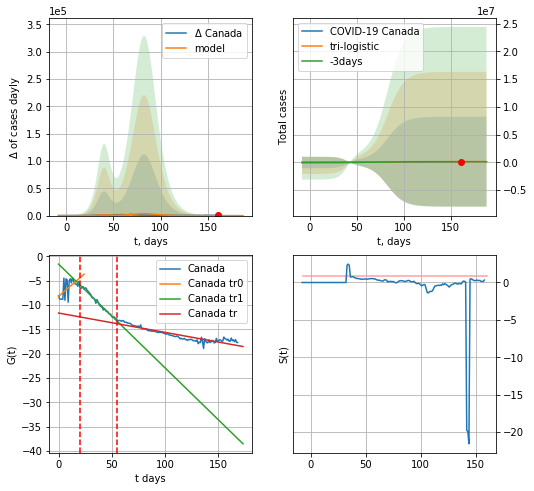

Canada data at: 2020-08-02
+3 day model MAPE: 0.002150697425145228
model: tri-logistic
coeffs:  [-1.68423342e+04  2.02135403e+00 -3.58593091e+01] [1.25342997e+05 1.13222116e-01 8.29018541e+01 2.40153999e+04
 2.16961374e-01 4.02658690e+01]
forecast rational stdev:  61.09615806836415
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  132515 ± 8096170
	 total death:  10141 ± 1858728
tri-logistic approximation splitting points: 20,55
trend0 coefficient of determination: 0.359029
 intercept: -8.196978
 slope: 0.189614
trend1 coefficient of determination: 0.983223
 intercept: -1.572806
 slope: -0.213535
trend coefficient of determination: 0.843251
 intercept: -11.630045
 slope: -0.039799


In [4119]:
vL=20
vL1=55
x = forecast('Canada',dfCA[:vL],d1,3*7,1.)
xx=forecast2('Canada',dfCA[:vL1],d1,T18*7-dT,x,1.,vL=vL)#,addpred=True,xcoef=[0.25,1.,2.]
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Canada",dfCA[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

CA
           date     cases  active   death
165 2020-07-29  115470.0    6088  8917.0
166 2020-07-30  115799.0    6008  8929.0
167 2020-07-31  116312.0    6150  8935.0
168 2020-08-01  116599.0    6222  8941.0
169 2020-08-02  116884.0    6365  8945.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


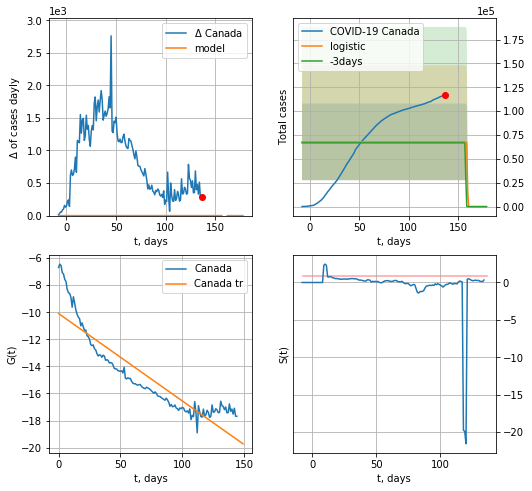

Canada data at: 2020-08-02
+3 day model MAPE: 0.01532805878492908
model: logistic
coeffs:  [ 6.78052123e+04 -5.53302191e+00  1.59741196e+02]
rational stdev:  0.5918708043604045
forecast at the end of period: +42 days
	 deltaDaycases:  0
	 total cases:  0 ± 0
	 total death:  0 ± 0
trend coefficient of determination: 0.821726
 intercept: -10.094281
 slope: -0.064571


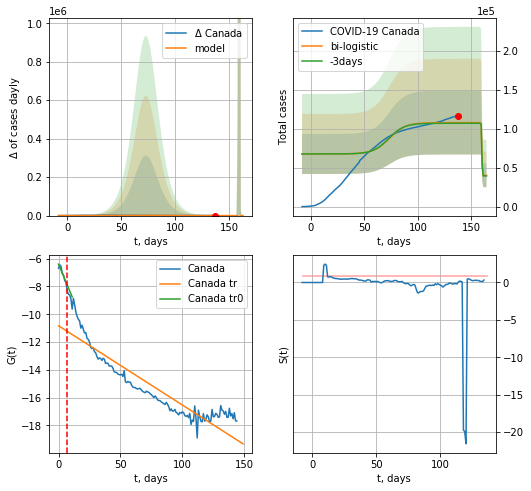

Canada data at: 2020-08-02
+3 day model MAPE: 0.007809332450011735
model: bi-logistic
coeffs:  [4.03376127e+04 1.32500953e-01 7.34350170e+01] [ 6.78052123e+04 -5.53302191e+00  1.59741196e+02]
rational stdev:  0.3793492992208002
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  40337 ± 15301
	 total death:  3086 ± 3512
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.859073
 intercept: -6.392122
 slope: -0.214001
trend coefficient of determination: 0.837046
 intercept: -10.830087
 slope: -0.057012


In [4120]:
dfCA = read_df(pd.DataFrame(),"CA")
x = forecast('Canada',dfCA[24:],d1,6*7,1.,cases='cases')
xx=forecast2('Canada',dfCA[24:],d1,T18*7-dT,x,1.,vL=31-24,cases='cases')

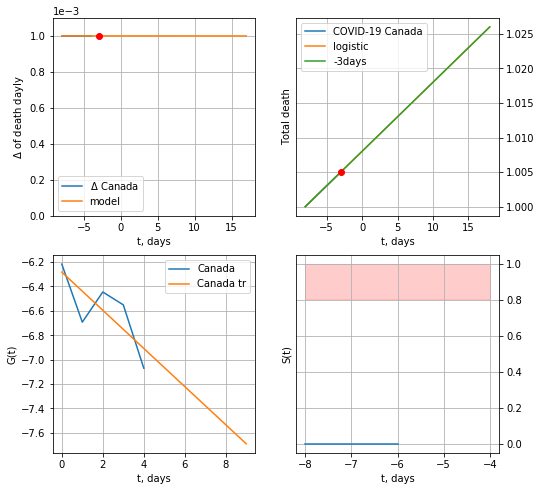

Canada data at: 2020-08-02
+3 day model MAPE: 6.189159426418585e-07
model: logistic
coeffs:  [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  1.593569349221903e-08
forecast at the end of period: +21 days
	 total death:  1 ± 0
trend coefficient of determination: 0.608158
 intercept: -6.282802
 slope: -0.156326


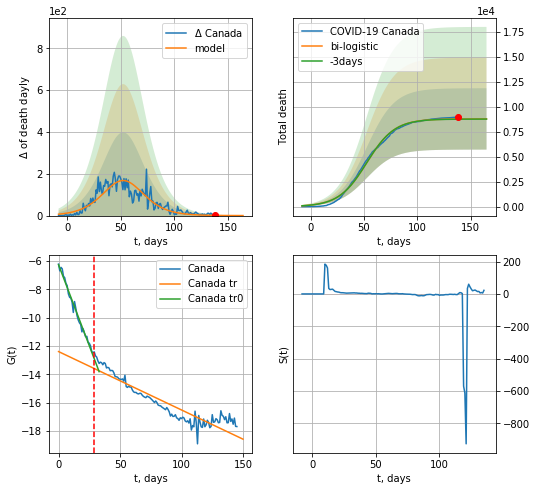

Canada data at: 2020-08-02
+3 day model MAPE: 0.0017306747206575748
model: bi-logistic
coeffs:  [8.76996614e+03 7.65099966e-02 5.26861874e+01] [2.01800807e+00 1.98223827e-03 1.00386171e+00]
rational stdev:  0.3497388941322071
forecast at the end of period: +27 days
	 deltaDaydeath:  0
	 total death:  8769 ± 3067
bi-logistic approximation splitting point: 29
trend0 coefficient of determination: 0.986075
 intercept: -6.260314
 slope: -0.228750
trend coefficient of determination: 0.850909
 intercept: -12.392672
 slope: -0.041227


In [4121]:
vL=29
vL1=50
x = forecast('Canada',dfCA[23:vL],d1,3*7,1.,cases='death')
xx=forecast2('Canada',dfCA[23:],d1,T18*7-dT,x,1.,vL=vL,cases='death')#,addpred=True,xcoef=[0.25,1.,2.]
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Canada",dfCA[24:],d1,16*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1],cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


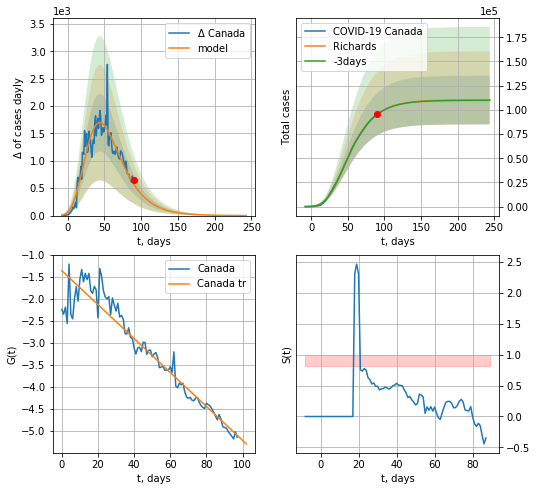

Canada data at: 2020-08-02
+3 day model MAPE: 0.001369
model: Richards
coeffs: [ 1.10207939e+05  3.57046378e+00 -6.12039169e+01  1.17938660e-02]
rational stdev: 0.228612
forecast at the end of period: +154 days
	 deltaDaycases: 1
	 total cases: 110183 ± 25189
	 total death: 8432 ± 5782
trend coefficient of determination: 0.921084
 intercept: -1.352092
 slope: -0.038614


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


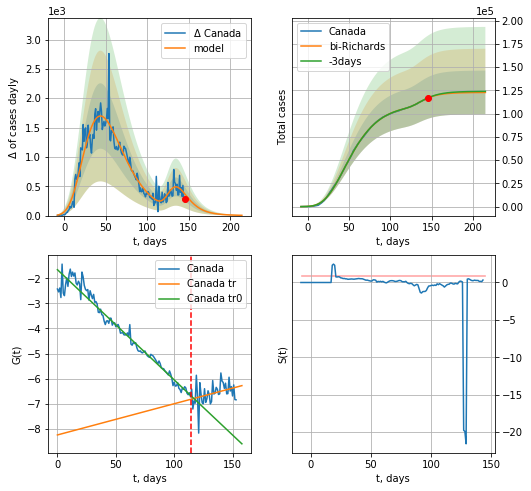

Canada data at: 2020-08-02
+3 day model MAPE: 0.001341
model: bi-Richards
coeffs: [1.26846034e+04 1.23724277e+00 1.06001126e+02 7.05797026e-02]
rational stdev: 0.191427
forecast at the end of period: +69 days
	 deltaDaycases: 4
	 total cases: 122796 ± 23506
	 total death: 9397 ± 5396
bi-Richards approximation splitting point: 114
trend coefficient of determination: 0.963626
 intercept: -1.659531
 slope: -0.043879
trend coefficient of determination: 0.115850
 intercept: -8.239479
 slope: 0.012427


In [4122]:
iL = 15
vL = 114 + iL
x = forecastRR('Canada',dfCA[iL:vL-iL],d1,T18*7,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Canada',dfCA[iL:],d1,28*7-dT,x,1.,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('Canada',dfCA[28:],d1,16*7,1.)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


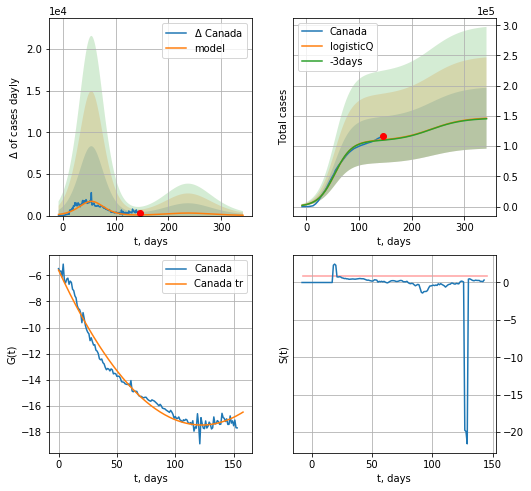

Canada data at: 2020-08-02
+3 day model MAPE: 0.006488
model: logisticQ
coeffs: [ 1.08967433e+05  1.59519099e-07  5.44588485e+01 -3.92877739e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.344542
forecast at the end of period: +196 days
	 deltaDaycases: 42
	 total cases: 146186 ± 50367
	 total death: 11187 ± 11563
trend coefficient of determination: 0.982466
 intercept_: -5.605065678453924
 coeffs_: [ 0.         -0.19350986  0.00078924]


In [4123]:
x = forecastRRR('Canada',dfCA[15:],d1,7*28,1.,addpred=True,xcoef=koreaCoeffs)

PT
           date  cases  active   death
149 2020-07-29  50613   13013  1725.0
150 2020-07-30  50868   13001  1727.0
151 2020-07-31  51072   12854  1735.0
152 2020-08-01  51310   12790  1737.0
153 2020-08-02  51463   12741  1738.0


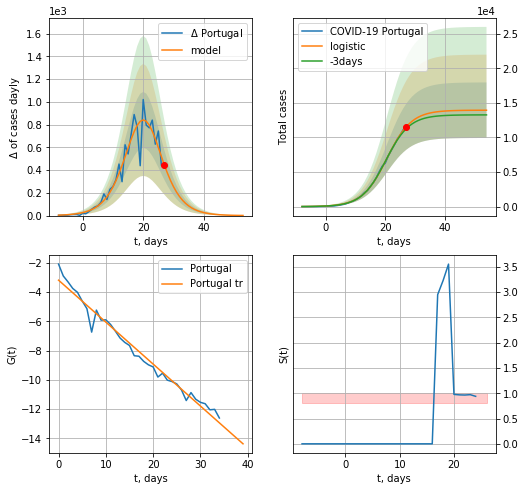

Portugal data at: 2020-08-02
+3 day model MAPE: 0.02876881186141646
model: logistic
coeffs:  [1.39435560e+04 2.41732854e-01 2.05234131e+01]
rational stdev:  0.28806592053196767
forecast at the end of period: +27 days
	 deltaDaycases:  1
	 total cases:  13939 ± 4015
	 total death:  470 ± 406
trend coefficient of determination: 0.976552
 intercept: -3.178197
 slope: -0.287215


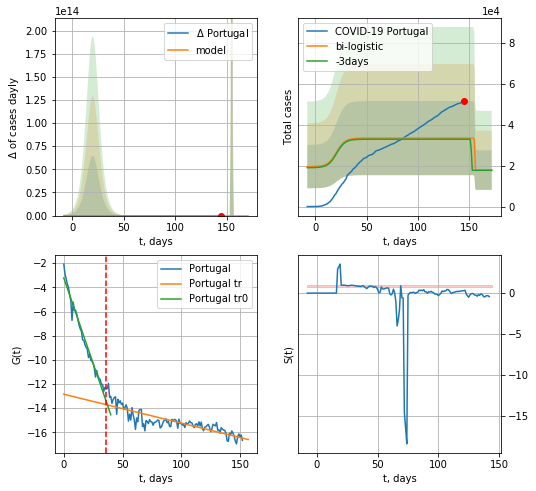

Portugal data at: 2020-08-02
+3 day model MAPE: 0.01633770580453905
model: bi-logistic
coeffs:  [ 1.56499907e+04 -6.01098863e+00  1.55480527e+02] [1.39435560e+04 2.41732854e-01 2.05234131e+01]
scenario coeffs:  [0.25, 1.0, 1.2]
rational stdev:  0.5409884152449282
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  17856 ± 9659
	 total death:  603 ± 978
bi-logistic approximation splitting point: 36
trend0 coefficient of determination: 0.975262
 intercept: -3.226992
 slope: -0.282910
trend coefficient of determination: 0.713203
 intercept: -12.844377
 slope: -0.023867


In [4124]:
vL = 36
dfPT = read_df(pd.DataFrame(),"PT")
x = forecast('Portugal',dfPT[:vL],d1,T18*7-dT,1.)
xx=forecast2('Portugal',dfPT[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.2],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


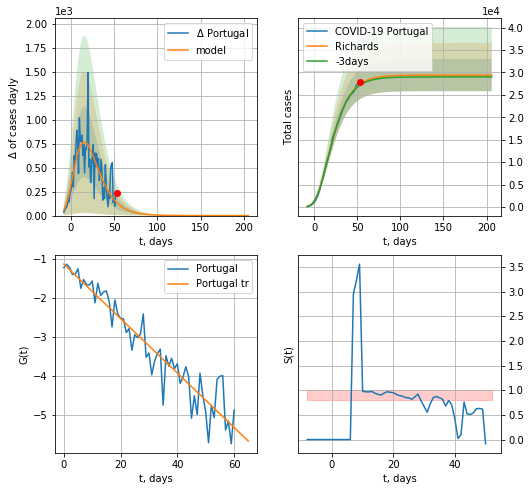

Portugal data at: 2020-08-02
+3 day model MAPE: 0.008857
model: Richards
coeffs: [ 2.94208673e+04  7.56194935e+00 -4.94130809e+01  9.41350515e-03]
rational stdev: 0.121788
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 29420 ± 3583
	 total death: 993 ± 362
trend coefficient of determination: 0.903152
 intercept: -1.140009
 slope: -0.069674


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


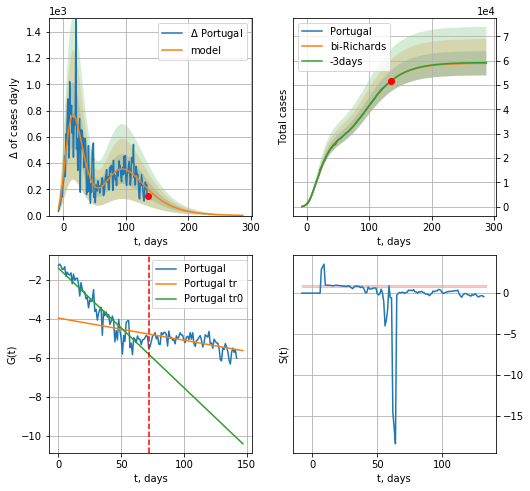

Portugal data at: 2020-08-02
+3 day model MAPE: 0.001418
model: bi-Richards
coeffs: [ 2.95594645e+04  1.84312769e+00 -2.93714398e+01  1.74909228e-02]
rational stdev: 0.084503
forecast at the end of period: +153 days
	 deltaDaycases: 1
	 total cases: 58919 ± 4978
	 total death: 1989 ± 504
bi-Richards approximation splitting point: 72
trend coefficient of determination: 0.890006
 intercept: -1.392237
 slope: -0.061235
trend coefficient of determination: 0.360115
 intercept: -3.950244
 slope: -0.011350


In [4125]:
iL = 10
vL=72+iL
x = forecastRR('Portugal',dfPT[iL:vL-iL],d1,40*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Portugal',dfPT[iL:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


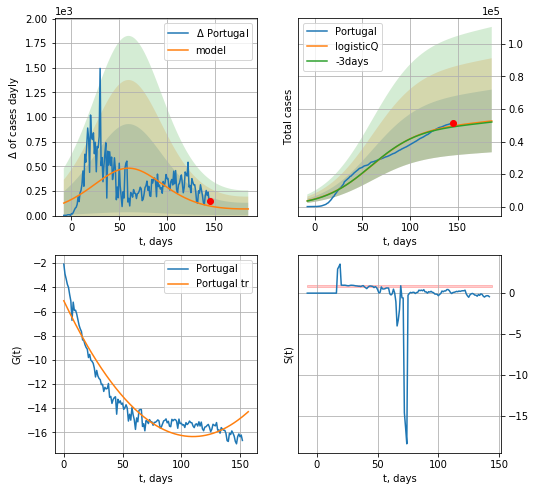

Portugal data at: 2020-08-02
+3 day model MAPE: 0.011779
model: logisticQ
coeffs: [ 4.96666895e+04  6.43209270e-08  5.98050774e+01 -5.94309889e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.365818
forecast at the end of period: +41 days
	 deltaDaycases: 67
	 total cases: 52651 ± 19260
	 total death: 1778 ± 1951
trend coefficient of determination: 0.914359
 intercept_: -5.111400731858598
 coeffs_: [ 0.         -0.20432974  0.00092905]


In [4126]:
x = forecastRRR('Portugal',dfPT[:],d1,24*7-dT,1.,addpred=True,xcoef=koreaCoeffs)

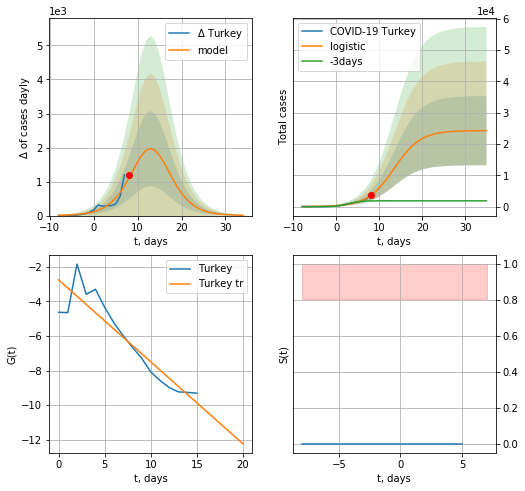

Turkey data at: 2020-08-02
+3 day model MAPE: 1.5246812178063545
model: logistic
coeffs:  [2.42671393e+04 3.25610709e-01 1.34529674e+01]
rational stdev:  0.45520285261707166
forecast at the end of period: +27 days
	 deltaDaycases:  8
	 total cases:  24245 ± 11036
	 total death:  596 ± 813
trend coefficient of determination: 0.850665
 intercept: -2.746555
 slope: -0.474541


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


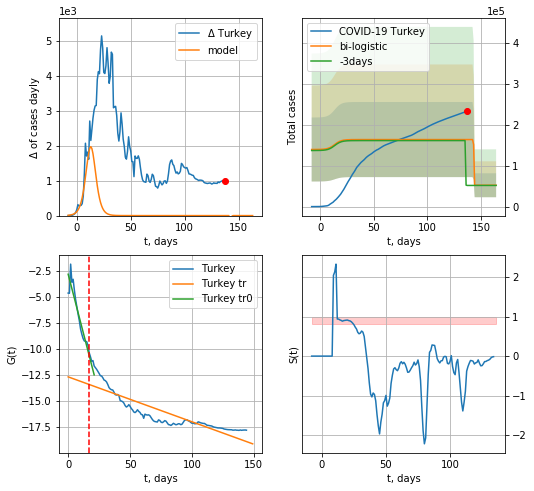

Turkey data at: 2020-08-02
+3 day model MAPE: 2.168870044915888
model: bi-logistic
coeffs:  [ 1.11482696e+05 -1.13603246e+01  1.43183693e+02] [2.42671393e+04 3.25610709e-01 1.34529674e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.559994616976707
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  52137 ± 29196
	 total death:  1282 ± 2153
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.862807
 intercept: -2.813054
 slope: -0.461241
trend coefficient of determination: 0.753174
 intercept: -12.690022
 slope: -0.043254


In [4127]:
vL=17
x = forecast('Turkey',dfTR[:vL],d1,7*T18-dT,1.)
xx=forecast2('Turkey',dfTR[:],d1,T18*7-dT,x,1.,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


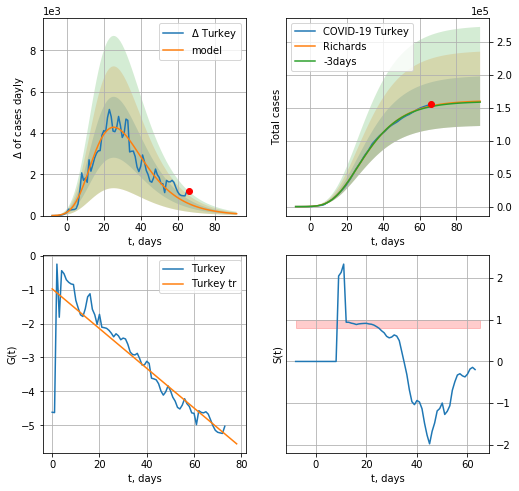

Turkey data at: 2020-08-02
+3 day model MAPE: 0.006544
model: Richards
coeffs: [ 1.61234279e+05  5.77618311e+00 -3.44308441e+01  1.25694326e-02]
rational stdev: 0.235075
forecast at the end of period: +27 days
	 deltaDaycases: 91
	 total cases: 160008 ± 37613
	 total death: 3936 ± 2775
trend coefficient of determination: 0.775259
 intercept: -0.978843
 slope: -0.058549


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


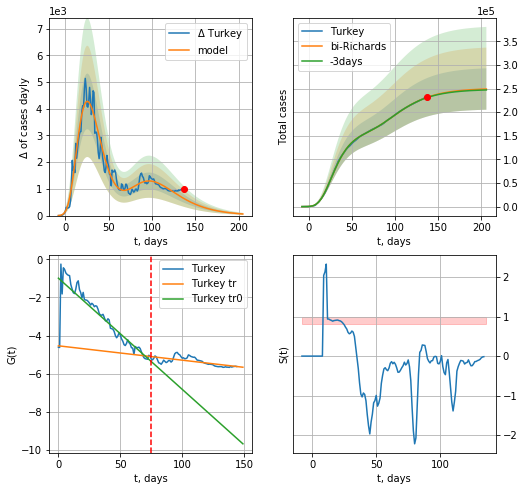

Turkey data at: 2020-08-02
+3 day model MAPE: 0.002724
model: bi-Richards
coeffs: [ 8.94057315e+04  2.87983712e+00 -1.48323943e+01  1.31445237e-02]
rational stdev: 0.176059
forecast at the end of period: +69 days
	 deltaDaycases: 60
	 total cases: 249061 ± 43849
	 total death: 6126 ± 3235
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.781083
 intercept: -0.988179
 slope: -0.058364
trend coefficient of determination: 0.466422
 intercept: -4.539096
 slope: -0.007541


In [4128]:
vL = 75
x = forecastRR('Turkey',dfTR[:vL],d1,T18*7-dT,1.,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Turkey',dfTR[:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

In [4129]:
#x = forecastQR('Turkey',dfTR[:],d1,16*7,1.,addpred=False,xcoef=[0.35,.5,3,1,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


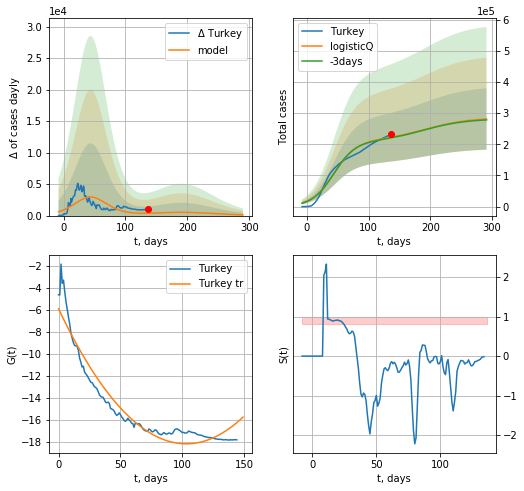

Turkey data at: 2020-08-02
+3 day model MAPE: 0.009890
model: logisticQ
coeffs: [ 2.11106956e+05  8.05716271e-08  4.40142036e+01 -6.86789260e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.350355
forecast at the end of period: +154 days
	 deltaDaycases: 117
	 total cases: 281427 ± 98599
	 total death: 6922 ± 7275
trend coefficient of determination: 0.922728
 intercept_: -5.899532864579054
 coeffs_: [ 0.         -0.23813111  0.00115435]


In [4130]:
x = forecastRRR('Turkey',dfTR[:],d1,T18*7,1.,addpred=True,xcoef=koreaCoeffs)

#xx=forecast2R('Turkey',dfTR[:],d1,14*7-dT,x,1.)

In [4131]:
dfTT[dfTT.Country=='%s'%("Latvia")][0].values[0]

0.025682182985553772

In [4132]:
#trend3(dfPL[1:],dfIS[7:],dfSW,'PL','IS','SW',40,40,40)

PL
           date    cases  active   death
147 2020-07-29  44416.0    9679  1709.0
148 2020-07-30  45031.0    9679  1709.0
149 2020-07-31  45688.0    9985  1716.0
150 2020-08-01  46346.0   10251  1721.0
151 2020-08-02  46894.0   10282  1731.0


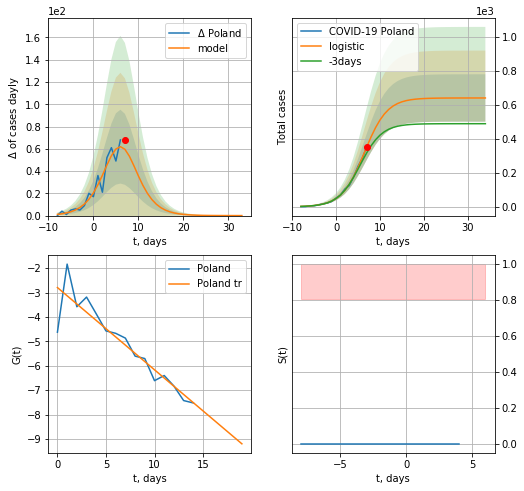

Poland data at: 2020-08-02
+3 day model MAPE: 0.14646235252259687
model: logistic
coeffs:  [6.41107575e+02 3.87606717e-01 6.46563504e+00]
rational stdev:  0.2177068805945458
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  641 ± 139
	 total death:  23 ± 15
trend coefficient of determination: 0.843228
 intercept: -2.795749
 slope: -0.337043


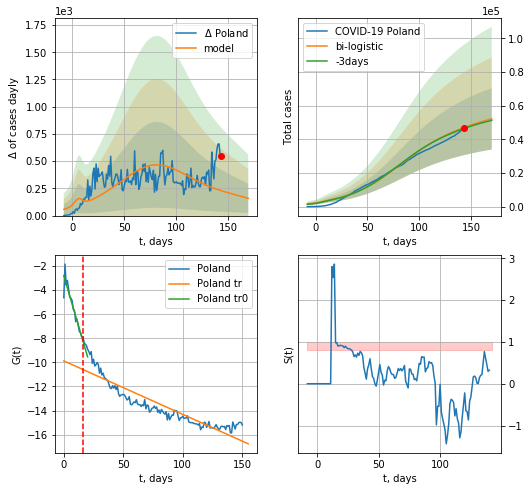

Poland data at: 2020-08-02
+3 day model MAPE: 0.012287058857445174
model: bi-logistic
coeffs:  [4.59214986e+04 3.89537234e-02 7.96645769e+01] [6.41107575e+02 3.87606717e-01 6.46563504e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3493066046519085
forecast at the end of period: +27 days
	 deltaDaycases:  158
	 total cases:  52157 ± 18218
	 total death:  1925 ± 2017
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.867285
 intercept: -2.795308
 slope: -0.337138
trend coefficient of determination: 0.824420
 intercept: -9.875569
 slope: -0.044444


In [4133]:
vL=16
vL1=38
try:
    dfPL = read_df(pd.DataFrame(),"PL")
    x =  forecast('Poland',dfPL[:vL],d1,7*T18-dT,1.)
    xx = forecast2('Poland',dfPL[:],d1,T18*7-dT,x,1.,vL=vL,addpred=True,xcoef=[0.25,1.,2.])
    #xx = np.concatenate((x, xx), axis=0)
    #xxx = forecast3("Poland",dfPL,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.5,1.,1.3],vL=[vL,vL1])
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


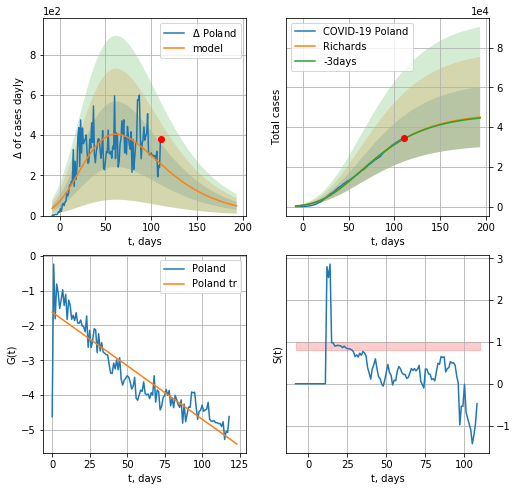

Poland data at: 2020-08-02
+3 day model MAPE: 0.004129
model: Richards
coeffs: [ 4.71367602e+04  2.41241361e+00 -1.35493652e+02  9.71752957e-03]
rational stdev: 0.335893
forecast at the end of period: +83 days
	 deltaDaycases: 48
	 total cases: 45041 ± 15129
	 total death: 1662 ± 1674
trend coefficient of determination: 0.829985
 intercept: -1.620348
 slope: -0.030685


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


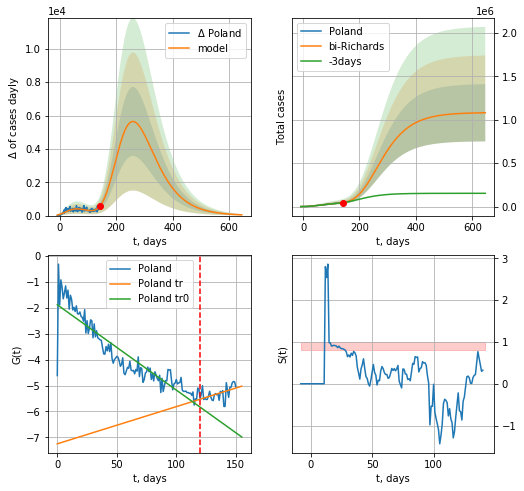

Poland data at: 2020-08-02
+3 day model MAPE: 0.014974
model: bi-Richards
coeffs: [1.03576660e+06 2.70988487e-01 7.08677474e+01 5.60825976e-02]
rational stdev: 0.304909
forecast at the end of period: +503 days
	 deltaDaycases: 45
	 total cases: 1079953 ± 329287
	 total death: 39864 ± 36464
bi-Richards approximation splitting point: 120
trend coefficient of determination: 0.840802
 intercept: -1.884557
 slope: -0.032902
trend coefficient of determination: 0.246488
 intercept: -7.247974
 slope: 0.014344


In [4134]:
vL = 120
x =  forecastRR('Poland',dfPL[:vL],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx =  forecast2RR('Poland',dfPL[:],d1,90*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#xx = forecast2R('Poland',dfPL[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


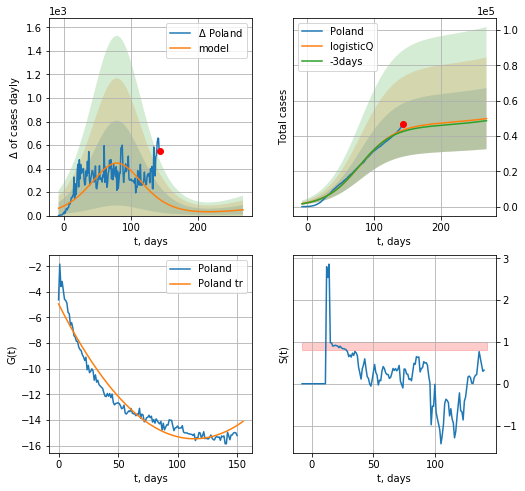

Poland data at: 2020-08-02
+3 day model MAPE: 0.018732
model: logisticQ
coeffs: [ 4.68062183e+04  1.32228734e-07  7.90970919e+01 -2.87123399e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.347389
forecast at the end of period: +125 days
	 deltaDaycases: 49
	 total cases: 49879 ± 17327
	 total death: 1841 ± 1918
trend coefficient of determination: 0.948913
 intercept_: -4.941774338347404
 coeffs_: [ 0.         -0.18442849  0.00080833]


In [4135]:
x =  forecastRRR('Poland',dfPL[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

IS
           date    cases  active  death
158 2020-07-29  68769.0   32756  497.0
159 2020-07-30  70379.0   26080  503.0
160 2020-07-31  70970.0   26608  512.0
161 2020-08-01  72315.0   26153  531.0
162 2020-08-02  73231.0   25167  541.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


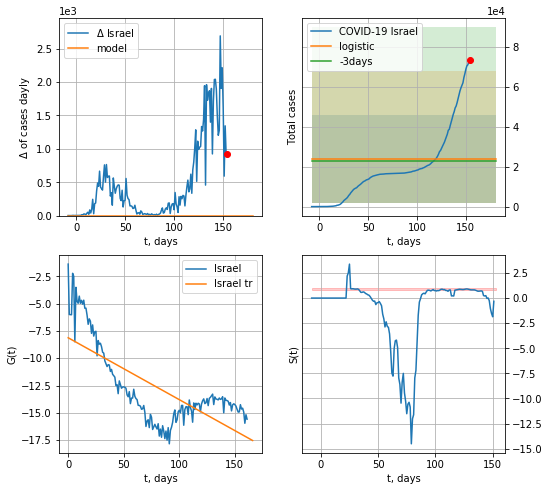

Israel data at: 2020-08-02
+3 day model MAPE: 0.05510848184736225
model: logistic
coeffs:  [ 1.90648348e+04 -8.17114156e+00  2.12970476e+02]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9245814201649206
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  23831 ± 22033
	 total death:  176 ± 488
trend coefficient of determination: 0.529885
 intercept: -8.129059
 slope: -0.056672


In [4136]:
dfIS = read_df(pd.DataFrame(),"IS")
try:
    x = forecast('Israel',dfIS[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print ("Exception occurs")
#xx = forecast2('Israel',dfIS[:],d1,20-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


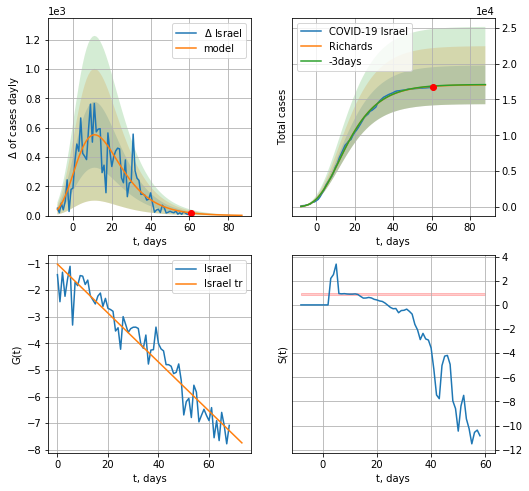

Israel data at: 2020-08-02
+3 day model MAPE: 0.001940
model: Richards
coeffs: [ 1.70515692e+04  6.43104023e+00 -3.67761649e+01  1.37703182e-02]
rational stdev: 0.158197
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 17031 ± 2694
	 total death: 125 ± 59
trend coefficient of determination: 0.925544
 intercept: -1.027515
 slope: -0.091953


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


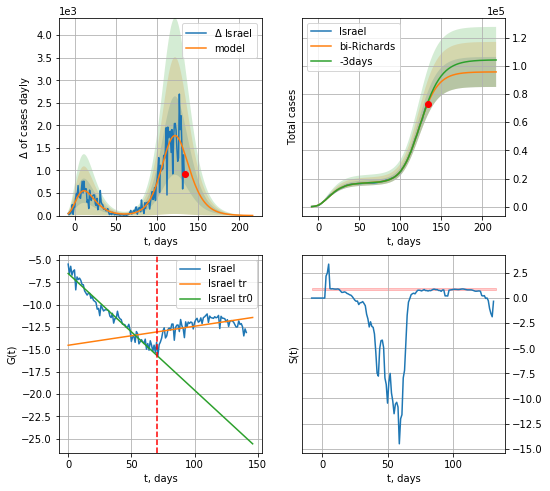

Israel data at: 2020-08-02
+3 day model MAPE: 0.013692
model: bi-Richards
coeffs: [7.86665432e+04 1.07935543e-01 1.19233318e+02 7.78770530e-01]
rational stdev: 0.111369
forecast at the end of period: +83 days
	 deltaDaycases: 2
	 total cases: 95690 ± 10656
	 total death: 706 ± 235
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.960454
 intercept: -6.500277
 slope: -0.130590
trend coefficient of determination: 0.248184
 intercept: -14.533941
 slope: 0.021300


In [4137]:
x = forecastRR('Israel',dfIS[20:90],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Israel',dfIS[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=90-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


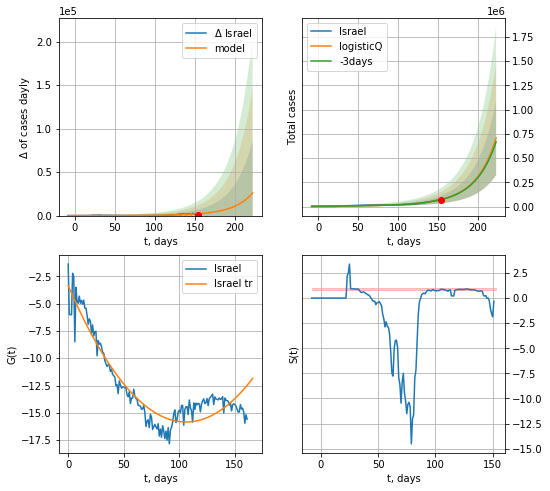

Israel data at: 2020-08-02
+3 day model MAPE: 0.011487
model: logisticQ
coeffs: [ 1.47404452e+08  6.77720828e-05  3.39930188e+02 -4.50148493e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.539496
forecast at the end of period: +69 days
	 deltaDaycases: 26005
	 total cases: 707466 ± 381675
	 total death: 5226 ± 8458
trend coefficient of determination: 0.885640
 intercept_: -3.3627684430006415
 coeffs_: [ 0.         -0.2354089   0.00111017]


In [4138]:
x = forecastRRR('Israel',dfIS[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


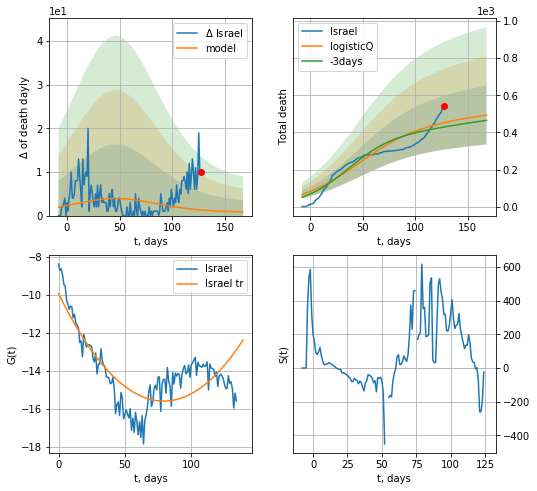

Israel data at: 2020-08-02
+3 day model MAPE: 0.053678
model: logisticQ
coeffs: [ 4.41987186e+02  4.94094181e-08  4.54375916e+01 -6.86845544e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.320024
forecast at the end of period: +41 days
	 total death: 493 ± 158
trend coefficient of determination: 0.644199
 intercept_: -9.935701947188107
 coeffs_: [ 0.         -0.14268649  0.00090006]


In [4139]:
x = forecastRRR('Israel',dfIS[27:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

SZ
           date    cases  active   death
155 2020-07-29  34802.0    1942  1980.0
156 2020-07-30  35022.0    1942  1980.0
157 2020-07-31  35232.0    2151  1981.0
158 2020-08-01  35412.0    2131  1981.0
159 2020-08-02  35550.0    2069  1981.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


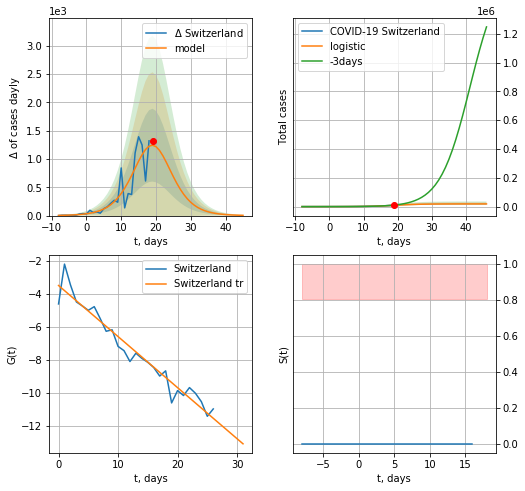

Switzerland data at: 2020-08-02
+3 day model MAPE: 0.24949882905970236
model: logistic
coeffs:  [1.87061213e+04 2.66466230e-01 1.93986309e+01]
rational stdev:  0.3060478989718857
forecast at the end of period: +27 days
	 deltaDaycases:  4
	 total cases:  18690 ± 5720
	 total death:  1041 ± 955
trend coefficient of determination: 0.944448
 intercept: -3.508672
 slope: -0.309041


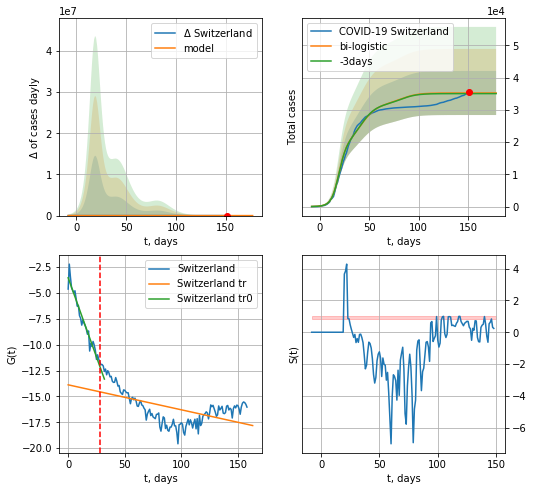

Switzerland data at: 2020-08-02
+3 day model MAPE: 0.005489712438738652
model: bi-logistic
coeffs:  [1.32247354e+04 1.22980756e-01 4.16436594e+01] [1.87061213e+04 2.66466230e-01 1.93986309e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.19387785439898025
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  35237 ± 6831
	 total death:  1963 ± 1141
bi-logistic approximation splitting point: 28
trend0 coefficient of determination: 0.947988
 intercept: -3.537068
 slope: -0.305765
trend coefficient of determination: 0.307441
 intercept: -13.876647
 slope: -0.024135


In [4140]:
vL= 28
dfSZ = read_df(pd.DataFrame(),"SZ")
x = forecast('Switzerland',dfSZ[:vL],d1,7*T18-dT)
xx = forecast2('Switzerland',dfSZ[:],d1,7*T18-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,2.])#,addpred=False,xcoef=[0.25,1.,2.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


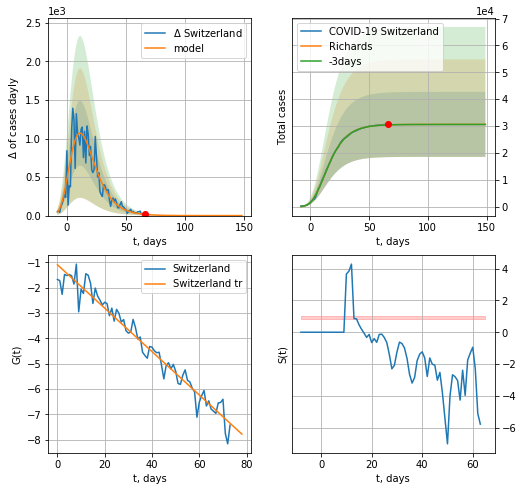

Switzerland data at: 2020-08-02
+3 day model MAPE: 0.000864
model: Richards
coeffs: [ 3.06308865e+04  7.16537801e+00 -3.34375097e+01  1.33541414e-02]
rational stdev: 0.394656
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 30630 ± 12088
	 total death: 1706 ± 2019
trend coefficient of determination: 0.958074
 intercept: -1.096880
 slope: -0.085687


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


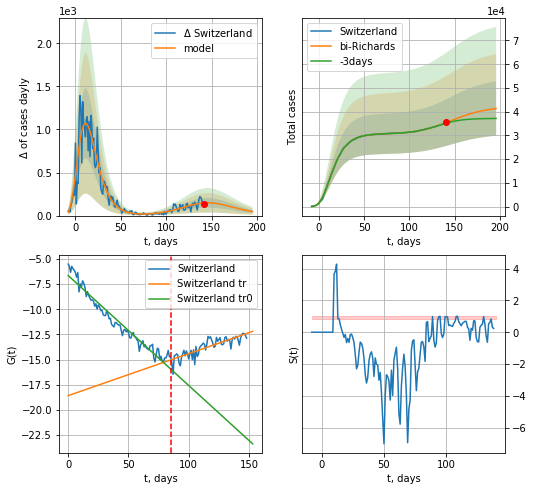

Switzerland data at: 2020-08-02
+3 day model MAPE: 0.008096
model: bi-Richards
coeffs: [1.18007565e+04 6.55445450e-02 1.37893389e+02 6.98706953e-01]
rational stdev: 0.277136
forecast at the end of period: +55 days
	 deltaDaycases: 46
	 total cases: 41344 ± 11457
	 total death: 2303 ± 1914
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.950997
 intercept: -6.641137
 slope: -0.109374
trend coefficient of determination: 0.709025
 intercept: -18.585457
 slope: 0.041763


In [4141]:
iL = 10
vL = 85 + iL
x = forecastRR('Switzerland',dfSZ[iL:vL-iL],d1,7*30-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Switzerland',dfSZ[iL:],d1,7*26-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#xx = forecastR('Switzerland',dfSZ[:],d1,7*5-dT,x,vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


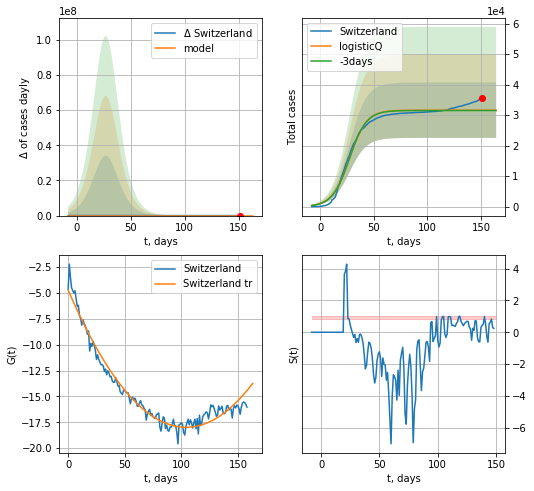

Switzerland data at: 2020-08-02
+3 day model MAPE: 0.004064
model: logisticQ
coeffs: [ 3.16446423e+04  3.39000973e-07  2.72695247e+01 -3.69365577e+05]
rational stdev: 0.287625
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 31644 ± 9101
	 total death: 1763 ± 1521
trend coefficient of determination: 0.965914
 intercept_: -4.7187159666124
 coeffs_: [ 0.         -0.25474774  0.00122331]


In [4142]:
x = forecastRRR('Switzerland',dfSZ[:],d1,7*20-dT,addpred=False,xcoef=koreaCoeffs)

In [4143]:
#trend3(dfUR[5:],dfIN[7:],dfRS[5:],'UR','IN','RS',40,40,40)

Ukr
           date    cases  active   death
141 2020-07-29  68794.0   28967  1673.0
142 2020-07-30  69884.0   29439  1693.0
143 2020-07-31  71056.0   30039  1709.0
144 2020-08-01  72168.0   30900  1725.0
145 2020-08-02  73158.0   31544  1738.0


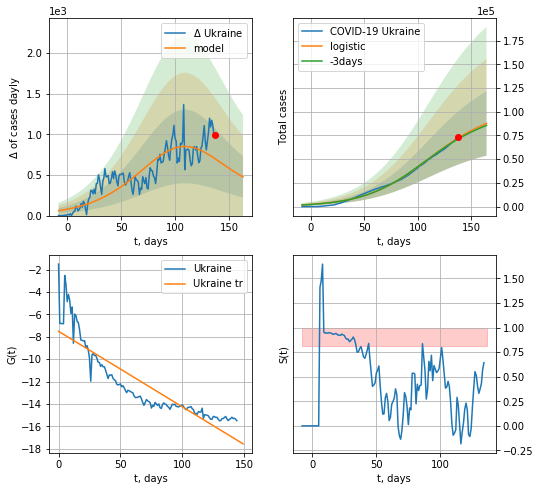

Ukraine data at: 2020-08-02
+3 day model MAPE: 0.013700756828753607
model: logistic
coeffs:  [9.66612674e+04 3.43689711e-02 1.08240800e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.38704694759812536
forecast at the end of period: +27 days
	 deltaDaycases:  475
	 total cases:  87679 ± 33936
	 total death:  2082 ± 2417
trend coefficient of determination: 0.788542
 intercept: -7.512695
 slope: -0.067490


In [4144]:
dfUR = read_df(pd.DataFrame(),"Ukr")
try:
    x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,2.])
except:
      print("Exaption occurs") 

#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


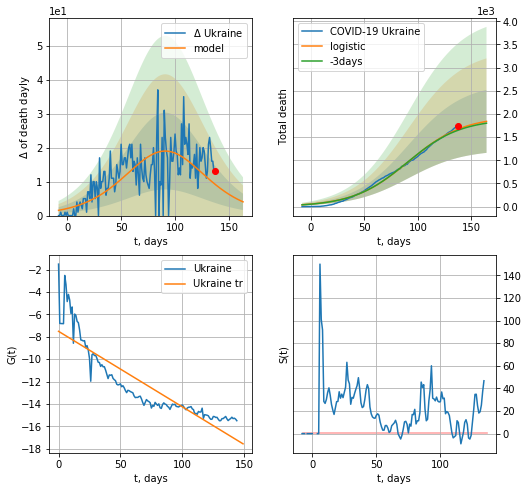

Ukraine data at: 2020-08-02
+3 day model MAPE: 0.014038815458677315
model: logistic
coeffs:  [1.94796232e+03 3.90016733e-02 9.13115879e+01]
rational stdev:  0.36945704771496923
forecast at the end of period: +27 days
	 total death:  1839 ± 679
trend coefficient of determination: 0.788542
 intercept: -7.512695
 slope: -0.067490


In [4145]:
x=forecast('Ukraine',dfUR[:],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.],cases='death')
#xx=forecast2('Ukraine',dfUR[:],d1,14-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


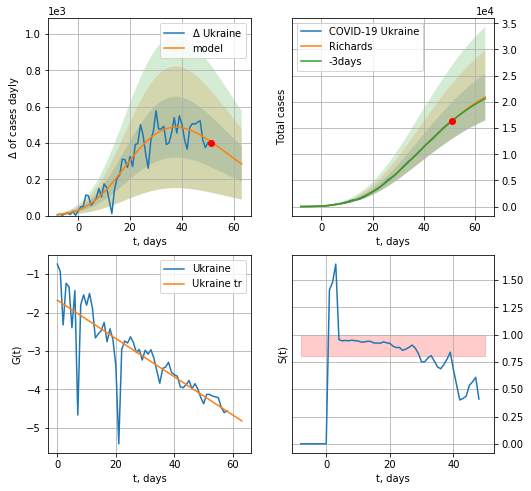

Ukraine data at: 2020-08-02
+3 day model MAPE: 0.005756
model: Richards
coeffs: [ 2.73152267e+04  5.78390591e-01 -1.00505553e+01  8.74755349e-02]
rational stdev: 0.213278
forecast at the end of period: +13 days
	 deltaDaycases: 284
	 total cases: 20922 ± 4462
	 total death: 497 ± 317
trend coefficient of determination: 0.678475
 intercept: -1.678868
 slope: -0.049847


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


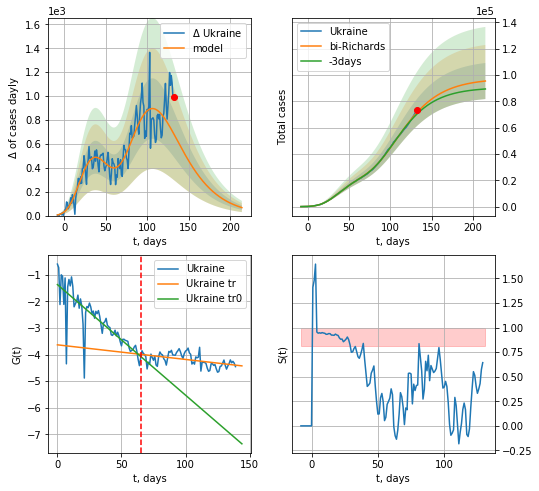

Ukraine data at: 2020-08-02
+3 day model MAPE: 0.017182
model: bi-Richards
coeffs: [ 7.00944864e+04  2.51773625e+00 -2.03154767e+01  1.32822527e-02]
rational stdev: 0.143647
forecast at the end of period: +83 days
	 deltaDaycases: 66
	 total cases: 95417 ± 13706
	 total death: 2266 ± 976
bi-Richards approximation splitting point: 65
trend coefficient of determination: 0.664101
 intercept: -1.365683
 slope: -0.041595
trend coefficient of determination: 0.242551
 intercept: -3.631943
 slope: -0.005493


In [4146]:
vL = 65+5
x=forecastRR('Ukraine',dfUR[5:vL-5],d1,7*20-dT,addpred=False,xcoef=RkoreaCoeffs)
xx=forecast2RR('Ukraine',dfUR[5:],d1,7*30-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


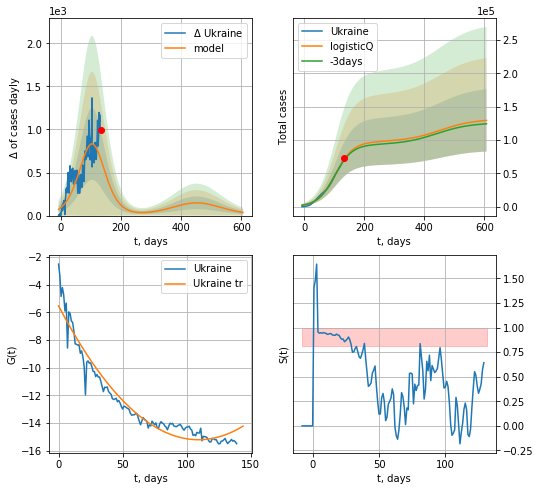

Ukraine data at: 2020-08-02
+3 day model MAPE: 0.015202
model: logisticQ
coeffs: [ 9.73369220e+04  2.99944786e-07  1.03697378e+02 -1.13729546e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.361336
forecast at the end of period: +475 days
	 deltaDaycases: 36
	 total cases: 129559 ± 46814
	 total death: 3077 ± 3335
trend coefficient of determination: 0.941139
 intercept_: -5.534898874576836
 coeffs_: [ 0.         -0.17724377  0.00081149]


In [4147]:
x=forecastRRR('Ukraine',dfUR[5:],d1,7*86-dT,addpred=True,xcoef=koreaCoeffs)

In [4148]:
#np.log(np.diff(dfIS["cases"].values)[:]/dfIS["cases"].values[1:]**2)

IN
           date   cases  active    death
161 2020-07-29  298909   23761  16569.0
162 2020-07-30  301530   23761  16569.0
163 2020-07-31  304204   23919  16766.0
164 2020-08-01  306752   23940  16982.0
165 2020-08-02  309437   24145  17190.0


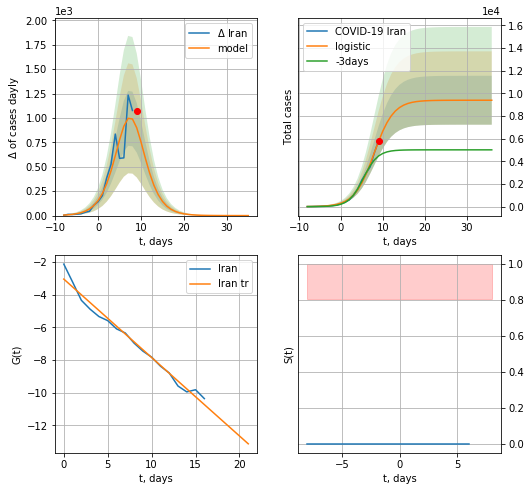

Iran data at: 2020-08-02
+3 day model MAPE: 0.4176898990261385
model: logistic
coeffs:  [9.38566043e+03 4.29600562e-01 7.92981700e+00]
rational stdev:  0.2297342183396625
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  9385 ± 2156
	 total death:  521 ± 359
trend coefficient of determination: 0.980602
 intercept: -3.037586
 slope: -0.480406


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:195: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


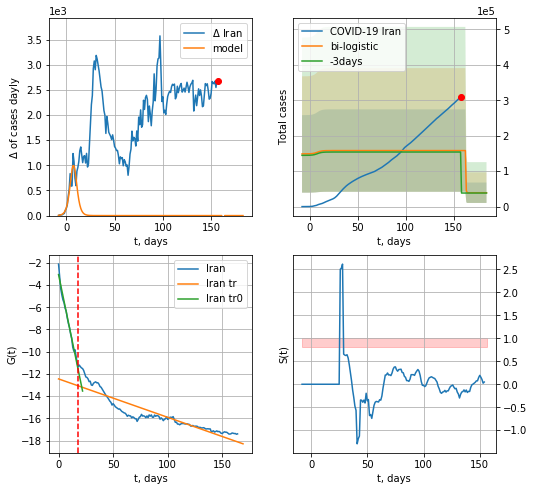

Iran data at: 2020-08-02
+3 day model MAPE: 3.1272347550612025
model: bi-logistic
coeffs:  [ 1.18991426e+05 -3.76185409e+01  1.62922870e+02] [9.38566043e+03 4.29600562e-01 7.92981700e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.7356488691296224
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  39133 ± 28788
	 total death:  2173 ± 4795
bi-logistic approximation splitting point: 18
trend0 coefficient of determination: 0.982944
 intercept: -3.059655
 slope: -0.476268
trend coefficient of determination: 0.827716
 intercept: -12.446360
 slope: -0.034546


In [4149]:
dfIN = read_df(pd.DataFrame(),"IN")
x = forecast('Iran',dfIN[:18],d1,7*T18-dT)
xx = forecast2('Iran',dfIN[:],d1,T18*7-dT,x,vL=18,addpred=True,xcoef=[0.25,1.,2.0])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


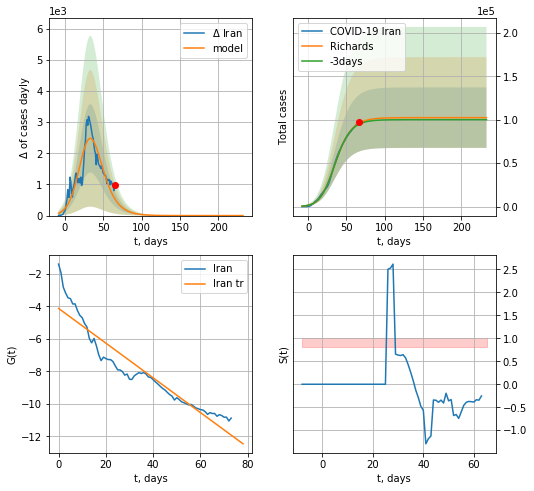

Iran data at: 2020-08-02
+3 day model MAPE: 0.012009
model: Richards
coeffs: [1.02478152e+05 1.52216307e-01 2.65523943e+01 5.45962781e-01]
rational stdev: 0.339941
forecast at the end of period: +167 days
	 deltaDaycases: 0
	 total cases: 102478 ± 34836
	 total death: 5692 ± 5804
trend coefficient of determination: 0.893485
 intercept: -4.118018
 slope: -0.106957


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


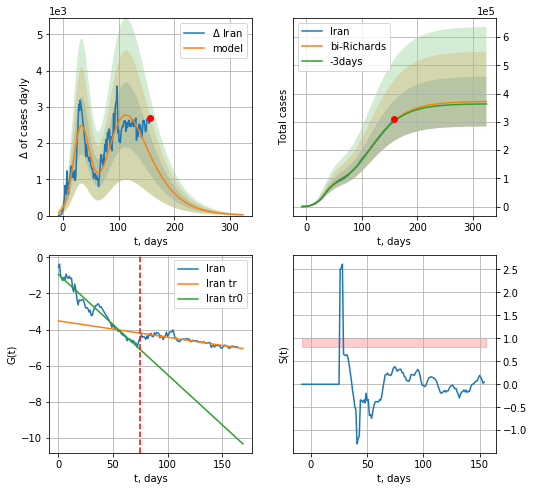

Iran data at: 2020-08-02
+3 day model MAPE: 0.007747
model: bi-Richards
coeffs: [ 2.70272448e+05  1.75782776e+00 -3.36066186e+01  1.59417167e-02]
rational stdev: 0.236945
forecast at the end of period: +167 days
	 deltaDaycases: 21
	 total cases: 371998 ± 88143
	 total death: 20665 ± 14689
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.949237
 intercept: -0.941891
 slope: -0.055561
trend coefficient of determination: 0.770827
 intercept: -3.518573
 slope: -0.009062


In [4150]:
vL = 75
x = forecastRR('Iran',dfIN[:vL],d1,42*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Iran',dfIN[:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


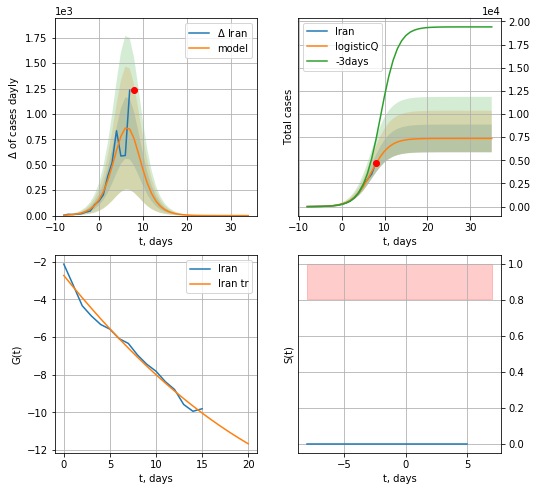

Iran data at: 2020-08-02
+3 day model MAPE: 0.437962
model: logisticQ
coeffs: [ 7.36885077e+03  7.42724103e-05 -6.37161781e+03  6.90116795e+00]
rational stdev: 0.203007
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 7368 ± 1495
	 total death: 409 ± 249
trend coefficient of determination: 0.985826
 intercept_: -2.7244557798652984
 coeffs_: [ 0.         -0.60810956  0.00802289]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


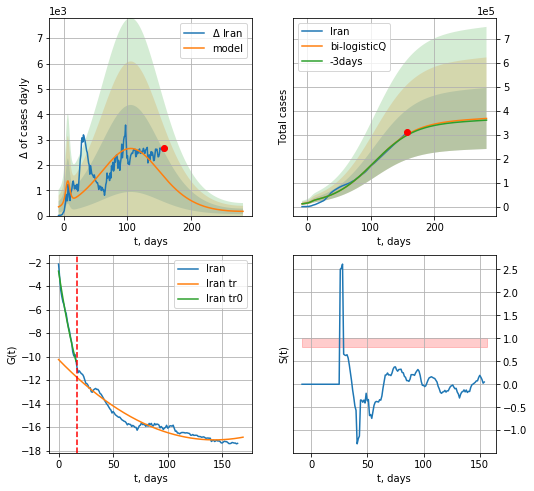

Iran data at: 2020-08-02
+3 day model MAPE: 0.009375
model: bi-logisticQ
coeffs: [ 3.53429492e+05  1.34926443e-07  1.05338503e+02 -2.21350578e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.346197
forecast at the end of period: +125 days
	 deltaDaycases: 167
	 total cases: 367182 ± 127117
	 total death: 20397 ± 21184
bi-logisticQ approximation splitting point: 17
trend coefficient of determination: 0.987745
 intercept_: -2.720144864989817
 coeffs_: [ 0.         -0.61067547  0.00823538]
trend coefficient of determination: 0.936624
 intercept_: -10.246972728406192
 coeffs_: [ 0.         -0.09580918  0.00033537]


In [4151]:
x = forecastRRR('Iran',dfIN[:17],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Iran',dfIN[:],d1,36*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=17)

RS
           date     cases  active    death
151 2020-07-29  828990.0  191042  13802.0
152 2020-07-30  834499.0  191042  13802.0
153 2020-07-31  839981.0  187608  13963.0
154 2020-08-01  845443.0  186569  14128.0
155 2020-08-02  850870.0  188464  14207.0


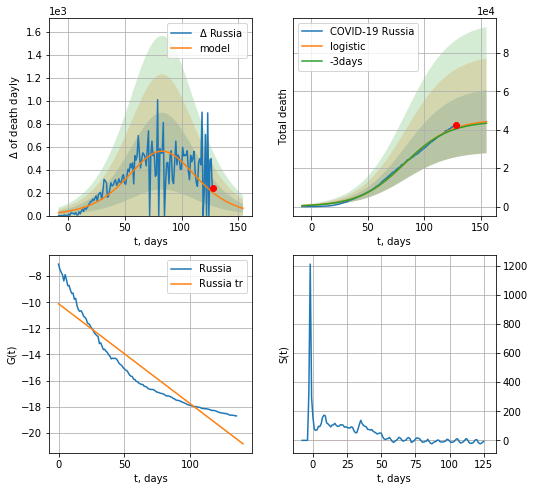

Russia data at: 2020-08-02
+3 day model MAPE: 0.01313621841456216
model: logistic
coeffs:  [4.55379459e+04 4.92501843e-02 8.33081670e+01]
rational stdev:  0.37180639014806877
forecast at the end of period: +27 days
	 total death:  44242 ± 16449
trend coefficient of determination: 0.878496
 intercept: -10.116062
 slope: -0.076633


In [4154]:
try:
    dfRS = read_df(pd.DataFrame(),"RS")
    x = forecast('Russia',dfRS[19:],d1,T18*7-dT,shift=3.,cases='death')
    #xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14)#,addpred=True,xcoef=[0.5,1.,3.5]
except:
    print ("Exeption occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


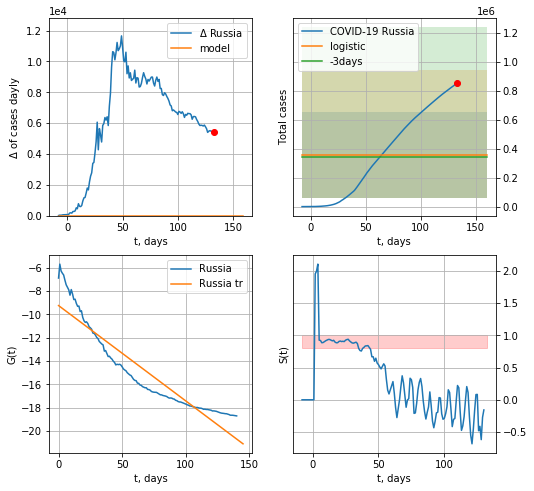

Russia data at: 2020-08-02
+3 day model MAPE: 0.030652450589625967
model: logistic
coeffs:  [ 3.55523296e+05 -9.61661630e+00  2.43625160e+02]
rational stdev:  0.8302797098056388
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  355523 ± 295183
	 total death:  5898 ± 14690
trend coefficient of determination: 0.874589
 intercept: -9.254723
 slope: -0.081699


In [4155]:
x = forecast('Russia',dfRS[14:],d1,T18*7-dT,shift=1.)
#xx = forecast2('Russia',dfRS[:],d1,9*7-dT,x,vL=14,shift=1.)#,addpred=True,xcoef=[0.5,1.,3.5]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


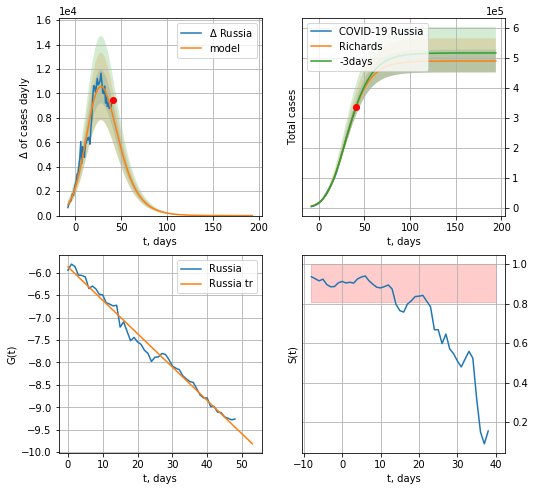

Russia data at: 2020-08-02
+3 day model MAPE: 0.008146
model: Richards
coeffs: [4.89217393e+05 1.59818344e-01 1.72404129e+01 4.47209275e-01]
rational stdev: 0.077370
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 489213 ± 37850
	 total death: 8116 ± 1883
trend coefficient of determination: 0.985880
 intercept: -5.871901
 slope: -0.074396


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


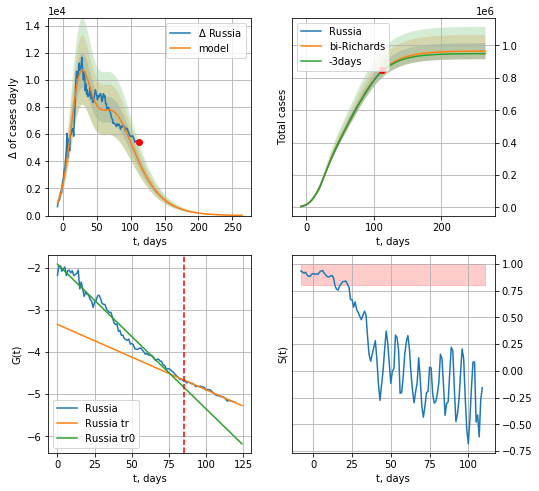

Russia data at: 2020-08-02
+3 day model MAPE: 0.005003
model: bi-Richards
coeffs: [ 4.76327030e+05  3.91208368e+00 -4.27399843e+01  9.67743136e-03]
rational stdev: 0.051651
forecast at the end of period: +153 days
	 deltaDaycases: 16
	 total cases: 965115 ± 49848
	 total death: 16013 ± 2481
bi-Richards approximation splitting point: 85
trend coefficient of determination: 0.978196
 intercept: -1.917701
 slope: -0.034343
trend coefficient of determination: 0.982644
 intercept: -3.346793
 slope: -0.015507


In [4156]:
vL = 85 + 35
x = forecastRR('Russia',dfRS[35:vL-35],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)#,addpred=True,xcoef=[0.25,1.,1.5,1]
xx = forecast2RR('Russia',dfRS[35:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-35)
#x = forecastQR('Russia',dfRS[20:],d1,30*7-dT)#,addpred=True,xcoef=[0.25,1.,1.5,1]

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


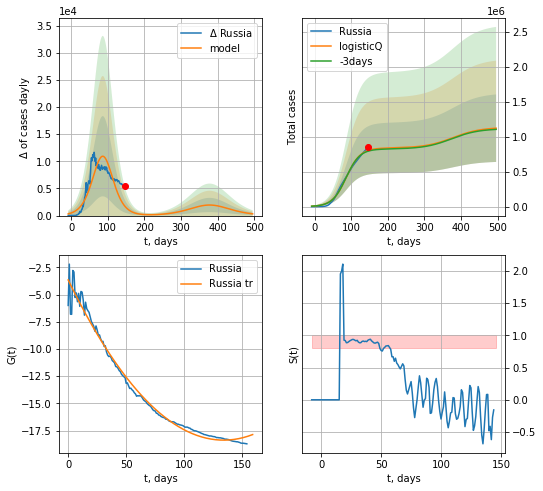

Russia data at: 2020-08-02
+3 day model MAPE: 0.012756
model: logisticQ
coeffs: [ 8.36444288e+05  1.81277033e-07  8.67077930e+01 -2.88407784e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.430528
forecast at the end of period: +349 days
	 deltaDaycases: 323
	 total cases: 1119992 ± 482188
	 total death: 18582 ± 24000
trend coefficient of determination: 0.984515
 intercept_: -3.6610790114387903
 coeffs_: [ 0.         -0.21951603  0.00081896]


In [4157]:
x = forecastRRR('Russia',dfRS[:],d1,68*7-dT,addpred=True,xcoef=koreaCoeffs)

JP
           date    cases  active   death
189 2020-07-29  31901.0    7393  1001.0
190 2020-07-30  33049.0    7866  1004.0
191 2020-07-31  34372.0    8437  1006.0
192 2020-08-01  35836.0    9319  1011.0
193 2020-08-02  36689.0    9772  1011.0


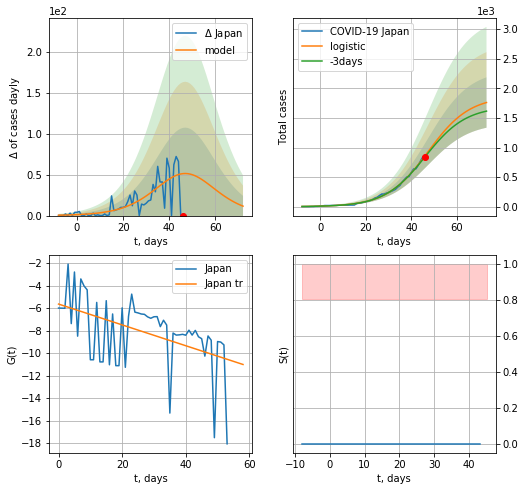

Japan data at: 2020-08-02
+3 day model MAPE: 0.024413899387998084
model: logistic
coeffs:  [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.24188431732788906
forecast at the end of period: +27 days
	 deltaDaycases:  11
	 total cases:  1761 ± 425
	 total death:  48 ± 34
trend coefficient of determination: 0.226001
 intercept: -5.646499
 slope: -0.092589


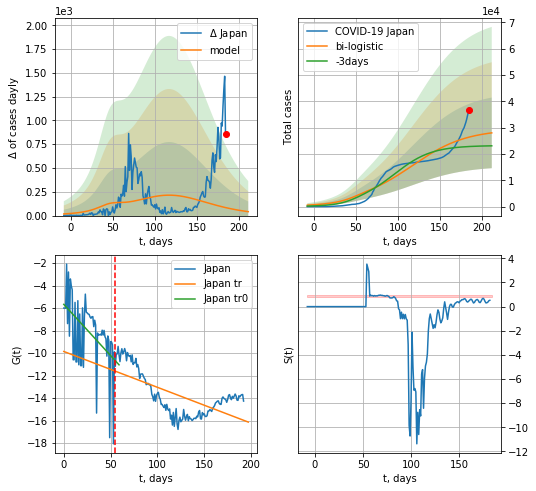

Japan data at: 2020-08-02
+3 day model MAPE: 0.15903936650833028
model: bi-logistic
coeffs:  [2.75089522e+04 3.12092669e-02 1.17522141e+02] [1.86668600e+03 1.09971339e-01 4.74124631e+01]
rational stdev:  0.4789667309575123
forecast at the end of period: +27 days
	 deltaDaycases:  41
	 total cases:  28005 ± 13413
	 total death:  771 ± 1107
bi-logistic approximation splitting point: 55
trend0 coefficient of determination: 0.229818
 intercept: -5.672459
 slope: -0.091119
trend coefficient of determination: 0.425416
 intercept: -9.860776
 slope: -0.031857


In [4158]:
dfJP = read_df(pd.DataFrame(),"JP")
try:
    x = forecast('Japan',dfJP[:55],d1,7*T18-dT)
    xx = forecast2('Japan',dfJP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,1.25],vL=55)
except:
    print ("Exception occurs")

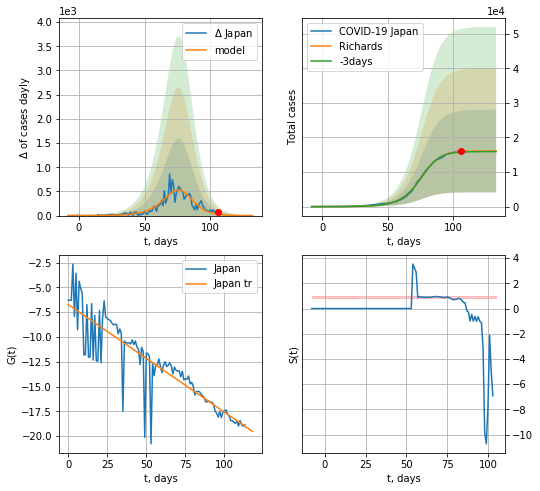

Japan data at: 2020-08-02
+3 day model MAPE: 0.009396
model: Richards
coeffs: [1.61043525e+04 1.05070375e-01 7.85362635e+01 1.40112814e+00]
rational stdev: 0.743333
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 16100 ± 11968
	 total death: 443 ± 987
trend coefficient of determination: 0.778576
 intercept: -6.726919
 slope: -0.108522


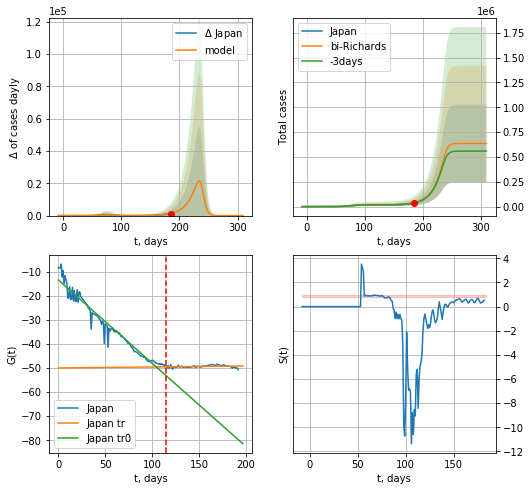

Japan data at: 2020-08-02
+3 day model MAPE: 0.010416
model: bi-Richards
coeffs: [6.19482195e+05 6.22153088e-02 2.39815694e+02 4.46955046e+00]
rational stdev: 0.615071
forecast at the end of period: +125 days
	 deltaDaycases: 0
	 total cases: 635586 ± 390930
	 total death: 17514 ± 32317
bi-Richards approximation splitting point: 115
trend coefficient of determination: 0.953619
 intercept: -13.509452
 slope: -0.344939
trend coefficient of determination: 0.036313
 intercept: -49.984399
 slope: 0.004091


In [4159]:
vL = 115
x = forecastRR('Japan',dfJP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Japan',dfJP[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


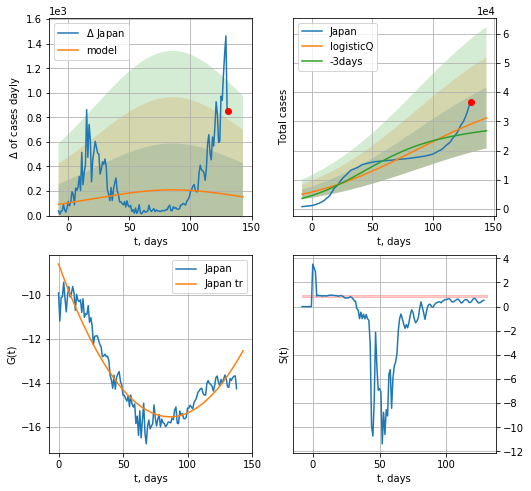

Japan data at: 2020-08-02
+3 day model MAPE: 0.120440
model: logisticQ
coeffs: [ 3.85327228e+04  5.05716314e-08  8.44218790e+01 -4.17244399e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.333451
forecast at the end of period: +13 days
	 deltaDaycases: 152
	 total cases: 31160 ± 10390
	 total death: 858 ± 858
trend coefficient of determination: 0.907323
 intercept_: -8.580165282991999
 coeffs_: [ 0.         -0.16169884  0.00093711]


In [4160]:
x = forecastRRR('Japan',dfJP[54:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

NL
           date    cases  active   death
153 2020-07-29  53621.0       0  6147.0
154 2020-07-30  53963.0       0  6147.0
155 2020-07-31  54301.0       0  6147.0
156 2020-08-01  54732.0       0  6148.0
157 2020-08-02  55098.0       0  6149.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


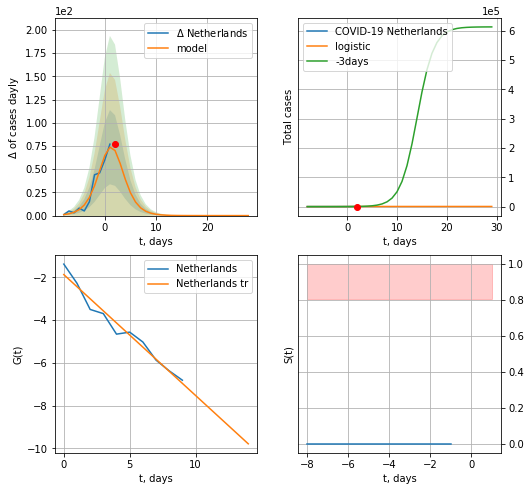

Netherlands data at: 2020-08-02
model: logistic
coeffs:  [487.7470779    0.61204075   1.72557626]
rational stdev:  0.23761281134430468
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  487 ± 115
	 total death:  54 ± 38
trend coefficient of determination: 0.966773
 intercept: -1.876651
 slope: -0.565279


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


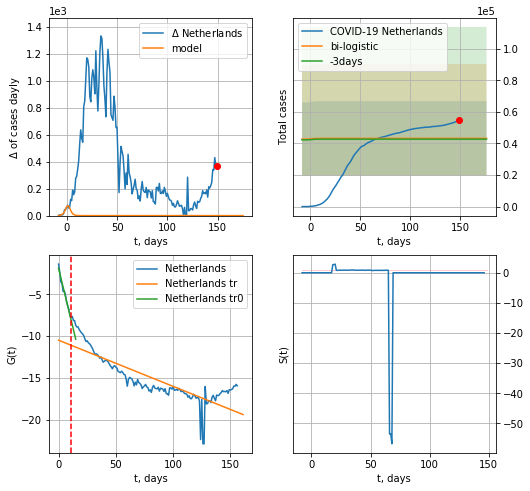

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.011366318369076407
model: bi-logistic
coeffs:  [ 3.41604263e+04 -6.46937483e+00  1.85240996e+02] [487.7470779    0.61204075   1.72557626]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.5447139548240668
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  43188 ± 23525
	 total death:  4819 ± 7874
bi-logistic approximation splitting point: 11
trend0 coefficient of determination: 0.974821
 intercept: -1.878275
 slope: -0.564738
trend coefficient of determination: 0.696699
 intercept: -10.476710
 slope: -0.055169


In [4161]:
vL=11
vL1=32
dfNL = read_df(pd.DataFrame(),"NL")
x = forecast('Netherlands',dfNL[:vL],d1,T18*7-dT,pMAPE=False)
xx = forecast2('Netherlands',dfNL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Philippines",dfPH,d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


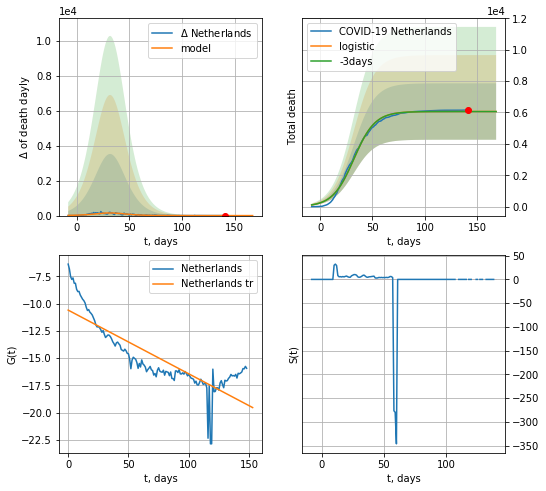

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.0006596074420212591
model: logistic
coeffs:  [6.05884819e+03 9.93622194e-02 3.22167480e+01]
rational stdev:  0.29652046929055864
forecast at the end of period: +27 days
	 total death:  6058 ± 1796
trend coefficient of determination: 0.706861
 intercept: -10.596608
 slope: -0.058405


In [4162]:
x = forecast('Netherlands',dfNL[8:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


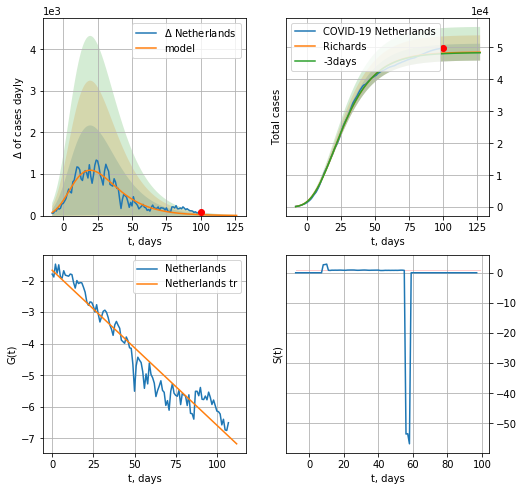

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.003784
model: Richards
coeffs: [ 4.85845846e+04  7.09392411e+00 -5.73331837e+01  8.64908228e-03]
rational stdev: 0.054290
forecast at the end of period: +27 days
	 deltaDaycases: 4
	 total cases: 48515 ± 2633
	 total death: 5414 ± 881
trend coefficient of determination: 0.931048
 intercept: -1.672604
 slope: -0.049104


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


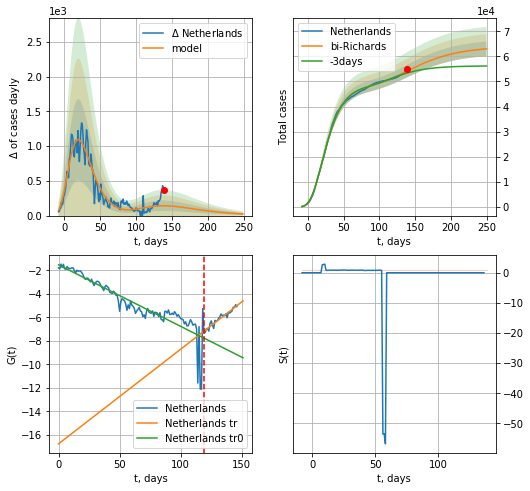

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.015077
model: bi-Richards
coeffs: [ 1.53948979e+04  3.63365868e+00 -6.17405517e+01  6.81428912e-03]
rational stdev: 0.046159
forecast at the end of period: +111 days
	 deltaDaycases: 23
	 total cases: 63007 ± 2908
	 total death: 7031 ± 973
bi-Richards approximation splitting point: 119
trend coefficient of determination: 0.815626
 intercept: -1.528203
 slope: -0.052380
trend coefficient of determination: 0.919311
 intercept: -16.761085
 slope: 0.080547


In [4165]:
iL = 10
vL = 119+iL
x = forecastRR('Netherlands',dfNL[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Netherlands',dfNL[iL:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4166]:
#x = forecastQR('Netherlands',dfNL[7:],d1,16*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


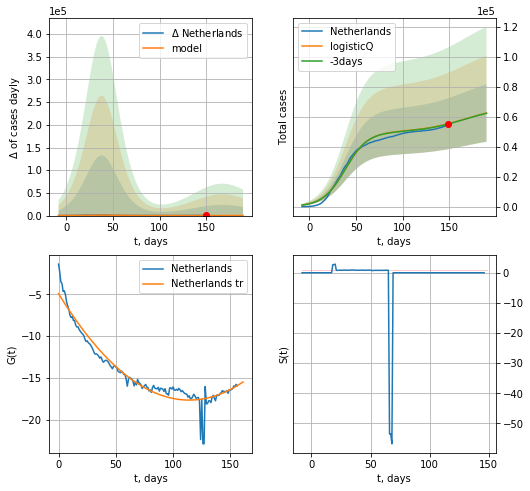

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.003179
model: logisticQ
coeffs: [ 4.97384052e+04  1.43810646e-07  3.84101739e+01 -5.75879651e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306933
forecast at the end of period: +41 days
	 deltaDaycases: 149
	 total cases: 62409 ± 19155
	 total death: 6964 ± 6412
trend coefficient of determination: 0.927164
 intercept_: -4.9212185418692584
 coeffs_: [ 0.         -0.22303567  0.00097838]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


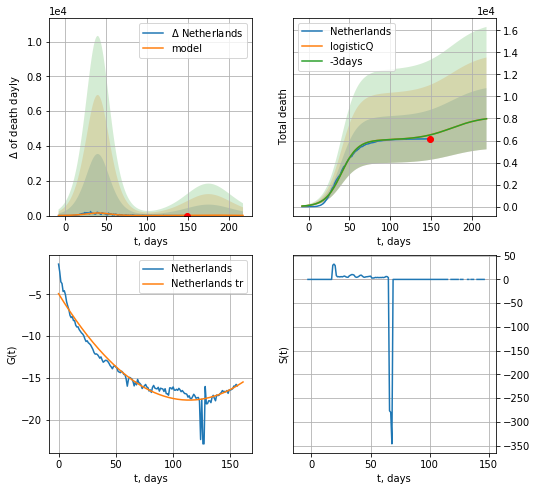

Netherlands data at: 2020-08-02
+3 day model MAPE: 0.000516
model: logisticQ
coeffs: [ 6.05794781e+03  3.29288394e-07  4.02168286e+01 -3.02390696e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.348180
forecast at the end of period: +69 days
	 total death: 7977 ± 2777
trend coefficient of determination: 0.927164
 intercept_: -4.9212185418692584
 coeffs_: [ 0.         -0.22303567  0.00097838]


In [4167]:
x = forecastRRR('Netherlands',dfNL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Netherlands',dfNL[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

In [4168]:
#trend3(dfAT[1:],dfSG[:],dfBG[:],'AT','SG','BG',40,35,35)

AT
           date    cases  active  death
154 2020-07-29  20955.0    1609  718.0
155 2020-07-30  21130.0    1654  718.0
156 2020-07-31  21212.0    1583  718.0
157 2020-08-01  21304.0    1602  718.0
158 2020-08-02  21304.0    1602  718.0
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:86: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: invalid value encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


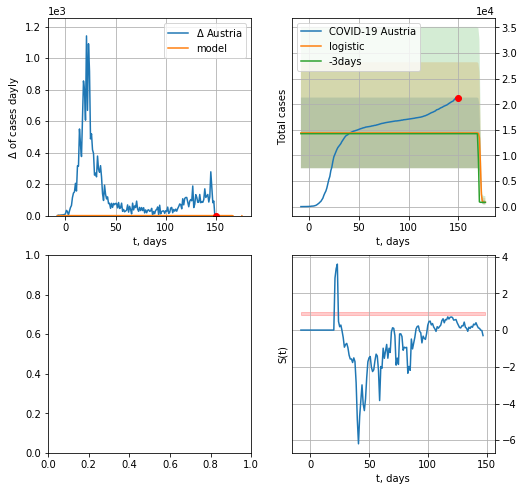

In [4170]:
dfAT = read_df(pd.DataFrame(),"AT")
try:
    x = forecast('Austria',dfAT[:],d1,7*T18-dT,addpred=True,xcoef=[0.25/4,1.,2.0])
except:
    print ("Exception occurs")
#xx = forecast2('Austria',dfAT[:],d1,7*7-dT,x,addpred=True,xcoef=[0.35*2,1.,1.5],vL=36)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


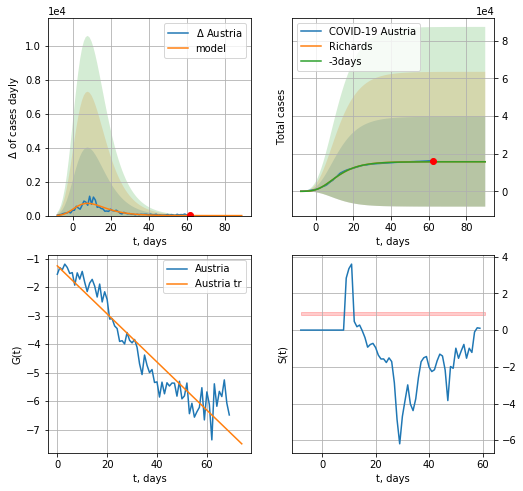

Austria data at: 2020-08-01
+3 day model MAPE: 0.004675
model: Richards
coeffs: [ 1.57373348e+04  1.44322302e+01 -2.95282735e+01  8.67503130e-03]
rational stdev: 1.514093
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 15736 ± 23826
	 total death: 530 ± 2407
trend coefficient of determination: 0.902786
 intercept: -1.255535
 slope: -0.084343


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


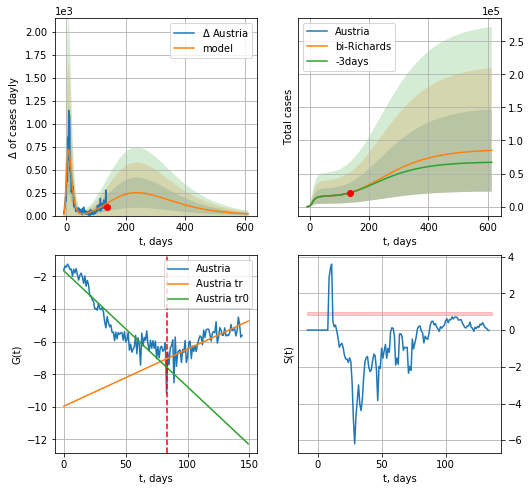

Austria data at: 2020-08-01
+3 day model MAPE: 0.004821
model: bi-Richards
coeffs: [ 7.11799468e+04  5.51959823e-01 -1.84356576e+02  1.74008549e-02]
rational stdev: 0.732033
forecast at the end of period: +476 days
	 deltaDaycases: 18
	 total cases: 85012 ± 62231
	 total death: 2865 ± 6291
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.867949
 intercept: -1.656409
 slope: -0.071207
trend coefficient of determination: 0.548855
 intercept: -9.959850
 slope: 0.035023


In [3790]:
vL=83+12
x = forecastRR('Austria',dfAT[12:vL-12],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Austria',dfAT[12:],d1,86*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)
#xx = forecast2R('Austria',dfAT[:],d1,8*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:571: RuntimeWarning: divide by zero encountered in log


ValueError: Input contains NaN, infinity or a value too large for dtype('float64').

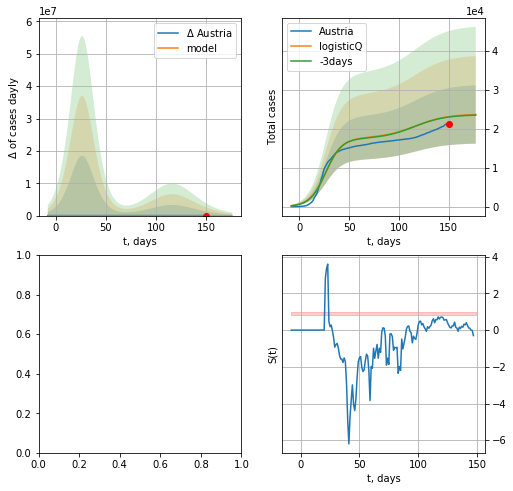

In [4171]:
vL = 68
x = forecastRRR('Austria',dfAT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
#xx = forecast2RRR('Austria',dfAT[:],d1,18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=vL)

BG
           date    cases  active   death
150 2020-07-29  67335.0   40008  9836.0
151 2020-07-30  68006.0   40653  9840.0
152 2020-07-31  68751.0   41364  9841.0
153 2020-08-01  69402.0   41984  9845.0
154 2020-08-02  69849.0   42414  9845.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


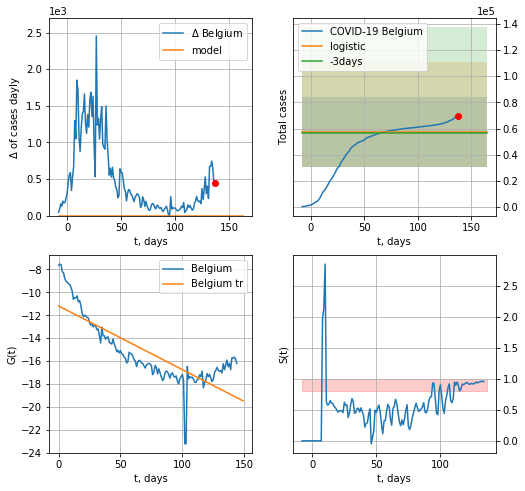

Belgium data at: 2020-08-02
+3 day model MAPE: 0.010874911499348286
model: logistic
coeffs:  [ 4.58317459e+04 -9.10115490e+00  2.85323958e+02]
scenario coeffs:  [0.25, 1.0, 3.0]
rational stdev:  0.46792011674142814
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  57289 ± 26806
	 total death:  8074 ± 11333
trend coefficient of determination: 0.662119
 intercept: -11.184911
 slope: -0.055637


In [4172]:
vL=9
try:
    dfBG = read_df(pd.DataFrame(),"BG")
    x = forecast('Belgium',dfBG[vL:],d1,T18*7-dT,addpred=True,xcoef=[0.25,1.,3.])
    #xx = forecast2('Belgium',dfBG[vL:],d1,10*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)
except:
    print("Exception occurs")

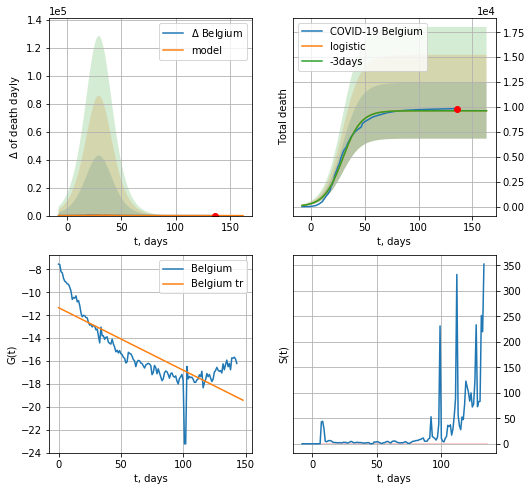

Belgium data at: 2020-08-02
+3 day model MAPE: 0.0009632292304878486
model: logistic
coeffs:  [9.62967965e+03 1.17343399e-01 2.95937298e+01]
rational stdev:  0.29111822892426414
forecast at the end of period: +27 days
	 total death:  9629 ± 2803
trend coefficient of determination: 0.656371
 intercept: -11.338779
 slope: -0.054607


In [4173]:
#dfBG = read_df(pd.DataFrame(),"BG")
x = forecast('Belgium',dfBG[10:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


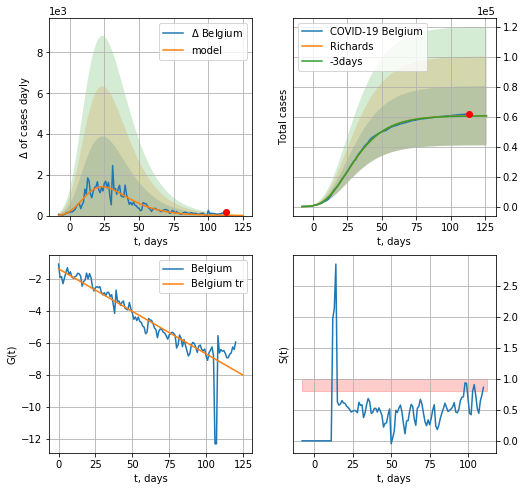

Belgium data at: 2020-08-02
+3 day model MAPE: 0.002134
model: Richards
coeffs: [ 6.07262168e+04  7.76840257e+00 -5.13869140e+01  8.19136893e-03]
rational stdev: 0.325439
forecast at the end of period: +13 days
	 deltaDaycases: 6
	 total cases: 60633 ± 19732
	 total death: 8546 ± 8343
trend coefficient of determination: 0.833449
 intercept: -1.374222
 slope: -0.053107


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


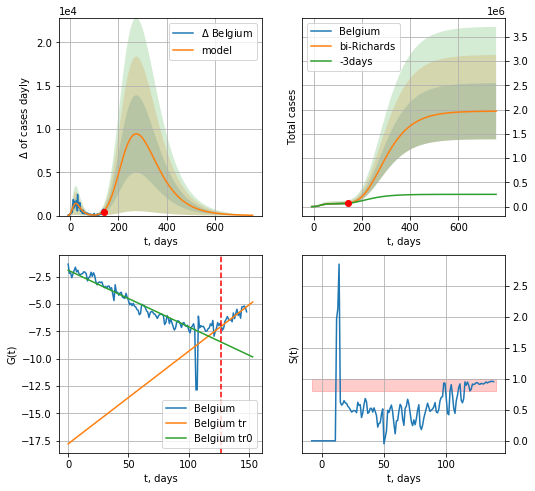

Belgium data at: 2020-08-02
+3 day model MAPE: 0.014396
model: bi-Richards
coeffs: [1.91026553e+06 2.39731814e-01 6.77025379e+01 5.76263697e-02]
rational stdev: 0.294414
forecast at the end of period: +615 days
	 deltaDaycases: 34
	 total cases: 1968533 ± 579563
	 total death: 277458 ± 245062
bi-Richards approximation splitting point: 127
trend coefficient of determination: 0.828932
 intercept: -1.891234
 slope: -0.051865
trend coefficient of determination: 0.754187
 intercept: -17.786454
 slope: 0.084801


In [4176]:
iL = 5
vL = 127+ iL
x = forecastRR('Belgium',dfBG[iL:vL-iL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Belgium',dfBG[iL:],d1,106*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


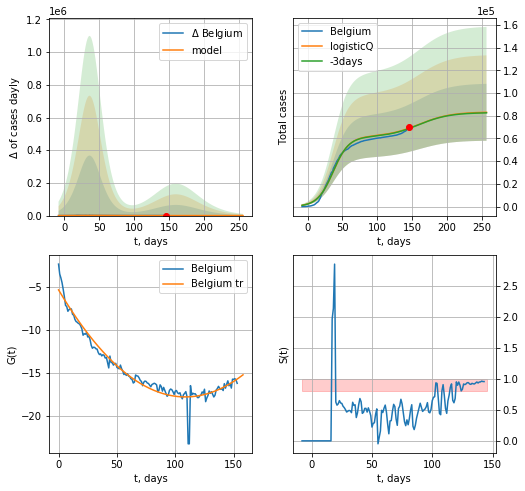

Belgium data at: 2020-08-02
+3 day model MAPE: 0.003594
model: logisticQ
coeffs: [ 6.15636752e+04  1.84419555e-07  3.67741289e+01 -4.77905090e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.301807
forecast at the end of period: +111 days
	 deltaDaycases: 13
	 total cases: 83072 ± 25071
	 total death: 11708 ± 10600
trend coefficient of determination: 0.946091
 intercept_: -5.357672839522806
 coeffs_: [ 0.         -0.22876251  0.00105286]


In [4177]:
x = forecastRRR('Belgium',dfBG[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4178]:
dfBZ.tail()

,date,cases,active,death
155,2020-07-29,2555518.0,677911,90188.0
156,2020-07-30,2613789.0,698317,91377.0
157,2020-07-31,2666298.0,689679,92568.0
158,2020-08-01,2708876.0,731209,93616.0
159,2020-08-02,2733677.0,755496,94130.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


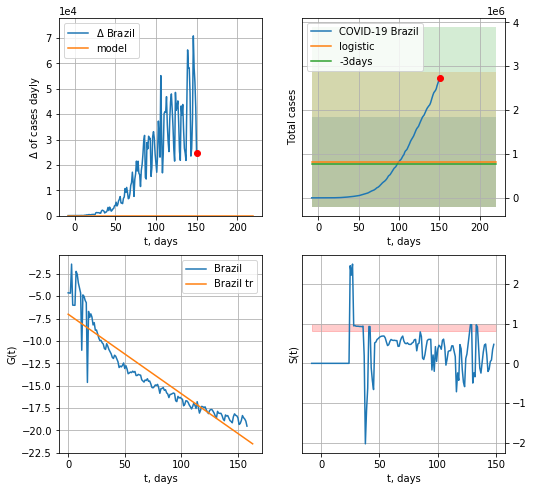

Brazil data at: 2020-08-02
+3 day model MAPE: 0.06295710687089424
model: logistic
coeffs:  [ 6.59318449e+05 -1.24150125e+01  3.04226746e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.2416887917306418
forecast at the end of period: +69 days
	 deltaDaycases:  0
	 total cases:  824148 ± 1023335
	 total death:  28378 ± 105709
trend coefficient of determination: 0.862520
 intercept: -7.016708
 slope: -0.088851


In [4179]:
x = forecast('Brazil',dfBZ[:],d1,28*7-dT,addpred=True,xcoef=[0.25,1.,2.])
#xx = forecast2('Brazil',dfBZ[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


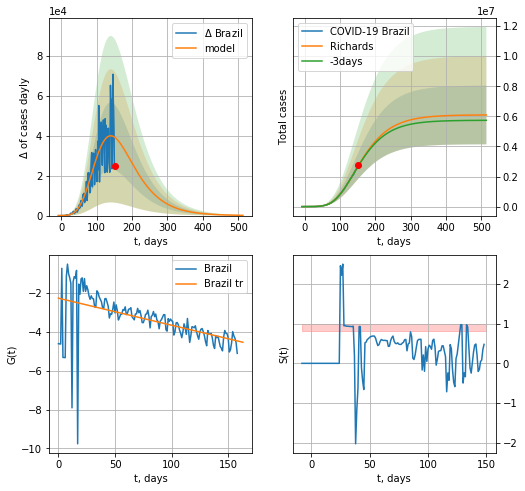

Brazil data at: 2020-08-02
+3 day model MAPE: 0.008916
model: Richards
coeffs: [ 6.09815764e+06  6.50884039e-01 -5.79238183e+01  2.77782785e-02]
rational stdev: 0.320190
forecast at the end of period: +363 days
	 deltaDaycases: 129
	 total cases: 6091072 ± 1950302
	 total death: 209736 ± 201466
trend coefficient of determination: 0.278900
 intercept: -2.278132
 slope: -0.013894


In [4180]:
x = forecastRR('Brazil',dfBZ[:],d1,70*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#x = forecastQR('Brazil',dfBZ[10:],d1,50*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


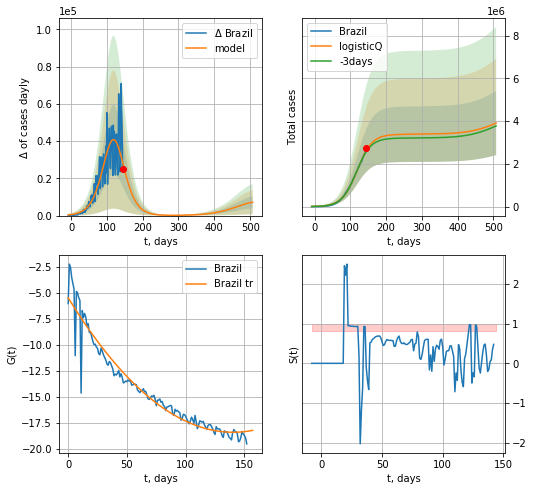

Brazil data at: 2020-08-02
+3 day model MAPE: 0.022415
model: logisticQ
coeffs: [ 3.38897060e+06  4.86487579e-07  1.19001938e+02 -9.89043635e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.383611
forecast at the end of period: +363 days
	 deltaDaycases: 7134
	 total cases: 3911925 ± 1500656
	 total death: 134701 ± 155018
trend coefficient of determination: 0.936881
 intercept_: -5.471275019918032
 coeffs_: [ 0.         -0.18427816  0.00065603]


In [4181]:
x = forecastRRR('Brazil',dfBZ[6:],d1,70*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4182]:
#x = forecastRRR('Brazil',dfBZ[5:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

AS
           date    cases  active  death
165 2020-07-29  16228.0    5490  189.0
166 2020-07-30  16905.0    6726  197.0
167 2020-07-31  17278.0    7094  201.0
168 2020-08-01  17895.0    7483  208.0
169 2020-08-02  18318.0    7475  221.0


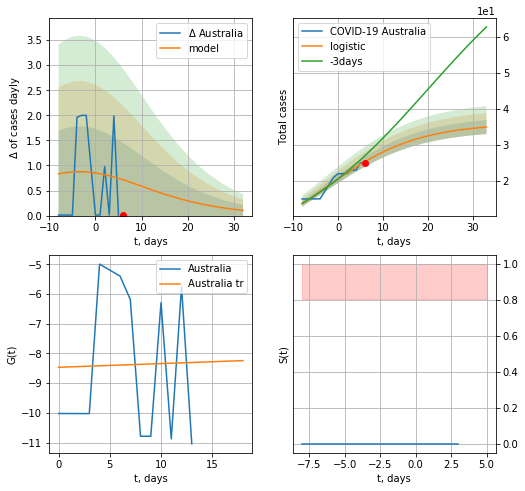

Australia data at: 2020-08-02
model: logistic
coeffs:  [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.05518162900834631
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  34 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.000431
 intercept: -8.467221
 slope: 0.012491


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


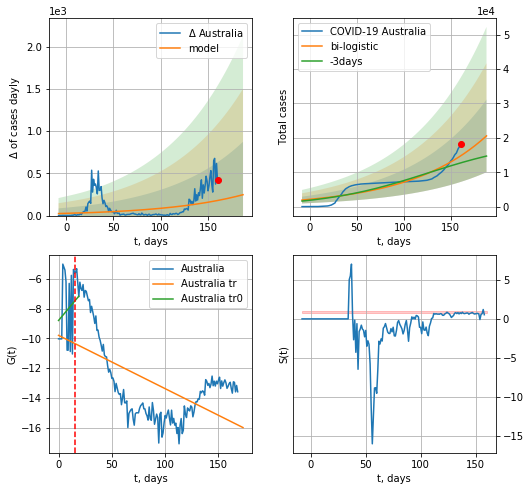

Australia data at: 2020-08-02
+3 day model MAPE: 0.1703642851281389
model: bi-logistic
coeffs:  [6.24198675e+06 1.21457037e-02 6.58446110e+02] [35.98148465  0.0972901  -2.93370788]
rational stdev:  0.5131451454296904
forecast at the end of period: +27 days
	 deltaDaycases:  247
	 total cases:  20565 ± 10553
	 total death:  248 ± 381
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.022779
 intercept: -8.785888
 slope: 0.086030
trend coefficient of determination: 0.324984
 intercept: -9.790613
 slope: -0.035865


In [4183]:
dfAS = read_df(pd.DataFrame(),"AS")
try:
    x = forecast('Australia',dfAS[:15],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('Australia',dfAS[:],d1,T18*7-dT,x,vL=15,addpred=False,xcoef=[0.25/4,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


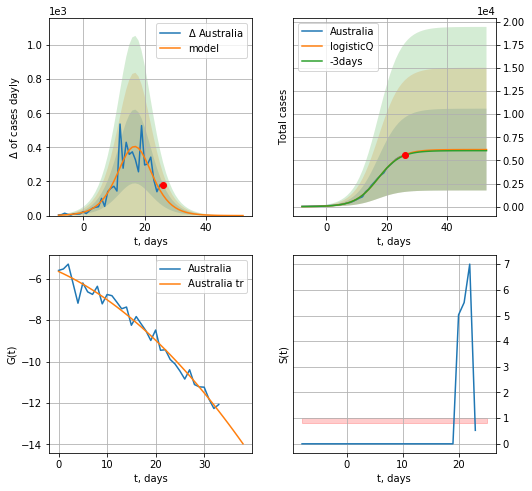

Australia data at: 2020-08-02
+3 day model MAPE: 0.012936
model: logisticQ
coeffs: [ 6.16826027e+03  4.63150668e-05  1.72354354e+01 -5.67232010e+03]
rational stdev: 0.716727
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 6167 ± 4420
	 total death: 74 ± 159
trend coefficient of determination: 0.975101
 intercept_: -5.657250296853678
 coeffs_: [ 0.         -0.10702975 -0.00294069]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


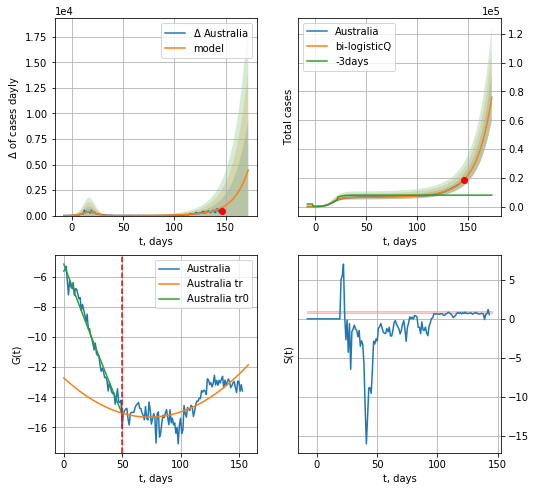

Australia data at: 2020-08-02
+3 day model MAPE: 1.447985
model: bi-logisticQ
coeffs: [ 8.27557936e+05  2.20640201e-04  2.03271522e+02 -1.83821876e+02]
rational stdev: 0.213900
forecast at the end of period: +27 days
	 deltaDaycases: 4461
	 total cases: 76062 ± 16269
	 total death: 917 ± 588
bi-logisticQ approximation splitting point: 50
trend coefficient of determination: 0.978786
 intercept_: -5.1508340728883
 coeffs_: [ 0.00000000e+00 -2.09278795e-01  2.06303704e-04]
trend coefficient of determination: 0.642587
 intercept_: -12.712837881262427
 coeffs_: [ 0.         -0.07102842  0.00048435]


In [4184]:
#axcoef = [koreaCoeffs[0],koreaCoeffs[1],koreaCoeffs[2],koreaCoeffs[3]]
vL = 50
x = forecastRRR('Australia',dfAS[15:vL],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
xx = forecast2RRR('Australia',dfAS[15:],d1,T18*7-dT,x,addpred=False,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


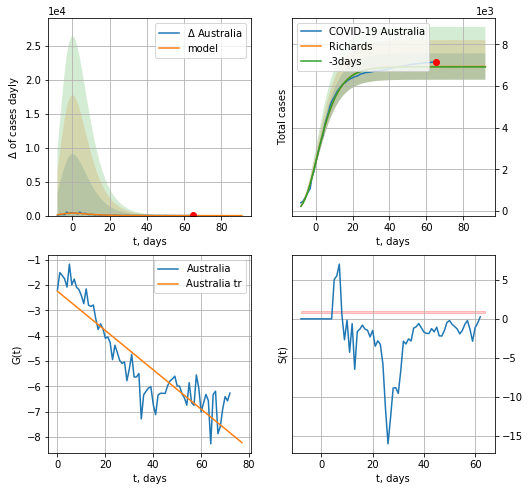

Australia data at: 2020-08-02
+3 day model MAPE: 0.002782
model: Richards
coeffs: [ 6.93376739e+03  1.41182137e+01 -3.14466269e+01  1.01384170e-02]
rational stdev: 0.091309
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 6933 ± 633
	 total death: 83 ± 22
trend coefficient of determination: 0.809708
 intercept: -2.241214
 slope: -0.077557


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


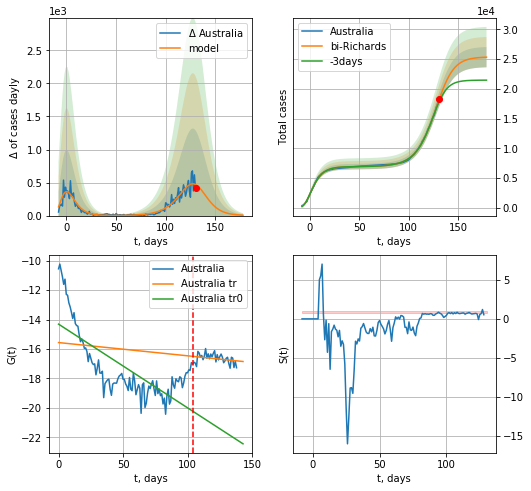

Australia data at: 2020-08-02
+3 day model MAPE: 0.027394
model: bi-Richards
coeffs: [1.84405982e+04 8.44812502e-02 1.30626830e+02 1.37591171e+00]
rational stdev: 0.066993
forecast at the end of period: +48 days
	 deltaDaycases: 5
	 total cases: 25326 ± 1696
	 total death: 305 ± 61
bi-Richards approximation splitting point: 104
trend coefficient of determination: 0.544148
 intercept: -14.310463
 slope: -0.056850
trend coefficient of determination: 0.074194
 intercept: -15.562374
 slope: -0.008993


In [4185]:
iL = 20+10
vL = 104+iL
x = forecastRR('Australia',dfAS[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Australia',dfAS[iL:],d1,25*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

ML
           date   cases  active  death
153 2020-07-29  8964.0     223  124.0
154 2020-07-30  8976.0     207  125.0
155 2020-07-31  8985.0     213  125.0
156 2020-08-01  8999.0     210  125.0
157 2020-08-02  8999.0     210  125.0
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


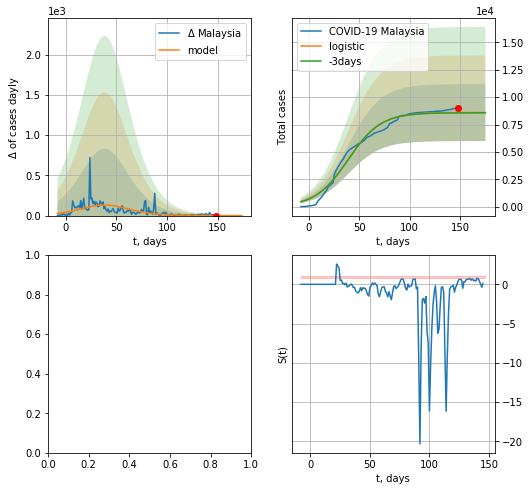

In [4187]:
try:
    dfML = read_df(pd.DataFrame(),"ML")
    x = forecast('Malaysia',dfML[1:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print ("Exception occurs")

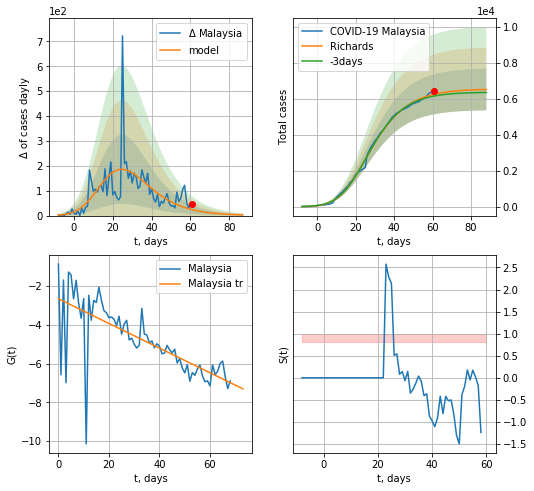

Malaysia data at: 2020-08-02
+3 day model MAPE: 0.016662
model: Richards
coeffs: [6.55737988e+03 3.88576721e-01 7.38244597e+00 2.20016068e-01]
rational stdev: 0.177893
forecast at the end of period: +27 days
	 deltaDaycases: 2
	 total cases: 6527 ± 1161
	 total death: 90 ± 48
trend coefficient of determination: 0.508700
 intercept: -2.652908
 slope: -0.063638


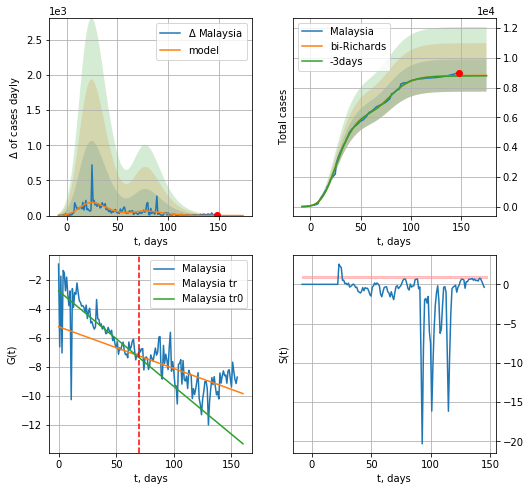

Malaysia data at: 2020-08-01
+3 day model MAPE: 0.003489
model: bi-Richards
coeffs: [2.26303708e+03 3.35128128e-01 6.22839766e+01 2.44825573e-01]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.123188
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 8823 ± 1086
	 total death: 122 ± 45
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.538230
 intercept: -2.750901
 slope: -0.065870
trend coefficient of determination: 0.343726
 intercept: -5.219911
 slope: -0.028803


In [4189]:
vL = 70
x = forecastRR('Malaysia',dfML[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Malaysia',dfML[:-1],d12f(2),T18*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


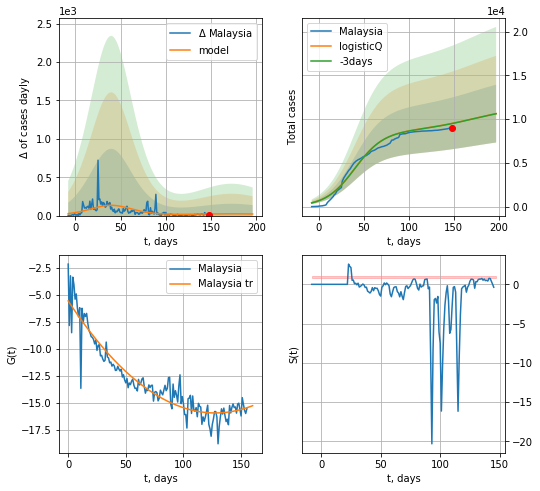

Malaysia data at: 2020-08-01
+3 day model MAPE: 0.002054
model: logisticQ
coeffs: [ 8.59150514e+03  1.01517505e-07  3.98769369e+01 -6.09420415e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.310732
forecast at the end of period: +49 days
	 deltaDaycases: 20
	 total cases: 10638 ± 3305
	 total death: 147 ± 137
trend coefficient of determination: 0.885584
 intercept_: -5.543978901569537
 coeffs_: [ 0.         -0.16334984  0.00064046]


In [3813]:
x = forecastRRR('Malaysia',dfML[:],d1,25*7-dT,addpred=True,xcoef=koreaCoeffs)

ZL
           date   cases  active  death
152 2020-07-29  1560.0      24   22.0
153 2020-07-30  1560.5      20   22.0
154 2020-07-31  1562.0      22   22.0
155 2020-08-01  1565.0      25   22.0
156 2020-08-02  1567.0      27   22.0


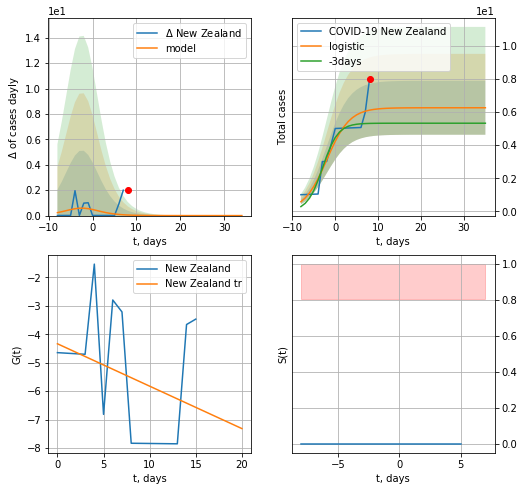

New Zealand data at: 2020-08-02
model: logistic
coeffs:  [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.26005250706023997
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  6 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.103357
 intercept: -4.332661
 slope: -0.149156


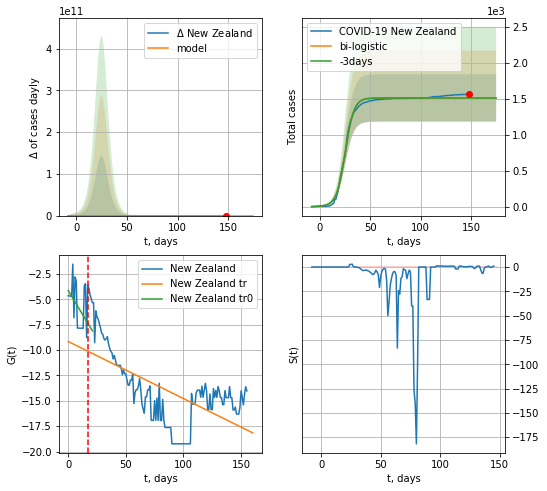

New Zealand data at: 2020-08-02
+3 day model MAPE: 0.0010212937348994867
model: bi-logistic
coeffs:  [1.50539891e+03 2.32550858e-01 2.53224294e+01] [ 6.26235964  0.37662733 -1.95315912]
rational stdev:  0.21747506424120525
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1511 ± 328
	 total death:  21 ± 13
bi-logistic approximation splitting point: 17
trend0 coefficient of determination: 0.175036
 intercept: -4.131936
 slope: -0.189301
trend coefficient of determination: 0.391761
 intercept: -9.154429
 slope: -0.056248


In [4190]:
vL=17
dfZL = read_df(pd.DataFrame(),"ZL")
try:
    x = forecast('New Zealand',dfZL[:vL],d1,T18*7-dT,pMAPE=False)
    xx = forecast2('New Zealand',dfZL[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)#
except:
    print ("Exception occurs")

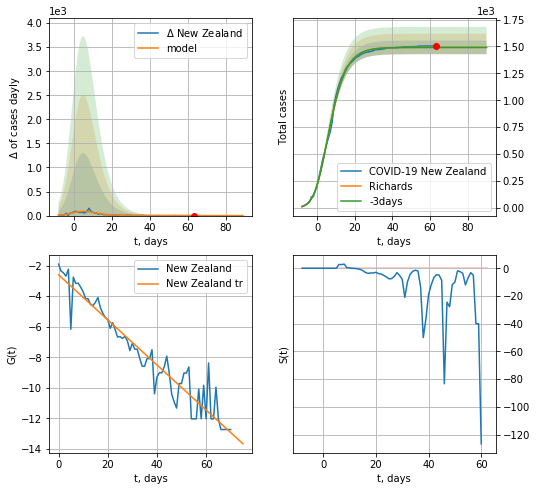

New Zealand data at: 2020-08-02
+3 day model MAPE: 0.000854
model: Richards
coeffs: [ 1.49158629e+03  5.64401145e-01 -5.41478074e-01  3.30453921e-01]
rational stdev: 0.042486
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1491 ± 63
	 total death: 20 ± 2
trend coefficient of determination: 0.916494
 intercept: -2.603094
 slope: -0.147473


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


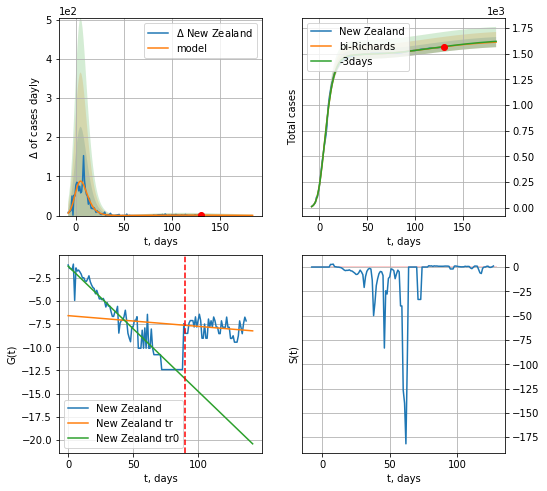

New Zealand data at: 2020-08-02
+3 day model MAPE: 0.000649
model: bi-Richards
coeffs: [1.43251430e+02 3.63697832e-01 1.52658454e-01 6.64650831e-02]
rational stdev: 0.030597
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 1612 ± 49
	 total death: 22 ± 2
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.916081
 intercept: -1.247919
 slope: -0.135011
trend coefficient of determination: 0.036438
 intercept: -6.584674
 slope: -0.011549


In [4191]:
vL = 90 + 18
x = forecastRR('New Zealand',dfZL[18:vL-18],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('New Zealand',dfZL[18:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-18)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


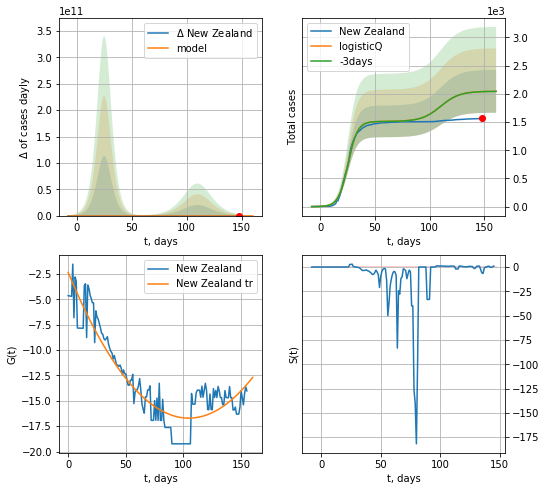

New Zealand data at: 2020-08-02
+3 day model MAPE: 0.000963
model: logisticQ
coeffs: [ 1.51183237e+03  1.50076482e-06  2.52746955e+01 -1.53473875e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.185977
forecast at the end of period: +13 days
	 deltaDaycases: 0
	 total cases: 2045 ± 380
	 total death: 28 ± 15
trend coefficient of determination: 0.843740
 intercept_: -2.349948074469623
 coeffs_: [ 0.         -0.27435555  0.00131067]


In [4192]:
x = forecastRRR('New Zealand',dfZL[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

BR
           date    cases  active  death
152 2020-07-29  67518.0    5528  548.0
153 2020-07-30  67665.0    5347  553.0
154 2020-07-31  67808.0    4805  559.0
155 2020-08-01  67946.0    4697  563.0
156 2020-08-02  68067.0    4604  567.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


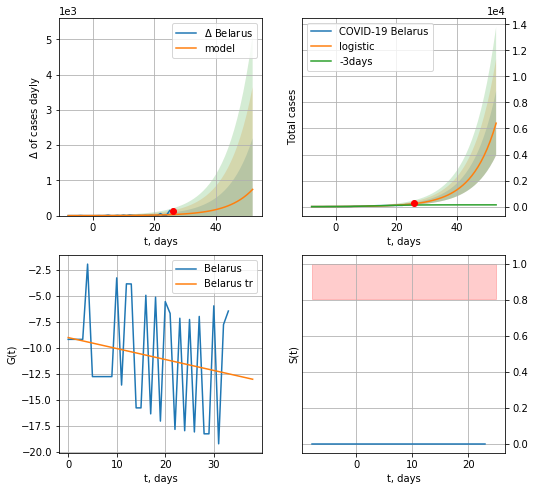

Belarus data at: 2020-08-02
+3 day model MAPE: 1.0426305188408567
model: logistic
coeffs:  [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  0.3845289039536378
forecast at the end of period: +27 days
	 deltaDaycases:  744
	 total cases:  6405 ± 2463
	 total death:  53 ± 61
trend coefficient of determination: 0.039182
 intercept: -9.040329
 slope: -0.105417


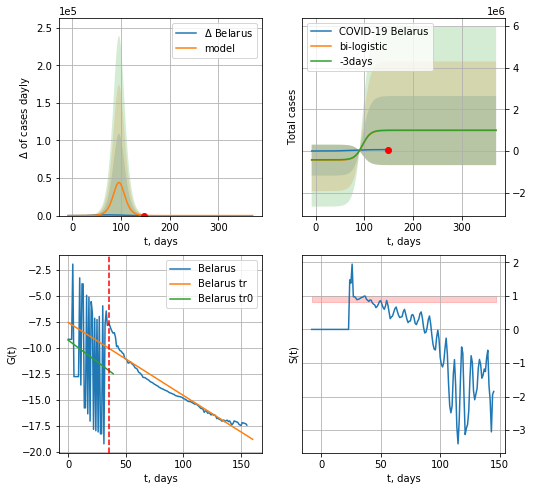

Belarus data at: 2020-08-02
+3 day model MAPE: 0.017795255397210615
model: bi-logistic
coeffs:  [-4.40006867e+05  1.91639889e+01 -4.37732164e+02] [1.42197385e+06 1.24002039e-01 9.65328876e+01]
rational stdev:  1.6886185850200055
forecast at the end of period: +223 days
	 deltaDaycases:  0
	 total cases:  981966 ± 1658167
	 total death:  8179 ± 41433
bi-logistic approximation splitting point: 35
trend0 coefficient of determination: 0.026128
 intercept: -9.289300
 slope: -0.082783
trend coefficient of determination: 0.933532
 intercept: -7.590908
 slope: -0.070210


In [4193]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:35],d1,7*T18-dT)
xx = forecast2('Belarus',dfBR[:],d1,50*7-dT,x,addpred=False,xcoef=[0.25,1.,1.8],vL=35)

BR
           date    cases  active  death
152 2020-07-29  67518.0    5528  548.0
153 2020-07-30  67665.0    5347  553.0
154 2020-07-31  67808.0    4805  559.0
155 2020-08-01  67946.0    4697  563.0
156 2020-08-02  68067.0    4604  567.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


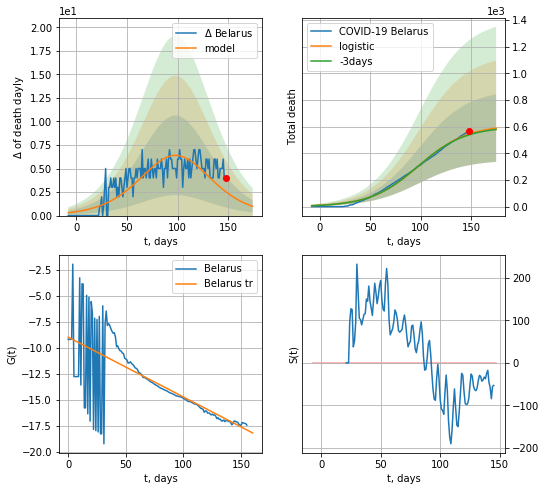

Belarus data at: 2020-08-02
+3 day model MAPE: 0.012257884883008798
model: logistic
coeffs:  [6.12723313e+02 4.17705304e-02 9.83098414e+01]
rational stdev:  0.42994584654405327
forecast at the end of period: +27 days
	 total death:  588 ± 253
trend coefficient of determination: 0.508500
 intercept: -9.000824
 slope: -0.057553


In [4194]:
dfBR = read_df(pd.DataFrame(),"BR")
x = forecast('Belarus',dfBR[:],d1,T18*7-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


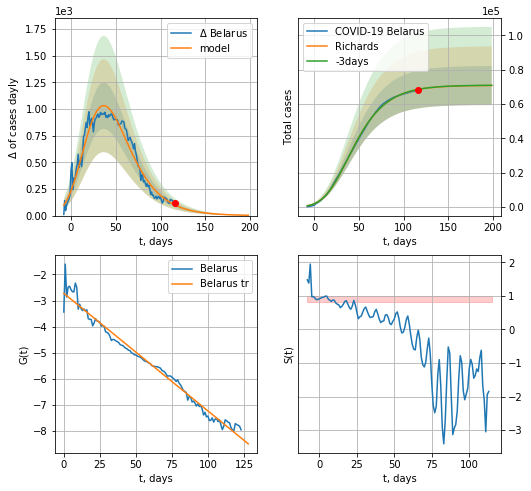

Belarus data at: 2020-08-02
+3 day model MAPE: 0.001008
model: Richards
coeffs: [ 7.07917965e+04  2.90652860e-01 -8.25068818e+00  1.46002250e-01]
rational stdev: 0.160943
forecast at the end of period: +83 days
	 deltaDaycases: 3
	 total cases: 70718 ± 11381
	 total death: 589 ± 284
trend coefficient of determination: 0.979913
 intercept: -2.723031
 slope: -0.045087


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


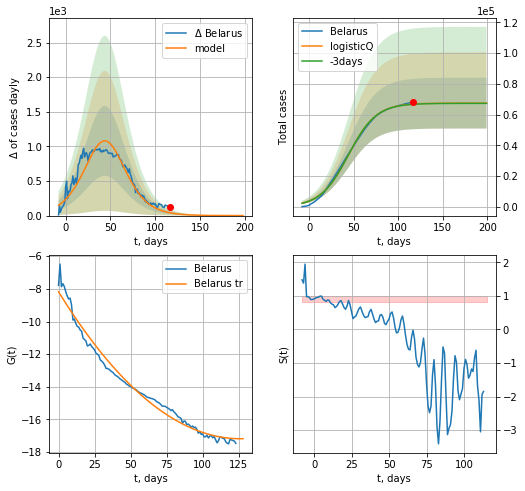

Belarus data at: 2020-08-02
+3 day model MAPE: 0.002347
model: logisticQ
coeffs: [ 6.74819707e+04  3.63304784e-07  4.40627409e+01 -1.76245627e+05]
rational stdev: 0.244752
forecast at the end of period: +83 days
	 deltaDaycases: 0
	 total cases: 67478 ± 16515
	 total death: 562 ± 412
trend coefficient of determination: 0.980179
 intercept_: -8.183947086460169
 coeffs_: [ 0.         -0.14269367  0.00056585]


In [4195]:
x = forecastRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecastRRR('Belarus',dfBR[32:],d1,30*7-dT,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


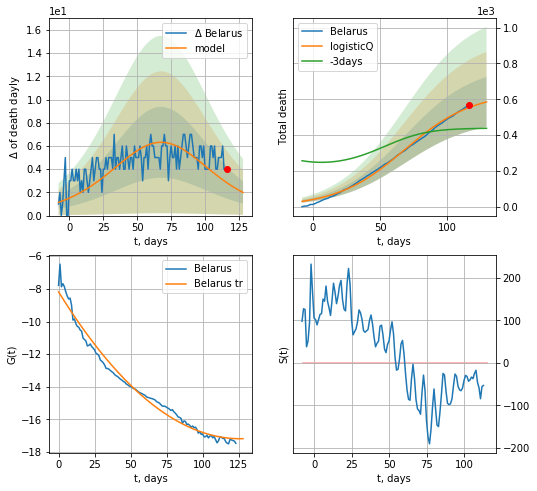

Belarus data at: 2020-08-02
+3 day model MAPE: 0.276111
model: logisticQ
coeffs: [ 6.25444933e+02  5.46378628e-06  6.75949021e+01 -7.27030948e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.238681
forecast at the end of period: +13 days
	 total death: 585 ± 139
trend coefficient of determination: 0.980179
 intercept_: -8.183947086460169
 coeffs_: [ 0.         -0.14269367  0.00056585]


In [4196]:
x = forecastRRR('Belarus',dfBR[32:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')

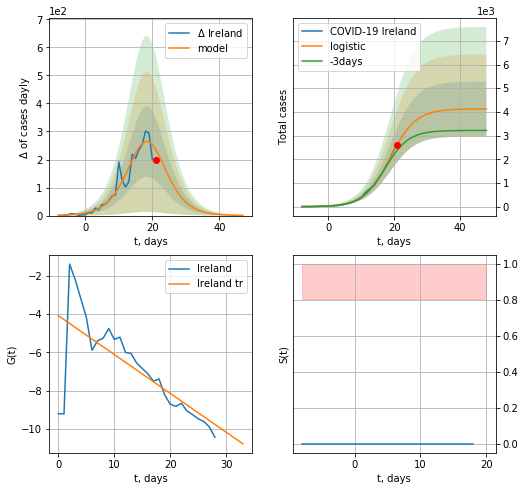

Ireland data at: 2020-08-02
+3 day model MAPE: 0.12282208937722881
model: logistic
coeffs:  [4.12730398e+03 2.56984382e-01 1.88154165e+01]
rational stdev:  0.27980533262906077
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  4125 ± 1154
	 total death:  277 ± 232
trend coefficient of determination: 0.521820
 intercept: -4.083344
 slope: -0.202899


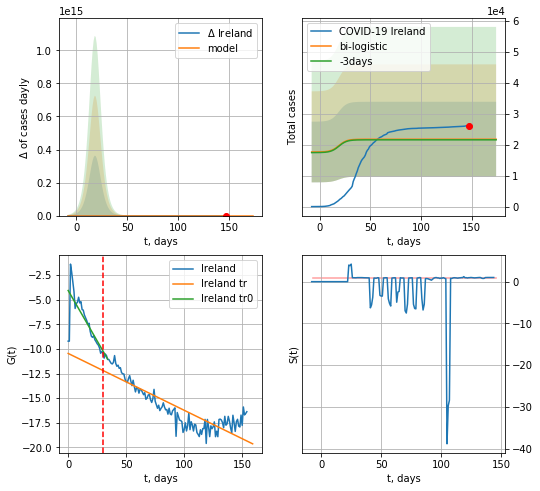

Ireland data at: 2020-08-02
+3 day model MAPE: 0.008988200940446636
model: bi-logistic
coeffs:  [ 1.40854098e+04 -1.12136724e+01  2.81202137e+02] [4.12730398e+03 2.56984382e-01 1.88154165e+01]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.5556510575702522
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  21734 ± 12076
	 total death:  1464 ± 2440
bi-logistic approximation splitting point: 30
trend0 coefficient of determination: 0.551550
 intercept: -4.065434
 slope: -0.204818
trend coefficient of determination: 0.750703
 intercept: -10.457143
 slope: -0.057708


In [4197]:
vL=30
x = forecast('Ireland',dfIR[:vL],d1,T18*7-dT)
xx = forecast2('Ireland',dfIR[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


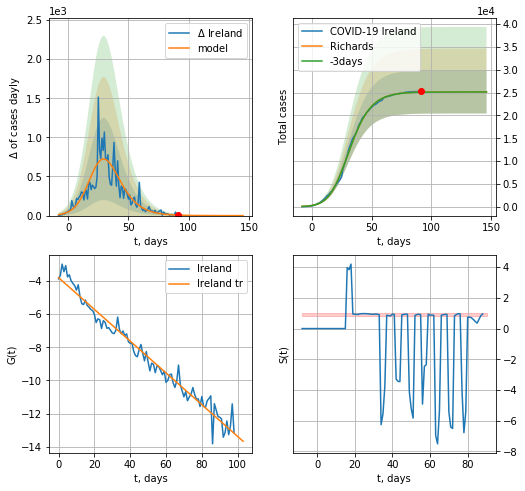

Ireland data at: 2020-08-02
+3 day model MAPE: 0.001256
model: Richards
coeffs: [2.51692626e+04 1.93826337e-01 2.27522014e+01 5.01021340e-01]
rational stdev: 0.188437
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 25168 ± 4742
	 total death: 1696 ± 958
trend coefficient of determination: 0.969247
 intercept: -3.803769
 slope: -0.095697


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


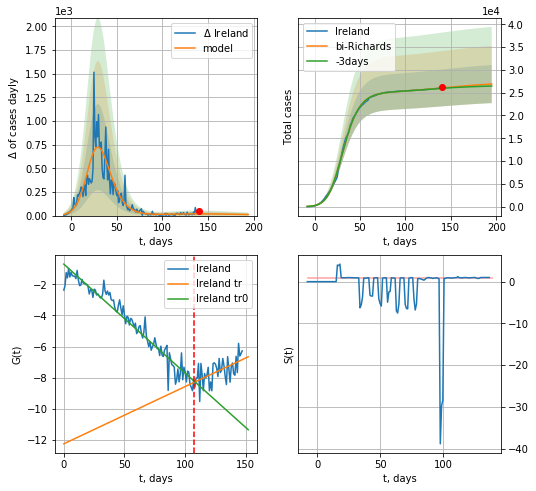

Ireland data at: 2020-08-02
+3 day model MAPE: 0.002994
model: bi-Richards
coeffs: [ 2.32453294e+03  3.23238718e+00 -9.04613558e+01  6.73236919e-03]
rational stdev: 0.155306
forecast at the end of period: +55 days
	 deltaDaycases: 11
	 total cases: 26895 ± 4177
	 total death: 1812 ± 844
bi-Richards approximation splitting point: 107
trend coefficient of determination: 0.944439
 intercept: -0.707172
 slope: -0.069904
trend coefficient of determination: 0.313478
 intercept: -12.233288
 slope: 0.036722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


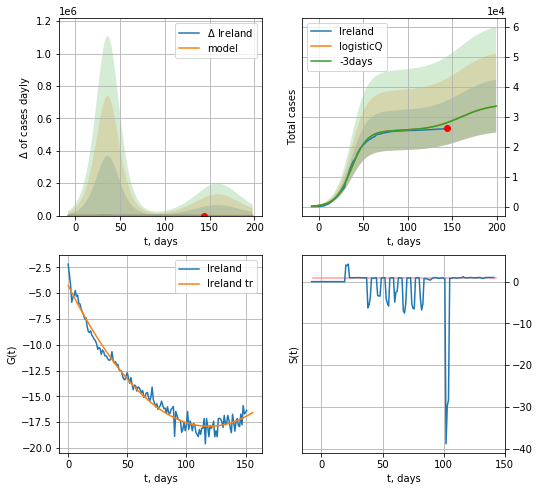

Ireland data at: 2020-08-02
+3 day model MAPE: 0.000833
model: logisticQ
coeffs: [ 2.53644737e+04  5.84303570e-07  3.65299500e+01 -1.94280007e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.262778
forecast at the end of period: +55 days
	 deltaDaycases: 44
	 total cases: 33508 ± 8805
	 total death: 2258 ± 1780
trend coefficient of determination: 0.977512
 intercept_: -4.26640080909306
 coeffs_: [ 0.         -0.22923309  0.00096381]


In [4198]:
ivL = 7
vL = 100 + ivL+ivL
x = forecastRR('Ireland',dfIR[ivL:vL-ivL],d1,26*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Ireland',dfIR[ivL:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-ivL)
x = forecastRRR('Ireland',dfIR[3:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CL
           date   cases  active   death
148 2020-07-29  351575   17740  9278.0
149 2020-07-30  353536   17531  9377.0
150 2020-07-31  355667   17883  9457.0
151 2020-08-01  357658   17618  9533.0
152 2020-08-02  359731   17712  9608.0


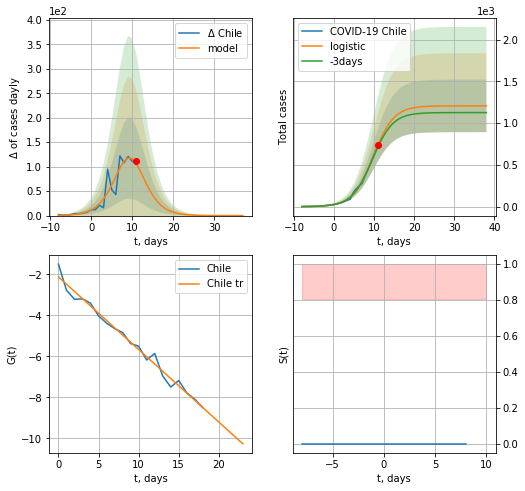

Chile data at: 2020-08-02
+3 day model MAPE: 0.03908993891192624
model: logistic
coeffs:  [1.20759839e+03 3.93191843e-01 9.80781865e+00]
rational stdev:  0.2610672451056305
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1207 ± 315
	 total death:  32 ± 25
trend coefficient of determination: 0.982168
 intercept: -2.127319
 slope: -0.354074


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


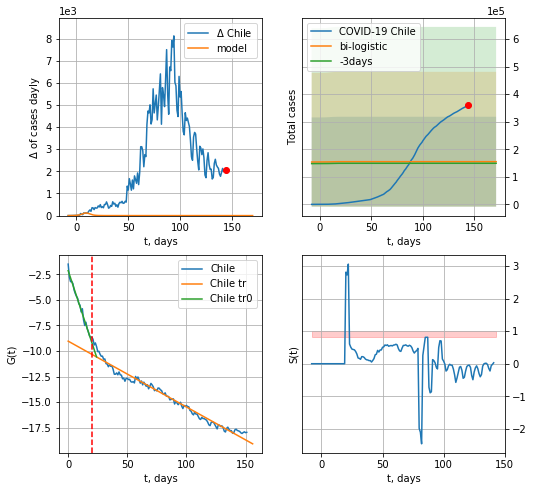

Chile data at: 2020-08-02
+3 day model MAPE: 0.03914626453067726
model: bi-logistic
coeffs:  [ 1.22992348e+05 -2.60145940e+01  6.29187288e+02] [1.20759839e+03 3.93191843e-01 9.80781865e+00]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  1.0528005932998372
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  154948 ± 163129
	 total death:  4138 ± 13069
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.984051
 intercept: -2.144368
 slope: -0.351232
trend coefficient of determination: 0.971275
 intercept: -9.034869
 slope: -0.064326


In [4199]:
vL=20
dfCL = read_df(pd.DataFrame(),"CL")
x = forecast('Chile',dfCL[:vL],d1,7*T18-dT)
xx = forecast2('Chile',dfCL[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


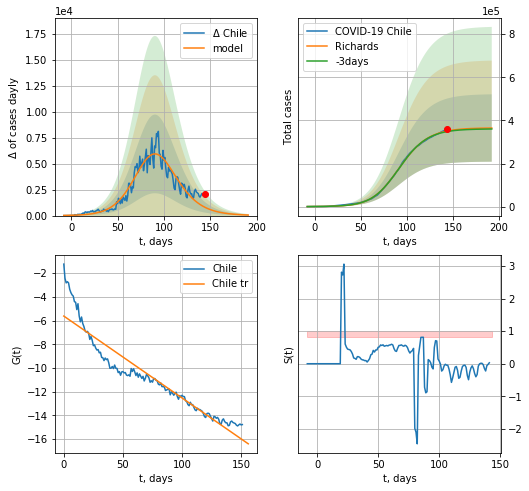

Chile data at: 2020-08-02
+3 day model MAPE: 0.007937
model: Richards
coeffs: [3.65513819e+05 7.99090514e-02 8.60388190e+01 7.52251415e-01]
rational stdev: 0.428813
forecast at the end of period: +48 days
	 deltaDaycases: 51
	 total cases: 364683 ± 156380
	 total death: 9740 ± 12529
trend coefficient of determination: 0.893818
 intercept: -5.618685
 slope: -0.069139


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


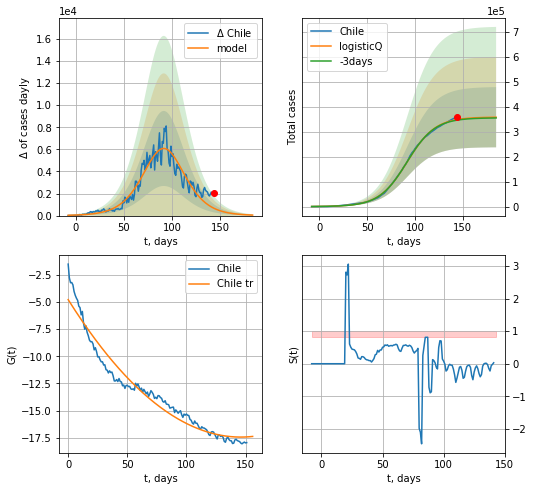

Chile data at: 2020-08-02
+3 day model MAPE: 0.006771
model: logisticQ
coeffs: [ 3.58676353e+05  1.09692073e-06  9.19605043e+01 -6.17495061e+04]
rational stdev: 0.336768
forecast at the end of period: +41 days
	 deltaDaycases: 45
	 total cases: 358032 ± 120574
	 total death: 9562 ± 9660
trend coefficient of determination: 0.952214
 intercept_: -4.775856551875911
 coeffs_: [ 0.         -0.17350132  0.00059429]


In [4200]:
vL = 20+20
x = forecastRR('Chile',dfCL[:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Chile',dfCL[10:],d1,40*7-dT,x,addpred=True,xcoef=RkoreaCoeffs,vL=vL-10)
x = forecastRRR('Chile',dfCL[:],d1,24*7-dT,addpred=False,xcoef=koreaCoeffs)

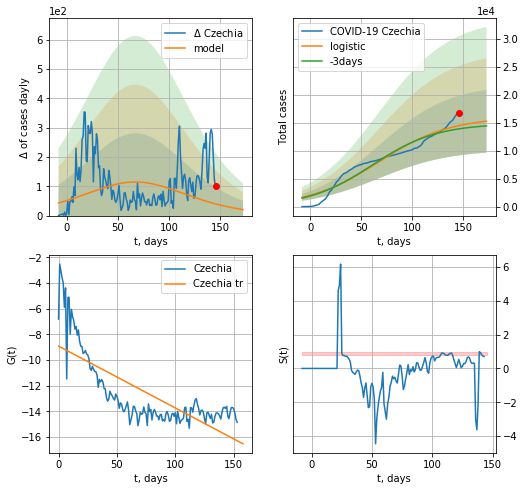

Czechia data at: 2020-08-02
+3 day model MAPE: 0.042698503276861796
model: logistic
coeffs:  [1.60234707e+04 2.86282296e-02 6.74568830e+01]
rational stdev:  0.36802862609063586
forecast at the end of period: +27 days
	 deltaDaycases:  20
	 total cases:  15278 ± 5623
	 total death:  349 ± 385
trend coefficient of determination: 0.568155
 intercept: -8.912001
 slope: -0.048135


In [4201]:
x = forecast('Czechia',dfCH[:],d1,T18*7-dT,shift=1.,addpred=False,xcoef=[0.25,1.,2.4])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


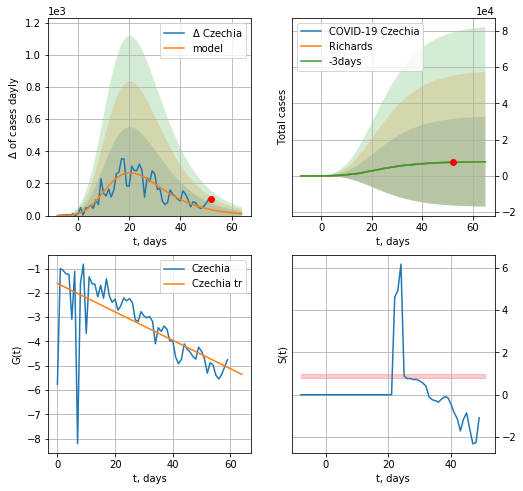

Czechia data at: 2020-08-02
+3 day model MAPE: 0.007833
model: Richards
coeffs: [ 7.98936803e+03  1.90705450e+00 -1.17115779e+01  4.87276061e-02]
rational stdev: 3.153640
forecast at the end of period: +13 days
	 deltaDaycases: 12
	 total cases: 7859 ± 24784
	 total death: 179 ± 1693
trend coefficient of determination: 0.449013
 intercept: -1.614151
 slope: -0.058413


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


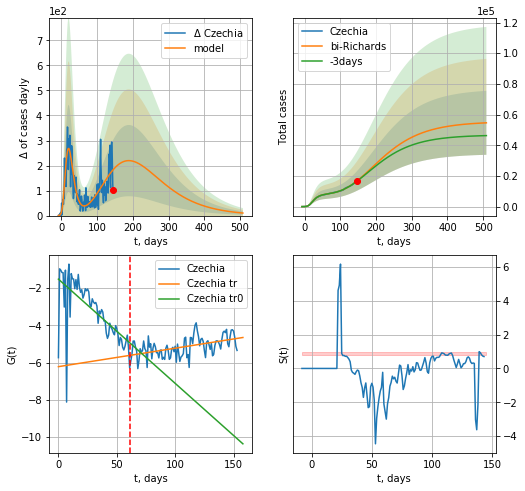

Czechia data at: 2020-08-02
+3 day model MAPE: 0.009169
model: bi-Richards
coeffs: [ 4.74281353e+04  5.37389312e-01 -1.04631083e+02  2.37011100e-02]
rational stdev: 0.381555
forecast at the end of period: +363 days
	 deltaDaycases: 10
	 total cases: 54617 ± 20839
	 total death: 1248 ± 1428
bi-Richards approximation splitting point: 61
trend coefficient of determination: 0.436011
 intercept: -1.512889
 slope: -0.056019
trend coefficient of determination: 0.249692
 intercept: -6.217052
 slope: 0.009919


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


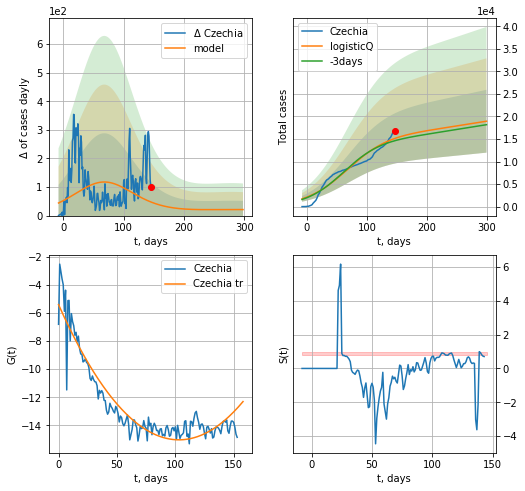

Czechia data at: 2020-08-02
+3 day model MAPE: 0.034525
model: logisticQ
coeffs: [ 1.60217982e+04  5.12480768e-08  6.74505990e+01 -5.58478389e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.368017
forecast at the end of period: +153 days
	 deltaDaycases: 21
	 total cases: 18940 ± 6970
	 total death: 432 ± 476
trend coefficient of determination: 0.884560
 intercept_: -5.410476602693073
 coeffs_: [ 0.         -0.18635394  0.0009034 ]


In [4202]:
vL= 61
x = forecastRR('Czechia',dfCH[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Czechia',dfCH[:],d1,70*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Czechia',dfCH[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

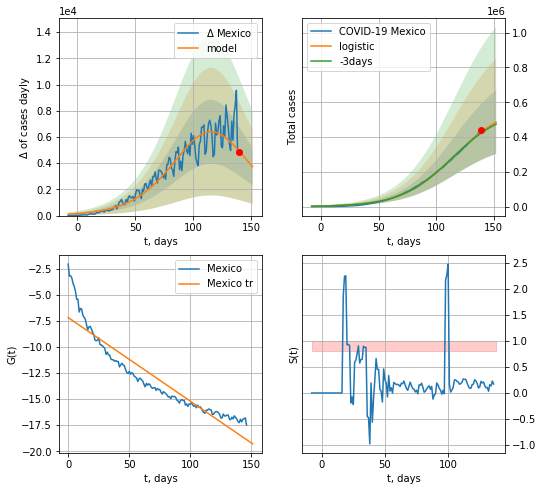

Mexico data at: 2020-08-02
+3 day model MAPE: 0.015918740491265276
model: logistic
coeffs:  [5.75506195e+05 4.42978970e-02 1.15273854e+02]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.37628193603355276
forecast at the end of period: +13 days
	 deltaDaycases:  3733
	 total cases:  485277 ± 182601
	 total death:  52773 ± 59572
trend coefficient of determination: 0.873130
 intercept: -7.195326
 slope: -0.080050


In [4203]:
x = forecast('Mexico',dfMX[:],d1,20*7-dT,addpred=True,xcoef=[.25,1.,2.])#

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


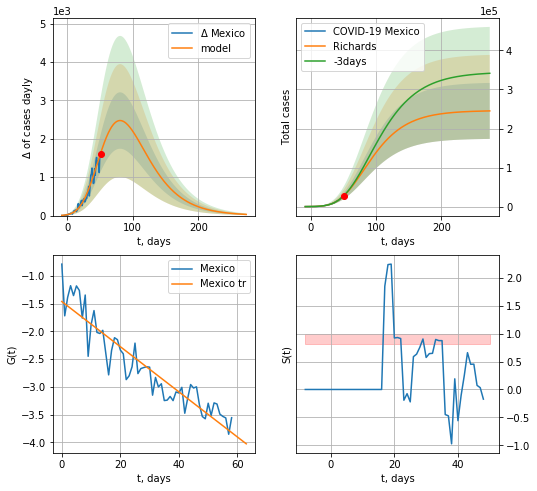

Mexico data at: 2020-08-02
+3 day model MAPE: 0.013781
model: Richards
coeffs: [ 2.46197399e+05  4.05650878e-01 -1.28761086e+01  6.97244909e-02]
rational stdev: 0.292607
forecast at the end of period: +223 days
	 deltaDaycases: 30
	 total cases: 245142 ± 71730
	 total death: 26659 ± 23401
trend coefficient of determination: 0.864363
 intercept: -1.463809
 slope: -0.040682


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


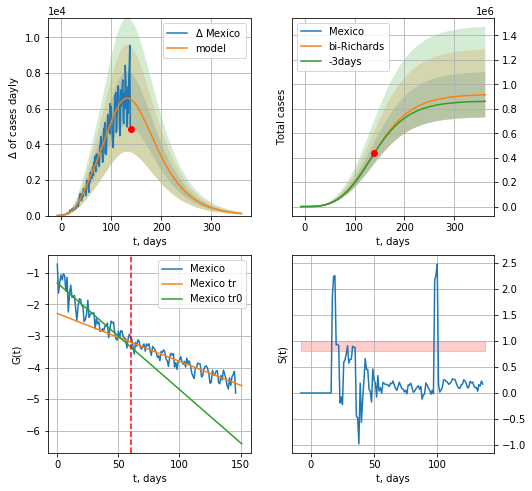

Mexico data at: 2020-08-02
+3 day model MAPE: 0.005870
model: bi-Richards
coeffs: [ 6.73687845e+05  9.54668914e-01 -2.72036308e+01  2.32680878e-02]
rational stdev: 0.202396
forecast at the end of period: +223 days
	 deltaDaycases: 116
	 total cases: 914723 ± 185136
	 total death: 99475 ± 60400
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.832528
 intercept: -1.322575
 slope: -0.033705
trend coefficient of determination: 0.844945
 intercept: -2.287837
 slope: -0.015136


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


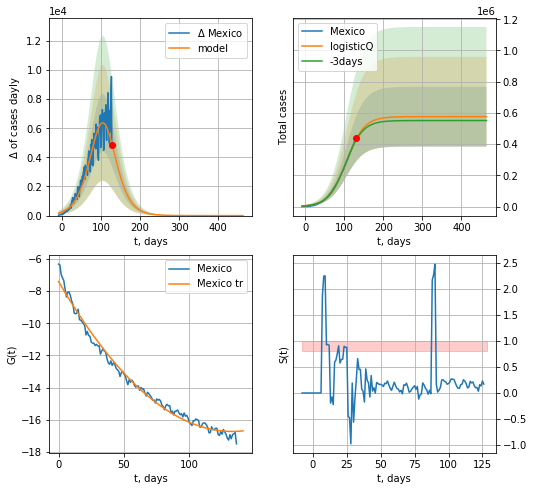

Mexico data at: 2020-08-02
+3 day model MAPE: 0.016240
model: logisticQ
coeffs: [ 5.76132412e+05  5.67732309e-07  1.05333291e+02 -7.78295777e+04]
rational stdev: 0.332482
forecast at the end of period: +335 days
	 deltaDaycases: 0
	 total cases: 576132 ± 191553
	 total death: 62654 ± 62494
trend coefficient of determination: 0.987853
 intercept_: -7.404299166821547
 coeffs_: [ 0.         -0.1404334   0.00052878]


In [4204]:
vL = 60
x = forecastRR('Mexico',dfMX[:vL],d1,50*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Mexico',dfMX[:],d1,50*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
x = forecastRRR('Mexico',dfMX[10:],d1,66*7-dT,addpred=False,xcoef=koreaCoeffs)#

LT
           date   cases  active  death     tests
142 2020-07-29  2062.0     339   80.0  515662.0
143 2020-07-30  2075.0     351   80.0  519929.0
144 2020-07-31  2093.0     369   80.0  524483.0
145 2020-08-01  2110.0     386   80.0       NaN
146 2020-08-02  2120.0     395   80.0       NaN


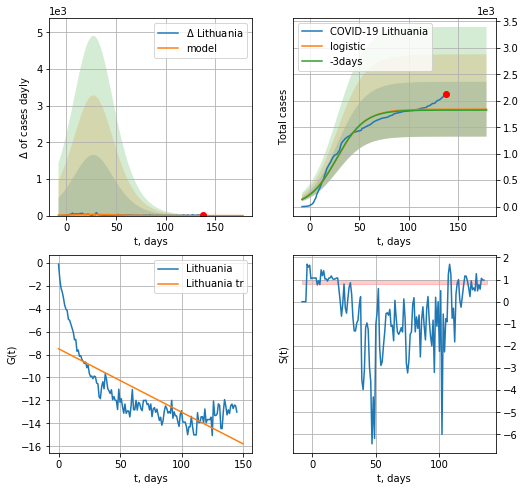

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.009521332048028828
model: logistic
coeffs:  [1.84168648e+03 6.98626080e-02 2.76047260e+01]
rational stdev:  0.28151840793803157
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  1841 ± 518
	 total death:  69 ± 58
trend coefficient of determination: 0.599135
 intercept: -7.493250
 slope: -0.055301


In [4205]:
vL = 1
dfLT = read_df(pd.DataFrame(),"LT")
try:
    x = forecast('Lithuania',dfLT[:],d1,6*7-1)
except:
    print("Exception occurs")
#xx = forecast2('Lithuania',dfLT[:],d1,8*7-1,x,shift=1.0,addpred=True,xcoef=[.25,1.,2.],vL=vL)

In [4206]:
#dfLT = read_df(pd.DataFrame(),"LT")
#plt.plot(range(len(dfLT[3:])),dfLT[3:].cases/dfLT[3:].tests)

#plt.grid()#

In [4207]:
#np.diff(dfLT["cases"])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: invalid value encountered in true_divide


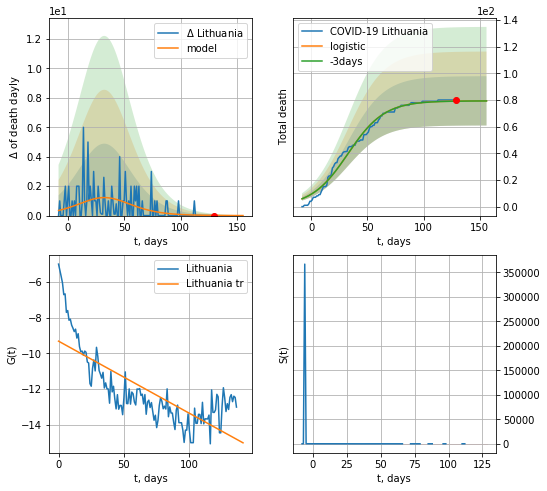

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.0008514442365217161
model: logistic
coeffs:  [7.94000222e+01 6.17575869e-02 3.28409859e+01]
rational stdev:  0.23310536200646573
forecast at the end of period: +27 days
	 total death:  79 ± 18
trend coefficient of determination: 0.587405
 intercept: -9.320840
 slope: -0.040397


In [4208]:
x = forecast('Lithuania',dfLT[9:],d1,7*T18-dT,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


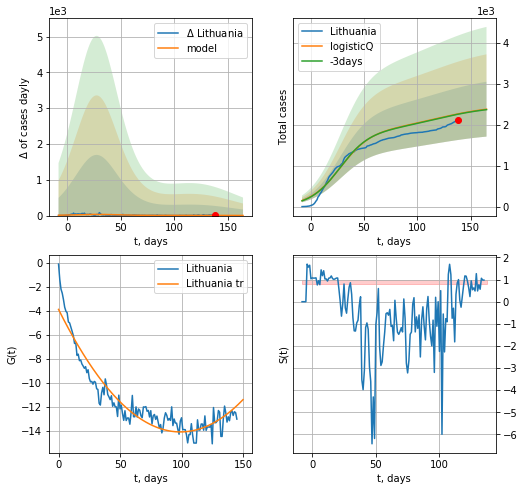

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.003352
model: logisticQ
coeffs: [ 1.84169852e+03  8.35968477e-08  2.76063124e+01 -8.35375797e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.281539
forecast at the end of period: +27 days
	 deltaDaycases: 3
	 total cases: 2381 ± 670
	 total death: 89 ± 75
trend coefficient of determination: 0.899489
 intercept_: -3.8786312771979228
 coeffs_: [ 0.         -0.20591216  0.0010387 ]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: invalid value encountered in true_divide


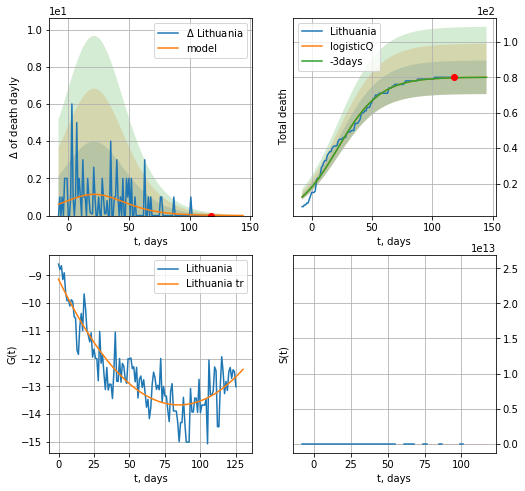

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.000281
model: logisticQ
coeffs: [ 8.00972377e+01  3.25668911e-07  2.17441469e+01 -1.75195298e+05]
rational stdev: 0.118483
forecast at the end of period: +27 days
	 total death: 80 ± 9
trend coefficient of determination: 0.789236
 intercept_: -9.136170834365268
 coeffs_: [ 0.         -0.10689637  0.00063003]


In [4209]:
#x = forecast('Lithuania',dfLT[10-4:],d1,6*7-1,cases='active')
x = forecastRRR('Lithuania',dfLT[:],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
x = forecastRRR('Lithuania',dfLT[20:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs,cases='death')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


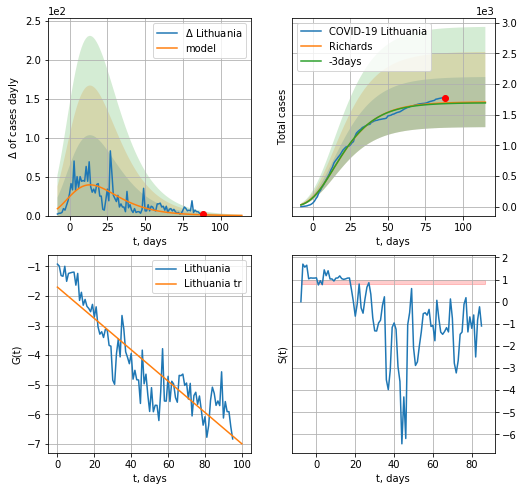

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.007252
model: Richards
coeffs: [ 1.70755770e+03  1.22304282e+01 -6.97018177e+01  5.14662736e-03]
rational stdev: 0.239484
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1704 ± 408
	 total death: 64 ± 45
trend coefficient of determination: 0.808202
 intercept: -1.701381
 slope: -0.052934


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


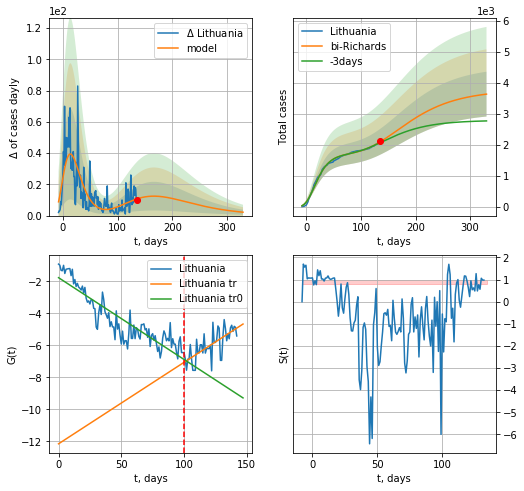

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.014210
model: bi-Richards
coeffs: [ 2.05957617e+03  2.22174733e+00 -1.30667933e+02  7.42029691e-03]
rational stdev: 0.199032
forecast at the end of period: +195 days
	 deltaDaycases: 2
	 total cases: 3632 ± 722
	 total death: 137 ± 81
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.806212
 intercept: -1.775122
 slope: -0.051065
trend coefficient of determination: 0.488228
 intercept: -12.147933
 slope: 0.050872


In [4211]:
iL = 3
vL =100+iL
x = forecastRR('Lithuania',dfLT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)#
xx = forecast2RR('Lithuania',dfLT[iL:],d1,46*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)#
#xx = forecast2R('Lithuania',dfLT[:],d1,2*7-1,x,shift=1.0,addpred=True,xcoef=[0.25,1.,1.5])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


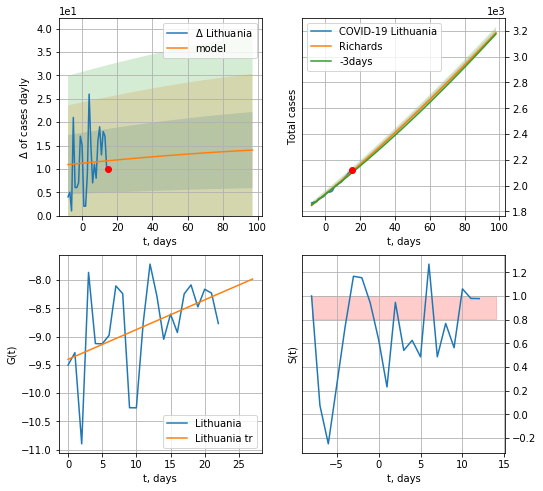

Lithuania data at: 2020-08-02
+3 day model MAPE: 0.004902
model: Richards
coeffs: [9.59858386e+03 1.13394899e-02 8.10517399e+00 4.45603800e-01]
rational stdev: 0.004834
forecast at the end of period: +83 days
	 deltaDaycases: 14
	 total cases: 3184 ± 15
	 total death: 120 ± 1
trend coefficient of determination: 0.193097
 intercept: -9.402245
 slope: 0.052547


In [4213]:
x = forecastRR('Lithuania',dfLT[123:],d1,30*7-dT,addpred=False)#

In [4214]:
#x = forecastQR('Lithuania',dfLT[:],d1,16*7-dT,addpred=False,xcoef=[0.35,.52,4.,1.,1.])

LX
           date   cases  active  death
144 2020-07-29  6533.0    1460  114.0
145 2020-07-30  6616.0    1475  114.0
146 2020-07-31  6695.0    1389  114.0
147 2020-08-01  6793.0    1485  116.0
148 2020-08-02  6855.0    1546  117.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


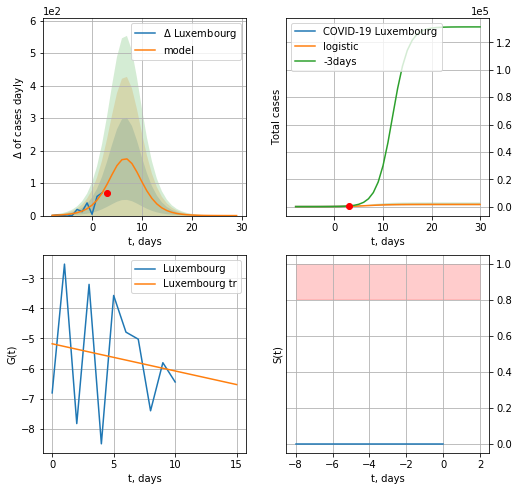

Luxembourg data at: 2020-08-02
model: logistic
coeffs:  [1.56298312e+03 4.51684200e-01 7.13428385e+00]
rational stdev:  0.3215238047871676
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1562 ± 502
	 total death:  26 ± 25
trend coefficient of determination: 0.022967
 intercept: -5.176630
 slope: -0.090347


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


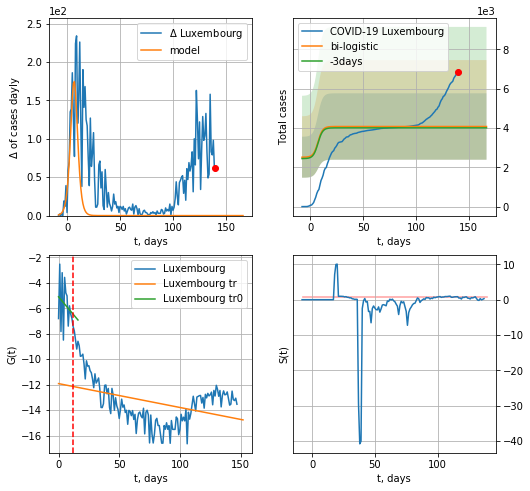

Luxembourg data at: 2020-08-02
+3 day model MAPE: 0.017220091074817295
model: bi-logistic
coeffs:  [2233.40675558   -9.07420475  302.68510352] [1.56298312e+03 4.51684200e-01 7.13428385e+00]
scenario coeffs:  [0.125, 1.0, 2.0]
rational stdev:  0.41408407157405475
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  4075 ± 1687
	 total death:  69 ± 85
bi-logistic approximation splitting point: 12
trend0 coefficient of determination: 0.045986
 intercept: -5.098250
 slope: -0.113861
trend coefficient of determination: 0.158251
 intercept: -11.917886
 slope: -0.018751


In [4215]:
dfLX = read_df(pd.DataFrame(),"LX")
x = forecast("Luxembourg",dfLX[:12],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Luxembourg",dfLX[:],d1,T18*7-dT,x,vL=12,addpred=True,xcoef=[0.25/2,1.,2.])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


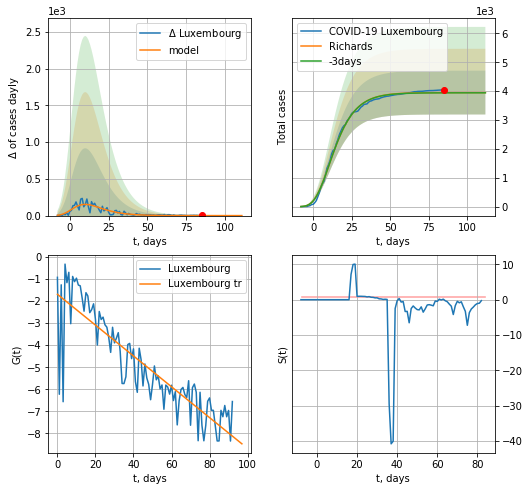

Luxembourg data at: 2020-08-02
+3 day model MAPE: 0.002043
model: Richards
coeffs: [ 3.94969099e+03  2.24968811e+01 -4.06525331e+01  4.67252012e-03]
rational stdev: 0.191849
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 3949 ± 757
	 total death: 67 ± 38
trend coefficient of determination: 0.761221
 intercept: -1.696203
 slope: -0.069808


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


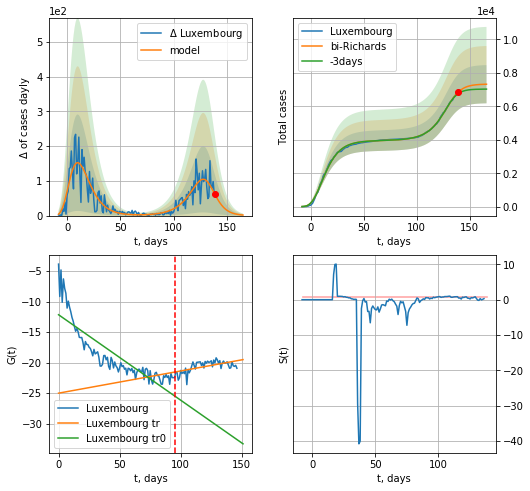

Luxembourg data at: 2020-08-02
+3 day model MAPE: 0.014776
model: bi-Richards
coeffs: [3.38360015e+03 8.43798457e-02 1.32080843e+02 1.83597484e+00]
rational stdev: 0.156024
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 7323 ± 1142
	 total death: 124 ± 58
bi-Richards approximation splitting point: 95
trend coefficient of determination: 0.738797
 intercept: -12.162713
 slope: -0.139939
trend coefficient of determination: 0.350955
 intercept: -25.001735
 slope: 0.036363


In [4216]:
iL=1
vL = 105+iL-10
x = forecastRR("Luxembourg",dfLX[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Luxembourg",dfLX[iL:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


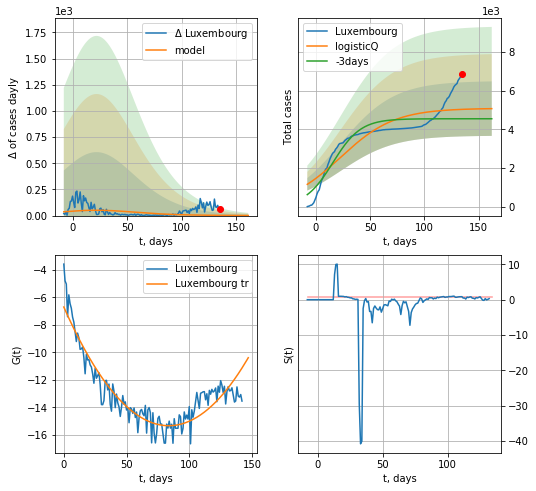

Luxembourg data at: 2020-08-02
+3 day model MAPE: 0.107432
model: logisticQ
coeffs: [ 5.09267835e+03  2.59736083e-08  2.24564024e+01 -1.54457335e+06]
rational stdev: 0.277718
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 5073 ± 1409
	 total death: 86 ± 71
trend coefficient of determination: 0.852069
 intercept_: -6.694121144583015
 coeffs_: [ 0.         -0.20644577  0.00123367]


In [4217]:
x = forecastRRR("Luxembourg",dfLX[5:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)

ED
           date    cases   active   death
151 2020-07-29  83193.0  41998.0  5623.0
152 2020-07-30  84370.0  42889.0  5657.0
153 2020-07-31  85355.0  43609.0  5702.0
154 2020-08-01  86232.0  44283.0  5736.0
155 2020-08-02  86524.0  44561.0  5750.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


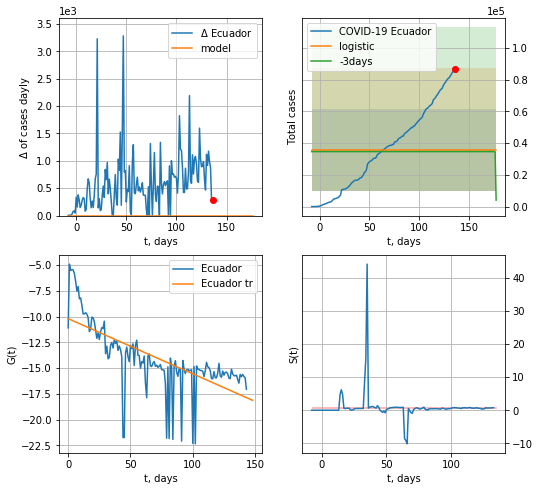

Ecuador data at: 2020-08-02
+3 day model MAPE: 0.03070560436920252
model: logistic
coeffs:  [ 3.56985108e+04 -6.66892844e+00  1.81610125e+02]
rational stdev:  0.722846709550009
forecast at the end of period: +41 days
	 deltaDaycases:  0
	 total cases:  35698 ± 25804
	 total death:  2372 ± 5143
trend coefficient of determination: 0.470058
 intercept: -10.197111
 slope: -0.053627


In [4218]:
dfED = read_df(pd.DataFrame(),"ED")
x = forecast("Ecuador",dfED[11:],d1,24*7-dT)
#xx = forecast2(c,adf[:],d1,4*7-dT,x)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


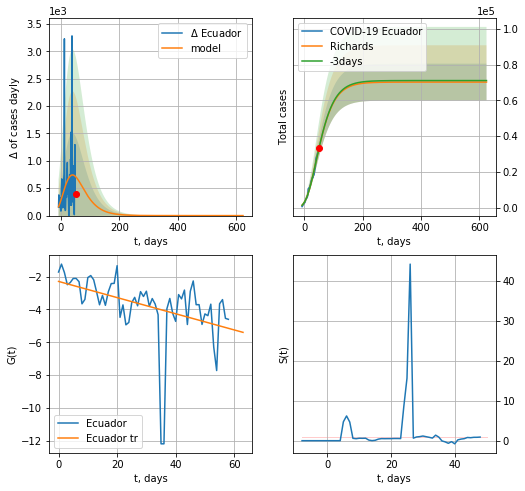

Ecuador data at: 2020-08-02
+3 day model MAPE: 0.001508
model: Richards
coeffs: [ 7.02508577e+04  1.76844856e+00 -1.01710647e+02  1.63770361e-02]
rational stdev: 0.146403
forecast at the end of period: +573 days
	 deltaDaycases: 0
	 total cases: 70250 ± 10284
	 total death: 4668 ± 2050
trend coefficient of determination: 0.183686
 intercept: -2.292555
 slope: -0.049246


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


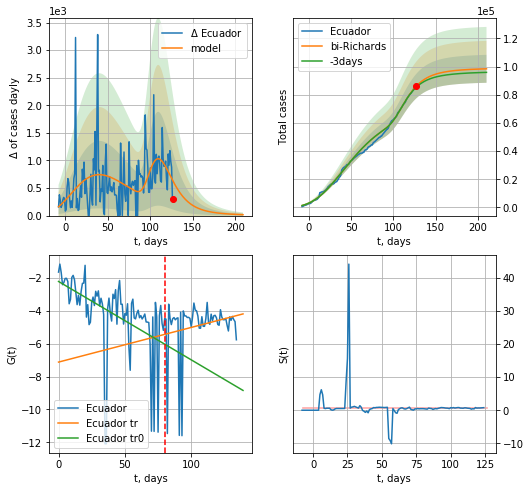

Ecuador data at: 2020-08-02
+3 day model MAPE: 0.009759
model: bi-Richards
coeffs: [2.87023945e+04 1.14951900e+01 4.45970343e+01 6.58722689e-03]
rational stdev: 0.100730
forecast at the end of period: +83 days
	 deltaDaycases: 16
	 total cases: 98424 ± 9914
	 total death: 6540 ± 1976
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.240107
 intercept: -2.224521
 slope: -0.047632
trend coefficient of determination: 0.040990
 intercept: -7.123268
 slope: 0.021063


In [4219]:
vL = 80+20
x = forecastRR("Ecuador",dfED[20:vL-20],d1,100*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Ecuador",dfED[20:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


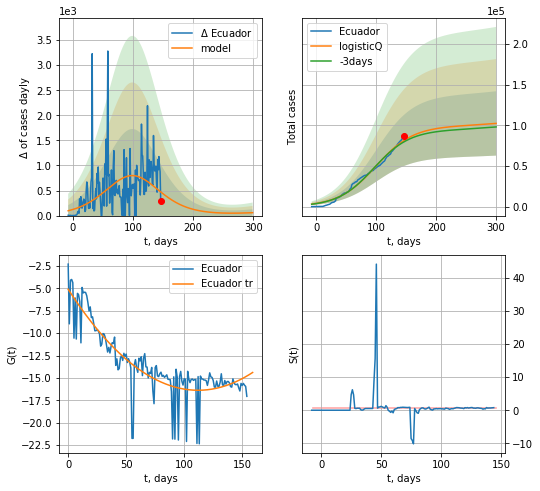

Ecuador data at: 2020-08-02
+3 day model MAPE: 0.022065
model: logisticQ
coeffs: [ 9.87282737e+04  1.16641781e-07  9.90877014e+01 -2.76214219e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.386682
forecast at the end of period: +153 days
	 deltaDaycases: 58
	 total cases: 102264 ± 39543
	 total death: 6796 ± 7883
trend coefficient of determination: 0.736156
 intercept_: -5.103446659581321
 coeffs_: [ 0.         -0.20138402  0.00089904]


In [4220]:
x = forecastRRR("Ecuador",dfED[:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

FI
           date   cases  active  death
155 2020-07-29  7423.0     144  329.0
156 2020-07-30  7432.0     153  329.0
157 2020-07-31  7443.0     164  329.0
158 2020-08-01  7453.0     174  329.0
159 2020-08-02  7453.0     174  329.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


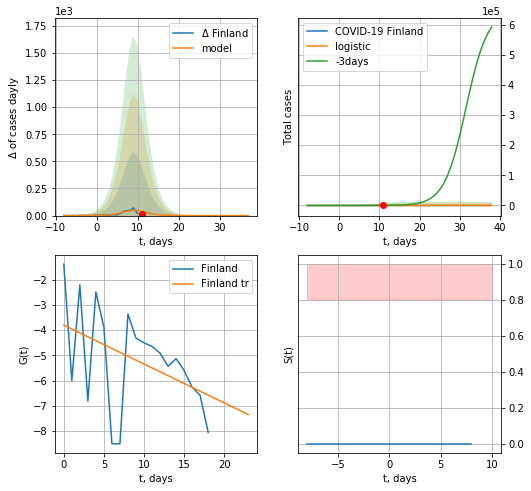

Finland data at: 2020-08-02
+3 day model MAPE: 0.3536795630191518
model: logistic
coeffs:  [373.20900186   0.53490302   9.59276199]
rational stdev:  11.028448708024662
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  373 ± 4115
	 total death:  16 ± 529
trend coefficient of determination: 0.182614
 intercept: -3.802910
 slope: -0.153962
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


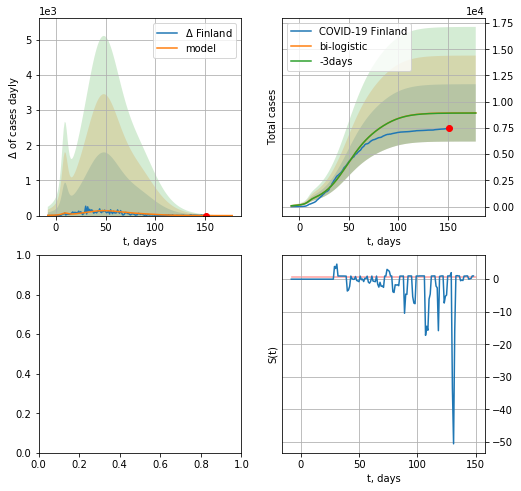

In [4221]:
try:
    dfFI = read_df(pd.DataFrame(),"FI")
    vL=20
    x = forecast("Finland",dfFI[:vL],d1,7*T18-dT)
    xx = forecast2("Finland",dfFI[:],d1,T18*7-dT,x,vL=vL,addpred=True,xcoef=[0.25,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


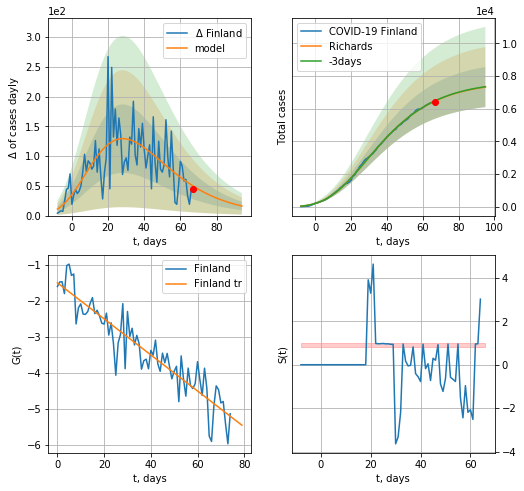

Finland data at: 2020-08-01
+3 day model MAPE: 0.001746
model: Richards
coeffs: [ 7.67975824e+03  2.65375623e+00 -5.92211245e+01  1.73858065e-02]
rational stdev: 0.167365
forecast at the end of period: +28 days
	 deltaDaycases: 16
	 total cases: 7329 ± 1226
	 total death: 323 ± 162
trend coefficient of determination: 0.854396
 intercept: -1.508206
 slope: -0.049971


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


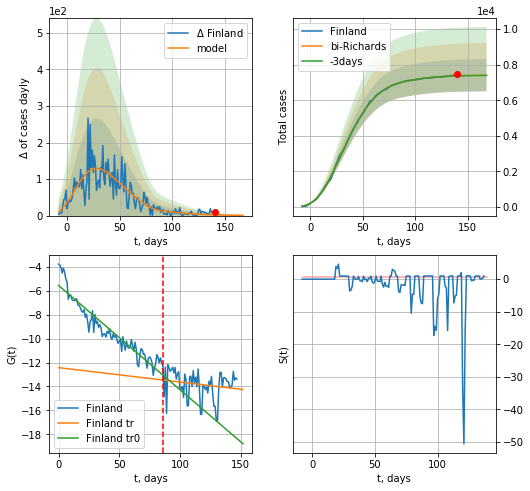

Finland data at: 2020-08-01
+3 day model MAPE: 0.001355
model: bi-Richards
coeffs: [-2.57676852e+02  1.62307428e-01  7.90861391e+01  7.59093356e-01]
rational stdev: 0.122252
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 7409 ± 905
	 total death: 327 ± 119
bi-Richards approximation splitting point: 86
trend coefficient of determination: 0.895486
 intercept: -5.572571
 slope: -0.086896
trend coefficient of determination: 0.034382
 intercept: -12.427952
 slope: -0.012003


In [3955]:
vL = 86 + 10
x = forecastRR("Finland",dfFI[10:vL-10],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Finland",dfFI[10:],d1,T18*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


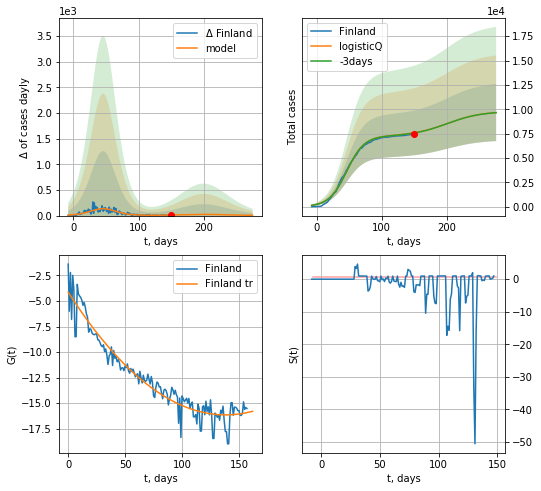

Finland data at: 2020-08-01
+3 day model MAPE: 0.001490
model: logisticQ
coeffs: [ 7.23739576e+03  2.61586224e-07  4.58995768e+01 -2.84116549e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.303480
forecast at the end of period: +126 days
	 deltaDaycases: 5
	 total cases: 9659 ± 2931
	 total death: 426 ± 387
trend coefficient of determination: 0.924335
 intercept_: -4.138663605168313
 coeffs_: [ 0.         -0.17391479  0.00062895]


In [3956]:
x = forecastRRR("Finland",dfFI[:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

BL
           date  cases  active  death
141 2020-07-29  11155  4816.0  368.0
142 2020-07-30  11420  4873.0  374.0
143 2020-07-31  11690  4988.0  383.0
144 2020-08-01  11836  5055.0  385.0
145 2020-08-02  11955  5147.0  388.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


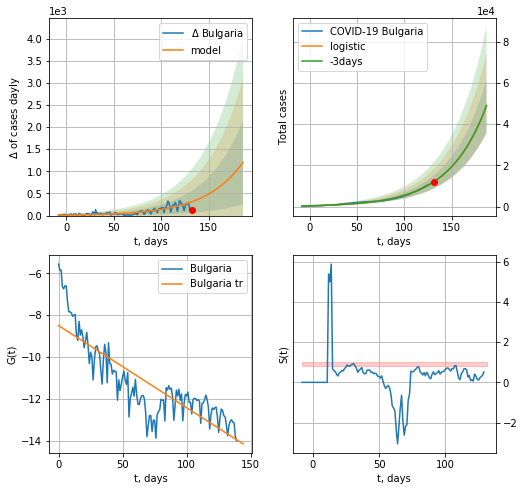

Bulgaria data at: 2020-08-02
+3 day model MAPE: 0.0036740270597884137
model: logistic
coeffs:  [1.23832442e+07 2.51429928e-02 4.07179417e+02]
scenario coeffs:  [0.25, 1.0, 3.5]
rational stdev:  0.26395701542390754
forecast at the end of period: +55 days
	 deltaDaycases:  1202
	 total cases:  48627 ± 12835
	 total death:  1578 ± 1249
trend coefficient of determination: 0.710706
 intercept: -8.494114
 slope: -0.039209


In [4222]:
dfBL = read_df(pd.DataFrame(),"BL").fillna(0)
try:
    x = forecast('Bulgaria',dfBL[5:],d1,26*7-dT,shift=1.0,addpred=True,xcoef=[0.25,1.,3.5])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


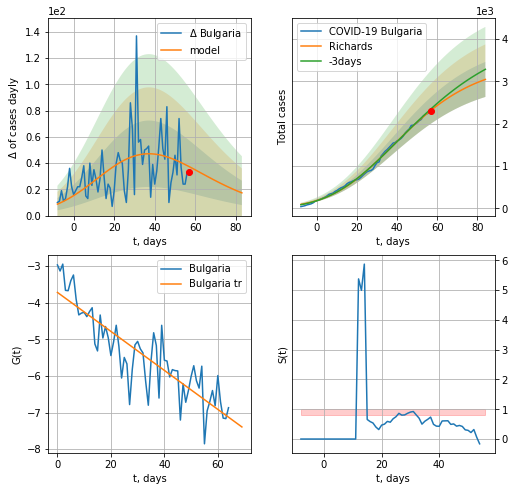

Bulgaria data at: 2020-08-02
+3 day model MAPE: 0.017233
model: Richards
coeffs: [3.47700846e+03 1.26494247e-01 1.24704401e+01 3.39632264e-01]
rational stdev: 0.135837
forecast at the end of period: +27 days
	 deltaDaycases: 17
	 total cases: 3043 ± 413
	 total death: 98 ± 39
trend coefficient of determination: 0.758376
 intercept: -3.716233
 slope: -0.053312


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


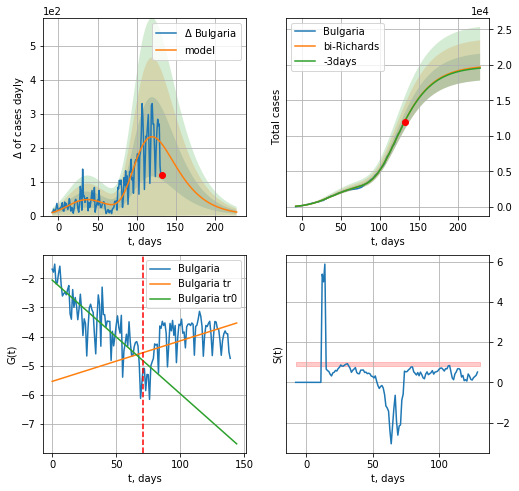

Bulgaria data at: 2020-08-02
+3 day model MAPE: 0.001480
model: bi-Richards
coeffs: [1.64709226e+04 2.64347626e+00 8.97406259e+00 1.43609344e-02]
rational stdev: 0.095923
forecast at the end of period: +97 days
	 deltaDaycases: 10
	 total cases: 19678 ± 1887
	 total death: 638 ± 183
bi-Richards approximation splitting point: 71
trend coefficient of determination: 0.675382
 intercept: -2.060271
 slope: -0.038990
trend coefficient of determination: 0.182253
 intercept: -5.534579
 slope: 0.013901


In [4223]:
vL = 71+5
x = forecastRR('Bulgaria',dfBL[5:vL-5],d1,T18*7-dT,shift=1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bulgaria',dfBL[5:],d1,32*7-dT,x,shift=1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


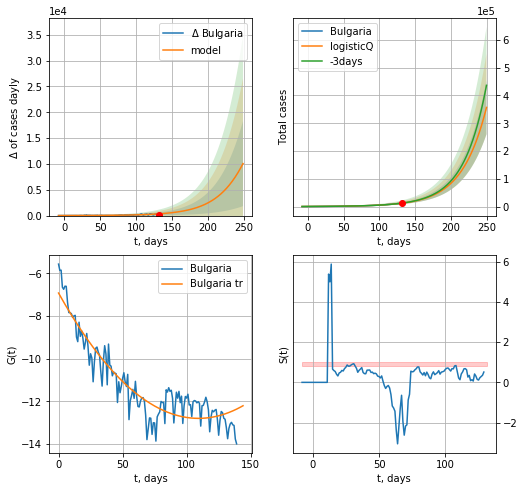

Bulgaria data at: 2020-08-02
+3 day model MAPE: 0.015389
model: logisticQ
coeffs: [ 3.43070990e+06  2.16157745e-05  3.14637061e+02 -1.29096552e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.270510
forecast at the end of period: +118 days
	 deltaDaycases: 10071
	 total cases: 356967 ± 96563
	 total death: 11585 ± 9401
trend coefficient of determination: 0.857261
 intercept_: -6.919435060626505
 coeffs_: [ 0.         -0.10767421  0.00049256]


In [4224]:
x = forecastRRR('Bulgaria',dfBL[5:],d1,35*7-dT,shift=1.0,addpred=True,xcoef=koreaCoeffs)

TH
           date   cases  active  death
153 2020-07-29  3304.0   135.0   58.0
154 2020-07-30  3310.0   127.0   58.0
155 2020-07-31  3312.0   119.0   58.0
156 2020-08-01  3317.0   117.0   58.0
157 2020-08-02  3320.0   120.0   58.0


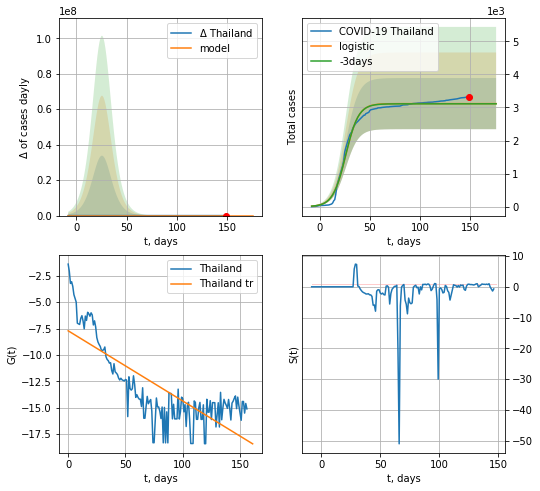

Thailand data at: 2020-08-02
+3 day model MAPE: 0.0020781653821361616
model: logistic
coeffs:  [3.11696139e+03 1.56337642e-01 2.59859430e+01]
rational stdev:  0.24815080453422955
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  3116 ± 773
	 total death:  54 ± 40
trend coefficient of determination: 0.620463
 intercept: -7.711720
 slope: -0.066578


In [4225]:
dfTH = read_df(pd.DataFrame(),"TH")
dfTH = dfTH.fillna(0)
try:
    x = forecast("Thailand",dfTH[:],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])
except:
    print("Exception occurs")
#xx = forecast2("Thailand",dfTH[:],d1,8*7-dT,x,vL=20,addpred=True,xcoef=[0.25,1.,1.8])

In [4226]:
#x = forecastRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2.2])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


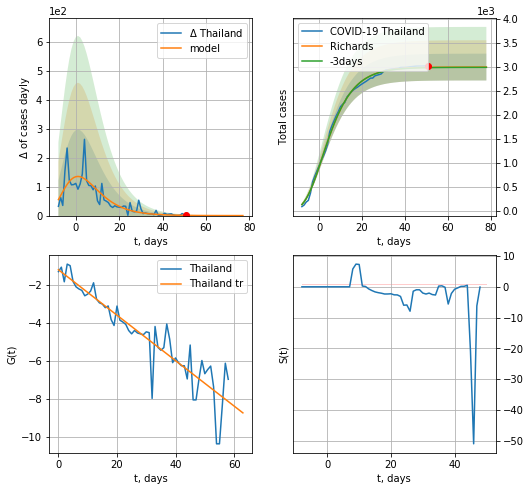

Thailand data at: 2020-08-02
+3 day model MAPE: 0.001958
model: Richards
coeffs: [ 2.99625224e+03  1.57427901e+01 -3.79340304e+01  7.81992540e-03]
rational stdev: 0.093292
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2996 ± 279
	 total death: 52 ± 14
trend coefficient of determination: 0.845848
 intercept: -1.208254
 slope: -0.119672


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


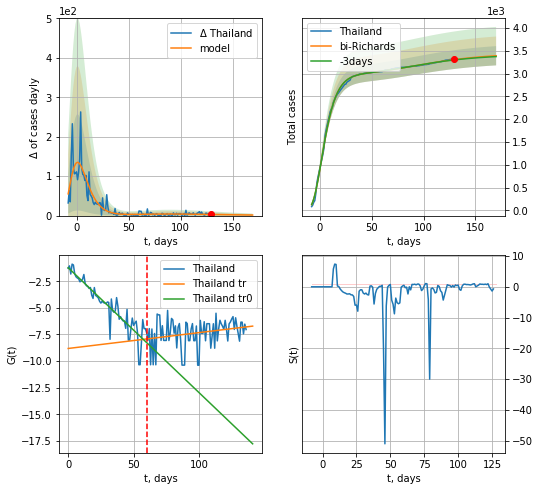

Thailand data at: 2020-08-02
+3 day model MAPE: 0.002129
model: bi-Richards
coeffs: [ 4.56913848e+02  6.13525982e+00 -1.43309201e+02  3.87457028e-03]
rational stdev: 0.062188
forecast at the end of period: +41 days
	 deltaDaycases: 1
	 total cases: 3389 ± 210
	 total death: 59 ± 11
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.843066
 intercept: -1.222845
 slope: -0.117436
trend coefficient of determination: 0.063143
 intercept: -8.818468
 slope: 0.014896


In [4227]:
vL = 80
x = forecastRR("Thailand",dfTH[20:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Thailand",dfTH[20:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


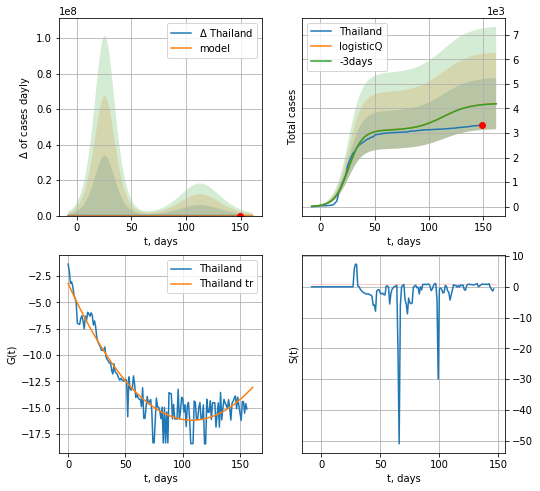

Thailand data at: 2020-08-02
+3 day model MAPE: 0.001613
model: logisticQ
coeffs: [ 3.11696677e+03  4.38715115e-07  2.59865832e+01 -3.56200130e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.248290
forecast at the end of period: +13 days
	 deltaDaycases: 1
	 total cases: 4197 ± 1042
	 total death: 73 ± 54
trend coefficient of determination: 0.904133
 intercept_: -3.2363238366703087
 coeffs_: [ 0.         -0.23982052  0.00111053]


In [4228]:
x = forecastRRR("Thailand",dfTH[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

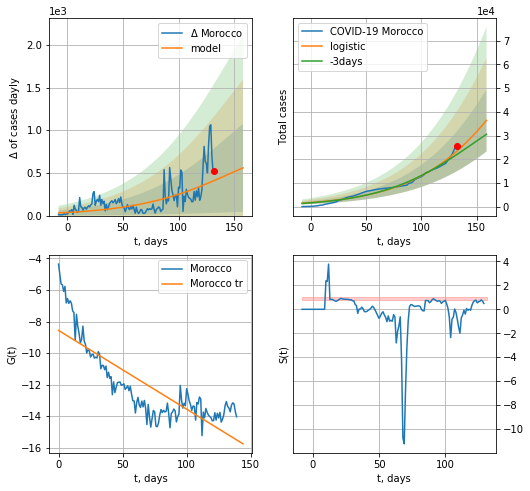

Morocco data at: 2020-08-02
+3 day model MAPE: 0.06728237808501265
model: logistic
coeffs:  [1.36256709e+05 2.10588881e-02 2.06899501e+02]
rational stdev:  0.36070710220274005
forecast at the end of period: +27 days
	 deltaDaycases:  559
	 total cases:  36412 ± 13134
	 total death:  544 ± 588
trend coefficient of determination: 0.682355
 intercept: -8.565920
 slope: -0.049916


In [4229]:
x = forecast("Morocco",dfMR[5:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


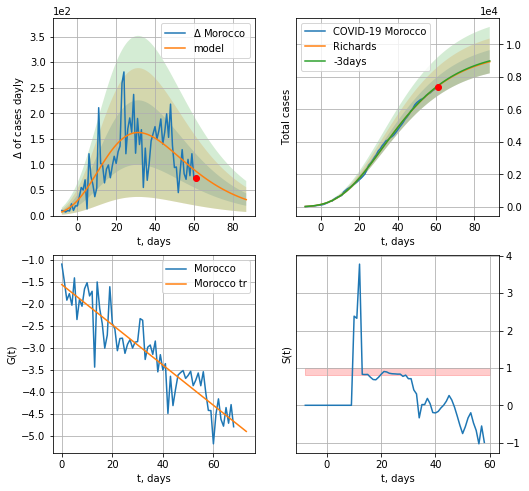

Morocco data at: 2020-08-02
+3 day model MAPE: 0.002855
model: Richards
coeffs: [ 9.62195156e+03  2.25629624e+00 -5.19455517e+01  2.05552972e-02]
rational stdev: 0.079912
forecast at the end of period: +27 days
	 deltaDaycases: 31
	 total cases: 8937 ± 714
	 total death: 133 ± 31
trend coefficient of determination: 0.846110
 intercept: -1.563215
 slope: -0.045646


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


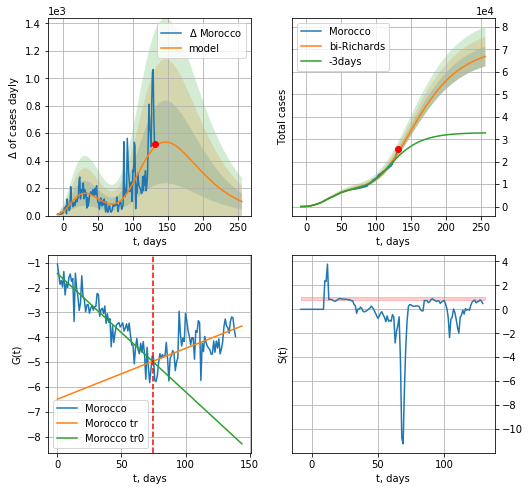

Morocco data at: 2020-08-02
+3 day model MAPE: 0.090021
model: bi-Richards
coeffs: [ 6.16911742e+04  2.99600475e+00 -5.75524662e+01  7.88520992e-03]
rational stdev: 0.065676
forecast at the end of period: +125 days
	 deltaDaycases: 102
	 total cases: 66847 ± 4390
	 total death: 999 ± 196
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.859661
 intercept: -1.435179
 slope: -0.047580
trend coefficient of determination: 0.317661
 intercept: -6.489353
 slope: 0.020437


In [4230]:
vL = 75 + 5
x = forecastRR("Morocco",dfMR[5:vL-5],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Morocco",dfMR[5:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-5)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


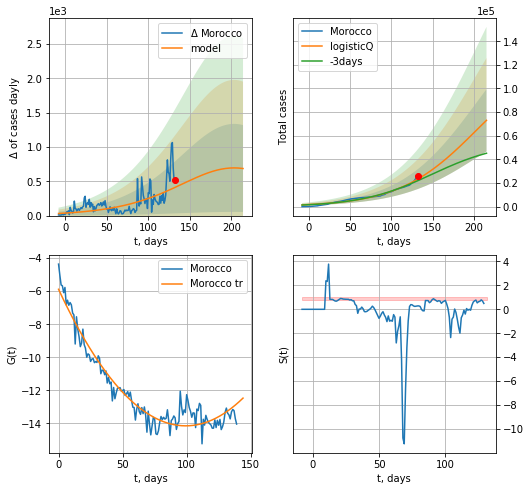

Morocco data at: 2020-08-02
+3 day model MAPE: 0.066001
model: logisticQ
coeffs: [ 1.29947368e+05  9.26837686e-07  2.03350422e+02 -2.28491011e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.360711
forecast at the end of period: +83 days
	 deltaDaycases: 685
	 total cases: 73058 ± 26352
	 total death: 1092 ± 1181
trend coefficient of determination: 0.933955
 intercept_: -5.885225621364344
 coeffs_: [ 0.         -0.16646949  0.00083852]


In [4231]:
x = forecastRRR("Morocco",dfMR[5:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

RM
           date    cases   active   death
154 2020-07-29  48235.0  20678.0  2304.0
155 2020-07-30  49591.0  20678.0  2304.0
156 2020-07-31  50886.0  21536.0  2343.0
157 2020-08-01  52111.0  22386.0  2379.0
158 2020-08-02  53186.0  23181.0  2413.0


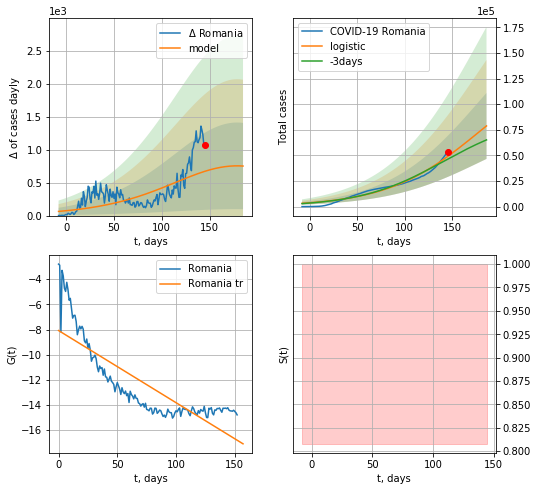

Romania data at: 2020-08-02
+3 day model MAPE: 0.05903052226336166
model: logistic
coeffs:  [1.43785794e+05 2.06277599e-02 1.78499846e+02]
scenario coeffs:  [0.35, 0.5, 3, 1]
rational stdev:  0.4090123108435571
forecast at the end of period: +41 days
	 deltaDaycases:  750
	 total cases:  78775 ± 32220
	 total death:  3573 ± 4384
trend coefficient of determination: 0.684857
 intercept: -8.079721
 slope: -0.057337


In [4232]:
dfRM = read_df(pd.DataFrame(),"RM")
x = forecast("Romania",dfRM[5:],d1,24*7-dT,addpred=True,xcoef=[0.35,.5,3,1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


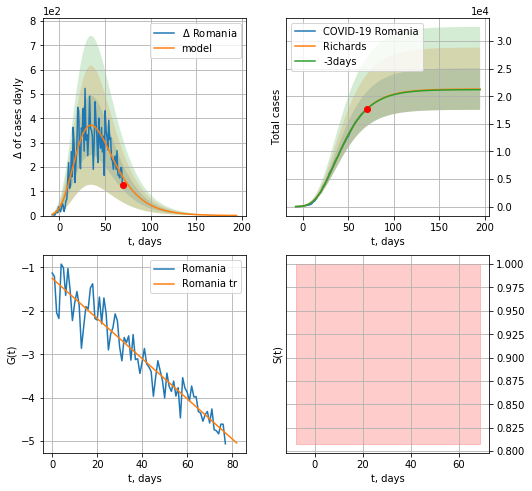

Romania data at: 2020-08-02
+3 day model MAPE: 0.002252
model: Richards
coeffs: [ 2.13019559e+04  3.77233819e+00 -5.65502366e+01  1.26521698e-02]
rational stdev: 0.176385
forecast at the end of period: +125 days
	 deltaDaycases: 0
	 total cases: 21291 ± 3755
	 total death: 965 ± 510
trend coefficient of determination: 0.908550
 intercept: -1.252366
 slope: -0.046196


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


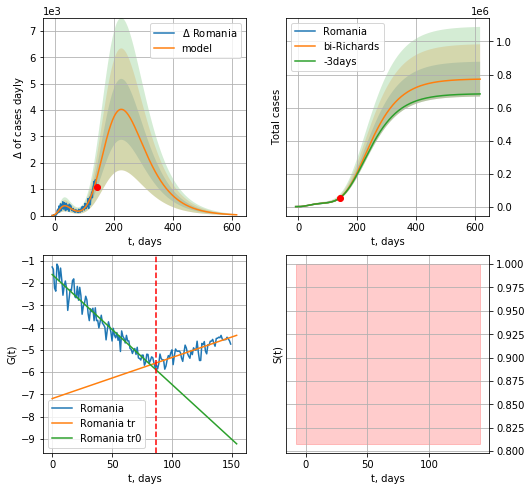

Romania data at: 2020-08-02
+3 day model MAPE: 0.006060
model: bi-Richards
coeffs: [7.52746588e+05 1.96637423e-01 5.62960482e+01 7.67550112e-02]
rational stdev: 0.136609
forecast at the end of period: +475 days
	 deltaDaycases: 31
	 total cases: 771980 ± 105459
	 total death: 35024 ± 14353
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.935022
 intercept: -1.609253
 slope: -0.049453
trend coefficient of determination: 0.703695
 intercept: -7.189968
 slope: 0.018474


In [4233]:
vL = 87+8
x = forecastRR("Romania",dfRM[8:vL-8],d1,36*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Romania",dfRM[8:],d1,86*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL = vL-8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


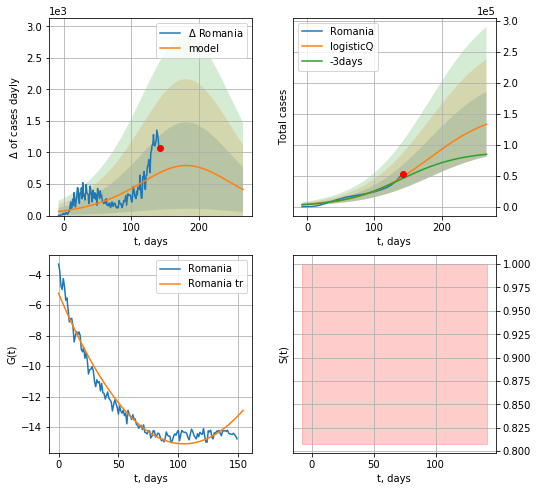

Romania data at: 2020-08-02
+3 day model MAPE: 0.065235
model: logisticQ
coeffs: [ 1.56247920e+05  3.65756915e-07  1.81887443e+02 -5.52982493e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.393642
forecast at the end of period: +125 days
	 deltaDaycases: 412
	 total cases: 132975 ± 52344
	 total death: 6032 ± 7123
trend coefficient of determination: 0.959926
 intercept_: -5.2183166426280545
 coeffs_: [ 0.         -0.18898134  0.00090287]


In [4234]:
xx = forecastRRR("Romania",dfRM[8:],d1,36*7-dT,addpred=True,xcoef=koreaCoeffs)

In [4235]:
#x = forecastRRR("Thailand",dfTH[20:],d1,8*7-dT,addpred=False,xcoef=[0.35/4,.5,2.2,1])

EU
           date    cases  active     death
172 2020-07-29  1443570  196557  136049.0
173 2020-07-30  1451595  199405  136104.0
174 2020-07-31  1462095  202441  136208.0
175 2020-08-01  1466990  205025  136270.0
176 2020-08-02  1470739  207039  136329.0


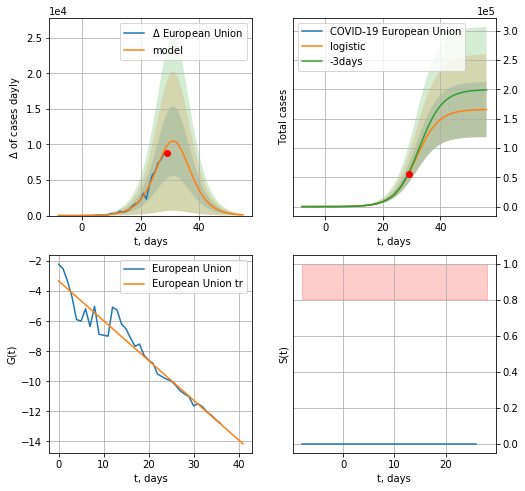

European Union data at: 2020-08-02
+3 day model MAPE: 0.026537311351207946
model: logistic
coeffs:  [1.65818575e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.28380142451786633
forecast at the end of period: +27 days
	 deltaDaycases:  96
	 total cases:  165482 ± 46964
	 total death:  15339 ± 13059
trend coefficient of determination: 0.942451
 intercept: -3.318380
 slope: -0.264437


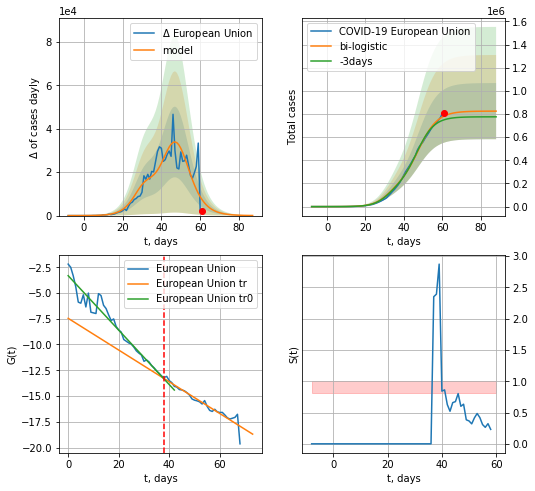

European Union data at: 2020-08-02
+3 day model MAPE: 0.04651886048168725
model: bi-logistic
coeffs:  [6.59401209e+05 2.01830792e-01 4.76685424e+01] [1.65818575e+05 2.54045102e-01 3.15946527e+01]
rational stdev:  0.2940888574557057
forecast at the end of period: +27 days
	 deltaDaycases:  43
	 total cases:  825027 ± 242631
	 total death:  76475 ± 67471
bi-logistic approximation splitting point: 38
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend coefficient of determination: 0.919570
 intercept: -7.459861
 slope: -0.154008


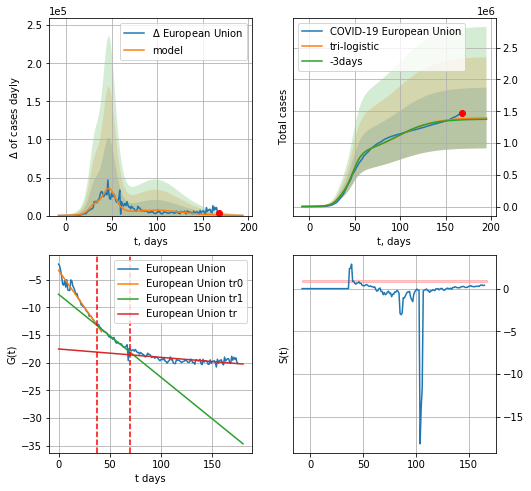

European Union data at: 2020-08-02
+3 day model MAPE: 0.012811220380907559
model: tri-logistic
coeffs:  [5.73145330e+05 5.03037475e-02 9.82696393e+01] [1.65818575e+05 2.54045102e-01 3.15946527e+01 6.59401209e+05
 2.01830792e-01 4.76685424e+01]
forecast rational stdev:  0.3424107968814094
forecast at the end of period: +27 days
	 deltaDaycases:  224
	 total cases:  1393982 ± 477314
	 total death:  129214 ± 132732
tri-logistic approximation splitting points: 38,70
trend0 coefficient of determination: 0.946588
 intercept: -3.319965
 slope: -0.264305
trend1 coefficient of determination: 0.917507
 intercept: -7.641441
 slope: -0.150225
trend coefficient of determination: 0.453714
 intercept: -17.538177
 slope: -0.015128


In [4236]:
vL=38
vL1=70
dfEU = read_df(pd.DataFrame(),"EU")
x = forecast("European Union",dfEU[:vL],d1,T18*7-dT)
xx = forecast2("European Union",dfEU[:vL1],d1,T18*7-dT,x,vL=38,addpred=False,xcoef=[0.25,1.,1.5])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("European Union",dfEU,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


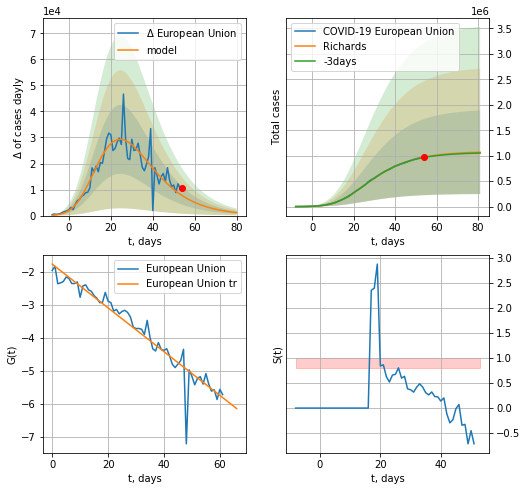

European Union data at: 2020-08-02
+3 day model MAPE: 0.007558
model: Richards
coeffs: [ 1.08235964e+06  8.91287836e-01 -6.99318002e+00  8.61027305e-02]
rational stdev: 0.768622
forecast at the end of period: +27 days
	 deltaDaycases: 1152
	 total cases: 1067789 ± 820726
	 total death: 98977 ± 228227
trend coefficient of determination: 0.920525
 intercept: -1.769238
 slope: -0.066303


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


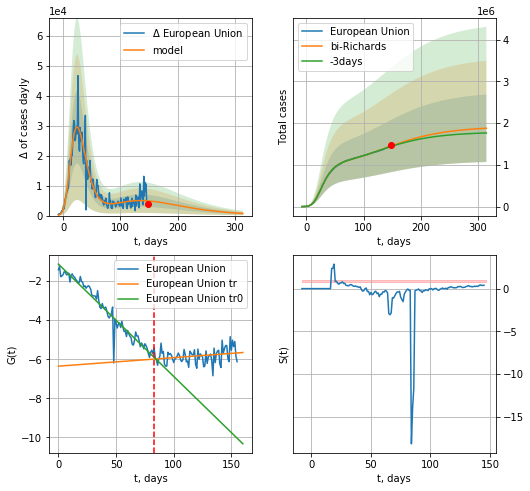

European Union data at: 2020-08-02
+3 day model MAPE: 0.007642
model: bi-Richards
coeffs: [ 8.40217623e+05  1.49382028e+00 -1.41803019e+02  1.08767824e-02]
rational stdev: 0.430871
forecast at the end of period: +167 days
	 deltaDaycases: 715
	 total cases: 1877651 ± 809025
	 total death: 174047 ± 224975
bi-Richards approximation splitting point: 83
trend coefficient of determination: 0.943724
 intercept: -1.128857
 slope: -0.057521
trend coefficient of determination: 0.058469
 intercept: -6.355378
 slope: 0.004367


In [4238]:
vL = 83+20
x = forecastRR("European Union",dfEU[20:vL-20],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("European Union",dfEU[20:],d1,42*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-20)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


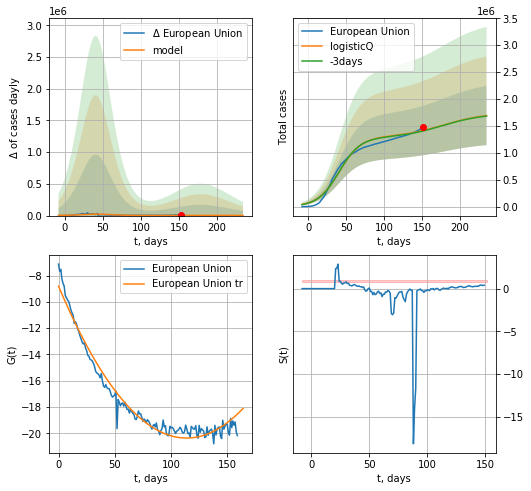

European Union data at: 2020-08-02
+3 day model MAPE: 0.005599
model: logisticQ
coeffs: [ 1.28920942e+06  8.80320881e-08  4.10279679e+01 -8.02301372e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.324921
forecast at the end of period: +83 days
	 deltaDaycases: 1731
	 total cases: 1691198 ± 549506
	 total death: 156764 ± 152807
trend coefficient of determination: 0.969122
 intercept_: -8.799468354308981
 coeffs_: [ 0.         -0.20311821  0.00089244]


In [4239]:
x = forecastRRR("European Union",dfEU[16:],d1,30*7-dT,addpred=True,xcoef=koreaCoeffs)

In [ ]:
#x = forecastQR("European Union",dfEU[20:],d1,16*7-dT,addpred=True,xcoef=QRkoreaCoeffs)

In [ ]:
#x = forecastRR("Romania",dfRM[5:],d1,14*7-dT)

In [ ]:
#x = forecastRRR("European Union",dfEU[:],d1,8*7-dT)

In [ ]:
#x = forecastRRR("Romania",dfRM[5:],d1,18*7-dT,addpred=True,xcoef=[0.35,.5,3.,1.])

In [ ]:
#dfIC[:]

ICn
           date   cases  active  death
148 2020-07-27  1855.0      21   10.0
149 2020-07-28  1858.0      24   10.0
150 2020-07-29  1862.0      28   10.0
151 2020-07-30  1872.0      39   10.0
152 2020-07-31  1885.0      50   10.0


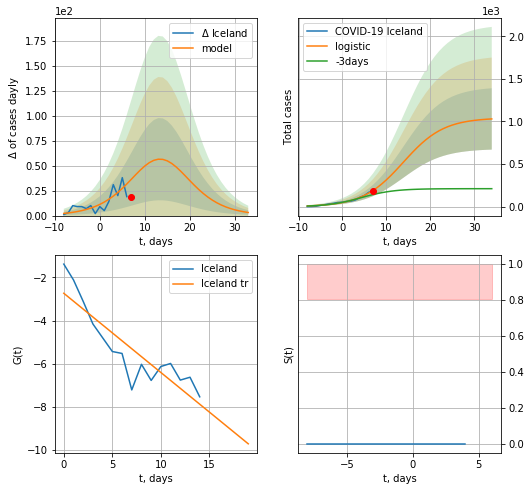

Iceland data at: 2020-08-02
+3 day model MAPE: 0.4751648041928849
model: logistic
coeffs:  [1.04285054e+03 2.17199299e-01 1.38649769e+01]
rational stdev:  0.34947878303574653
forecast at the end of period: +27 days
	 deltaDaycases:  3
	 total cases:  1029 ± 359
	 total death:  5 ± 5
trend coefficient of determination: 0.782203
 intercept: -2.736046
 slope: -0.366728


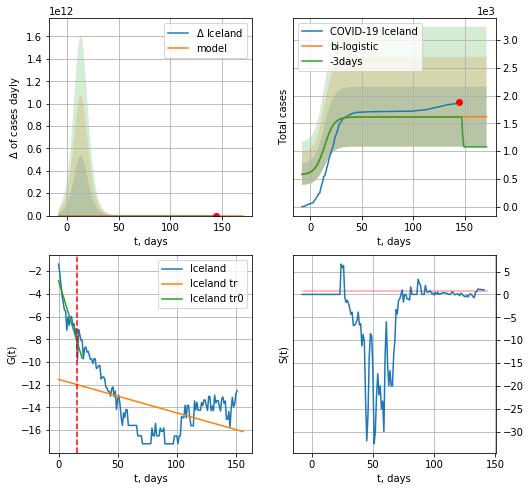

Iceland data at: 2020-08-02
+3 day model MAPE: 0.0037765165820673385
model: bi-logistic
coeffs:  [ 543.34822909   -4.70328086 1471.25562483] [1.04285054e+03 2.17199299e-01 1.38649769e+01]
scenario coeffs:  [0.0625, 1.0, 2]
rational stdev:  0.332704128103235
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1620 ± 539
	 total death:  8 ± 7
bi-logistic approximation splitting point: 16
trend0 coefficient of determination: 0.774693
 intercept: -2.854940
 slope: -0.341251
trend coefficient of determination: 0.215925
 intercept: -11.530919
 slope: -0.029444


In [4240]:
dfIC = read_df(pd.DataFrame(),"ICn")
vL=16
try:
    x = forecast("Iceland",dfIC[:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25/2,1.,2])
    xx = forecast2("Iceland",dfIC[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25/4,1.,2],vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


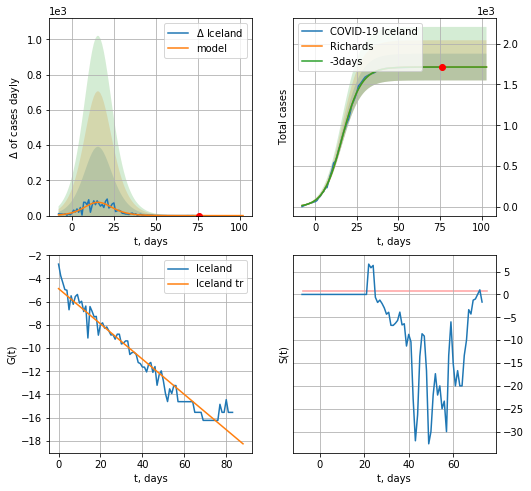

Iceland data at: 2020-08-02
+3 day model MAPE: 0.000010
model: Richards
coeffs: [1.71330052e+03 1.94502632e-01 1.51528095e+01 8.70905557e-01]
rational stdev: 0.095562
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1713 ± 163
	 total death: 8 ± 2
trend coefficient of determination: 0.952024
 intercept: -4.875300
 slope: -0.151986


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


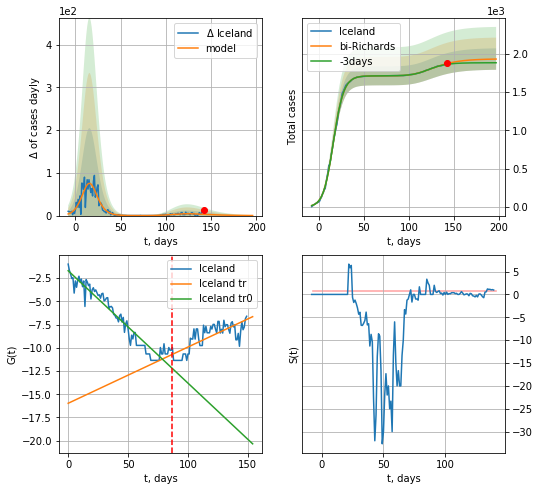

Iceland data at: 2020-08-02
+3 day model MAPE: 0.005613
model: bi-Richards
coeffs: [2.22044526e+02 2.71442247e-01 9.78815621e+01 2.15970675e-01]
rational stdev: 0.072447
forecast at the end of period: +55 days
	 deltaDaycases: 0
	 total cases: 1932 ± 139
	 total death: 10 ± 2
bi-Richards approximation splitting point: 87
trend coefficient of determination: 0.929552
 intercept: -1.703013
 slope: -0.121010
trend coefficient of determination: 0.591962
 intercept: -15.973535
 slope: 0.060543


In [4241]:
vL = 87+2
x = forecastRR("Iceland",dfIC[2:vL-2],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iceland",dfIC[2:],d1,26*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-2)
#x = forecastRRR("Iceland",dfIC[:20],d1,8*7-dT,addpred=False,xcoef=[0.25/2,1.,2])

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


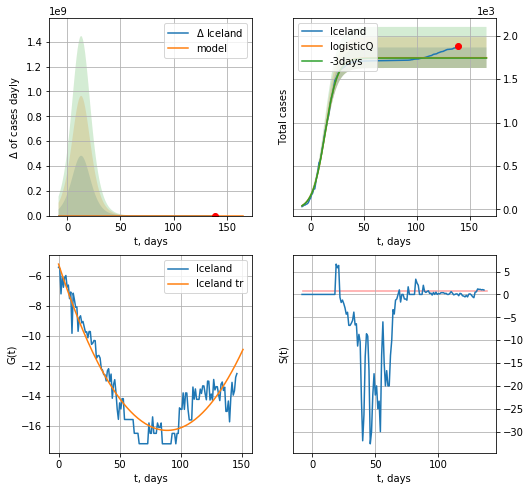

Iceland data at: 2020-08-02
+3 day model MAPE: 0.002173
model: logisticQ
coeffs: [ 1.74620255e+03  1.73909419e-06  1.36824733e+01 -9.70714614e+04]
rational stdev: 0.067704
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1746 ± 118
	 total death: 9 ± 1
trend coefficient of determination: 0.895963
 intercept_: -5.226227392825084
 coeffs_: [ 0.         -0.24907487  0.00140016]


In [4242]:
x = forecastRRR("Iceland",dfIC[5:],d1,T18*7-dT,addpred=False,xcoef=[0.35/6,.5,4.,1.])

PM
           date  cases   active   death
141 2020-07-29  63269  24579.0  1374.0
142 2020-07-30  64191  24576.0  1397.0
143 2020-07-31  65256  24669.0  1421.0
144 2020-08-01  66383  24853.0  1449.0
145 2020-08-02  67453  24944.0  1471.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:125: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


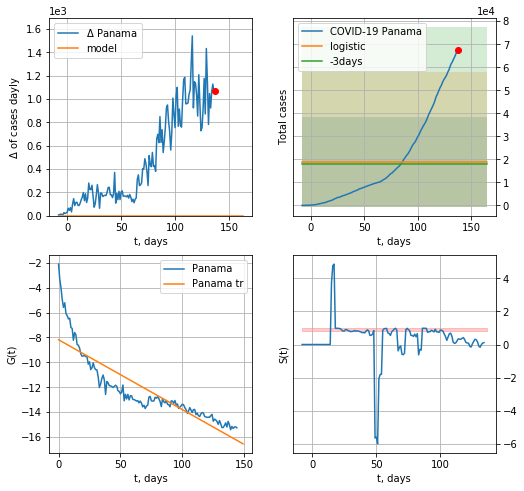

Panama data at: 2020-08-02
+3 day model MAPE: 0.05525964563809731
model: logistic
coeffs:  [ 1.89822466e+04 -1.61403541e+01  4.09763633e+02]
rational stdev:  1.0280745193953669
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  18982 ± 19515
	 total death:  413 ± 1273
trend coefficient of determination: 0.767401
 intercept: -8.179791
 slope: -0.056172


In [4243]:
dfPM = read_df(pd.DataFrame(),"PM").fillna(0)
x = forecast("Panama",dfPM[:],d1,T18*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


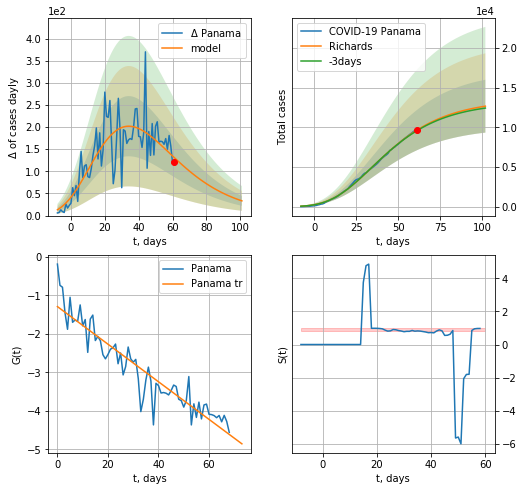

Panama data at: 2020-08-02
+3 day model MAPE: 0.008202
model: Richards
coeffs: [ 1.34884806e+04  2.34095265e+00 -6.38236986e+01  1.75426471e-02]
rational stdev: 0.263123
forecast at the end of period: +41 days
	 deltaDaycases: 33
	 total cases: 12667 ± 3332
	 total death: 276 ± 217
trend coefficient of determination: 0.871686
 intercept: -1.291509
 slope: -0.048815


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


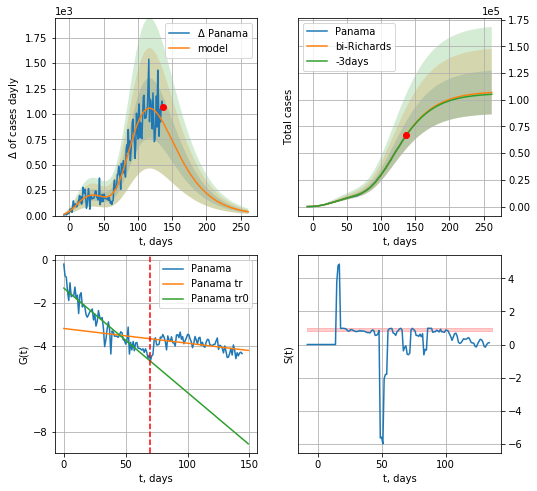

Panama data at: 2020-08-02
+3 day model MAPE: 0.003431
model: bi-Richards
coeffs: [ 9.45084812e+04  1.53935196e+00 -1.20625154e+01  1.96013614e-02]
rational stdev: 0.191685
forecast at the end of period: +125 days
	 deltaDaycases: 37
	 total cases: 106768 ± 20465
	 total death: 2328 ± 1338
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.874637
 intercept: -1.308223
 slope: -0.048676
trend coefficient of determination: 0.221440
 intercept: -3.190896
 slope: -0.006854


In [4244]:
vL = 70
x = forecastRR("Panama",dfPM[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Panama",dfPM[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


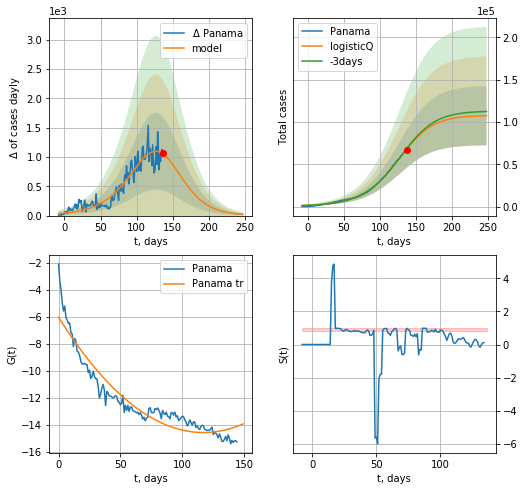

Panama data at: 2020-08-02
+3 day model MAPE: 0.007072
model: logisticQ
coeffs: [ 1.07547100e+05  5.03652878e-05  1.23998481e+02 -6.84278049e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.325780
forecast at the end of period: +111 days
	 deltaDaycases: 20
	 total cases: 107445 ± 35003
	 total death: 2343 ± 2289
trend coefficient of determination: 0.900023
 intercept_: -6.039184966139173
 coeffs_: [ 0.         -0.14598931  0.00062373]


In [4245]:
x = forecastRRR("Panama",dfPM[:],d1,34*7-dT,addpred=True,xcoef=koreaCoeffs)

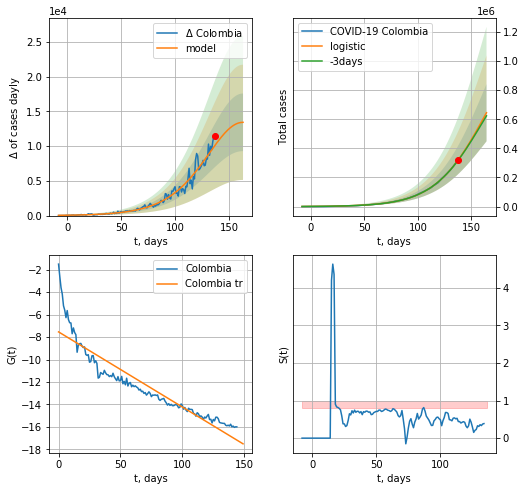

Colombia data at: 2020-08-02
+3 day model MAPE: 0.0077783529916413486
model: logistic
coeffs:  [1.27190807e+06 4.21884604e-02 1.63353110e+02]
rational stdev:  0.30468740584162063
forecast at the end of period: +27 days
	 deltaDaycases:  13414
	 total cases:  644631 ± 196411
	 total death:  21612 ± 19754
trend coefficient of determination: 0.856564
 intercept: -7.536920
 slope: -0.066867


In [4246]:
dfCB = dfCB.fillna(0)
x = forecast("Colombia",dfCB[:],d1,T18*7-dT)

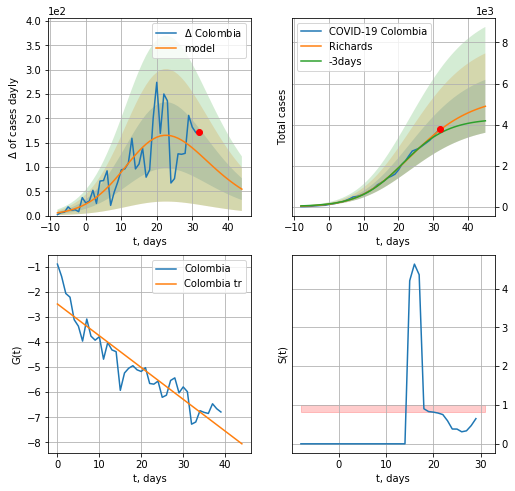

Colombia data at: 2020-08-02
+3 day model MAPE: 0.053959
model: Richards
coeffs: [5.45324012e+03 2.23852503e-01 1.50938863e+01 4.47627095e-01]
rational stdev: 0.263661
forecast at the end of period: +13 days
	 deltaDaycases: 54
	 total cases: 4890 ± 1289
	 total death: 163 ± 128
trend coefficient of determination: 0.864435
 intercept: -2.485430
 slope: -0.126591


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


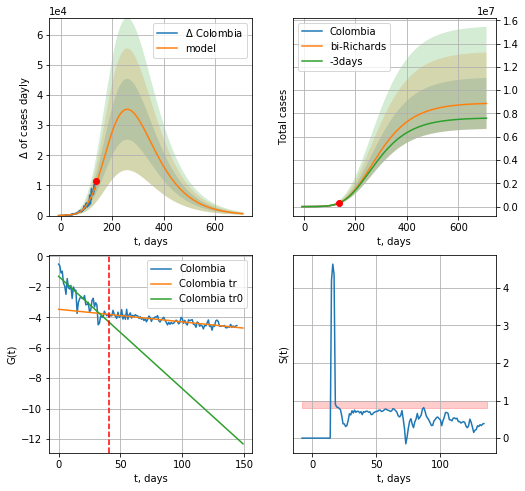

Colombia data at: 2020-08-02
+3 day model MAPE: 0.007813
model: bi-Richards
coeffs: [8.90388080e+06 1.16792231e-01 5.20472487e+01 9.65652729e-02]
rational stdev: 0.247473
forecast at the end of period: +573 days
	 deltaDaycases: 622
	 total cases: 8854300 ± 2191197
	 total death: 296861 ± 220394
bi-Richards approximation splitting point: 41
trend coefficient of determination: 0.791840
 intercept: -1.311433
 slope: -0.073803
trend coefficient of determination: 0.705136
 intercept: -3.476097
 slope: -0.008268


In [4247]:
vL = 41
x = forecastRR("Colombia",dfCB[:vL],d1,20*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Colombia",dfCB[:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


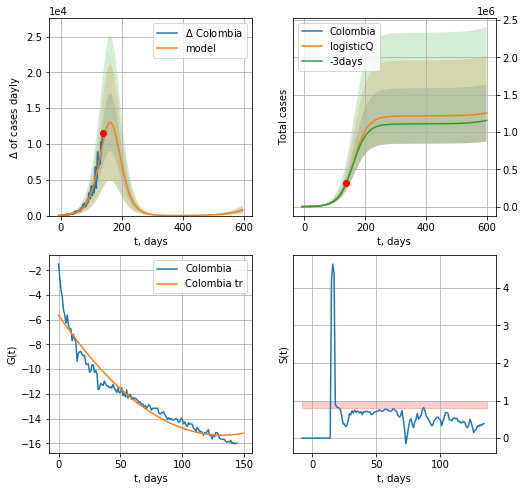

Colombia data at: 2020-08-02
+3 day model MAPE: 0.008139
model: logisticQ
coeffs: [ 1.21472124e+06  4.32002887e-06  1.61554089e+02 -9.76732388e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.306161
forecast at the end of period: +461 days
	 deltaDaycases: 776
	 total cases: 1255349 ± 384338
	 total death: 42088 ± 38657
trend coefficient of determination: 0.938986
 intercept_: -5.635574892057143
 coeffs_: [ 0.         -0.14664452  0.00055402]


In [4248]:
x = forecastRRR("Colombia",dfCB[:],d1,84*7-dT,addpred=True,xcoef=koreaCoeffs)

AR
           date    cases  active   death
147 2020-07-29  29229.0  8451.0  1186.0
148 2020-07-30  29831.0  8549.0  1200.0
149 2020-07-31  30394.0  8647.0  1210.0
150 2020-08-01  30950.0  8739.0  1223.0
151 2020-08-02  31465.0  8815.0  1231.0


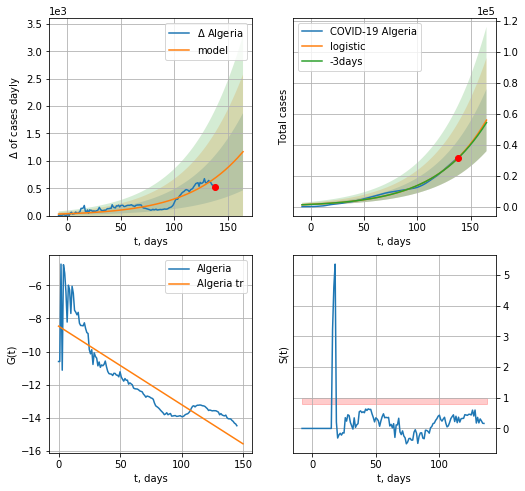

Algeria data at: 2020-08-02
+3 day model MAPE: 0.008604599276343381
model: logistic
coeffs:  [9.26660855e+05 2.24653935e-02 2.87281157e+02]
rational stdev:  0.35893862698926166
forecast at the end of period: +27 days
	 deltaDaycases:  1167
	 total cases:  55832 ± 20040
	 total death:  2184 ± 2351
trend coefficient of determination: 0.754188
 intercept: -8.466926
 slope: -0.047281


In [4249]:
dfAR = read_df(pd.DataFrame(),"AR")
dfAR = dfAR.fillna(0)
x = forecast("Algeria",dfAR[5:],d1,T18*7-dT)
#dfAG

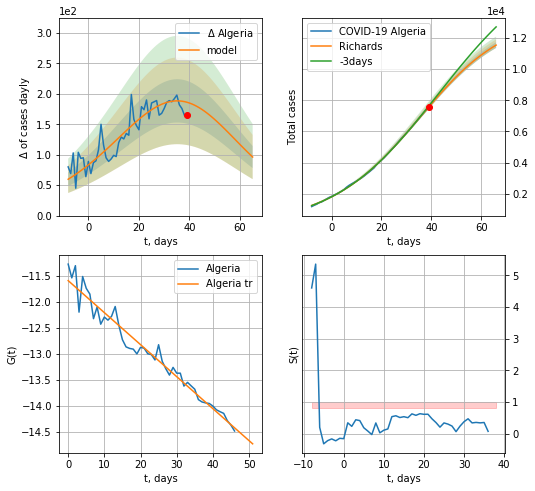

Algeria data at: 2020-08-02
+3 day model MAPE: 0.009853
model: Richards
coeffs: [1.34014715e+04 4.98947140e-02 3.86388173e+01 1.19488229e+00]
rational stdev: 0.015787
forecast at the end of period: +27 days
	 deltaDaycases: 96
	 total cases: 11539 ± 182
	 total death: 451 ± 21
trend coefficient of determination: 0.959635
 intercept: -11.589811
 slope: -0.061720


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


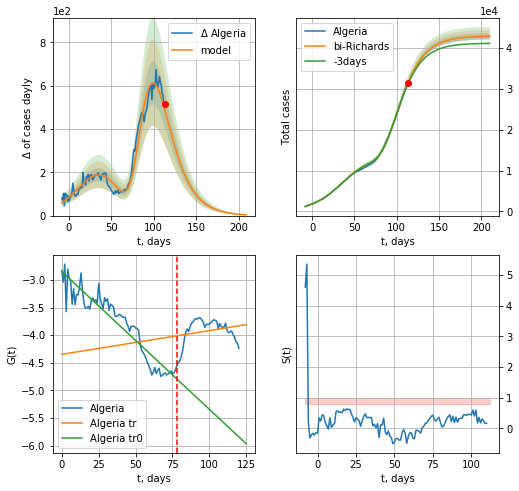

Algeria data at: 2020-08-02
+3 day model MAPE: 0.009840
model: bi-Richards
coeffs: [2.94963463e+04 4.51454817e+00 2.08190894e+01 1.22644516e-02]
rational stdev: 0.017815
forecast at the end of period: +97 days
	 deltaDaycases: 3
	 total cases: 42829 ± 763
	 total death: 1675 ± 89
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.888319
 intercept: -2.848051
 slope: -0.024949
trend coefficient of determination: 0.055798
 intercept: -4.347554
 slope: 0.004298


In [4250]:
iL = 30
vL = 78+iL
x = forecastRR("Algeria",dfAR[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[iL:],d1,32*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


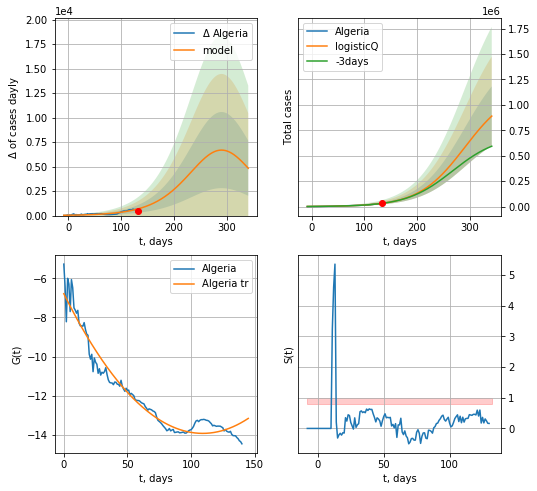

Algeria data at: 2020-08-02
+3 day model MAPE: 0.005756
model: logisticQ
coeffs: [ 1.15782667e+06  1.94889227e-06  2.90277612e+02 -1.15534519e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.328351
forecast at the end of period: +209 days
	 deltaDaycases: 4827
	 total cases: 889640 ± 292114
	 total death: 34805 ± 34284
trend coefficient of determination: 0.950456
 intercept_: -6.785390746125419
 coeffs_: [ 0.         -0.13090634  0.0005992 ]


In [4251]:
x = forecastRRR("Algeria",dfAR[10:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

IE
           date   cases   active   death
142 2020-07-29  106336  36986.0  5058.0
143 2020-07-30  108376  37338.0  5131.0
144 2020-07-31  109936  36824.0  5193.0
145 2020-08-01  111455  37244.0  5236.0
146 2020-08-02  113134  37595.0  5302.0


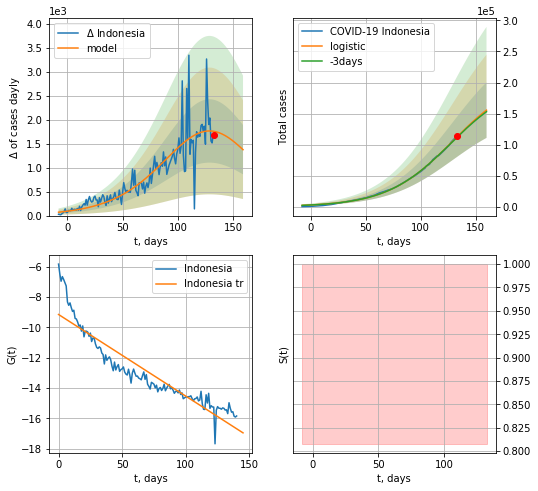

Indonesia data at: 2020-08-02
+3 day model MAPE: 0.006799221768445263
model: logistic
coeffs:  [2.10597802e+05 3.36013105e-02 1.29101613e+02]
rational stdev:  0.28737513236699386
forecast at the end of period: +27 days
	 deltaDaycases:  1377
	 total cases:  155528 ± 44694
	 total death:  7288 ± 6283
trend coefficient of determination: 0.858904
 intercept: -9.154836
 slope: -0.053827


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


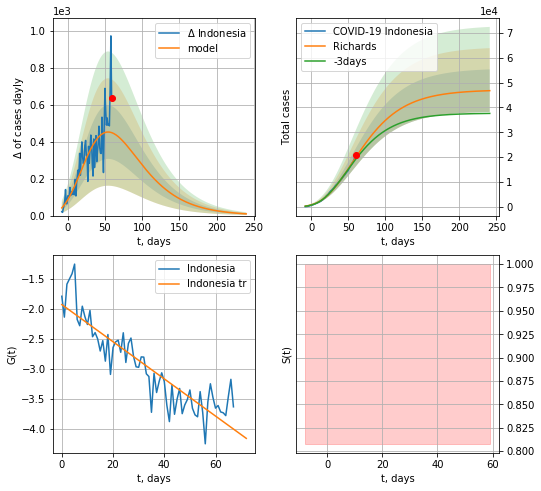

Indonesia data at: 2020-08-02
+3 day model MAPE: 0.038052
model: Richards
coeffs: [ 4.71241400e+04  1.80052285e+00 -1.05975004e+02  1.46057737e-02]
rational stdev: 0.182929
forecast at the end of period: +181 days
	 deltaDaycases: 9
	 total cases: 46773 ± 8556
	 total death: 2192 ± 1202
trend coefficient of determination: 0.798542
 intercept: -1.926266
 slope: -0.031064


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


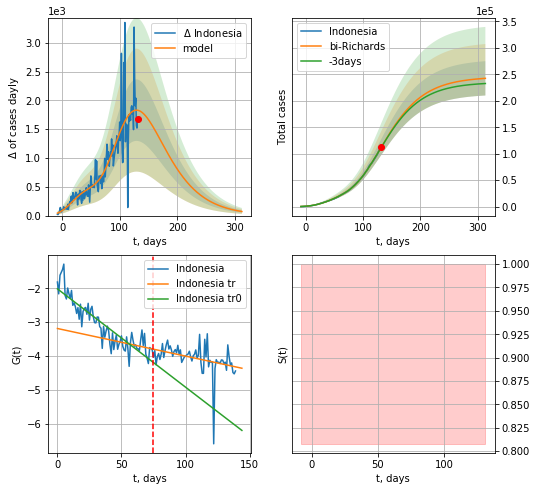

Indonesia data at: 2020-08-02
+3 day model MAPE: 0.004533
model: bi-Richards
coeffs: [ 1.98221606e+05  1.16480273e+00 -3.40607310e+01  2.00556986e-02]
rational stdev: 0.133609
forecast at the end of period: +181 days
	 deltaDaycases: 70
	 total cases: 242338 ± 32378
	 total death: 11357 ± 4552
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.799727
 intercept: -2.014101
 slope: -0.029077
trend coefficient of determination: 0.139195
 intercept: -3.187031
 slope: -0.008158


In [4252]:
dfIE = read_df(pd.DataFrame(),"IE")
try:
    x = forecast("Indonesia",dfIE[5:],d1,T18*7-dT)
    vL = 75+6
    x = forecastRR("Indonesia",dfIE[6:vL-6],d1,44*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Indonesia",dfIE[6:],d1,44*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-6)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


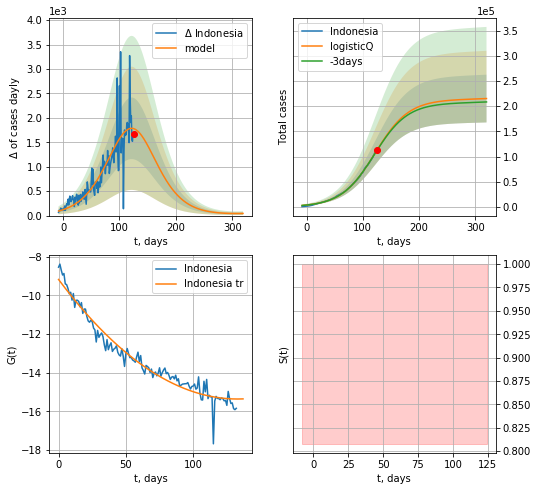

Indonesia data at: 2020-08-02
+3 day model MAPE: 0.006168
model: logisticQ
coeffs: [ 2.13368569e+05  1.38969434e-06  1.21838270e+02 -2.39521000e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.220471
forecast at the end of period: +195 days
	 deltaDaycases: 43
	 total cases: 215239 ± 47454
	 total death: 10087 ± 6671
trend coefficient of determination: 0.955594
 intercept_: -9.183005830640537
 coeffs_: [ 0.         -0.09305325  0.00035013]


In [4253]:
x = forecastRRR("Indonesia",dfIE[13:],d1,46*7-dT,addpred=True,xcoef=koreaCoeffs)

PH
           date   cases   active   death
144 2020-07-29   85486  56528.0  1962.0
145 2020-07-30   89374  22327.0  1983.0
146 2020-07-31   93354  26153.0  2023.0
147 2020-08-01   98153  35569.0  2059.0
148 2020-08-02  106330  38405.0  2104.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


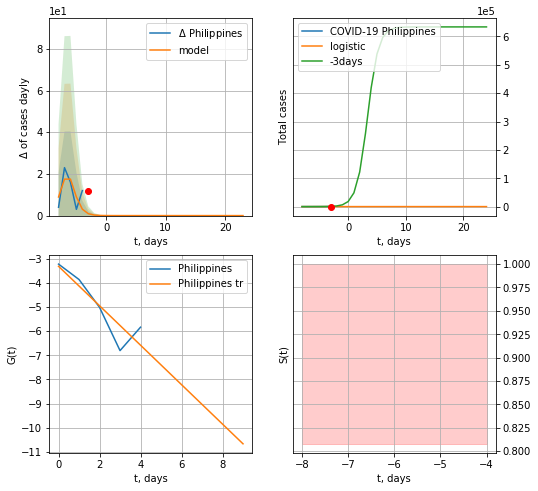

Philippines data at: 2020-08-02
+3 day model MAPE: 0.9724006926427327
model: logistic
coeffs:  [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.193485507182797
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  61 ± 11
	 total death:  1 ± 0
trend coefficient of determination: 0.794507
 intercept: -3.309972
 slope: -0.817432


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


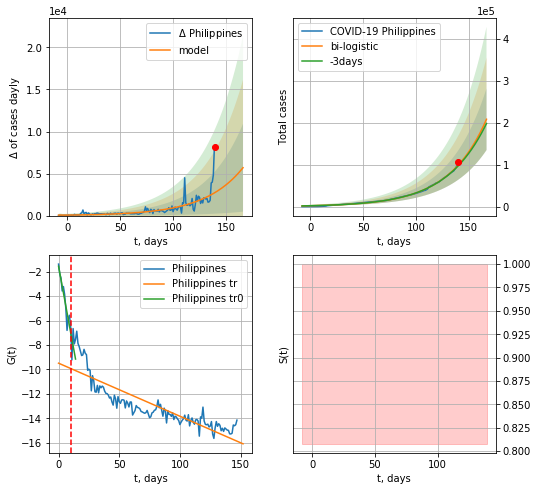

Philippines data at: 2020-08-02
+3 day model MAPE: 0.019260987610782328
model: bi-logistic
coeffs:  [5.47677016e+07 2.78095646e-02 3.67200583e+02] [61.5169203   1.2919553  -5.99802409]
rational stdev:  0.35247679192951176
forecast at the end of period: +27 days
	 deltaDaycases:  5695
	 total cases:  208480 ± 73484
	 total death:  4125 ± 4361
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend coefficient of determination: 0.747772
 intercept: -9.484170
 slope: -0.043362


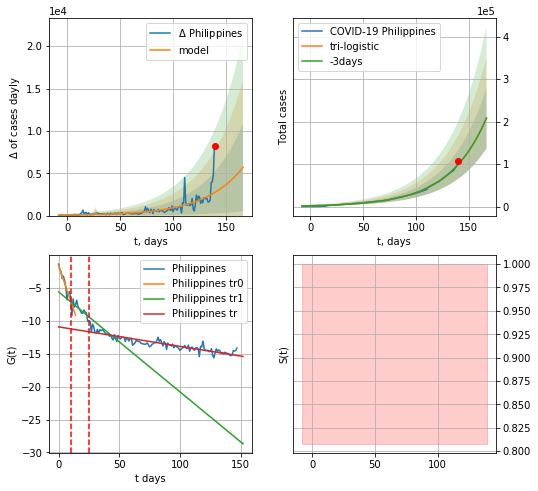

Philippines data at: 2020-08-02
+3 day model MAPE: 0.000816083204131492
model: tri-logistic
coeffs:  [315.31881343   2.29202886  27.49397595] [ 6.15169203e+01  1.29195530e+00 -5.99802409e+00  5.47677016e+07
  2.78095646e-02  3.67200583e+02]
forecast rational stdev:  0.34209372262281024
forecast at the end of period: +27 days
	 deltaDaycases:  5695
	 total cases:  208796 ± 71427
	 total death:  4131 ± 4239
tri-logistic approximation splitting points: 10,25
trend0 coefficient of determination: 0.872436
 intercept: -1.560268
 slope: -0.541848
trend1 coefficient of determination: 0.474240
 intercept: -5.600607
 slope: -0.151865
trend coefficient of determination: 0.824112
 intercept: -10.920131
 slope: -0.029556


In [4254]:
vL=10
vL1=25
dfPH = read_df(pd.DataFrame(),"PH")
x = forecast("Philippines",dfPH[4:vL],d1,T18*7-dT,addpred=False,xcoef=[0.25,1.,2.3])
xx = forecast2("Philippines",dfPH[:],d1,T18*7-dT,x,vL=vL,addpred=False,xcoef=[0.25,1.,1.8])
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Philippines",dfPH,d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


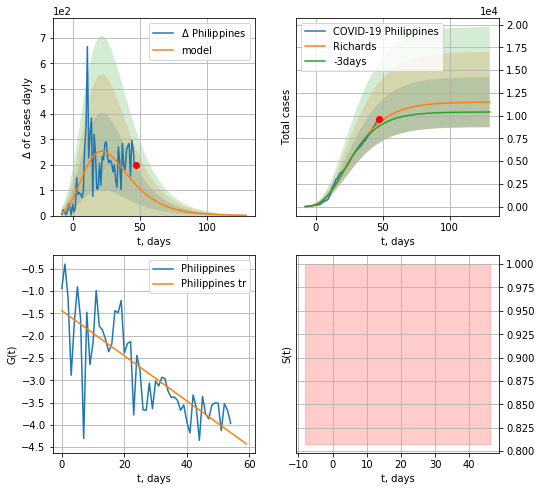

Philippines data at: 2020-08-02
+3 day model MAPE: 0.044211
model: Richards
coeffs: [ 1.15018224e+04  6.61447978e+00 -5.57254377e+01  9.11076230e-03]
rational stdev: 0.239777
forecast at the end of period: +83 days
	 deltaDaycases: 1
	 total cases: 11484 ± 2753
	 total death: 227 ± 163
trend coefficient of determination: 0.622666
 intercept: -1.437831
 slope: -0.050660


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


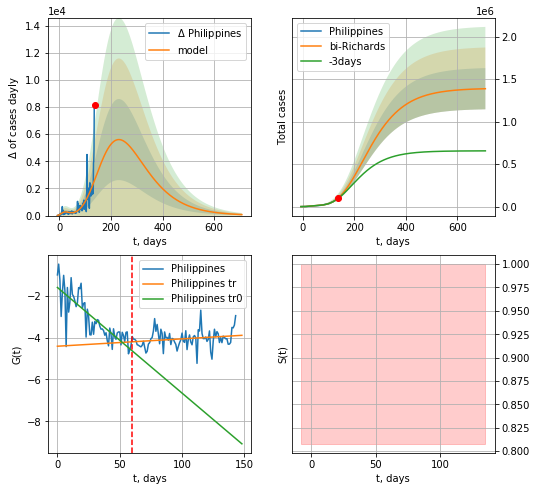

Philippines data at: 2020-08-02
+3 day model MAPE: 0.036953
model: bi-Richards
coeffs: [ 1.38281079e+06  3.42748748e-01 -7.45871750e+01  3.26708831e-02]
rational stdev: 0.174766
forecast at the end of period: +573 days
	 deltaDaycases: 73
	 total cases: 1387784 ± 242537
	 total death: 27460 ± 14397
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.668611
 intercept: -1.593786
 slope: -0.050589
trend coefficient of determination: 0.044179
 intercept: -4.407652
 slope: 0.003526


In [4256]:
vL = 60 + 4
x = forecastRR("Philippines",dfPH[4:vL-4],d1,30*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Philippines",dfPH[4:],d1,100*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-4)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


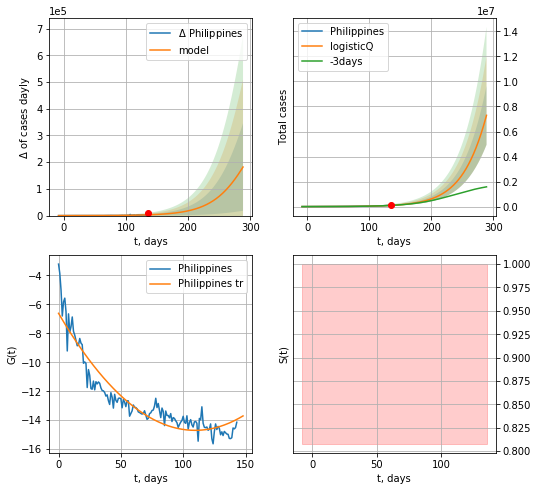

Philippines data at: 2020-08-02
+3 day model MAPE: 0.023582
model: logisticQ
coeffs: [ 4.25117531e+07  7.11013857e-06  3.40170800e+02 -4.03878700e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.322875
forecast at the end of period: +153 days
	 deltaDaycases: 181853
	 total cases: 7293475 ± 2354884
	 total death: 144319 ± 139791
trend coefficient of determination: 0.886861
 intercept_: -6.6179959006081885
 coeffs_: [ 0.         -0.14755652  0.0006735 ]


In [4257]:
x = forecastRRR("Philippines",dfPH[4:],d1,40*7-dT,addpred=True,xcoef=koreaCoeffs)

GC
           date   cases  active  death
151 2020-07-29  4336.0    2759  203.0
152 2020-07-30  4401.0    2824  203.0
153 2020-07-31  4477.0    2897  206.0
154 2020-08-01  4587.0    3007  206.0
155 2020-08-02  4662.0    3080  208.0


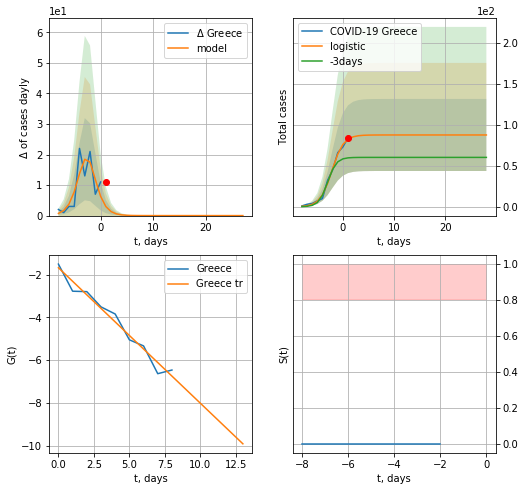

Greece data at: 2020-08-02
+3 day model MAPE: 0.4212876769828872
model: logistic
coeffs:  [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.5018417290456435
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  87 ± 43
	 total death:  3 ± 4
trend coefficient of determination: 0.966991
 intercept: -1.674249
 slope: -0.634181


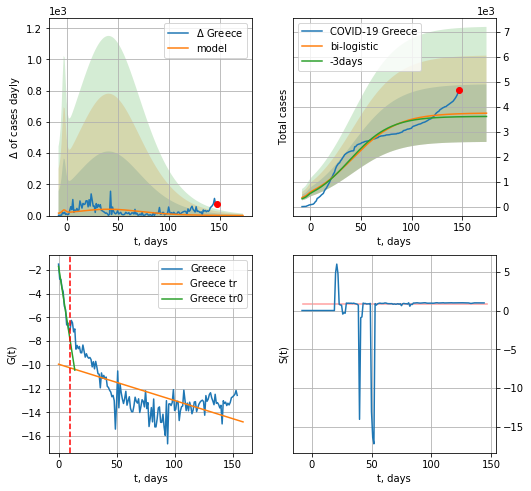

Greece data at: 2020-08-02
+3 day model MAPE: 0.03352396204947563
model: bi-logistic
coeffs:  [3.67064486e+03 4.43454733e-02 4.15663975e+01] [87.54984336  0.87627722 -2.15069813]
rational stdev:  0.3078071823383984
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  3747 ± 1153
	 total death:  167 ± 154
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.974467
 intercept: -1.699561
 slope: -0.624689
trend coefficient of determination: 0.420411
 intercept: -9.948201
 slope: -0.030606


In [4258]:
dfGC = read_df(pd.DataFrame(),"GC")
x = forecast("Greece",dfGC[:10],d1,T18*7-dT)
xx = forecast2("Greece",dfGC[:],d1,T18*7-dT,x,addpred=False,xcoef=[.25/2,1.,2.3],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


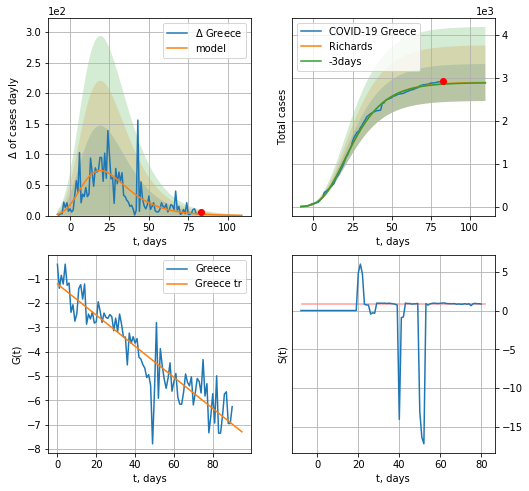

Greece data at: 2020-08-02
+3 day model MAPE: 0.003285
model: Richards
coeffs: [ 2.89327845e+03  7.32645531e+00 -4.72791098e+01  9.49096927e-03]
rational stdev: 0.149150
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2887 ± 430
	 total death: 128 ± 57
trend coefficient of determination: 0.838381
 intercept: -1.223025
 slope: -0.063896


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


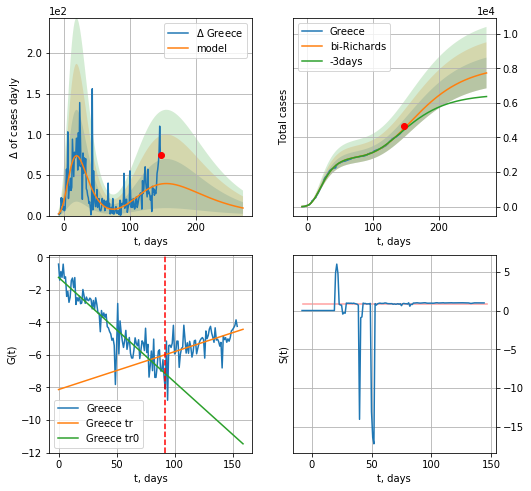

Greece data at: 2020-08-02
+3 day model MAPE: 0.019412
model: bi-Richards
coeffs: [ 5.31475369e+03  1.49459416e+00 -5.63650006e+01  1.35746258e-02]
rational stdev: 0.114849
forecast at the end of period: +125 days
	 deltaDaycases: 9
	 total cases: 7730 ± 887
	 total death: 344 ± 118
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.843993
 intercept: -1.235785
 slope: -0.064315
trend coefficient of determination: 0.259191
 intercept: -8.127606
 slope: 0.023282


In [4259]:
vL = 92
x = forecastRR("Greece",dfGC[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Greece",dfGC[:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


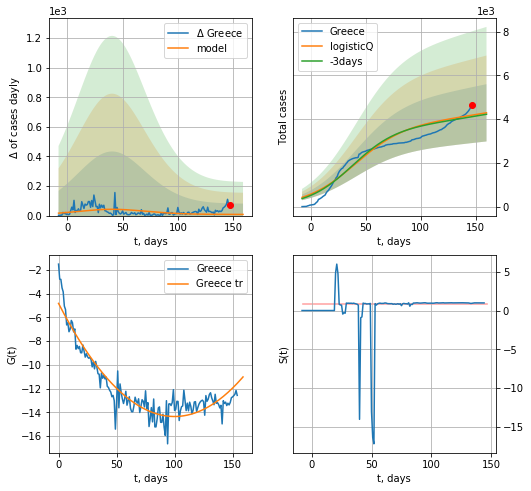

Greece data at: 2020-08-02
+3 day model MAPE: 0.017050
model: logisticQ
coeffs: [ 3.75407500e+03  4.17962865e-08  4.02789557e+01 -1.05301446e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.305171
forecast at the end of period: +13 days
	 deltaDaycases: 7
	 total cases: 4286 ± 1308
	 total death: 191 ± 174
trend coefficient of determination: 0.881734
 intercept_: -4.819489236275976
 coeffs_: [ 0.         -0.19100124  0.00095592]


In [4260]:
x = forecastRRR("Greece",dfGC[:],d1,20*7-dT,addpred=True,xcoef=koreaCoeffs)

HG
           date   cases  active  death
145 2020-07-29  4484.0     542  596.0
146 2020-07-30  4505.0     556  596.0
147 2020-07-31  4526.0     565  597.0
148 2020-08-01  4535.0     549  597.0
149 2020-08-02  4544.0     534  597.0


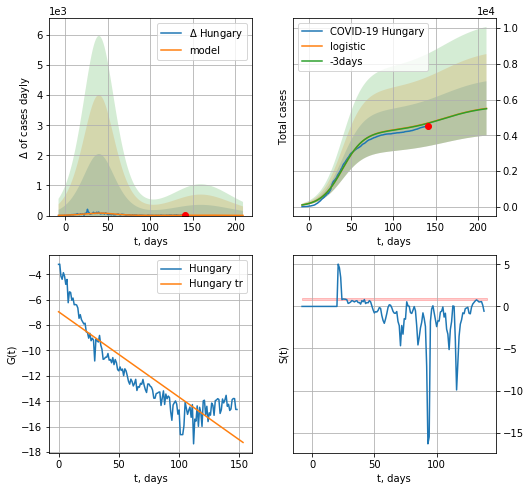

Hungary data at: 2020-08-02
+3 day model MAPE: 0.003124042509718801
model: logistic
coeffs:  [4.21355568e+03 7.82185087e-02 3.99511117e+01]
scenario coeffs:  [0.35, 0.5, 4, 1]
rational stdev:  0.2764456053017889
forecast at the end of period: +69 days
	 deltaDaycases:  6
	 total cases:  5506 ± 1522
	 total death:  723 ± 599
trend coefficient of determination: 0.787714
 intercept: -6.949796
 slope: -0.067257


In [4261]:
dfHG = read_df(pd.DataFrame(),"HG")
try:
    x = forecast("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=[.35,.5,4,1])
except:
    print("Exception occurs")
#xx = forecast2("Hungary",dfHG[:],d1,4*7-dT,x,vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


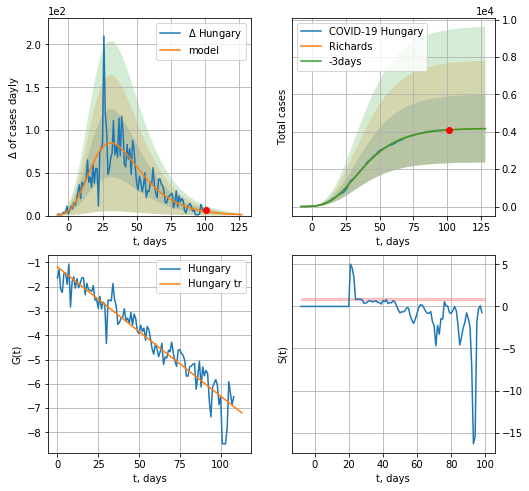

Hungary data at: 2020-08-02
+3 day model MAPE: 0.000504
model: Richards
coeffs: [ 4.19103254e+03  2.98285870e+00 -4.02163545e+01  1.86009647e-02]
rational stdev: 0.434483
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 4171 ± 1812
	 total death: 548 ± 714
trend coefficient of determination: 0.907645
 intercept: -1.183102
 slope: -0.053207


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


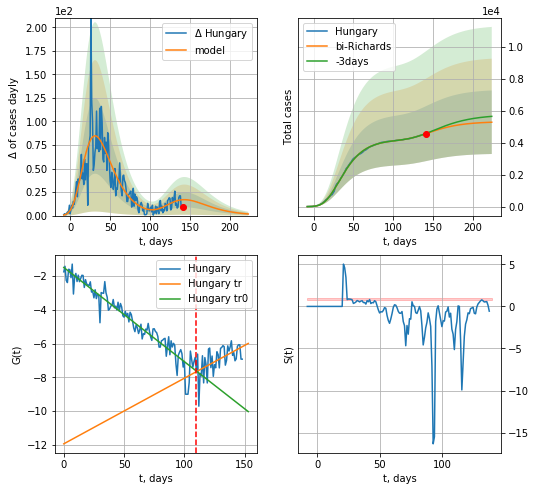

Hungary data at: 2020-08-02
+3 day model MAPE: 0.002930
model: bi-Richards
coeffs: [1.12238458e+03 4.99734077e-01 8.45207487e+01 8.30806990e-02]
rational stdev: 0.376492
forecast at the end of period: +83 days
	 deltaDaycases: 1
	 total cases: 5272 ± 1985
	 total death: 692 ± 781
bi-Richards approximation splitting point: 110
trend coefficient of determination: 0.920042
 intercept: -1.484366
 slope: -0.055886
trend coefficient of determination: 0.308087
 intercept: -11.945418
 slope: 0.038918


In [4262]:
vL = 110
x = forecastRR("Hungary",dfHG[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Hungary",dfHG[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


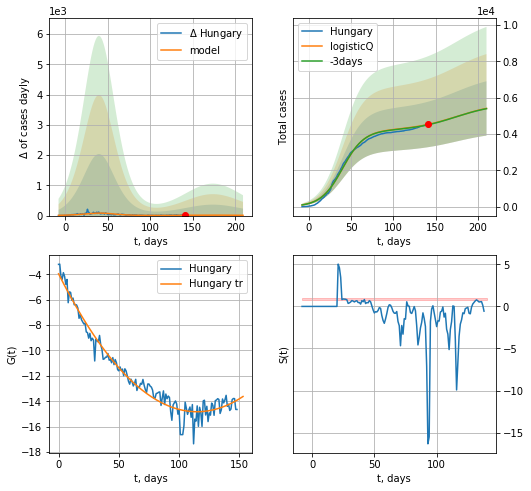

Hungary data at: 2020-08-02
+3 day model MAPE: 0.003660
model: logisticQ
coeffs: [ 4.21352893e+03  1.80694940e-07  3.99514694e+01 -4.32691729e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276524
forecast at the end of period: +69 days
	 deltaDaycases: 9
	 total cases: 5413 ± 1496
	 total death: 711 ± 589
trend coefficient of determination: 0.962612
 intercept_: -3.9628379979078723
 coeffs_: [ 0.         -0.18917526  0.00082378]


In [4263]:
x = forecastRRR("Hungary",dfHG[:],d1,28*7-dT,addpred=True,xcoef=koreaCoeffs,cases='cases')

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:210: RuntimeWarning: divide by zero encountered in true_divide


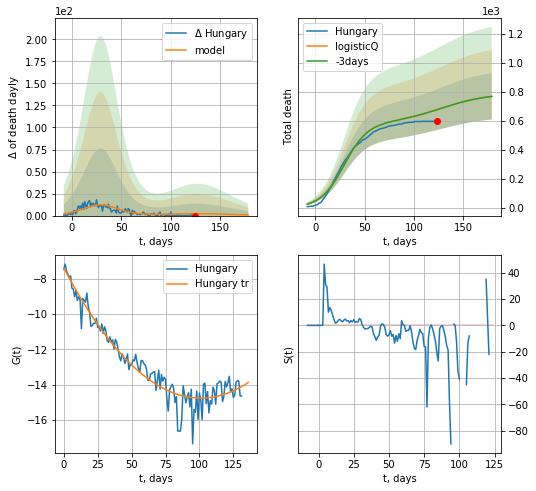

Hungary data at: 2020-08-02
+3 day model MAPE: 0.000742
model: logisticQ
coeffs: [ 5.83357222e+02  2.45233146e-07  2.93266362e+01 -3.41295895e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.207799
forecast at the end of period: +55 days
	 total death: 768 ± 159
trend coefficient of determination: 0.923356
 intercept_: -7.395965962413919
 coeffs_: [ 0.         -0.14585938  0.00072203]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:138: RuntimeWarning: divide by zero encountered in true_divide


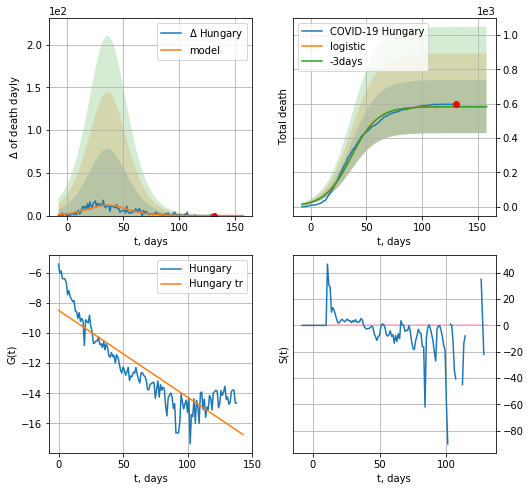

Hungary data at: 2020-08-02
+3 day model MAPE: 0.0015958288786040793
model: logistic
coeffs:  [5.82909222e+02 8.45090747e-02 3.63181073e+01]
rational stdev:  0.2650225909990436
forecast at the end of period: +27 days
	 total death:  582 ± 154
trend coefficient of determination: 0.770188
 intercept: -8.493354
 slope: -0.057628


In [4264]:
x = forecastRRR("Hungary",dfHG[17:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs,cases='death')
x = forecast("Hungary",dfHG[10:],d1,T18*7-dT,cases='death')

MT
           date  cases  active  death
143 2020-07-29  720.0      46    9.0
144 2020-07-30  814.0     140    9.0
145 2020-07-31  824.0     150    9.0
146 2020-08-01  845.0     171    9.0
147 2020-08-02  860.0     185    9.0


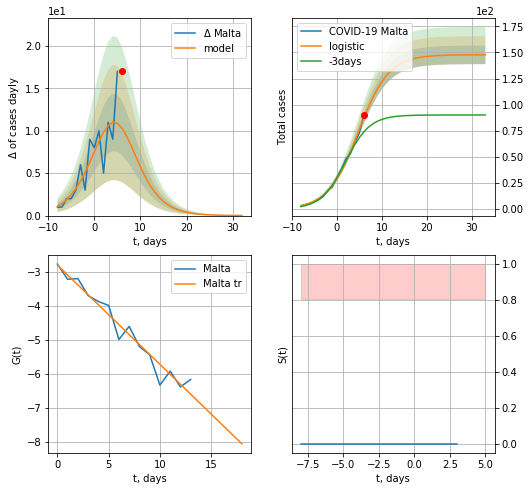

Malta data at: 2020-08-02
model: logistic
coeffs:  [147.79636851   0.29837111   4.7799051 ]
rational stdev:  0.06036954967749919
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  147 ± 8
	 total death:  1 ± 0
trend coefficient of determination: 0.952854
 intercept: -2.800130
 slope: -0.292111


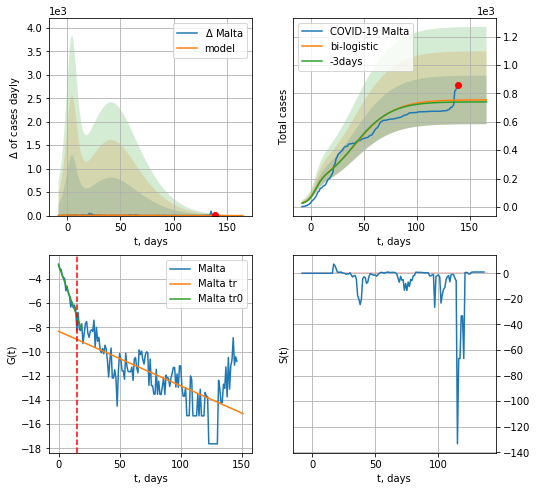

Malta data at: 2020-08-02
+3 day model MAPE: 0.018647697284037014
model: bi-logistic
coeffs:  [5.39433324e+02 6.22224217e-02 4.04787909e+01] [147.79636851   0.29837111   4.7799051 ]
scenario coeffs:  [0.125, 1.0, 1.8]
rational stdev:  0.2269347361688908
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  754 ± 171
	 total death:  7 ± 4
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.954424
 intercept: -2.840997
 slope: -0.282680
trend coefficient of determination: 0.481565
 intercept: -8.327077
 slope: -0.045085


In [4265]:
try:
    dfMT = read_df(pd.DataFrame(),"MT")
    x = forecast("Malta",dfMT[:15],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Malta",dfMT[:],d1,7*T18-dT,x,vL=15,addpred=True,xcoef=[0.25/2,1.,1.8])
except:
    print("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


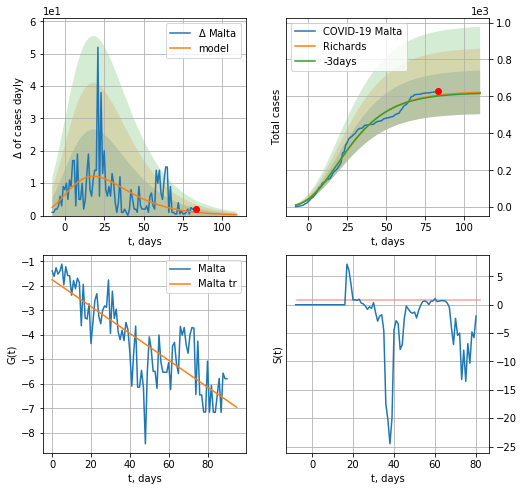

Malta data at: 2020-08-02
+3 day model MAPE: 0.008009
model: Richards
coeffs: [ 6.26878696e+02  8.49160578e+00 -7.74672002e+01  6.22612118e-03]
rational stdev: 0.190000
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 621 ± 118
	 total death: 6 ± 3
trend coefficient of determination: 0.667134
 intercept: -1.754249
 slope: -0.054731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


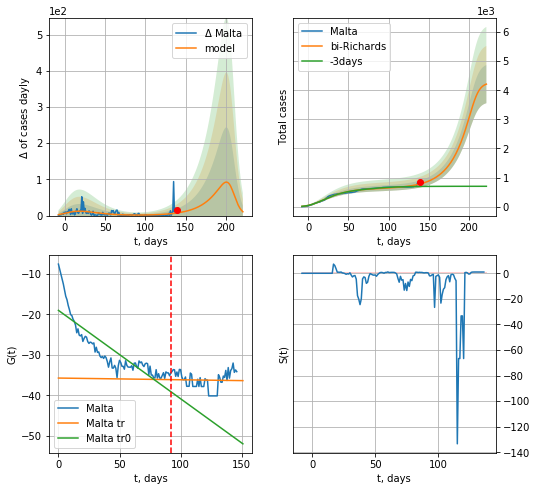

Malta data at: 2020-08-02
+3 day model MAPE: 0.130176
model: bi-Richards
coeffs: [3.63137954e+03 4.56781064e-02 2.08320845e+02 4.45200688e+00]
rational stdev: 0.155648
forecast at the end of period: +83 days
	 deltaDaycases: 10
	 total cases: 4209 ± 655
	 total death: 44 ± 20
bi-Richards approximation splitting point: 92
trend coefficient of determination: 0.738161
 intercept: -18.983191
 slope: -0.218334
trend coefficient of determination: 0.000938
 intercept: -35.707646
 slope: -0.004207


In [4271]:
vL = 92
x = forecastRR("Malta",dfMT[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Malta",dfMT[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


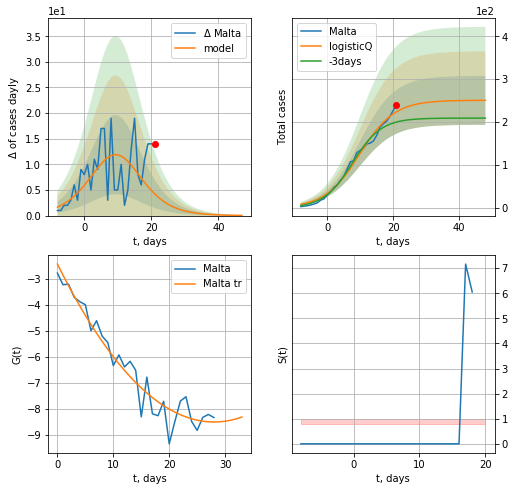

Malta data at: 2020-08-02
+3 day model MAPE: 0.130140
model: logisticQ
coeffs: [ 2.50920106e+02  3.54280992e-06  9.84691106e+00 -5.35760827e+04]
rational stdev: 0.227623
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 250 ± 57
	 total death: 2 ± 1
trend coefficient of determination: 0.935484
 intercept_: -2.4264251666881744
 coeffs_: [ 0.         -0.43368994  0.00773877]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


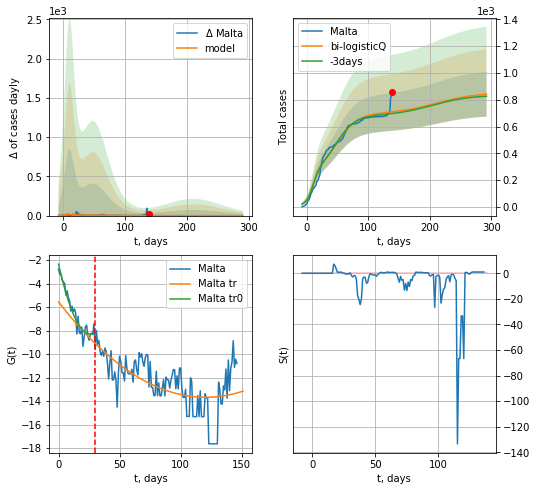

Malta data at: 2020-08-02
+3 day model MAPE: 0.018245
model: bi-logisticQ
coeffs: [ 4.44828888e+02  1.03590683e-07  4.83294587e+01 -5.81774325e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.198915
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 840 ± 167
	 total death: 8 ± 4
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.928360
 intercept_: -2.3445378489560733
 coeffs_: [ 0.         -0.45826686  0.00882824]
trend coefficient of determination: 0.385311
 intercept_: -5.5606223102298635
 coeffs_: [ 0.         -0.13474512  0.00055944]


In [4272]:
x = forecastRRR("Malta",dfMT[:30],d1,T18*7-dT,addpred=False,xcoef=[0.35/4,.5,3,1.])
xx = forecast2RRR("Malta",dfMT[:],d1,40*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=30)

SL
           date   cases  active  death
141 2020-07-29  2265.0   562.0   28.0
142 2020-07-30  2292.0   568.0   29.0
143 2020-07-31  2337.0   566.0   29.0
144 2020-08-01  2345.0   566.0   29.0
145 2020-08-02  2354.0   579.0   29.0


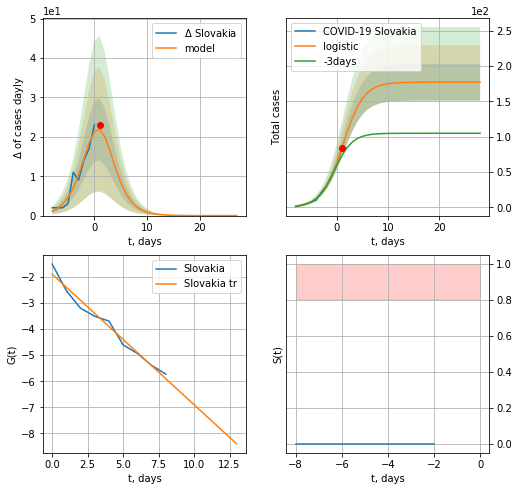

Slovakia data at: 2020-08-02
model: logistic
coeffs:  [177.28786061   0.49967231   1.23158076]
rational stdev:  0.14723855931524674
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  177 ± 26
	 total death:  2 ± 0
trend coefficient of determination: 0.974721
 intercept: -1.894823
 slope: -0.500610


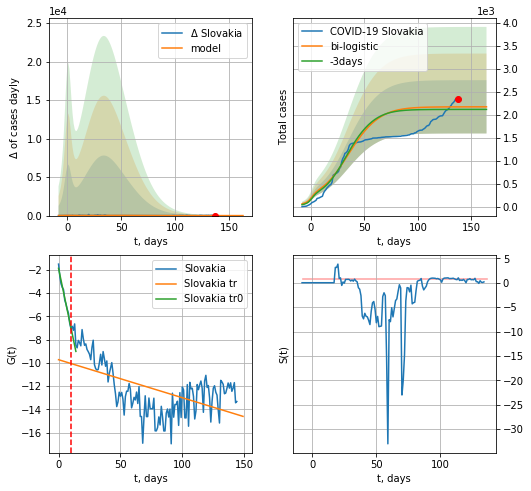

Slovakia data at: 2020-08-02
+3 day model MAPE: 0.026299572754880412
model: bi-logistic
coeffs:  [1.59764976e+03 8.19932158e-02 3.21956325e+01] [177.28786061   0.49967231   1.23158076]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.26686076717411844
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  2174 ± 580
	 total death:  26 ± 20
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.981202
 intercept: -1.868036
 slope: -0.510655
trend coefficient of determination: 0.315239
 intercept: -9.731589
 slope: -0.032742


In [4275]:
dfSL = read_df(pd.DataFrame(),"SL")
dfSL = dfSL.fillna(0)
try:
    x = forecast("Slovakia",dfSL[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Slovakia",dfSL[:],d1,22*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=10)
except:
    print("Exception ocurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


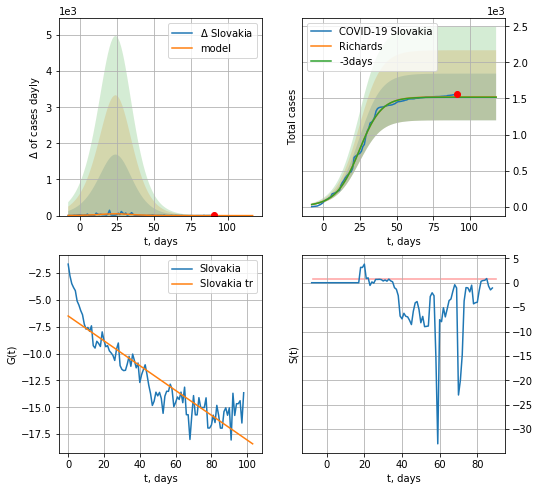

Slovakia data at: 2020-08-02
+3 day model MAPE: 0.002372
model: Richards
coeffs: [1.52109568e+03 1.16938732e-01 2.55808264e+01 1.14750291e+00]
rational stdev: 0.212800
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1521 ± 323
	 total death: 18 ± 11
trend coefficient of determination: 0.817560
 intercept: -6.499033
 slope: -0.115624


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


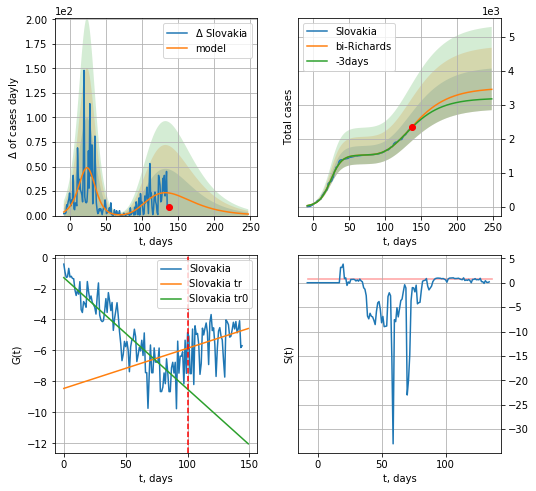

Slovakia data at: 2020-08-02
+3 day model MAPE: 0.010399
model: bi-Richards
coeffs: [1.98427751e+03 1.89954260e+00 6.55433196e+00 1.69742211e-02]
rational stdev: 0.177439
forecast at the end of period: +111 days
	 deltaDaycases: 1
	 total cases: 3457 ± 613
	 total death: 42 ± 22
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.797516
 intercept: -1.299951
 slope: -0.072010
trend coefficient of determination: 0.082588
 intercept: -8.451975
 slope: 0.025967


In [4276]:
vL = 100
x = forecastRR("Slovakia",dfSL[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovakia",dfSL[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


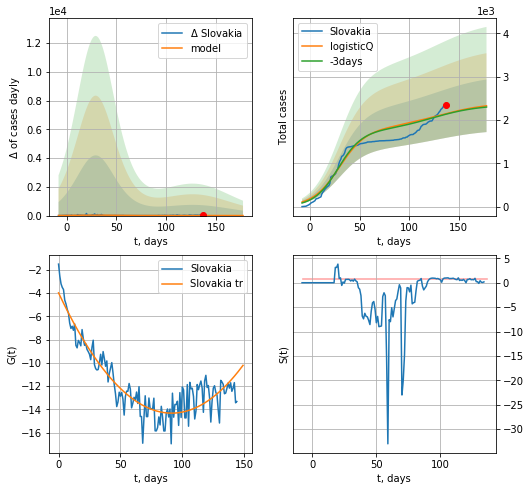

Slovakia data at: 2020-08-02
+3 day model MAPE: 0.006372
model: logisticQ
coeffs: [ 1.78314468e+03  5.12755742e-08  2.94744955e+01 -1.45579472e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.260717
forecast at the end of period: +41 days
	 deltaDaycases: 2
	 total cases: 2329 ± 607
	 total death: 28 ± 21
trend coefficient of determination: 0.854285
 intercept_: -3.9785667260725877
 coeffs_: [ 0.        -0.2266068  0.0012398]


In [4277]:
x = forecastRRR("Slovakia",dfSL[:],d1,24*7-dT,addpred=True,xcoef=koreaCoeffs)

SV
           date   cases  active  death
146 2020-07-29  2139.0   242.0  117.0
147 2020-07-30  2156.0   240.0  119.0
148 2020-07-31  2171.0   231.0  119.0
149 2020-08-01  2180.0   234.0  120.0
150 2020-08-02  2180.0   234.0  120.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


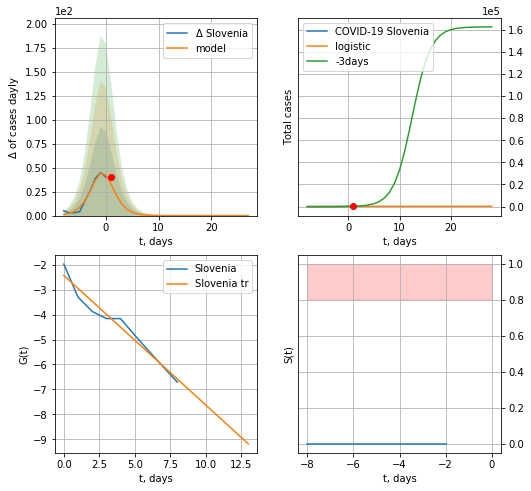

Slovenia data at: 2020-08-02
model: logistic
coeffs:  [ 2.61098711e+02  6.91755378e-01 -2.00021247e-01]
rational stdev:  0.5312441686508605
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  261 ± 138
	 total death:  14 ± 22
trend coefficient of determination: 0.958485
 intercept: -2.427236
 slope: -0.519636
Exception occurs


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:485: RuntimeWarning: divide by zero encountered in log


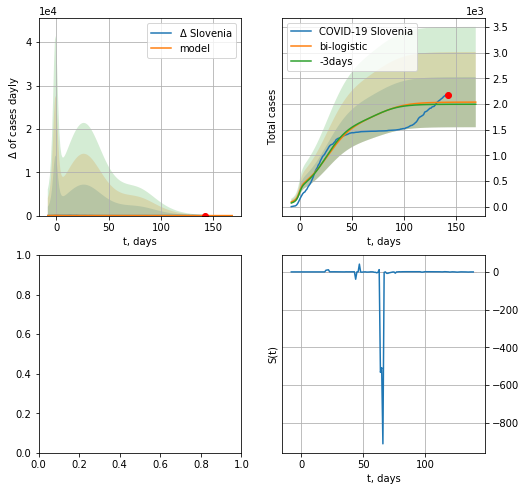

In [4278]:
dfSV = read_df(pd.DataFrame(),"SV").fillna(0)
try:
    x = forecast("Slovenia",dfSV[:10],d1,7*T18-dT,pMAPE=False)
    xx = forecast2("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,3.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


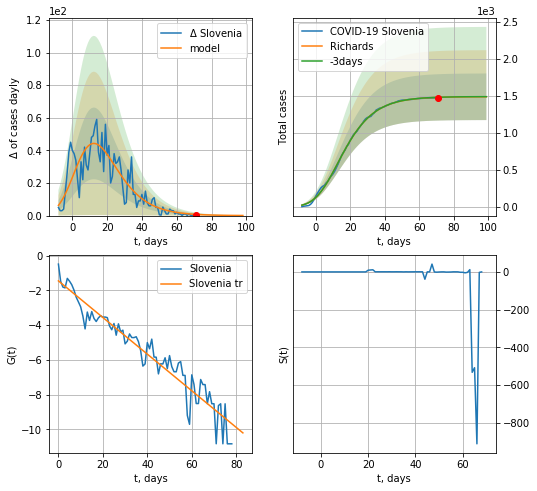

Slovenia data at: 2020-08-01
+3 day model MAPE: 0.001063
model: Richards
coeffs: [ 1.48543612e+03  5.20176508e-01 -7.42026148e+00  1.68829761e-01]
rational stdev: 0.211962
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1484 ± 314
	 total death: 81 ± 51
trend coefficient of determination: 0.919511
 intercept: -1.449330
 slope: -0.105393


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


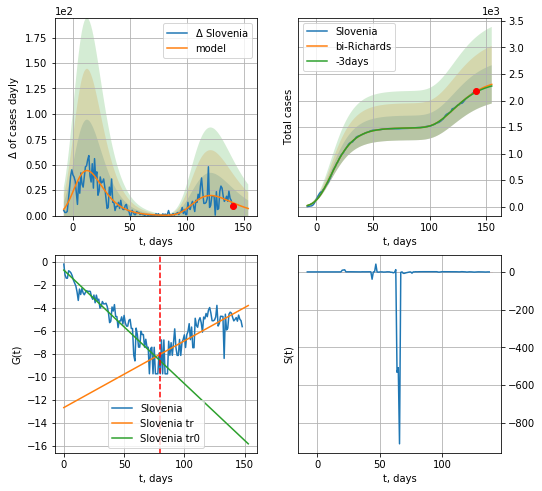

Slovenia data at: 2020-08-01
+3 day model MAPE: 0.006854
model: bi-Richards
coeffs: [9.46390977e+02 2.85236135e+00 5.30571518e+01 2.00721511e-02]
rational stdev: 0.156660
forecast at the end of period: +14 days
	 deltaDaycases: 6
	 total cases: 2303 ± 360
	 total death: 126 ± 59
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.910072
 intercept: -0.737650
 slope: -0.098568
trend coefficient of determination: 0.551533
 intercept: -12.672757
 slope: 0.057900


In [3899]:
vL = 80
x = forecastRR("Slovenia",dfSV[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Slovenia",dfSV[:],d1,20*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

[0.35416971, 0.02606324, 4.35859408, 19.30413219]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


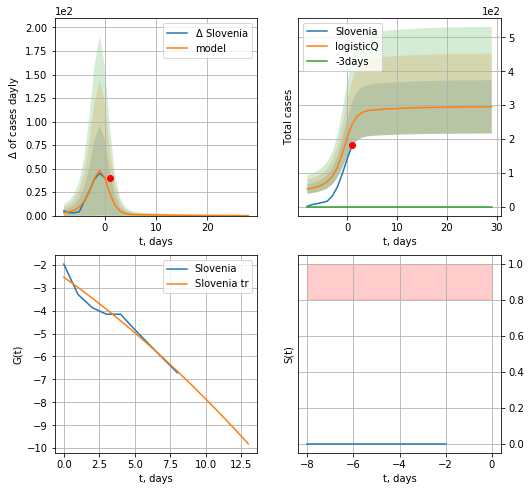

Slovenia data at: 2020-08-01
+3 day model MAPE: inf
model: logisticQ
coeffs: [ 2.17965797e+02  4.01733259e-02 -2.21208421e+01 -7.00287218e-01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.266979
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 294 ± 78
	 total death: 16 ± 12
trend coefficient of determination: 0.956027
 intercept_: -2.543480478113449
 coeffs_: [ 0.         -0.43771568 -0.00932819]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:234: RuntimeWarning: divide by zero encountered in double_scalars
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


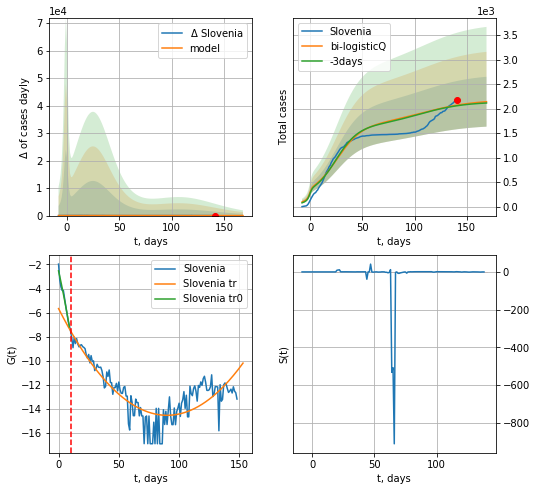

Slovenia data at: 2020-08-01
+3 day model MAPE: 0.006282
model: bi-logisticQ
coeffs: [ 1.44842293e+03  4.60958025e-08  2.50546184e+01 -1.79979482e+06]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.237609
forecast at the end of period: +28 days
	 deltaDaycases: 1
	 total cases: 2140 ± 508
	 total death: 117 ± 83
bi-logisticQ approximation splitting point: 10
trend coefficient of determination: 0.968209
 intercept_: -2.53431844604435
 coeffs_: [ 0.         -0.45029183 -0.00732028]
trend coefficient of determination: 0.725610
 intercept_: -5.666493537264486
 coeffs_: [ 0.         -0.19683488  0.0010932 ]


In [3900]:
print(koreaCoeffs)
x = forecastRRR("Slovenia",dfSV[:10],d1,T18*7-dT,addpred=True,xcoef=koreaCoeffs)
xx = forecast2RRR("Slovenia",dfSV[:],d1,T18*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=10)

SB
           date  cases   active  death
141 2020-07-29  24892  10287.0  558.0
142 2020-07-30  25213  10601.0  565.0
143 2020-07-31  25552  10932.0  573.0
144 2020-08-01  25882  11253.0  582.0
145 2020-08-02  26193  11556.0  590.0


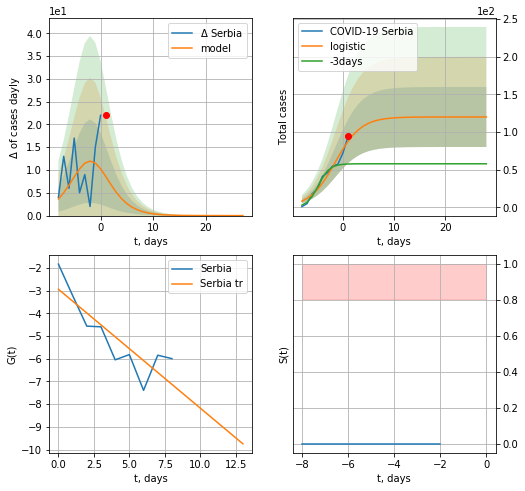

Serbia data at: 2020-08-02
model: logistic
coeffs:  [119.86808879   0.40041875  -1.48148474]
rational stdev:  0.33210329199703215
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  119 ± 39
	 total death:  2 ± 1
trend coefficient of determination: 0.723021
 intercept: -2.939233
 slope: -0.523684


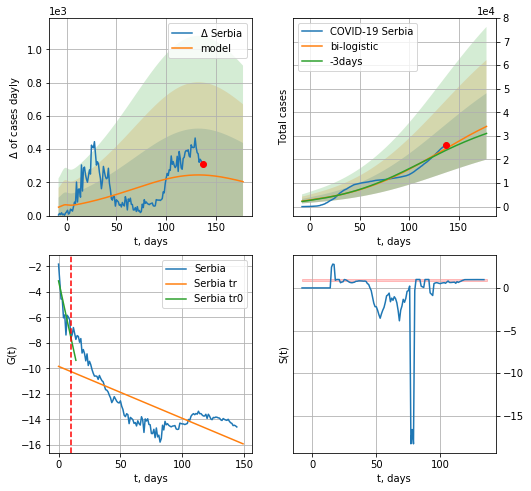

Serbia data at: 2020-08-02
+3 day model MAPE: 0.03411031663903788
model: bi-logistic
coeffs:  [4.45860094e+04 2.12067225e-02 1.29513986e+02] [119.86808879   0.40041875  -1.48148474]
scenario coeffs:  [0.25, 1.0, 2.2]
rational stdev:  0.41368301391980783
forecast at the end of period: +41 days
	 deltaDaycases:  204
	 total cases:  34006 ± 14067
	 total death:  766 ± 950
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.680312
 intercept: -3.149496
 slope: -0.444835
trend coefficient of determination: 0.550245
 intercept: -9.854200
 slope: -0.040770


In [4279]:
dfSB = read_df(pd.DataFrame(),"SB")
dfSB = dfSB.fillna(0)
x = forecast("Serbia",dfSB[:10],d1,T18*7-dT,pMAPE=False)
xx = forecast2("Serbia",dfSB[:],d1,24*7-dT,x,addpred=True,xcoef=[0.25,1.,2.2],vL=10)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


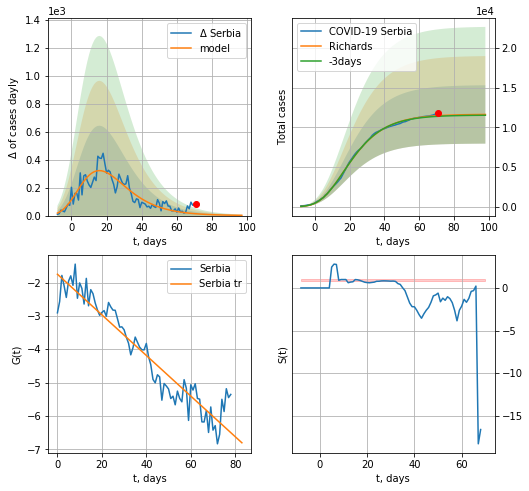

Serbia data at: 2020-08-02
+3 day model MAPE: 0.006988
model: Richards
coeffs: [ 1.16624341e+04  1.86550219e+00 -2.54632436e+01  4.09637438e-02]
rational stdev: 0.315870
forecast at the end of period: +27 days
	 deltaDaycases: 1
	 total cases: 11639 ± 3676
	 total death: 262 ± 248
trend coefficient of determination: 0.902509
 intercept: -1.751737
 slope: -0.060887


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


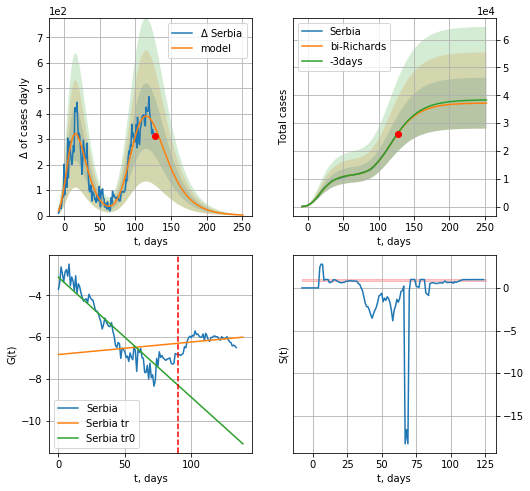

Serbia data at: 2020-08-02
+3 day model MAPE: 0.002880
model: bi-Richards
coeffs: [2.55775720e+04 2.24429409e-01 8.07380998e+01 2.03534469e-01]
rational stdev: 0.245465
forecast at the end of period: +125 days
	 deltaDaycases: 2
	 total cases: 37189 ± 9128
	 total death: 837 ± 616
bi-Richards approximation splitting point: 90
trend coefficient of determination: 0.860089
 intercept: -3.134417
 slope: -0.057418
trend coefficient of determination: 0.067760
 intercept: -6.836966
 slope: 0.005988


In [4280]:
iL=10
vL=90+iL
x = forecastRR("Serbia",dfSB[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Serbia",dfSB[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


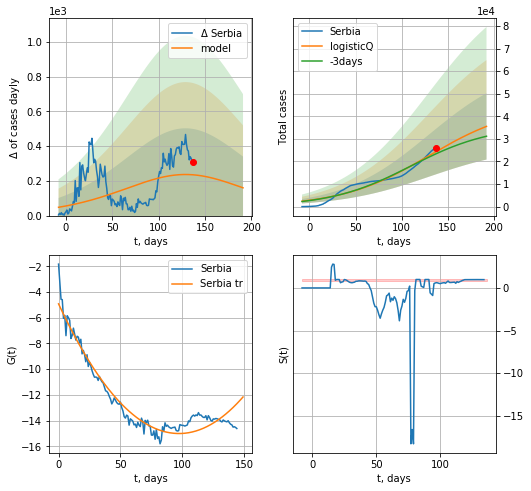

Serbia data at: 2020-08-02
+3 day model MAPE: 0.043251
model: logisticQ
coeffs: [ 4.45896716e+04  1.20539186e-07  1.29069048e+02 -1.74740803e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.413422
forecast at the end of period: +55 days
	 deltaDaycases: 159
	 total cases: 35546 ± 14695
	 total death: 800 ± 992
trend coefficient of determination: 0.937932
 intercept_: -4.922611316176552
 coeffs_: [ 0.         -0.2070472   0.00106363]


In [4281]:
x = forecastRRR("Serbia",dfSB[:],d1,26*7-dT,addpred=True,xcoef=koreaCoeffs)

CT
           date   cases  active  death
151 2020-07-29  4993.0   753.0  141.0
152 2020-07-30  5071.0   749.0  144.0
153 2020-07-31  5139.0   727.0  145.0
154 2020-08-01  5224.0   738.0  145.0
155 2020-08-02  5260.0   738.0  149.0


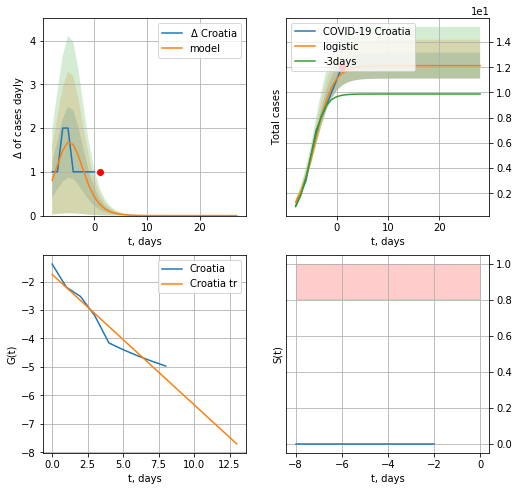

Croatia data at: 2020-08-02
model: logistic
coeffs:  [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.08430442468045289
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  12 ± 1
	 total death:  0 ± 0
trend coefficient of determination: 0.936719
 intercept: -1.749041
 slope: -0.458074


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


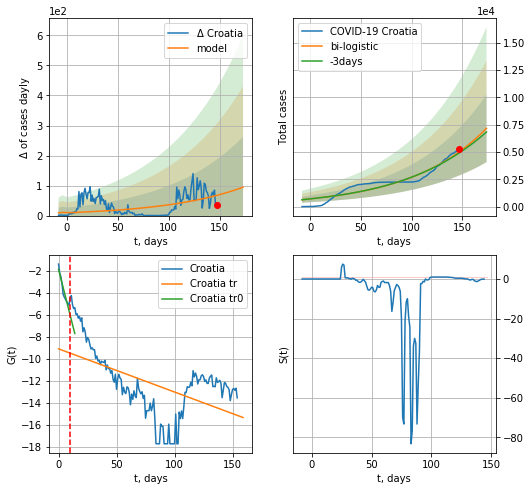

Croatia data at: 2020-08-02
+3 day model MAPE: 0.021608129869921076
model: bi-logistic
coeffs:  [1.41401389e+06 1.33544818e-02 5.69378317e+02] [12.13023855  0.55939634 -4.20963748]
rational stdev:  0.431667441884502
forecast at the end of period: +27 days
	 deltaDaycases:  94
	 total cases:  7175 ± 3097
	 total death:  203 ± 262
bi-logistic approximation splitting point: 10
trend0 coefficient of determination: 0.922384
 intercept: -1.856940
 slope: -0.417612
trend coefficient of determination: 0.289408
 intercept: -9.095293
 slope: -0.039306


In [4282]:
try:
    dfCT = read_df(pd.DataFrame(),"CT")
    dfCT = dfCT.fillna(0)
    x = forecast("Croatia",dfCT[:10],d1,T18*7-dT,pMAPE=False)
    xx = forecast2("Croatia",dfCT[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25/2,1.,2.],vL=10)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


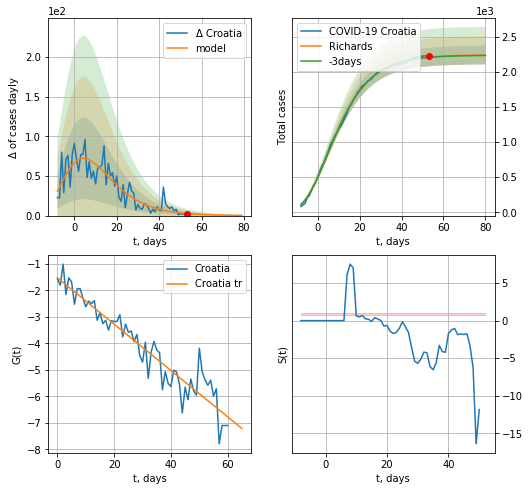

Croatia data at: 2020-08-02
+3 day model MAPE: 0.002310
model: Richards
coeffs: [ 2.23963098e+03  7.95198453e+00 -4.62549964e+01  1.10913889e-02]
rational stdev: 0.059687
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 2236 ± 133
	 total death: 63 ± 11
trend coefficient of determination: 0.897394
 intercept: -1.522030
 slope: -0.087533


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


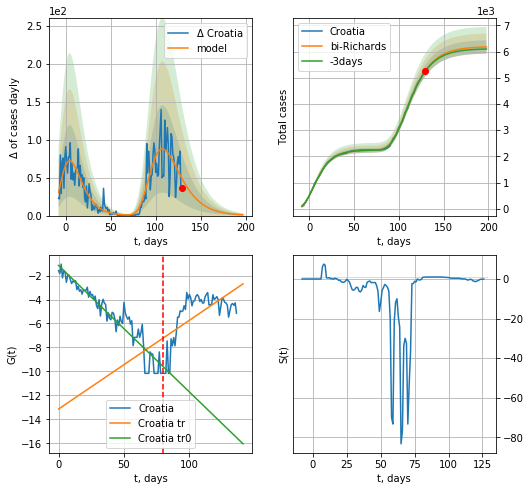

Croatia data at: 2020-08-02
+3 day model MAPE: 0.004478
model: bi-Richards
coeffs: [3.95488884e+03 3.27546829e+00 4.25980341e+01 1.86116687e-02]
rational stdev: 0.041228
forecast at the end of period: +69 days
	 deltaDaycases: 1
	 total cases: 6178 ± 254
	 total death: 175 ± 21
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.903176
 intercept: -1.156174
 slope: -0.105574
trend coefficient of determination: 0.414054
 intercept: -13.140872
 slope: 0.074090


In [4283]:
iL = 18
vL = 80+iL
x = forecastRR("Croatia",dfCT[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Croatia",dfCT[iL:],d1,28*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


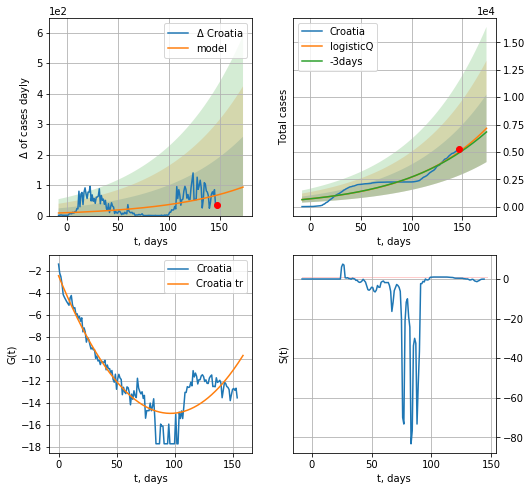

Croatia data at: 2020-08-02
+3 day model MAPE: 0.020923
model: logisticQ
coeffs: [ 2.59986293e+05  7.18262742e-07  4.34213861e+02 -1.88986887e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.431593
forecast at the end of period: +27 days
	 deltaDaycases: 93
	 total cases: 7157 ± 3088
	 total death: 202 ± 261
trend coefficient of determination: 0.849638
 intercept_: -2.447607781718979
 coeffs_: [ 0.        -0.25967    0.0013463]


In [4284]:
x = forecastRRR("Croatia",dfCT[:],d1,22*7-dT,addpred=True,xcoef=koreaCoeffs)

EG
           date  cases  active   death
145 2020-07-29  93356   51603  4728.0
146 2020-07-30  93757   50747  4774.0
147 2020-07-31  94078   49635  4805.0
148 2020-08-01  94316   48345  4834.0
149 2020-08-02  94483   47163  4865.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


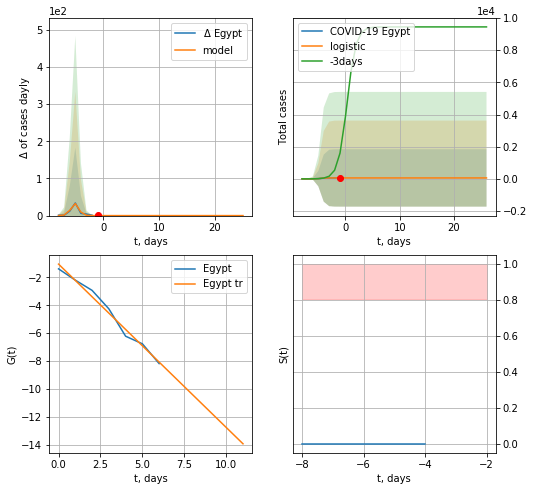

Egypt data at: 2020-08-02
+3 day model MAPE: 0.9848539099062313
model: logistic
coeffs:  [58.57021122  2.53530653 -4.60228222]
rational stdev:  30.428321363178444
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  58 ± 1782
	 total death:  3 ± 273
trend coefficient of determination: 0.982412
 intercept: -1.045837
 slope: -1.172929


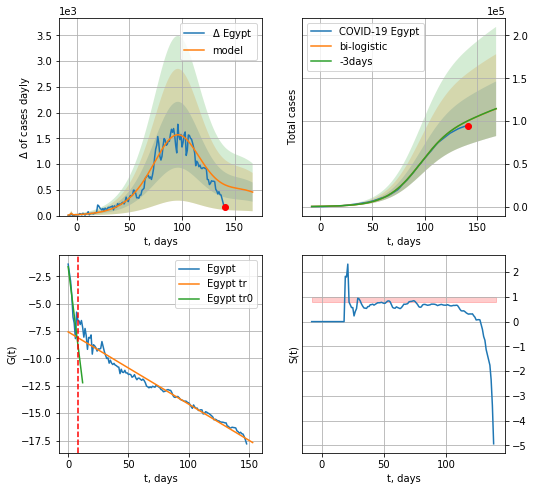

Egypt data at: 2020-08-02
+3 day model MAPE: 0.0010334427985784235
model: bi-logistic
coeffs:  [1.01032604e+05 6.11943253e-02 9.60487647e+01] [58.57021122  2.53530653 -4.60228222]
scenario coeffs:  [0.25, 1.0, 1.7]
rational stdev:  0.27896279897043913
forecast at the end of period: +27 days
	 deltaDaycases:  456
	 total cases:  114308 ± 31887
	 total death:  5885 ± 4925
bi-logistic approximation splitting point: 8
trend0 coefficient of determination: 0.807637
 intercept: -1.627174
 slope: -0.882261
trend coefficient of determination: 0.971137
 intercept: -7.571757
 slope: -0.066044


In [4285]:
dfEG = read_df(pd.DataFrame(),"EG")
x = forecast("Egypt",dfEG[:8],d1,7*T18-dT)
xx = forecast2("Egypt",dfEG[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.7],vL=8)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


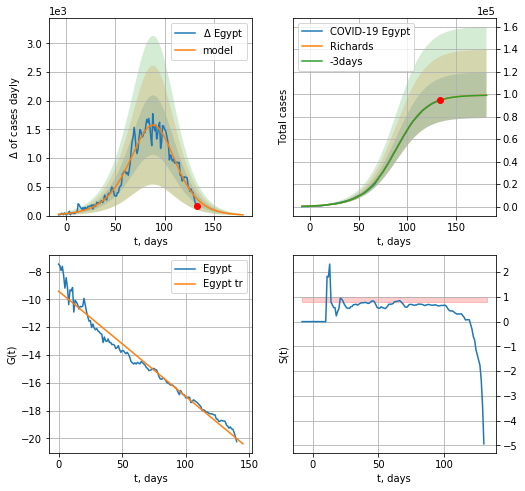

Egypt data at: 2020-08-02
+3 day model MAPE: 0.000588
model: Richards
coeffs: [9.92084727e+04 5.58030340e-02 9.16145430e+01 1.21243676e+00]
rational stdev: 0.204230
forecast at the end of period: +48 days
	 deltaDaycases: 13
	 total cases: 99015 ± 20221
	 total death: 5098 ± 3123
trend coefficient of determination: 0.970114
 intercept: -9.405426
 slope: -0.075715


In [4286]:
x = forecastRR("Egypt",dfEG[8:],d1,25*7-dT,addpred=False,xcoef=RkoreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp


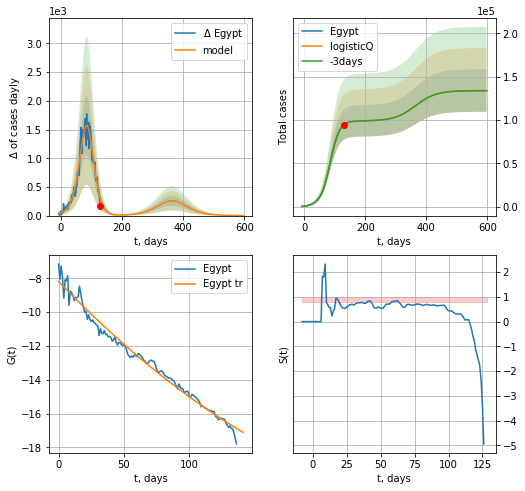

Egypt data at: 2020-08-02
+3 day model MAPE: 0.000488
model: logisticQ
coeffs: [ 9.89925698e+04  7.45624432e-05  8.34523697e+01 -7.68291439e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.182748
forecast at the end of period: +468 days
	 deltaDaycases: 0
	 total cases: 134020 ± 24492
	 total death: 6900 ± 3782
trend coefficient of determination: 0.983086
 intercept_: -8.181042758595716
 coeffs_: [ 0.         -0.08041735  0.00012091]


In [4287]:
x = forecastRRR("Egypt",dfEG[12:],d1,85*7-dT,addpred=True,xcoef=koreaCoeffs)

IQ
           date   cases   active   death
148 2020-07-29  118300  30236.0  4603.0
149 2020-07-30  121263  31046.0  4671.0
150 2020-07-31  124609  32434.0  4741.0
151 2020-08-01  126704  32624.0  4805.0
152 2020-08-02  129151  32397.0  4868.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


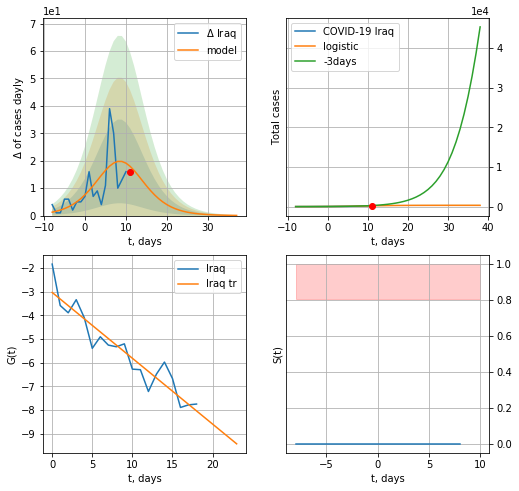

Iraq data at: 2020-08-02
+3 day model MAPE: 0.34474037669474106
model: logistic
coeffs:  [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.20777406895257303
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  316 ± 65
	 total death:  11 ± 6
trend coefficient of determination: 0.889033
 intercept: -3.031672
 slope: -0.278416


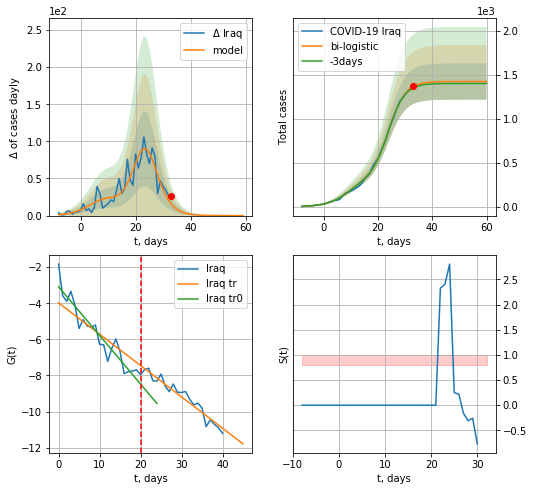

Iraq data at: 2020-08-02
+3 day model MAPE: 0.012548655608678476
model: bi-logistic
coeffs:  [1.10877596e+03 3.20225975e-01 2.39035989e+01] [3.17081296e+02 2.50431387e-01 8.98163530e+00]
rational stdev:  0.14537179336300032
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1425 ± 207
	 total death:  53 ± 23
bi-logistic approximation splitting point: 20
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend coefficient of determination: 0.928562
 intercept: -3.976586
 slope: -0.173518


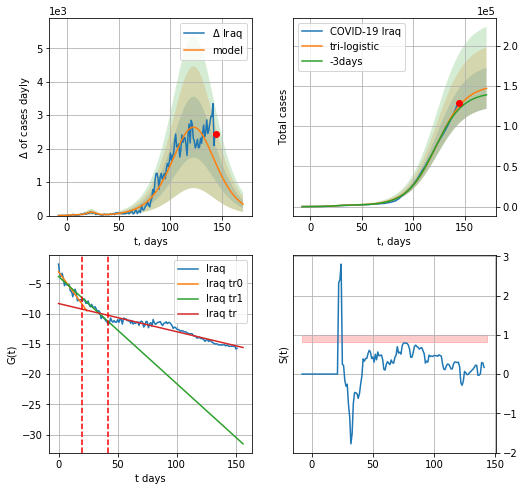

Iraq data at: 2020-08-02
+3 day model MAPE: 0.03080628059274688
model: tri-logistic
coeffs:  [1.50235264e+05 7.03627758e-02 1.22696952e+02] [3.17081296e+02 2.50431387e-01 8.98163530e+00 1.10877596e+03
 3.20225975e-01 2.39035989e+01]
forecast rational stdev:  0.17322967546386397
forecast at the end of period: +27 days
	 deltaDaycases:  341
	 total cases:  146803 ± 25430
	 total death:  5533 ± 2875
tri-logistic approximation splitting points: 20,42
trend0 coefficient of determination: 0.891989
 intercept: -3.086027
 slope: -0.269357
trend1 coefficient of determination: 0.937217
 intercept: -3.879636
 slope: -0.177153
trend coefficient of determination: 0.884921
 intercept: -8.343024
 slope: -0.046554


In [4288]:
vL=20
vL1=42
dfIQ = read_df(pd.DataFrame(),"IQ")
dfIQ = dfIQ.fillna(0)
x = forecast("Iraq",dfIQ[:vL],d1,T18*7-dT)
xx = forecast2("Iraq",dfIQ[:vL1],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.],vL=vL)
xx = np.concatenate((x, xx), axis=0)
xxx = forecast3("Iraq",dfIQ[:],d1,T18*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


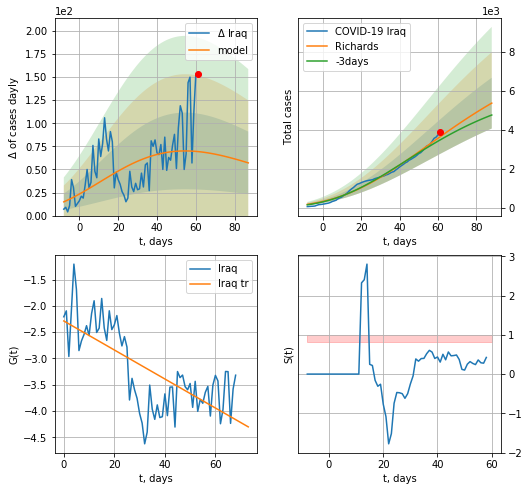

Iraq data at: 2020-08-02
+3 day model MAPE: 0.049876
model: Richards
coeffs: [ 8.66913850e+03  2.11659471e+00 -1.51652885e+02  1.04324891e-02]
rational stdev: 0.242987
forecast at the end of period: +27 days
	 deltaDaycases: 57
	 total cases: 5358 ± 1301
	 total death: 201 ± 146
trend coefficient of determination: 0.498225
 intercept: -2.287589
 slope: -0.027573


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


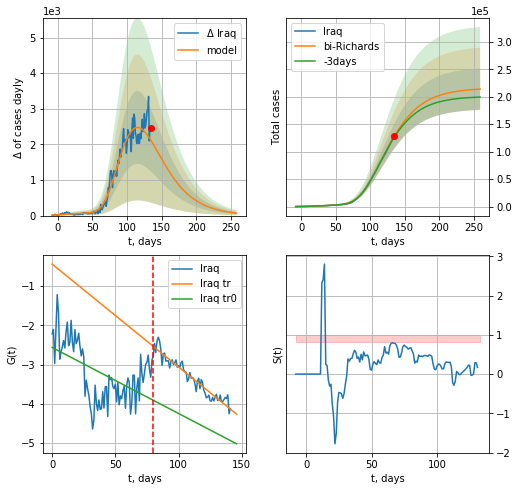

Iraq data at: 2020-08-02
+3 day model MAPE: 0.016547
model: bi-Richards
coeffs: [ 2.07323119e+05  2.45546369e+00 -1.91610127e+01  1.30965302e-02]
rational stdev: 0.176425
forecast at the end of period: +125 days
	 deltaDaycases: 68
	 total cases: 213843 ± 37727
	 total death: 8060 ± 4265
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.278196
 intercept: -2.566532
 slope: -0.016802
trend coefficient of determination: 0.918115
 intercept: -0.443741
 slope: -0.026178


In [4289]:
iL = 10
vL=80+iL#25+10
x = forecastRR("Iraq",dfIQ[iL:vL-iL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Iraq",dfIQ[iL:],d1,36*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

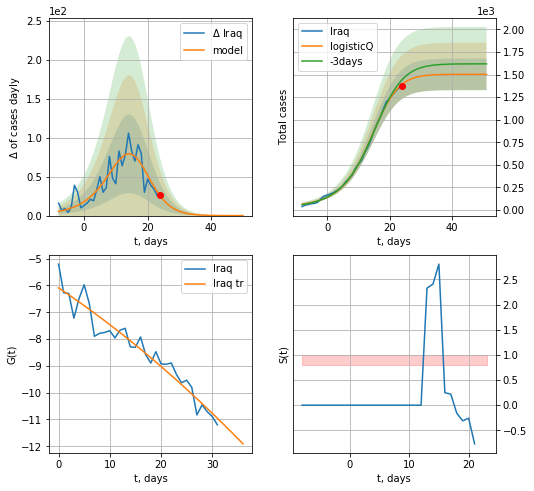

Iraq data at: 2020-08-02
+3 day model MAPE: 0.041008
model: logisticQ
coeffs: [ 1.50291917e+03  2.94853842e-03  1.34415511e+01 -5.72228370e+01]
rational stdev: 0.116469
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 1502 ± 175
	 total death: 56 ± 19
trend coefficient of determination: 0.930646
 intercept_: -6.090644942877015
 coeffs_: [ 0.         -0.12791486 -0.00093535]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


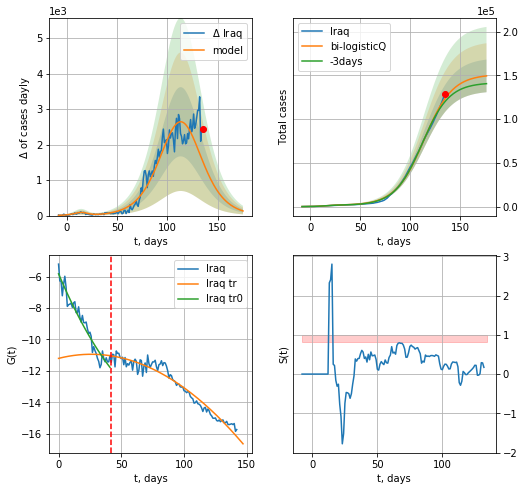

Iraq data at: 2020-08-02
+3 day model MAPE: 0.031054
model: bi-logisticQ
coeffs: [ 1.49806397e+05  1.01925764e-06  1.13638341e+02 -6.91594690e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.124906
forecast at the end of period: +41 days
	 deltaDaycases: 130
	 total cases: 149505 ± 18674
	 total death: 5635 ± 2111
bi-logisticQ approximation splitting point: 42
trend coefficient of determination: 0.941003
 intercept_: -5.824005146615983
 coeffs_: [ 0.         -0.18682641  0.00101526]
trend coefficient of determination: 0.949212
 intercept_: -11.205416744754476
 coeffs_: [ 0.          0.02017048 -0.00038884]


In [4290]:
x = forecastRRR("Iraq",dfIQ[9:42],d1,T18*7-dT,addpred=False,xcoef=[0.35,.5,4.,1])
xx = forecast2RRR("Iraq",dfIQ[9:],d1,24*7-dT,x,addpred=True,xcoef=koreaCoeffs,vL=42)

In [4291]:
#len(dfAR)

AR
           date    cases  active   death
147 2020-07-29  29229.0  8451.0  1186.0
148 2020-07-30  29831.0  8549.0  1200.0
149 2020-07-31  30394.0  8647.0  1210.0
150 2020-08-01  30950.0  8739.0  1223.0
151 2020-08-02  31465.0  8815.0  1231.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


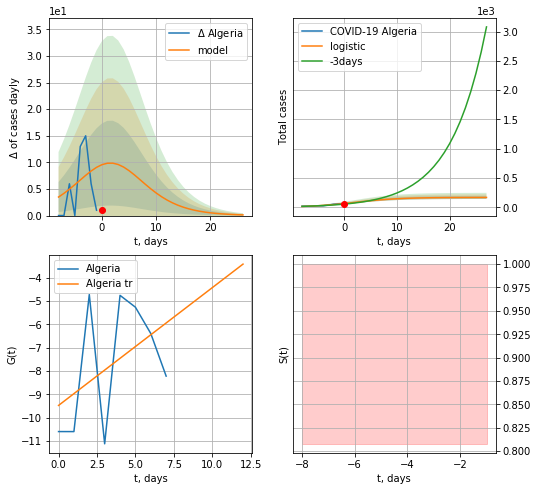

Algeria data at: 2020-08-02
+3 day model MAPE: 0.16392519582549905
model: logistic
coeffs:  [169.67149558   0.23328995   2.04236169]
rational stdev:  0.1546785167835457
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  169 ± 26
	 total death:  6 ± 2
trend coefficient of determination: 0.198482
 intercept: -9.477734
 slope: 0.504434


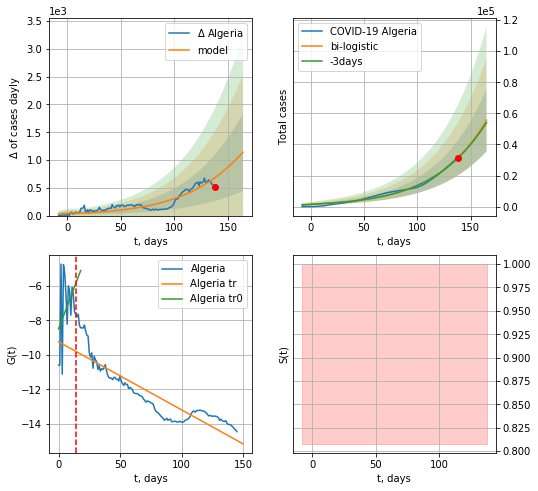

Algeria data at: 2020-08-02
+3 day model MAPE: 0.008166649265150818
model: bi-logistic
coeffs:  [5.69377443e+05 2.30198793e-02 2.61813628e+02] [169.67149558   0.23328995   2.04236169]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.3601995748791248
forecast at the end of period: +27 days
	 deltaDaycases:  1140
	 total cases:  55554 ± 20010
	 total death:  2173 ± 2348
bi-logistic approximation splitting point: 14
trend0 coefficient of determination: 0.134003
 intercept: -8.492024
 slope: 0.188486
trend coefficient of determination: 0.794668
 intercept: -9.243588
 slope: -0.039522


In [4292]:
dfAR = read_df(pd.DataFrame(),"AR")
x = forecast("Algeria",dfAR[5:14],d1,7*T18-dT)
xx = forecast2("Algeria",dfAR[5:],d1,7*T18-dT,x,addpred=True,xcoef=[0.25,1.,2.],vL=14)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


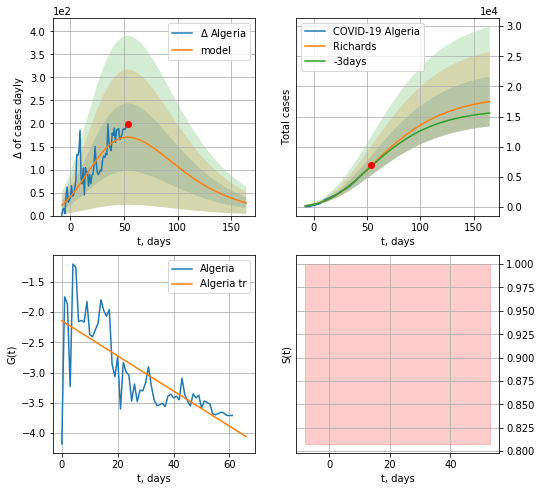

Algeria data at: 2020-08-02
+3 day model MAPE: 0.017361
model: Richards
coeffs: [ 1.86312269e+04  1.59750196e+00 -1.12063742e+02  1.56623086e-02]
rational stdev: 0.235608
forecast at the end of period: +111 days
	 deltaDaycases: 27
	 total cases: 17506 ± 4124
	 total death: 684 ± 483
trend coefficient of determination: 0.563244
 intercept: -2.140644
 slope: -0.029042


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


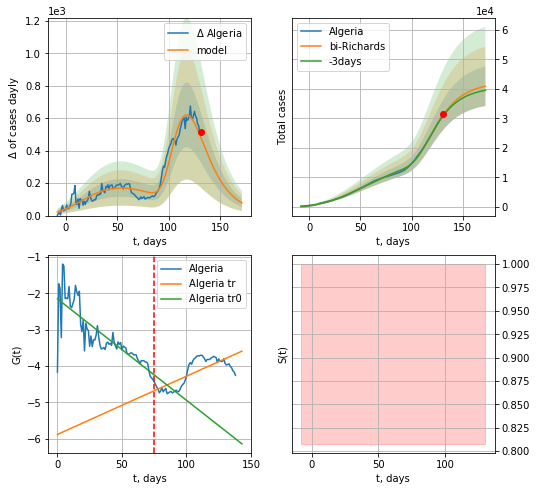

Algeria data at: 2020-08-02
+3 day model MAPE: 0.010341
model: bi-Richards
coeffs: [2.41139413e+04 4.41148950e+00 4.95024895e+01 1.40021100e-02]
rational stdev: 0.164075
forecast at the end of period: +41 days
	 deltaDaycases: 78
	 total cases: 40921 ± 6714
	 total death: 1600 ± 787
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.673858
 intercept: -2.153283
 slope: -0.027890
trend coefficient of determination: 0.574886
 intercept: -5.883510
 slope: 0.016021


In [4293]:
vL = 75+12
x = forecastRR("Algeria",dfAR[12:vL-12],d1,34*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Algeria",dfAR[12:],d1,24*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL-12)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


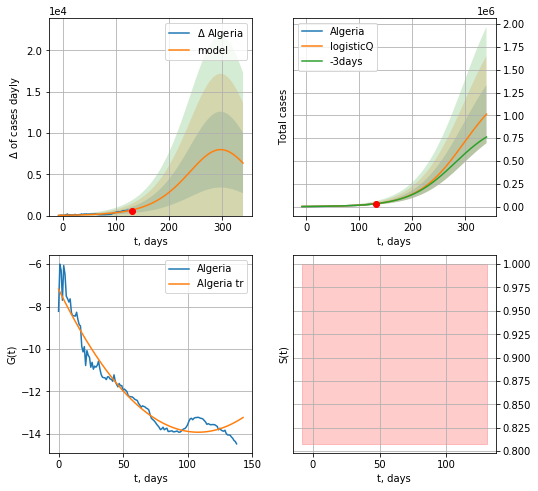

Algeria data at: 2020-08-02
+3 day model MAPE: 0.004587
model: logisticQ
coeffs: [ 1.38555740e+06  2.05360615e-06  2.96700104e+02 -1.09373786e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.314386
forecast at the end of period: +209 days
	 deltaDaycases: 6358
	 total cases: 1013694 ± 318691
	 total death: 39658 ± 37403
trend coefficient of determination: 0.948694
 intercept_: -7.179306352348419
 coeffs_: [ 0.         -0.12456013  0.00057524]


In [4294]:
x = forecastRRR("Algeria",dfAR[12:],d1,48*7-dT,addpred=True,xcoef=koreaCoeffs)

CP
           date   cases  active  death
139 2020-07-29  1080.0   209.0   19.0
140 2020-07-30  1090.0   219.0   19.0
141 2020-07-31  1114.0   243.0   19.0
142 2020-08-01  1124.0   253.0   19.0
143 2020-08-02  1150.0   275.0   19.0


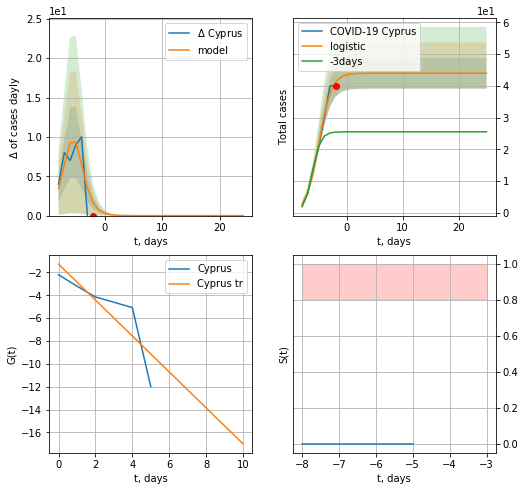

Cyprus data at: 2020-08-02
+3 day model MAPE: 0.6804910040725392
model: logistic
coeffs:  [44.00930085  0.89972657 -4.98223467]
rational stdev:  0.11057143028380123
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  44 ± 4
	 total death:  0 ± 0
trend coefficient of determination: 0.714597
 intercept: -1.270285
 slope: -1.572073


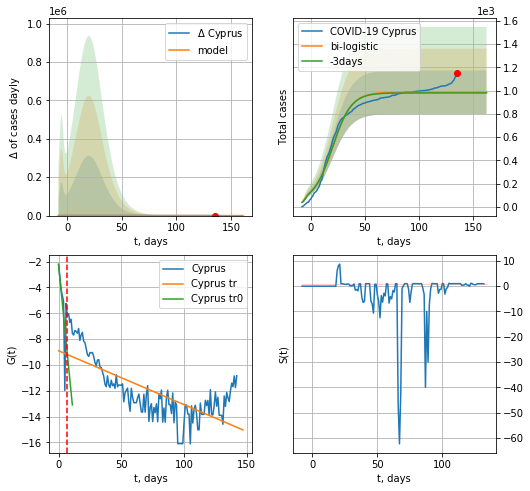

Cyprus data at: 2020-08-02
+3 day model MAPE: 0.0061066976091625645
model: bi-logistic
coeffs:  [9.41081349e+02 1.13444872e-01 2.02079748e+01] [44.00930085  0.89972657 -4.98223467]
rational stdev:  0.19011122700225708
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  985 ± 187
	 total death:  16 ± 9
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.449603
 intercept: -2.247366
 slope: -0.985825
trend coefficient of determination: 0.522414
 intercept: -8.902050
 slope: -0.041682


In [4295]:
try:
    dfCP = read_df(pd.DataFrame(),"CP")
    dfCP = dfCP.fillna(0)
    x = forecast("Cyprus",dfCP[:7],d1,7*T18-dT)
    xx = forecast2("Cyprus",dfCP[:],d1,T18*7-dT,x,addpred=False,xcoef=[0.25,1.,2.3],vL=7)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


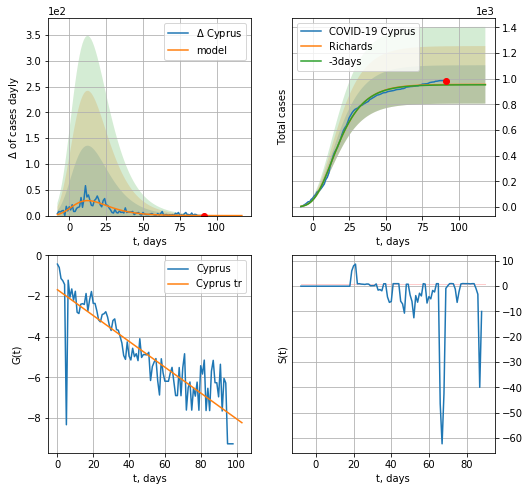

Cyprus data at: 2020-08-02
+3 day model MAPE: 0.003127
model: Richards
coeffs: [ 9.55573339e+02  7.15554679e+00 -4.06493021e+01  1.16170905e-02]
rational stdev: 0.156587
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 955 ± 149
	 total death: 15 ± 7
trend coefficient of determination: 0.758354
 intercept: -1.687536
 slope: -0.063575


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


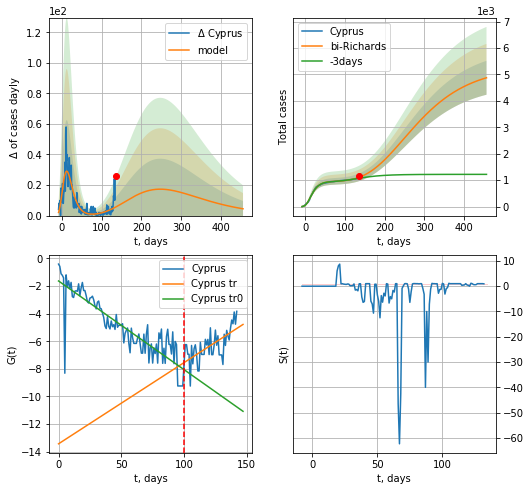

Cyprus data at: 2020-08-02
+3 day model MAPE: 0.032695
model: bi-Richards
coeffs: [ 4.34927264e+03  1.68768171e+00 -2.17664597e+02  6.42618580e-03]
rational stdev: 0.131510
forecast at the end of period: +321 days
	 deltaDaycases: 4
	 total cases: 4873 ± 640
	 total death: 80 ± 31
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.764690
 intercept: -1.637226
 slope: -0.064198
trend coefficient of determination: 0.421991
 intercept: -13.427835
 slope: 0.058796


In [4297]:
vL=100
x = forecastRR("Cyprus",dfCP[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
x = forecast2RR("Cyprus",dfCP[:],d1,64*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


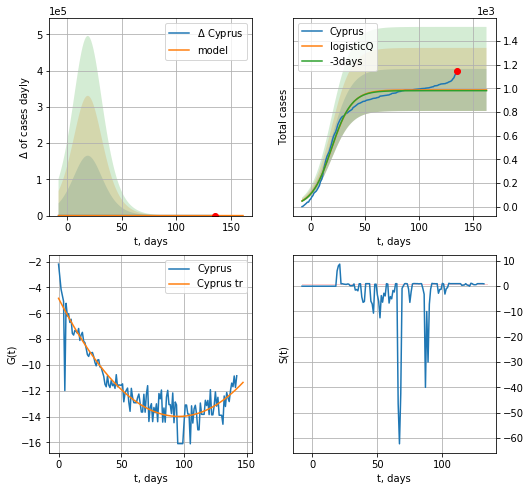

Cyprus data at: 2020-08-02
+3 day model MAPE: 0.006073
model: logisticQ
coeffs: [ 9.86783281e+02  1.66220217e-07  1.92674156e+01 -6.43283513e+05]
rational stdev: 0.179821
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 986 ± 177
	 total death: 16 ± 8
trend coefficient of determination: 0.865700
 intercept_: -4.844316674202502
 coeffs_: [ 0.         -0.19108002  0.00099876]


In [4298]:
vL=33
x = forecastRRR("Cyprus",dfCP[:],d1,T18*7-dT,addpred=False,xcoef=koreaCoeffs)
#xx = forecast2RRR("Cyprus",dfCP[:],d1,20*7-dT,x,addpred=True,xcoef=[0.35,.5,4,1],vL=vL)

PU
           date   cases    active    death
144 2020-07-29  400683  101823.0  18816.0
145 2020-07-30  407492  104556.0  19021.0
146 2020-07-31  414772  104556.0  19021.0
147 2020-08-01  422183  111940.0  19408.0
148 2020-08-02  428850  115049.0  19614.0


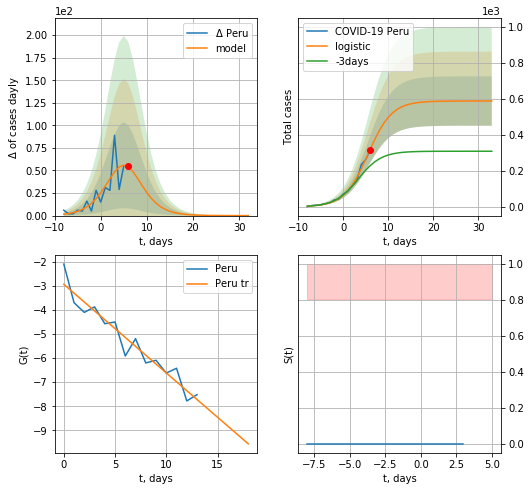

Peru data at: 2020-08-02
+3 day model MAPE: 0.4976759510371563
model: logistic
coeffs:  [5.88914141e+02 3.80777382e-01 5.52424877e+00]
rational stdev:  0.23355774891059702
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  588 ± 137
	 total death:  26 ± 18
trend coefficient of determination: 0.924015
 intercept: -2.937528
 slope: -0.367722


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:237: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


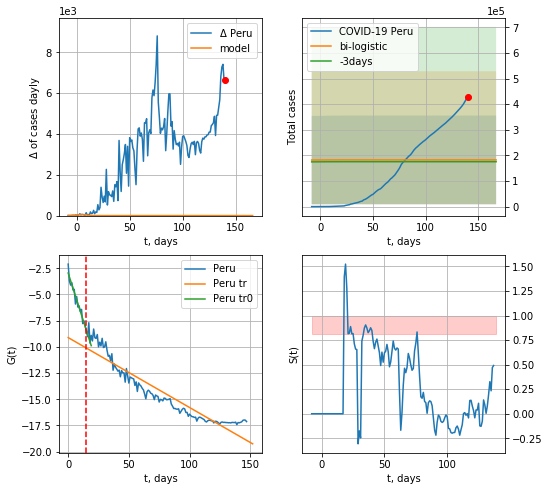

Peru data at: 2020-08-02
+3 day model MAPE: 0.04041685640600622
model: bi-logistic
coeffs:  [ 1.45458921e+05 -1.78992273e+01  4.36599534e+02] [5.88914141e+02 3.80777382e-01 5.52424877e+00]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.9494962281346374
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  182412 ± 173200
	 total death:  8342 ± 23762
bi-logistic approximation splitting point: 15
trend0 coefficient of determination: 0.936345
 intercept: -2.948740
 slope: -0.365135
trend coefficient of determination: 0.890259
 intercept: -9.112832
 slope: -0.066708


In [4299]:
dfPU = read_df(pd.DataFrame(),"PU")
dfPU = dfPU.fillna(0)
x = forecast("Peru",dfPU[:15],d1,7*T18-dT)
xx = forecast2("Peru",dfPU[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=15)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


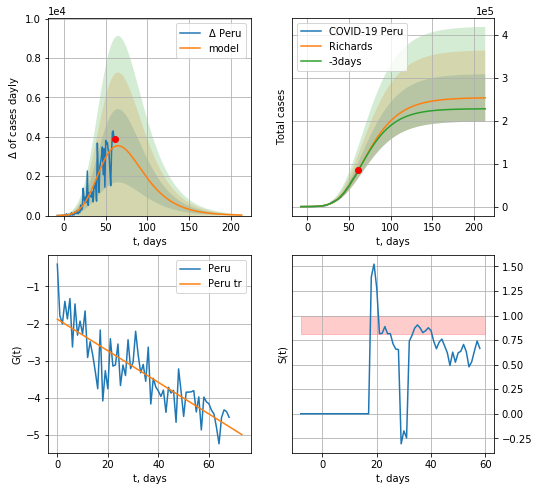

Peru data at: 2020-08-02
+3 day model MAPE: 0.004154
model: Richards
coeffs: [2.53863506e+05 3.16853284e-01 1.42828252e+01 1.27510046e-01]
rational stdev: 0.217550
forecast at the end of period: +153 days
	 deltaDaycases: 25
	 total cases: 253240 ± 55092
	 total death: 11582 ± 7558
trend coefficient of determination: 0.729631
 intercept: -1.882711
 slope: -0.042524


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


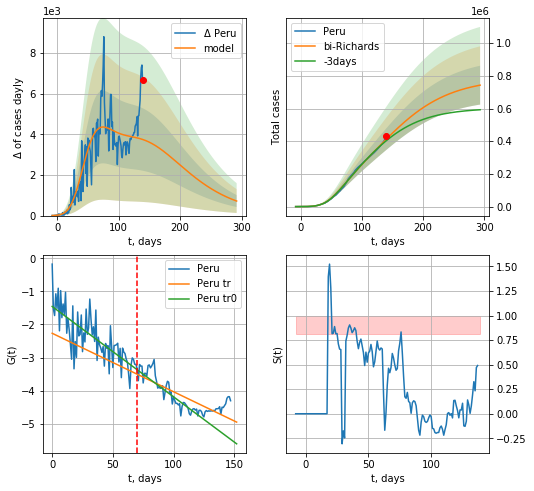

Peru data at: 2020-08-02
+3 day model MAPE: 0.024853
model: bi-Richards
coeffs: [ 5.32820823e+05  1.54969105e+00 -1.18959918e+02  1.09233555e-02]
rational stdev: 0.159837
forecast at the end of period: +153 days
	 deltaDaycases: 715
	 total cases: 742910 ± 118744
	 total death: 33977 ± 16292
bi-Richards approximation splitting point: 70
trend coefficient of determination: 0.552173
 intercept: -1.455439
 slope: -0.027326
trend coefficient of determination: 0.643147
 intercept: -2.266764
 slope: -0.017670


In [4300]:
vL = 70
x = forecastRR("Peru",dfPU[:vL],d1,40*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("Peru",dfPU[:],d1,40*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR("Peru",dfPU[:],d1,36*7-dT)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


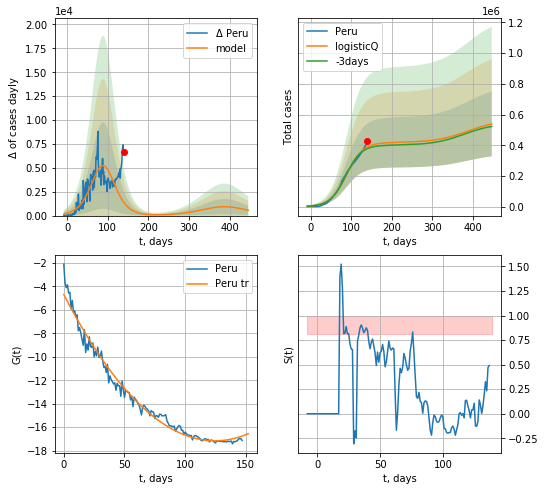

Peru data at: 2020-08-02
+3 day model MAPE: 0.028189
model: logisticQ
coeffs: [ 4.17573676e+05  2.26682913e-07  8.88452221e+01 -2.21020483e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.391405
forecast at the end of period: +307 days
	 deltaDaycases: 558
	 total cases: 538630 ± 210822
	 total death: 24634 ± 28925
trend coefficient of determination: 0.980933
 intercept_: -4.696100296664255
 coeffs_: [ 0.         -0.2002164   0.00080376]


In [4301]:
x = forecastRRR("Peru",dfPU[:].fillna(0),d1,62*7-dT,addpred=True,xcoef=koreaCoeffs)

ID
           date    cases    active    death
151 2020-07-29  1588129  530487.0  35036.0
152 2020-07-30  1643416  547626.0  35807.0
153 2020-07-31  1697054  564856.0  36551.0
154 2020-08-01  1756220  570623.0  37436.0
155 2020-08-02  1808128  581277.0  38201.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


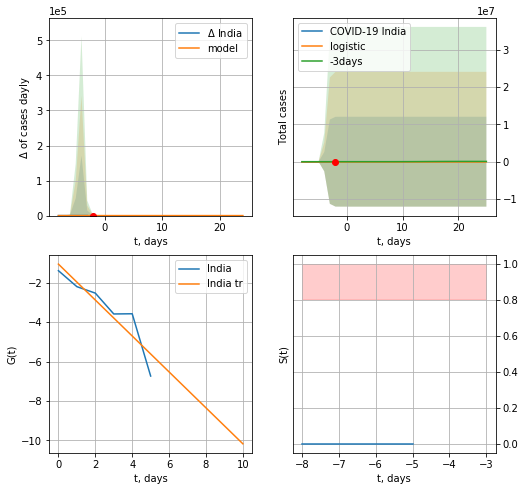

India data at: 2020-08-02
+3 day model MAPE: 0.19486002826260063
model: logistic
coeffs:  [29.4003363   4.01436821 -3.67575825]
rational stdev:  409417.6299021335
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  29 ± 12037016
	 total death:  0 ± 0
trend coefficient of determination: 0.835838
 intercept: -1.052904
 slope: -0.912220


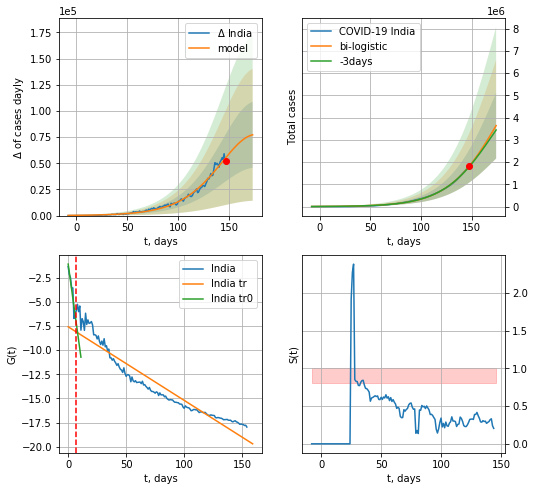

India data at: 2020-08-02
+3 day model MAPE: 0.01341857703306803
model: bi-logistic
coeffs:  [7.73431246e+06 4.00037830e-02 1.76968184e+02] [29.4003363   4.01436821 -3.67575825]
scenario coeffs:  [0.25, 1.0, 1.8]
rational stdev:  0.40607055235730055
forecast at the end of period: +27 days
	 deltaDaycases:  77209
	 total cases:  3643805 ± 1479641
	 total death:  76984 ± 93782
bi-logistic approximation splitting point: 7
trend0 coefficient of determination: 0.879788
 intercept: -1.115653
 slope: -0.874570
trend coefficient of determination: 0.909461
 intercept: -7.593687
 slope: -0.076088


In [4302]:
dfID = read_df(pd.DataFrame(),"ID")
dfID = dfID.fillna(0)
x = forecast("India",dfID[:7],d1,7*T18-dT)
xx = forecast2("India",dfID[:],d1,T18*7-dT,x,addpred=True,xcoef=[0.25,1.,1.8],vL=7)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


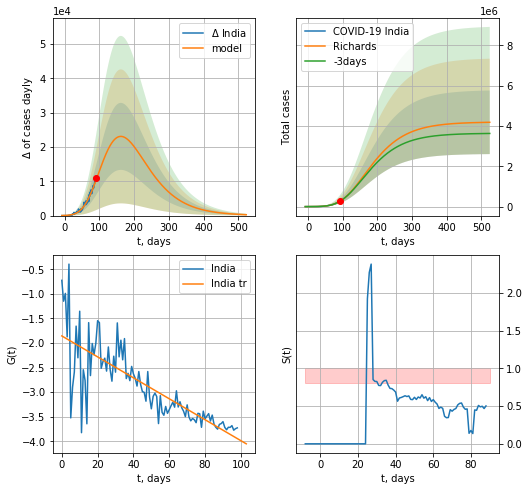

India data at: 2020-08-02
+3 day model MAPE: 0.006994
model: Richards
coeffs: [ 4.19766377e+06  3.32044249e-01 -3.85411502e+01  4.61089241e-02]
rational stdev: 0.377105
forecast at the end of period: +433 days
	 deltaDaycases: 254
	 total cases: 4181147 ± 1576731
	 total death: 88336 ± 99935
trend coefficient of determination: 0.633758
 intercept: -1.855387
 slope: -0.021306


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


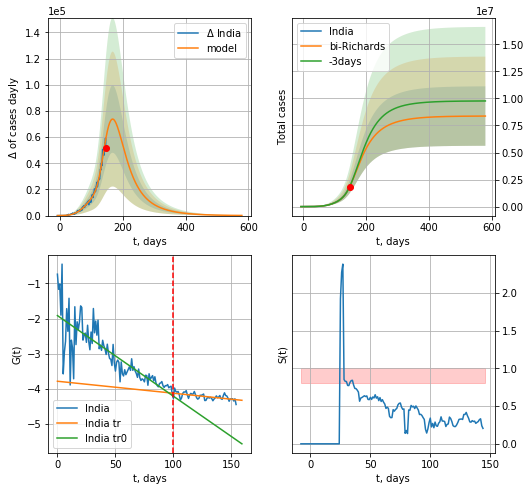

India data at: 2020-08-02
+3 day model MAPE: 0.005078
model: bi-Richards
coeffs: [4.18146075e+06 5.45136227e-01 8.70789648e+01 6.23967343e-02]
rational stdev: 0.328243
forecast at the end of period: +433 days
	 deltaDaycases: 108
	 total cases: 8372105 ± 2748082
	 total death: 176880 ± 174178
bi-Richards approximation splitting point: 100
trend coefficient of determination: 0.672409
 intercept: -1.915572
 slope: -0.022983
trend coefficient of determination: 0.353246
 intercept: -3.786870
 slope: -0.003413


In [4305]:
vL = 100
x = forecastRR("India",dfID[:vL],d1,80*7-dT,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR("India",dfID[:],d1,80*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


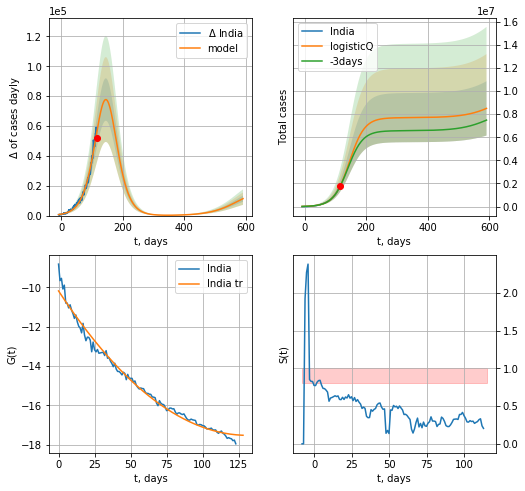

India data at: 2020-08-02
+3 day model MAPE: 0.012980
model: logisticQ
coeffs: [ 7.69215907e+06  3.76822838e-06  1.45548679e+02 -1.05787363e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.276504
forecast at the end of period: +475 days
	 deltaDaycases: 11339
	 total cases: 8494993 ± 2348903
	 total death: 179476 ± 148877
trend coefficient of determination: 0.986567
 intercept_: -10.18743131030315
 coeffs_: [ 0.         -0.11189977  0.00042647]


In [4306]:
x = forecastRRR("India",dfID[31:].fillna(0),d1,86*7-dT,addpred=True,xcoef=koreaCoeffs)

AG
           date     cases    active   death
147 2020-07-29  178996.0   97853.0  3288.0
148 2020-07-30  185373.0  101336.0  3441.0
149 2020-07-31  191302.0  103979.0  3543.0
150 2020-08-01  196543.0  106448.0  3596.0
151 2020-08-02  201919.0  109245.0  3648.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 800.
  warnings.warn(errors[info][0], RuntimeWarning)


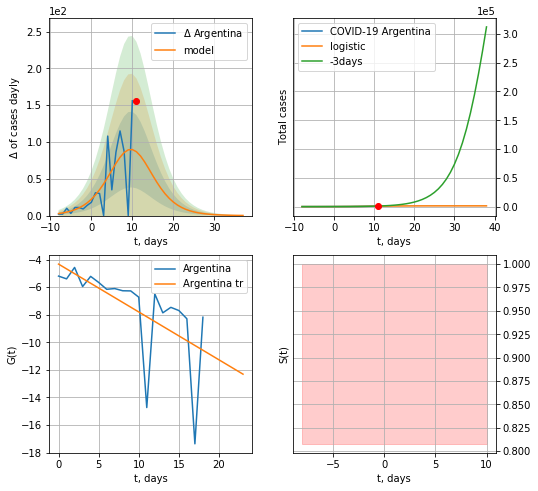

Argentina data at: 2020-08-02
+3 day model MAPE: 0.34277903234874524
model: logistic
coeffs:  [1.30607345e+03 2.75914265e-01 1.01155997e+01]
rational stdev:  0.27772613105407934
forecast at the end of period: +27 days
	 deltaDaycases:  0
	 total cases:  1305 ± 362
	 total death:  23 ± 19
trend coefficient of determination: 0.364190
 intercept: -4.325611
 slope: -0.347113


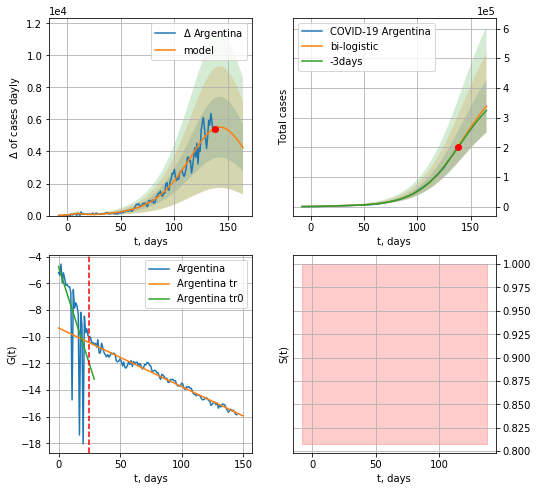

Argentina data at: 2020-08-02
+3 day model MAPE: 0.013226867310629348
model: bi-logistic
coeffs:  [4.51206342e+05 4.89133079e-02 1.42863669e+02] [1.30607345e+03 2.75914265e-01 1.01155997e+01]
scenario coeffs:  [0.25, 1.0, 2.0]
rational stdev:  0.2626065941748144
forecast at the end of period: +27 days
	 deltaDaycases:  4235
	 total cases:  338671 ± 88937
	 total death:  6118 ± 4819
bi-logistic approximation splitting point: 25
trend0 coefficient of determination: 0.360462
 intercept: -4.766843
 slope: -0.290012
trend coefficient of determination: 0.976371
 intercept: -9.349266
 slope: -0.043869


In [4307]:
vL = 25
#vL1 = 40
dfAG = read_df(pd.DataFrame(),"AG")
x = forecast('Argentina',dfAG[5:vL],d1,7*T18-dT,1.0)
xx = forecast2('Argentina',dfAG[5:],d1,T18*7-dT,x,1.0,vL=vL,addpred=True,xcoef=[.25,1.,2.0])
#xx = np.concatenate((x, xx), axis=0)
#xxx = forecast3("Argentina",dfAG[5:],d1,8*7-dT, xx, shift=1.,addpred=False,xcoef=[.25,1.,2.0],vL=[vL,vL1])

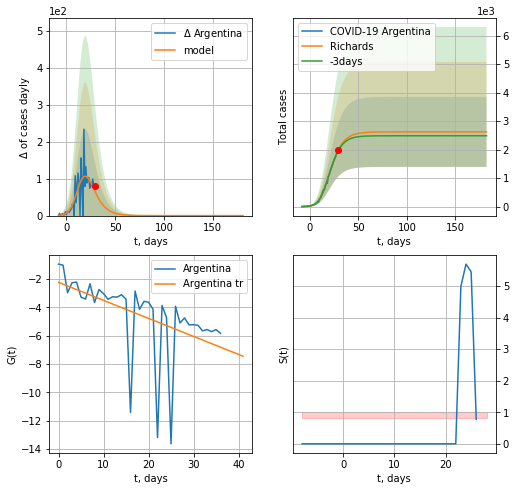

Argentina data at: 2020-08-02
+3 day model MAPE: 0.013138
model: Richards
coeffs: [2.62031767e+03 3.73237042e-01 1.15845098e+01 3.46306086e-01]
rational stdev: 0.468281
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 2620 ± 1227
	 total death: 47 ± 66
trend coefficient of determination: 0.244505
 intercept: -2.222432
 slope: -0.127357


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


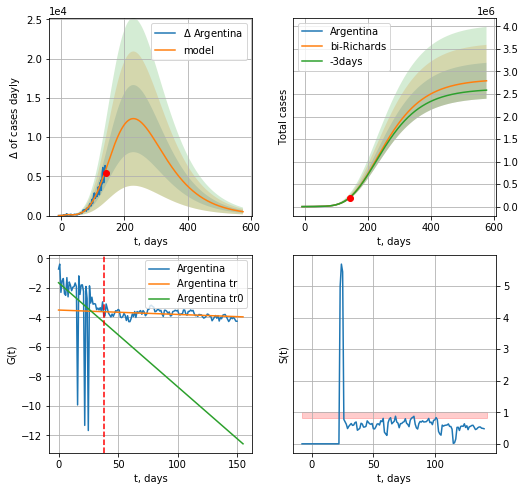

Argentina data at: 2020-08-02
+3 day model MAPE: 0.004054
model: bi-Richards
coeffs: [ 2.83177747e+06  2.32325035e-01 -1.33126101e+01  5.23850523e-02]
rational stdev: 0.142793
forecast at the end of period: +433 days
	 deltaDaycases: 500
	 total cases: 2793217 ± 398852
	 total death: 50464 ± 21617
bi-Richards approximation splitting point: 38
trend coefficient of determination: 0.097158
 intercept: -1.656701
 slope: -0.070383
trend coefficient of determination: 0.145732
 intercept: -3.506989
 slope: -0.002975


In [4308]:
vL = 38
x = forecastRR('Argentina',dfAG[:vL].fillna(0),d1,40*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Argentina',dfAG[:].fillna(0),d1,80*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


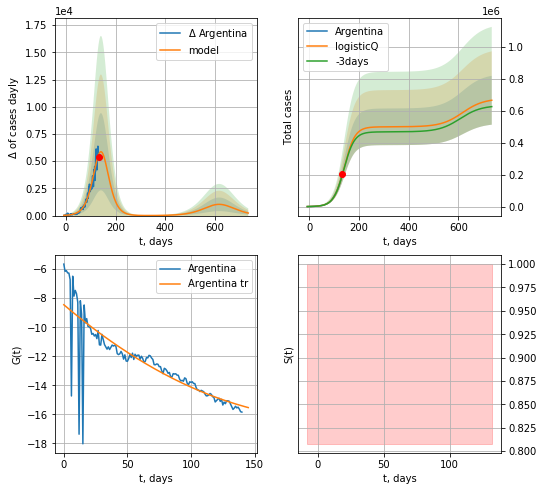

Argentina data at: 2020-08-02
+3 day model MAPE: 0.009244
model: logisticQ
coeffs: [ 4.98985106e+05  4.69482701e-06  1.41389065e+02 -9.87834562e+03]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.229808
forecast at the end of period: +601 days
	 deltaDaycases: 234
	 total cases: 665170 ± 152861
	 total death: 12017 ± 8284
trend coefficient of determination: 0.711633
 intercept_: -8.450031472836624
 coeffs_: [ 0.         -0.07428339  0.00017559]


In [4309]:
x = forecastRRR('Argentina',dfAG[10:],d1,104*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


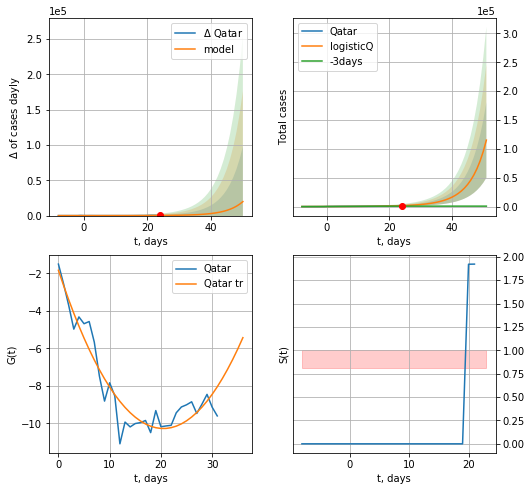

Qatar data at: 2020-08-02
+3 day model MAPE: 1.403665
model: logisticQ
coeffs: [ 4.67644951e+06  1.32940327e-03  6.79780107e+01 -1.11960184e+02]
rational stdev: 0.567221
forecast at the end of period: +27 days
	 deltaDaycases: 19793
	 total cases: 115263 ± 65380
	 total death: 183 ± 311
trend coefficient of determination: 0.904406
 intercept_: -1.8341916285683908
 coeffs_: [ 0.         -0.82373816  0.02011068]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


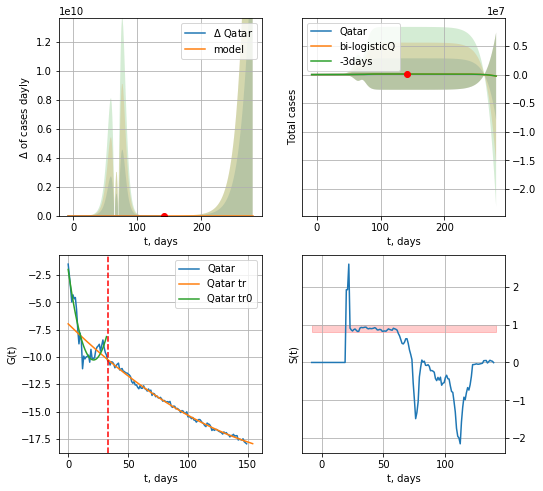

Qatar data at: 2020-08-02
+3 day model MAPE: 0.008764
model: bi-logisticQ
coeffs: [-4.58083305e+06  1.51354185e-03  6.79360521e+01 -9.44090988e+01]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 28.701724
forecast at the end of period: +139 days
	 deltaDaycases: -22552
	 total cases: -264726 ± -7598097
	 total death: -421 ± -36250
bi-logisticQ approximation splitting point: 33
trend coefficient of determination: 0.887233
 intercept_: -1.9921673153050232
 coeffs_: [ 0.         -0.78114612  0.01840466]
trend coefficient of determination: 0.994932
 intercept_: -6.976175414869761
 coeffs_: [ 0.         -0.10678988  0.00023104]


In [4310]:
vL=33
x = forecastRRR('Qatar',dfQR[:vL].fillna(0),d1,7*T18-dT,1.0,addpred=False,xcoef=[.35,.5,4.0,1])
xx = forecast2RRR('Qatar',dfQR[:].fillna(0),d1,38*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


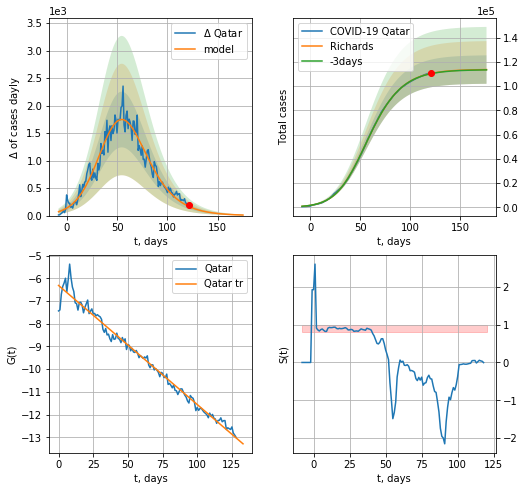

Qatar data at: 2020-08-02
+3 day model MAPE: 0.001567
model: Richards
coeffs: [1.13778402e+05 9.29832357e-02 4.47057762e+01 5.72882564e-01]
rational stdev: 0.103289
forecast at the end of period: +55 days
	 deltaDaycases: 9
	 total cases: 113596 ± 11733
	 total death: 180 ± 55
trend coefficient of determination: 0.981255
 intercept: -6.316639
 slope: -0.052368


In [4311]:
iL = 21
vL = 99 + iL
x = forecastRR('Qatar',dfQR[iL:].fillna(0),d1,26*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
#xx = forecast2RR('Qatar',dfQR[iL:].fillna(0),d1,60*7-dT,x,1.0,addpred=True,xcoef=RkoreaCoeffs,vL=vL-iL)

In [4312]:
#x = forecast('Qatar',dfQR[:],d1,18*7-dT,1.0,addpred=True,xcoef=[.35,.5,4.0,1])

UAE
           date    cases  active  death
165 2020-07-29  59921.0    6248  349.0
166 2020-07-30  60223.0    6248  349.0
167 2020-07-31  60506.0    6246  351.0
168 2020-08-01  60760.0    6154  351.0
169 2020-08-02  60999.0    6033  351.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


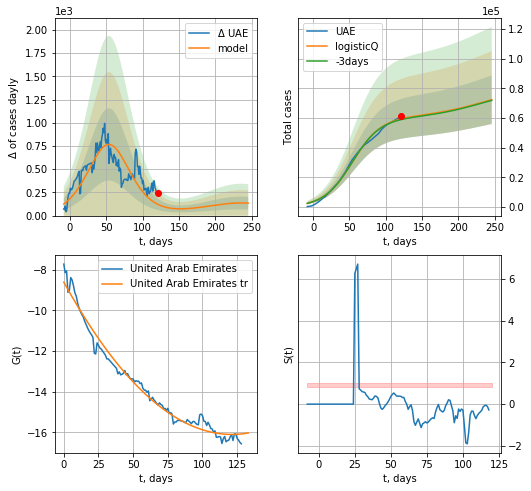

UAE data at: 2020-08-02
+3 day model MAPE: 0.008404
model: logisticQ
coeffs: [ 6.02498412e+04  2.20372491e-07  5.41179997e+01 -2.29428891e+05]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.226056
forecast at the end of period: +125 days
	 deltaDaycases: 133
	 total cases: 72281 ± 16339
	 total death: 415 ± 281
trend coefficient of determination: 0.979486
 intercept_: -8.617800496553574
 coeffs_: [ 0.         -0.123519    0.00050982]


In [4313]:
dfUAE = read_df(pd.DataFrame(),"UAE")
x = forecastRRR('UAE',dfUAE[40:],d1,36*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


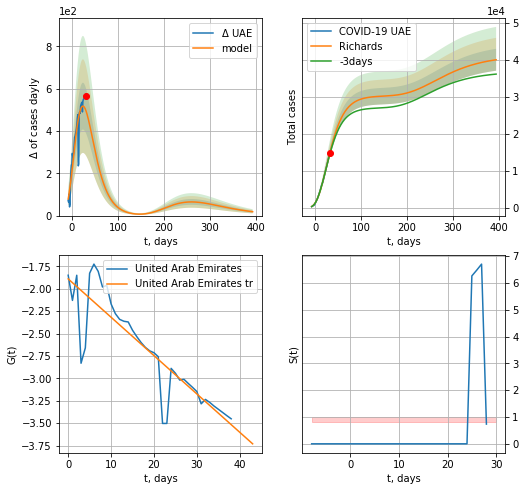

UAE data at: 2020-08-02
+3 day model MAPE: 0.022807
model: Richards
coeffs: [ 3.02157107e+04  2.32377536e+00 -5.83980795e+01  2.02399126e-02]
S.Korea scenario coeffs: [0.36242246, 2.56241634, 1.84890887, 0.13324732]
rational stdev: 0.073933
forecast at the end of period: +363 days
	 deltaDaycases: 18
	 total cases: 39957 ± 2954
	 total death: 229 ± 50
trend coefficient of determination: 0.778768
 intercept: -1.889612
 slope: -0.042819


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


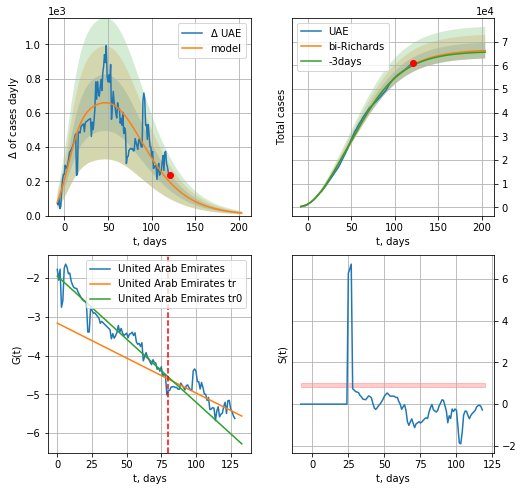

UAE data at: 2020-08-02
+3 day model MAPE: 0.004470
model: bi-Richards
coeffs: [ 3.64221957e+04  4.39733146e+00 -8.11887145e+01  7.41886063e-03]
rational stdev: 0.050280
forecast at the end of period: +83 days
	 deltaDaycases: 14
	 total cases: 66186 ± 3327
	 total death: 380 ± 57
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.913852
 intercept: -1.945029
 slope: -0.032579
trend coefficient of determination: 0.562243
 intercept: -3.161811
 slope: -0.018036


In [4314]:
iL = 40
vL = 80 + iL
x = forecastRR('UAE',dfUAE[iL:vL-iL],d1,70*7-dT,1.0,addpred=True,xcoef=RkoreaCoeffs)
xx = forecast2RR('UAE',dfUAE[iL:],d1,30*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)
#x = forecastQR('UAE',dfUAE[40:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [4315]:
#plt.plot(range(len(dfUAE[45:])-1),np.log(np.log(np.log(np.diff(dfUAE[45:].cases)))))

SA
           date     cases  active   death
148 2020-07-29  272590.0   41205  2816.0
149 2020-07-30  274219.0   40179  2842.0
150 2020-07-31  275905.0   37381  2866.0
151 2020-08-01  277478.0   37043  2887.0
152 2020-08-02  278835.0   35837  2917.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


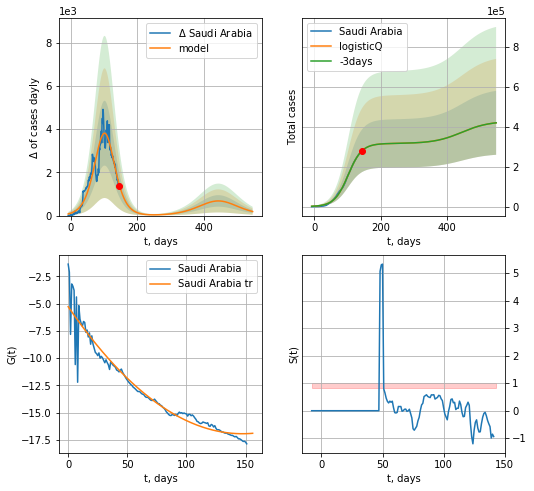

Saudi Arabia data at: 2020-08-02
+3 day model MAPE: 0.000066
model: logisticQ
coeffs: [ 3.15813761e+05  6.21959545e-07  1.02097880e+02 -7.76147307e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.381500
forecast at the end of period: +405 days
	 deltaDaycases: 188
	 total cases: 419388 ± 159996
	 total death: 4387 ± 5020
trend coefficient of determination: 0.935338
 intercept_: -5.291661517370871
 coeffs_: [ 0.         -0.15807053  0.00053628]


In [4316]:
dfSA = read_df(pd.DataFrame(),"SA")
x = forecastRRR('Saudi Arabia',dfSA[:],d1,76*7-dT,1.0,addpred=True,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide


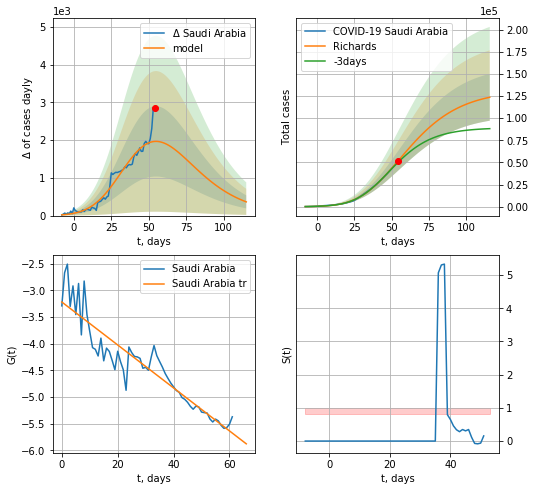

Saudi Arabia data at: 2020-08-02
+3 day model MAPE: 0.035873
model: Richards
coeffs: [1.31817079e+05 1.98592402e-01 2.23760353e+01 2.26893478e-01]
rational stdev: 0.214320
forecast at the end of period: +62 days
	 deltaDaycases: 363
	 total cases: 123595 ± 26489
	 total death: 1292 ± 830
trend coefficient of determination: 0.862733
 intercept: -3.219410
 slope: -0.040287


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


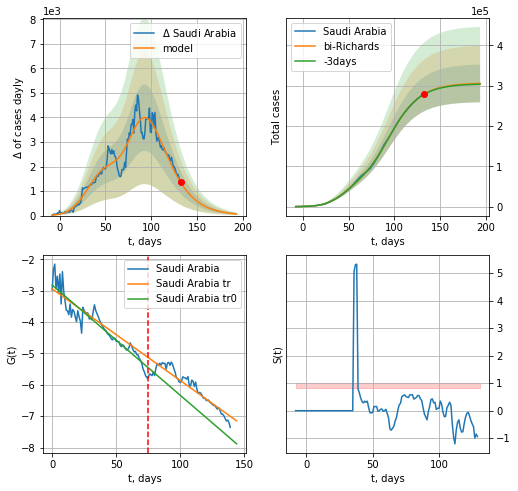

Saudi Arabia data at: 2020-08-02
+3 day model MAPE: 0.002265
model: bi-Richards
coeffs: [1.74915227e+05 3.30574872e-01 6.28729953e+01 1.61751549e-01]
rational stdev: 0.152821
forecast at the end of period: +62 days
	 deltaDaycases: 64
	 total cases: 305506 ± 46687
	 total death: 3196 ± 1465
bi-Richards approximation splitting point: 75
trend coefficient of determination: 0.888219
 intercept: -2.819749
 slope: -0.035136
trend coefficient of determination: 0.867226
 intercept: -2.940340
 slope: -0.029218


In [4317]:
x = forecastRR('Saudi Arabia',dfSA[12:75],d1,27*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Saudi Arabia',dfSA[12:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=75)
#x = forecastQR('Saudi Arabia',dfSA[12:],d1,18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

Sri
           date   cases  active  death
141 2020-07-29  2811.0     467   11.0
142 2020-07-30  2814.0     470   11.0
143 2020-07-31  2815.0     413   11.0
144 2020-08-01  2819.0     365   11.0
145 2020-08-02  2823.0     298   11.0


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


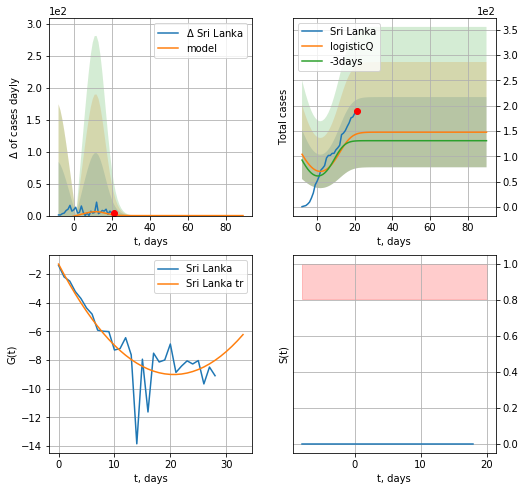

Sri Lanka data at: 2020-08-02
+3 day model MAPE: 0.111838
model: logisticQ
coeffs: [ 1.47873593e+02  1.02177717e-02  4.75700419e+00 -1.32326165e+00]
rational stdev: 0.468204
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 147 ± 69
	 total death: 0 ± 0
trend coefficient of determination: 0.737116
 intercept_: -1.300425972375204
 coeffs_: [ 0.         -0.74879164  0.01816974]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:294: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:333: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/numpy/core/_methods.py:193: RuntimeWarning: invalid value encountered in subtract
  x = asanyarray(arr - arrmean)


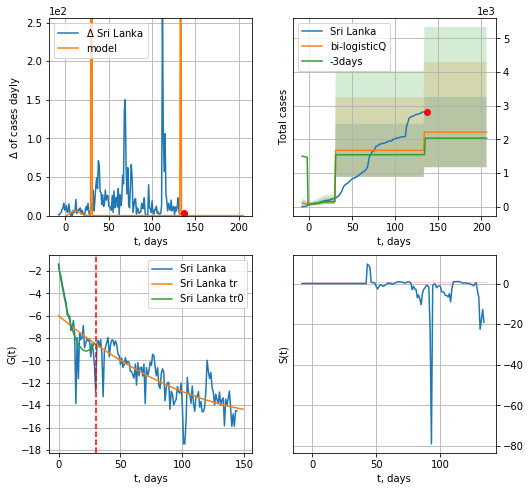

Sri Lanka data at: 2020-08-02
+3 day model MAPE: 0.087925
model: bi-logisticQ
coeffs: [1525.95214875    2.71825371   30.60440196   -9.99308349]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.470805
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 2214 ± 1042
	 total death: 8 ± 11
bi-logisticQ approximation splitting point: 30
trend coefficient of determination: 0.725855
 intercept_: -1.5084890363019623
 coeffs_: [ 0.         -0.68634546  0.01540158]
trend coefficient of determination: 0.615512
 intercept_: -6.004245907963341
 coeffs_: [ 0.         -0.09177363  0.00023972]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


In [4320]:
try:
    dfSri = read_df(pd.DataFrame(),"Sri")
    vL= 30
    x = forecastRRR('Sri Lanka',dfSri[:vL],d1,28*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Sri Lanka',dfSri[:],d1,28*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

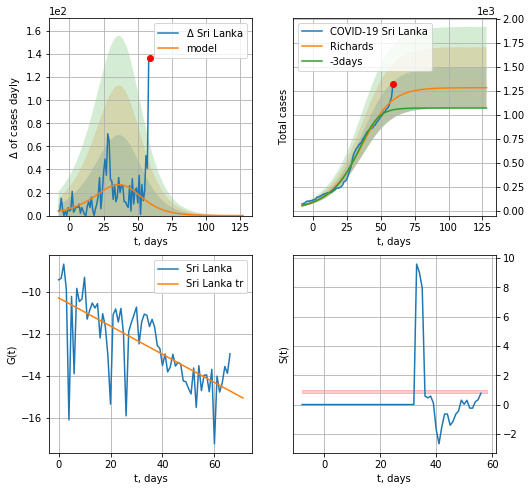

Sri Lanka data at: 2020-08-02
+3 day model MAPE: 0.103361
model: Richards
coeffs: [1.28171157e+03 6.47995832e-02 4.07030001e+01 1.48770145e+00]
rational stdev: 0.164364
forecast at the end of period: +69 days
	 deltaDaycases: 0
	 total cases: 1281 ± 210
	 total death: 4 ± 1
trend coefficient of determination: 0.481079
 intercept: -10.284657
 slope: -0.067327


/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


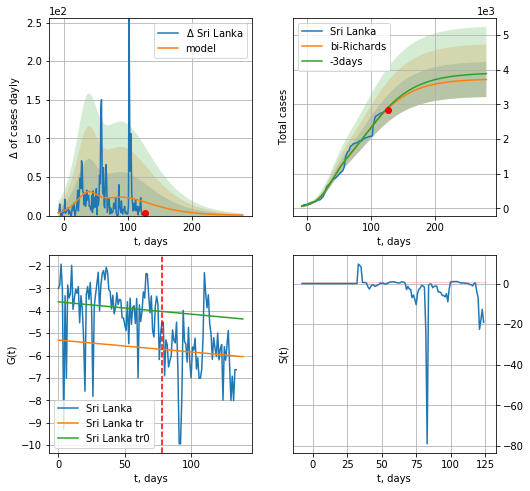

Sri Lanka data at: 2020-08-02
+3 day model MAPE: 0.010248
model: bi-Richards
coeffs: [ 2.45522845e+03  2.77951947e+00 -8.67484252e+01  9.32038248e-03]
rational stdev: 0.136210
forecast at the end of period: +153 days
	 deltaDaycases: 0
	 total cases: 3717 ± 506
	 total death: 14 ± 5
bi-Richards approximation splitting point: 78
trend coefficient of determination: 0.008570
 intercept: -3.597335
 slope: -0.005508
trend coefficient of determination: 0.003974
 intercept: -5.307036
 slope: -0.005338


In [4321]:
vL=88
x = forecastRR('Sri Lanka',dfSri[10:vL-10],d1,28*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Sri Lanka',dfSri[10:],d1,40*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-10)
#x = forecastQR('Sri Lanka',dfSri[10:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

PS
           date     cases  active   death
153 2020-07-29  277402.0   25347  5924.0
154 2020-07-30  278305.0   25177  5951.0
155 2020-07-31  278725.0   25177  5951.0
156 2020-08-01  279146.0   25149  5970.0
157 2020-08-02  280029.0   25172  5984.0


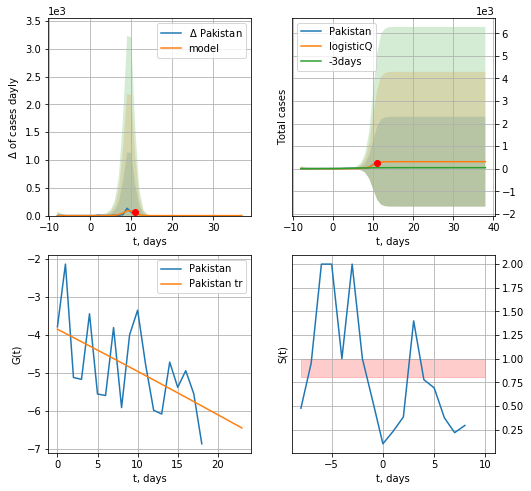

Pakistan data at: 2020-08-02
+3 day model MAPE: 5.954392
model: logisticQ
coeffs: [ 3.10300108e+02  5.80299149e-02  9.88962592e+00 -1.18245382e+01]
rational stdev: 6.420495
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 310 ± 1992
	 total death: 6 ± 115
trend coefficient of determination: 0.293073
 intercept_: -3.8498114630651457
 coeffs_: [ 0.         -0.10964083 -0.00016191]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp


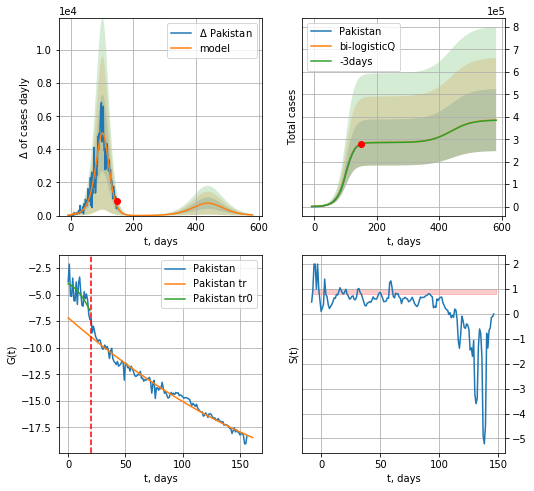

Pakistan data at: 2020-08-02
+3 day model MAPE: 0.001540
model: bi-logisticQ
coeffs: [ 2.85123634e+05  1.36657705e-04  1.00369558e+02 -4.10574710e+02]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.359037
forecast at the end of period: +433 days
	 deltaDaycases: 38
	 total cases: 385166 ± 138288
	 total death: 8230 ± 8864
bi-logisticQ approximation splitting point: 20
trend coefficient of determination: 0.391568
 intercept_: -3.9808806978581046
 coeffs_: [ 0.         -0.04620278 -0.00453428]
trend coefficient of determination: 0.975564
 intercept_: -7.1751718321119835
 coeffs_: [ 0.         -0.09342385  0.00014542]


In [4322]:
try:
    dfPS = read_df(pd.DataFrame(),"PS")
    vL= 20
    x = forecastRRR('Pakistan',dfPS[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Pakistan',dfPS[:],d1,80*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


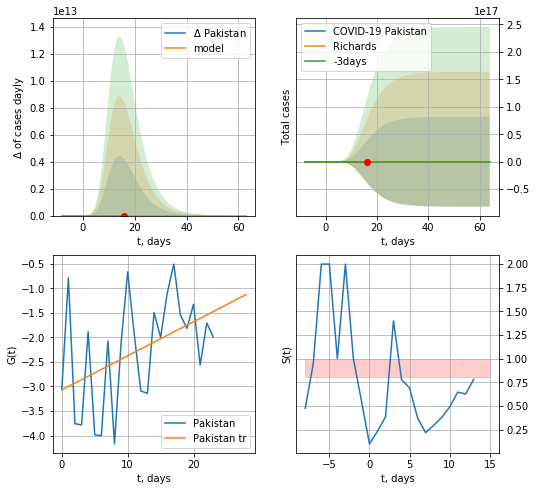

Pakistan data at: 2020-08-02
+3 day model MAPE: 0.118203
model: Richards
coeffs: [ 1.63838701e+03  6.06255652e+00 -3.11642699e+00  3.19416608e-02]
rational stdev: 49944222119087.820312
forecast at the end of period: +48 days
	 deltaDaycases: 0
	 total cases: 1638 ± 81822157045163536
	 total death: 35 ± 5244143322504221
trend coefficient of determination: 0.194578
 intercept: -3.069491
 slope: 0.069432


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


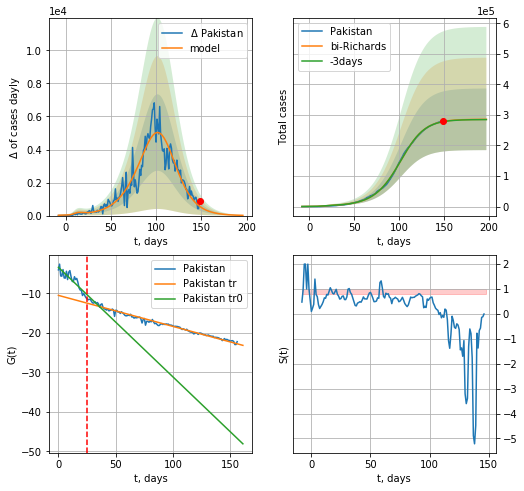

Pakistan data at: 2020-08-02
+3 day model MAPE: 0.002098
model: bi-Richards
coeffs: [2.84108902e+05 5.91081779e-02 1.05639884e+02 1.31099136e+00]
rational stdev: 0.352960
forecast at the end of period: +48 days
	 deltaDaycases: 14
	 total cases: 285564 ± 100793
	 total death: 6102 ± 6461
bi-Richards approximation splitting point: 25
trend coefficient of determination: 0.782327
 intercept: -3.376719
 slope: -0.277695
trend coefficient of determination: 0.979527
 intercept: -10.482499
 slope: -0.078616


In [4323]:
vL = 25
x = forecastRR('Pakistan',dfPS[:vL],d1,25*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Pakistan',dfPS[:],d1,25*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Pakistan',dfPS[:],d1,48*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

BN
           date     cases  active   death
143 2020-07-29  232194.0   98846  3083.0
144 2020-07-30  234889.0   98846  3083.0
145 2020-07-31  237661.0   99414  3111.0
146 2020-08-01  239860.0  100475  3132.0
147 2020-08-02  240746.0  100753  3154.0


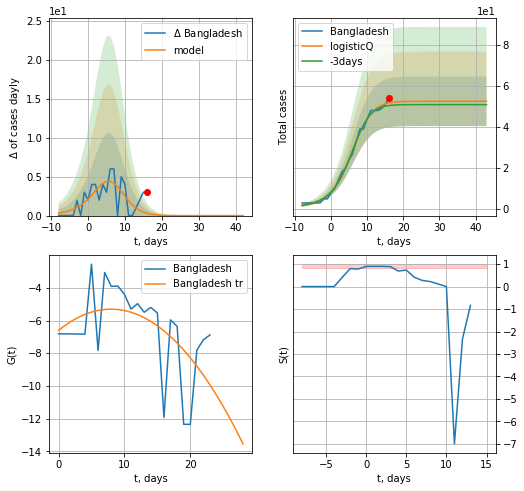

Bangladesh data at: 2020-08-02
+3 day model MAPE: 0.027574
model: logisticQ
coeffs: [ 5.24923910e+01  5.83606353e-03  5.49443194e+00 -5.18823422e+01]
rational stdev: 0.229682
forecast at the end of period: +27 days
	 deltaDaycases: 0
	 total cases: 52 ± 12
	 total death: 0 ± 0
trend coefficient of determination: 0.276192
 intercept_: -6.599187027141191
 coeffs_: [ 0.          0.32583568 -0.02049035]


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:291: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


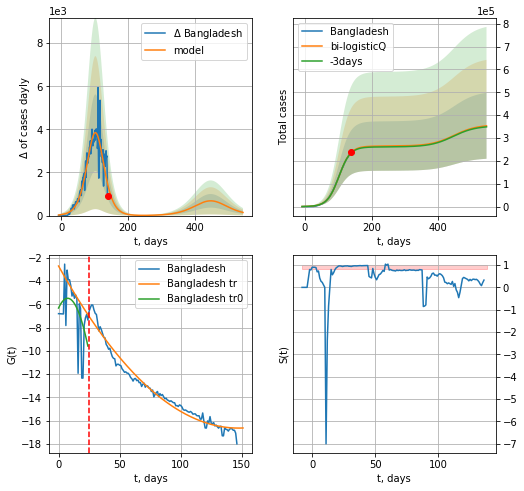

Bangladesh data at: 2020-08-02
+3 day model MAPE: 0.008212
model: bi-logisticQ
coeffs: [ 2.64835034e+05  8.83929977e-07  1.02531083e+02 -6.56228025e+04]
S.Korea scenario coeffs: [0.35416971, 0.02606324, 4.35859408, 19.30413219]
rational stdev: 0.408101
forecast at the end of period: +405 days
	 deltaDaycases: 145
	 total cases: 353483 ± 144256
	 total death: 4630 ± 5668
bi-logisticQ approximation splitting point: 25
trend coefficient of determination: 0.232653
 intercept_: -6.325425729788838
 coeffs_: [ 0.          0.22449345 -0.0150245 ]
trend coefficient of determination: 0.971898
 intercept_: -2.7154077662610607
 coeffs_: [ 0.         -0.18928317  0.00064303]


In [4324]:
dfBN = read_df(pd.DataFrame(),"BN")
vL= 25
try:
    x = forecastRRR('Bangladesh',dfBN[:vL],d1,T18*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)
    xx = forecast2RRR('Bangladesh',dfBN[:],d1,76*7-dT,x,1.0,addpred=True,xcoef=koreaCoeffs,vL=vL)
except:
    print ("Exception occurs")

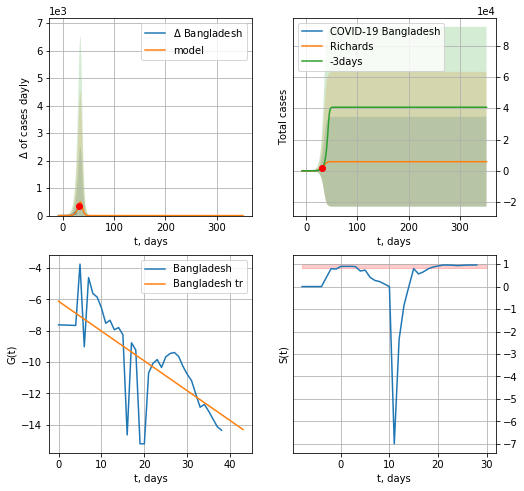

Bangladesh data at: 2020-08-02
+3 day model MAPE: 0.079004
model: Richards
coeffs: [5.83662075e+03 2.41285864e-01 3.62036516e+01 1.74331712e+00]
rational stdev: 4.915459
forecast at the end of period: +321 days
	 deltaDaycases: 0
	 total cases: 5836 ± 28689
	 total death: 76 ± 1120
trend coefficient of determination: 0.544590
 intercept: -6.123432
 slope: -0.190441


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


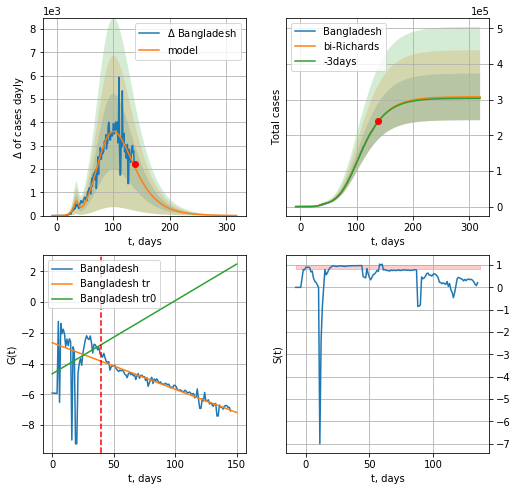

Bangladesh data at: 2020-08-02
+3 day model MAPE: 0.002862
model: bi-Richards
coeffs: [3.02229173e+05 1.84017397e-01 5.46935466e+01 1.93287895e-01]
rational stdev: 0.212558
forecast at the end of period: +181 days
	 deltaDaycases: 4
	 total cases: 307936 ± 65454
	 total death: 4034 ± 2572
bi-Richards approximation splitting point: 40
trend coefficient of determination: 0.073153
 intercept: -4.664660
 slope: 0.047613
trend coefficient of determination: 0.946717
 intercept: -2.640684
 slope: -0.030294


In [4325]:
vL=40
x = forecastRR('Bangladesh',dfBN[:vL],d1,64*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Bangladesh',dfBN[:-1],d1,44*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
#x = forecastQR('Bangladesh',dfBN[:],d1,16*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

KW
           date    cases  active  death
156 2020-07-29  65903.0    8992  444.0
157 2020-07-30  66529.0    8754  445.0
158 2020-07-31  66957.0    8578  447.0
159 2020-08-01  67448.0    8470  453.0
160 2020-08-02  67911.0    8241  457.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


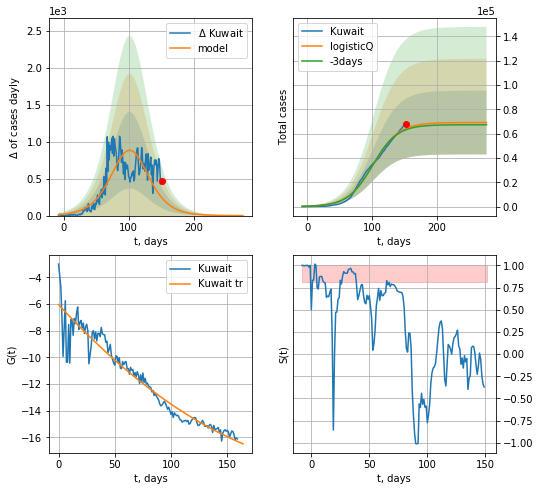

Kuwait data at: 2020-08-02
+3 day model MAPE: 0.017378
model: logisticQ
coeffs: [ 6.91136049e+04  2.13584141e-07  1.01971788e+02 -2.39206365e+05]
rational stdev: 0.379099
forecast at the end of period: +125 days
	 deltaDaycases: 0
	 total cases: 69104 ± 26197
	 total death: 465 ± 528
trend coefficient of determination: 0.927516
 intercept_: -6.040145011688943
 coeffs_: [ 0.         -0.09180995  0.00017166]


In [4326]:
dfKW = read_df(pd.DataFrame(),"KW")
x = forecastRRR('Kuwait',dfKW[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

In [ ]:
iL= 16
vL = 90 + iL
x = forecastRR('Kuwait',dfKW[iL:vL-iL],d1,37*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Kuwait',dfKW[iL:],d1,27*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-iL)

DM
           date    cases  active   death
149 2020-07-28  64690.0   31575  1101.0
150 2020-07-29  66182.0   31112  1123.0
151 2020-07-30  67915.0   31467  1146.0
152 2020-07-31  69649.0   32019  1160.0
153 2020-08-01  71415.0   32736  1170.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:156: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


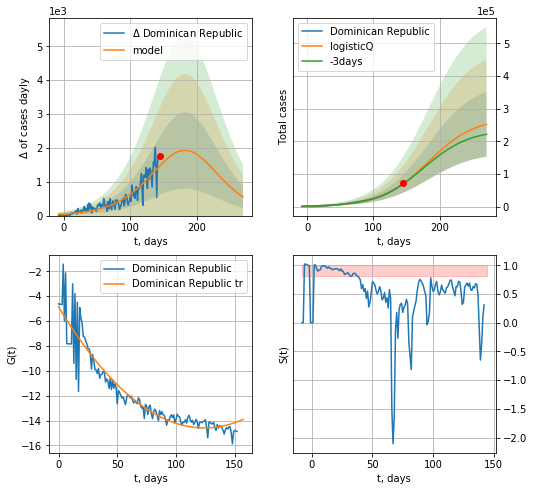

Dominican Republic data at: 2020-08-01
+3 day model MAPE: 0.012142
model: logisticQ
coeffs: [ 2.72881120e+05  1.08311204e-06  1.82654674e+02 -2.58665026e+04]
rational stdev: 0.393811
forecast at the end of period: +126 days
	 deltaDaycases: 549
	 total cases: 252200 ± 99319
	 total death: 4131 ± 4880
trend coefficient of determination: 0.889757
 intercept_: -4.867351006952722
 coeffs_: [ 0.         -0.15670556  0.00063095]


In [3948]:
dfDM = read_df(pd.DataFrame(),"DM")
x = forecastRRR('Dominican Republic',dfDM[:],d1,36*7-dT,1.0,addpred=False,xcoef=koreaCoeffs)

/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


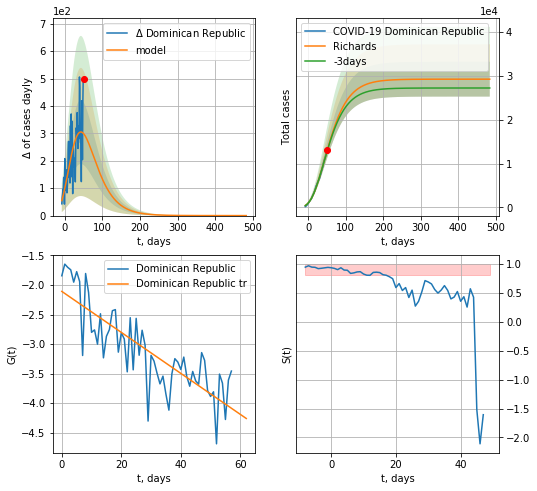

Dominican Republic data at: 2020-08-01
+3 day model MAPE: 0.011985
model: Richards
coeffs: [ 2.92636962e+04  1.52410692e+00 -9.56887865e+01  1.87798018e-02]
rational stdev: 0.135750
forecast at the end of period: +434 days
	 deltaDaycases: 0
	 total cases: 29263 ± 3972
	 total death: 479 ± 195
trend coefficient of determination: 0.671301
 intercept: -2.108314
 slope: -0.034707


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


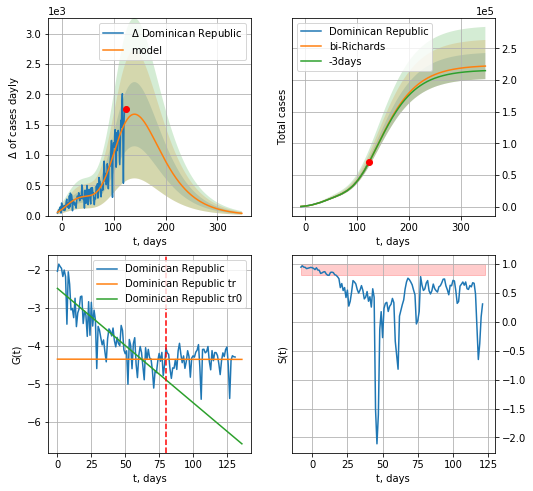

Dominican Republic data at: 2020-08-01
+3 day model MAPE: 0.001359
model: bi-Richards
coeffs: [1.94424687e+05 4.41778629e-01 1.62270460e+01 5.28325547e-02]
rational stdev: 0.092852
forecast at the end of period: +224 days
	 deltaDaycases: 37
	 total cases: 222095 ± 20622
	 total death: 3638 ± 1013
bi-Richards approximation splitting point: 80
trend coefficient of determination: 0.747251
 intercept: -2.481397
 slope: -0.030118
trend coefficient of determination: 0.000005
 intercept: -4.346193
 slope: -0.000047


In [3949]:
vL = 80+21
x = forecastRR('Dominican Republic',dfDM[21:vL-21],d1,80*7-dT,1.0,addpred=False,xcoef=RkoreaCoeffs)
xx = forecast2RR('Dominican Republic',dfDM[21:],d1,50*7-dT,x,1.0,addpred=False,xcoef=RkoreaCoeffs,vL=vL-21)

MD
           date    cases  active  death
143 2020-07-28  23521.0    6306  753.0
144 2020-07-29  23947.0    6145  762.0
145 2020-07-30  24343.0    6532  771.0
146 2020-07-31  24733.0    6686  778.0
147 2020-08-01  25113.0    6508  789.0


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:18: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


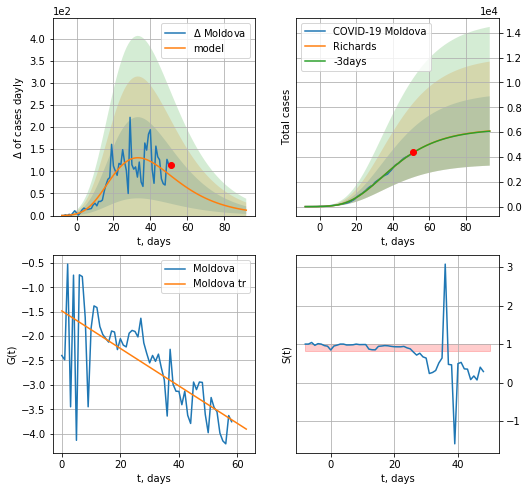

Moldova data at: 2020-08-01
+3 day model MAPE: 0.000798
model: Richards
coeffs: [ 6.30547519e+03  3.98861804e+00 -4.11482156e+01  1.42375767e-02]
rational stdev: 0.458356
forecast at the end of period: +42 days
	 deltaDaycases: 12
	 total cases: 6091 ± 2792
	 total death: 191 ± 262
trend coefficient of determination: 0.512178
 intercept: -1.485670
 slope: -0.038427


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide
/usr/local/lib/python3.7/site-packages/scipy/optimize/minpack.py:449: RuntimeWarning: Number of calls to function has reached maxfev = 1000.
  warnings.warn(errors[info][0], RuntimeWarning)


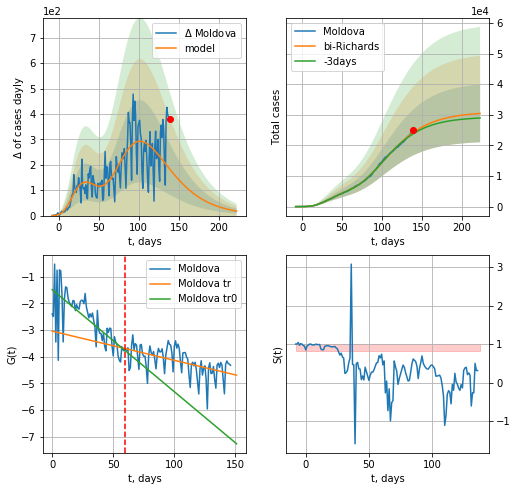

Moldova data at: 2020-08-01
+3 day model MAPE: 0.017073
model: bi-Richards
coeffs: [ 2.46796441e+04  2.48890056e+00 -3.46565852e+01  1.27070843e-02]
rational stdev: 0.309511
forecast at the end of period: +84 days
	 deltaDaycases: 17
	 total cases: 30429 ± 9418
	 total death: 956 ± 887
bi-Richards approximation splitting point: 60
trend coefficient of determination: 0.522836
 intercept: -1.480644
 slope: -0.038311
trend coefficient of determination: 0.288954
 intercept: -3.040626
 slope: -0.010924


In [3950]:
dfMD = read_df(pd.DataFrame(),"MD")
dfMD = dfMD.fillna(0)
try:
    vL = 60
    x = forecastRR("Moldova",dfMD[:vL],d1,24*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Moldova",dfMD[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [3951]:
#np.diff(dfAF["cases"])

AF
           date     cases  active   death
145 2020-07-28  459761.0  165191  7257.0
146 2020-07-29  471123.0  165659  7497.0
147 2020-07-30  482169.0  164756  7812.0
148 2020-07-31  493183.0  159007  8005.0
149 2020-08-01  503290.0  152676  8153.0


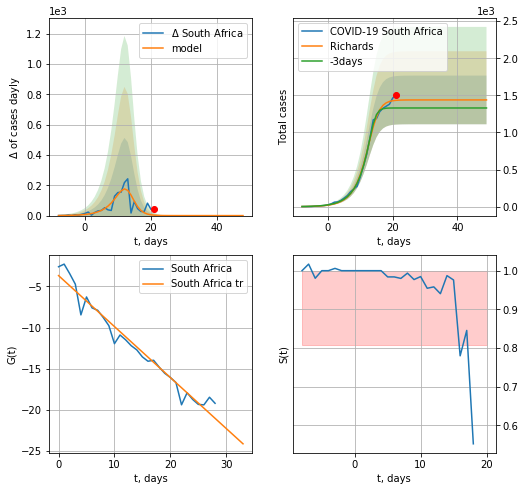

South Africa data at: 2020-08-01
+3 day model MAPE: 0.079443
model: Richards
coeffs: [1.43832006e+03 3.09188711e-01 1.37785511e+01 2.13840843e+00]
rational stdev: 0.227967
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1438 ± 327
	 total death: 23 ± 15
trend coefficient of determination: 0.961533
 intercept: -3.675972
 slope: -0.619731


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


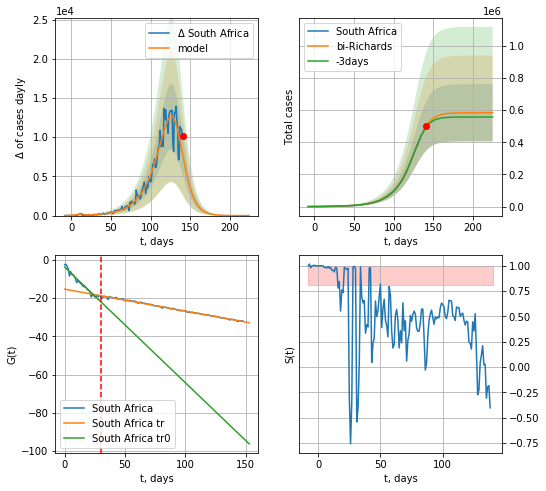

South Africa data at: 2020-08-01
+3 day model MAPE: 0.013941
model: bi-Richards
coeffs: [5.82296510e+05 5.43585737e-02 1.33138932e+02 2.14733876e+00]
rational stdev: 0.304918
forecast at the end of period: +84 days
	 deltaDaycases: 0
	 total cases: 583728 ± 177989
	 total death: 9456 ± 8649
bi-Richards approximation splitting point: 30
trend coefficient of determination: 0.954714
 intercept: -3.862698
 slope: -0.603201
trend coefficient of determination: 0.995760
 intercept: -15.382110
 slope: -0.114452


In [3952]:
dfAF = read_df(pd.DataFrame(),"AF").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 30
    x = forecastRR("South Africa",dfAF[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("South Africa",dfAF[:],d1,30*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

UB
           date  cases  active  death
135 2020-07-28  22169    9777  127.0
136 2020-07-29  22872    9803  132.0
137 2020-07-30  23558    9741  137.0
138 2020-07-31  24009    9404  141.0
139 2020-08-01  25040    9592  149.0


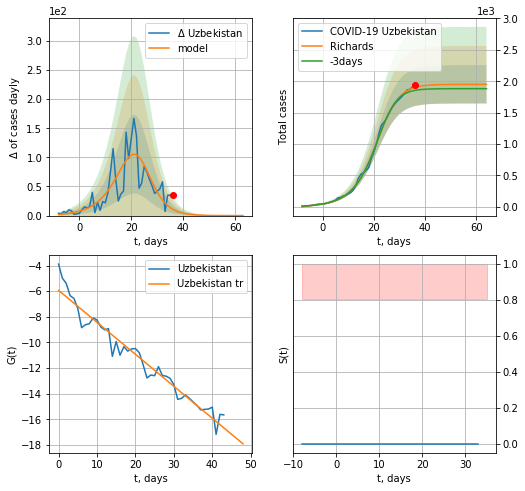

Uzbekistan data at: 2020-08-01
+3 day model MAPE: 0.027380
model: Richards
coeffs: [1.95086939e+03 1.63729535e-01 2.32758397e+01 1.53766466e+00]
rational stdev: 0.156222
forecast at the end of period: +28 days
	 deltaDaycases: 0
	 total cases: 1950 ± 304
	 total death: 11 ± 5
trend coefficient of determination: 0.953191
 intercept: -5.936816
 slope: -0.249439


/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: overflow encountered in exp
/usr/local/lib/python3.7/site-packages/ipykernel_launcher.py:151: RuntimeWarning: divide by zero encountered in true_divide


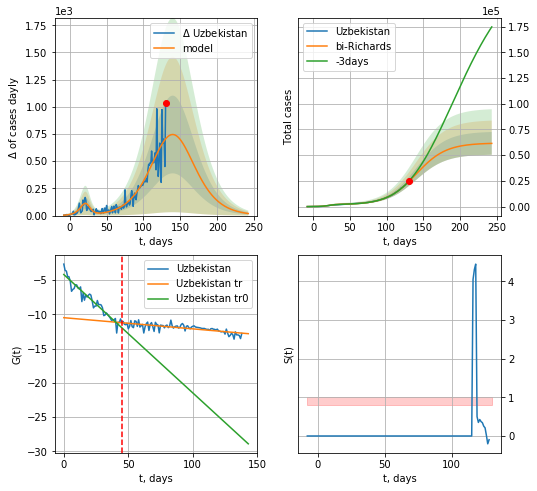

Uzbekistan data at: 2020-08-01
+3 day model MAPE: 0.019017
model: bi-Richards
coeffs: [5.98632659e+04 5.17330385e-02 1.38938473e+02 9.47972040e-01]
rational stdev: 0.180127
forecast at the end of period: +112 days
	 deltaDaycases: 19
	 total cases: 61432 ± 11065
	 total death: 365 ± 197
bi-Richards approximation splitting point: 45
trend coefficient of determination: 0.924465
 intercept: -4.183629
 slope: -0.172836
trend coefficient of determination: 0.560526
 intercept: -10.484814
 slope: -0.016331


In [3953]:
dfUB = read_df(pd.DataFrame(),"UB").fillna(0)
#dfAF = dfAF.fillna(0)
try:
    vL = 45
    x = forecastRR("Uzbekistan",dfUB[:vL],d1,T18*7-dT,addpred=False,xcoef=RkoreaCoeffs)
    xx = forecast2RR("Uzbekistan",dfUB[:],d1,34*7-dT,x,addpred=False,xcoef=RkoreaCoeffs,vL=vL)
except:
    print("Exception occurs")

In [ ]:
cD = {
    "Romania": ["RM",5,4*7],
    #"Finland":"FI",
    "India":["ID",5,6*7],
    "Ecuador":["ED",5,4*7],
    "Philippines":["PH",5,4*7],
    #"Pakistan":"PK",
#    "Luxembourg":"LX",
#    "Saudi Arabia":["SA",5,4*7],
    "Thailand":["TH",5,4*7],
    "Indonesia":["IE",5,16*7],
    "Mexico":["MX",5,8*7],
    "Panama":["PM",12,12*7],
    "Peru":["PU",5,4*7],
    "Serbia":["SB",5,4*7],
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":["UAE",5,8*7],
    "Argentina":["AG",5,8*7],
    "Iceland":["IC",5,4*7],
    "Colombia":["CB",10,16*7],
    "Qatar":["QR",5,6*7],
    "Algeria":["AR",5,16*7],
    "Croatia":["CT",0,12*7],
    "Egypt":["EG",5,4*7],
    "Slovenia":["SV",12,6*7],
    "Morocco":["MR",5,4*7],
    "Iraq":["IQ",2,8*7]
#    "Hong Kong":"HK"
}

dfArray = [dfRM,dfID,dfED,dfPH,dfTH,dfIE,dfMX,dfPM,dfPU,dfSB,dfAG,dfIC,dfCB,dfQR,dfAG,dfCT,dfEG,dfSV,dfMR,dfIQ]
for c,adf in zip(cD,dfArray):
    if c in ["Qatar","Peru","Argentina","Iraq","India","Philippines","Indonesia","Finland","Luxembourg","Ecuador","Thailand","Morocco","Romania","Iceland","Panama","Colombia","Mexico","Algeria", "Croatia","Slovenia","Egypt","Serbia"]:
        continue
    print (c)
    idS = cD[c][1]
    ipd = cD[c][2]
    x = forecast(c,adf[idS:],d1,ipd-dT)
    #xx = forecast2(c,adf[:],d1,ipd-dT,x)

In [3960]:
import requests
import lxml.html as lh
#url='https://www.worldometers.info/coronavirus/#countries'#Create a handle, page, to handle the contents of the website
url='https://www.worldometers.info/coronavirus/#nav-today'
page = requests.get(url)#Store the contents of the website under doc
doc = lh.fromstring(page.content)#Parse data that are stored between <tr>..</tr> of HTML
tr_elements = doc.xpath('//tr')
#Check the length of the first 12 rows
print ([len(T) for T in tr_elements[:12]])
tr_elements = doc.xpath('//tr')#Create empty list
col=[]
i=0#For each row, store each first element (header) and an empty list
for t in tr_elements[0]:
    i+=1
    name=t.text_content()
    print ('%d:"%s"'%(i,name))
    col.append((name,[]))
    
#Since out first row is the header, data is stored on the second row onwards
for j in range(1,len(tr_elements)):
    #T is our j'th row
    T=tr_elements[j]
    #print (len(T))
    #If row is not of size 10, the //tr data is not from our table 
    if len(T)!=19:
        break
    
    #i is the index of our column
    i=0
    
    #Iterate through each element of the row
    for t in T.iterchildren():
        data=t.text_content() 
        #Check if row is empty
        if i>0:
        #Convert any numerical value to integers
            try:
                data=int(data)
            except:
                pass
        #Append the data to the empty list of the i'th column
        col[i][1].append(data)
        #Increment i for the next column
        i+=1
    
print ([len(C) for (title,C) in col])
Dict={title:column for (title,column) in col}
df=pd.DataFrame(Dict)

[19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19, 19]
1:"#"
2:"Country,Other"
3:"TotalCases"
4:"NewCases"
5:"TotalDeaths"
6:"NewDeaths"
7:"TotalRecovered"
8:"NewRecovered"
9:"ActiveCases"
10:"Serious,Critical"
11:"Tot Cases/1M pop"
12:"Deaths/1M pop"
13:"TotalTests"
14:"Tests/
1M pop
"
15:"Population"
16:"Continent"
17:"1 Caseevery X ppl"
18:"1 Deathevery X ppl"
19:"1 Testevery X ppl"
[695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695, 695]


In [3961]:
df.head(10)
#df.columns[18]

,#,"Country,Other",TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,"Serious,Critical",Tot Cases/1M pop,Deaths/1M pop,TotalTests,Tests/\n1M pop\n,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,657,552","+5,378","222,196",295,"2,919,610","+4,662","2,515,746","26,013",,,,,,North America,\n,,
1,,\nSouth America\n,"4,245,834","+1,360","146,906",89,"2,851,587",188,"1,247,341","14,300",,,,,,South America,\n,,
2,,\nAsia\n,"4,461,248","+11,400","99,514",190,"3,303,627","+7,246","1,058,107","19,086",,,,,,Asia,\n,,
3,,\nEurope\n,"2,905,361","+6,864","203,887",93,"1,752,553","+4,098","948,921","5,139",,,,,,Europe,\n,,
4,,\nAfrica\n,"961,453",65,"20,350",,"615,476",132,"325,627","1,150",,,,,,Africa,\n,,
5,,\nOceania\n,"20,106",397,246,13,"12,276",202,"7,584",43,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"18,252,275","+25,464","693,114",680,"11,455,780","+16,528","6,103,381","65,735","2,342",88.9,,,,All,\n,,
8,1,USA,"4,813,647",,"158,365",,"2,380,217",,"2,275,065","18,623","14,535",478,"59,935,508","180,977","331,176,957",North America,69,"2,091",6
9,2,Brazil,"2,733,677",,"94,130",,"1,884,051",,"755,496","8,318","12,853",443,"13,096,132","61,573","212,694,204",South America,78,"2,260",16


In [3962]:
#df.rename(columns={"Country,Other":"Country",df.columns[9]:"TotDeathsper1Mpop"})
df=df.rename(columns={"Country,Other":"Country",'Deaths/1M pop':"Deathsper1Mpop","Serious,Critical":"Serious_Critical",'Tests/\n1M pop\n':"Testsper1Mpop",'Tot\xa0Cases/1M pop':"TotCasesper1Mpop"})
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,657,552","+5,378","222,196",295,"2,919,610","+4,662","2,515,746","26,013",,,,,,North America,\n,,
1,,\nSouth America\n,"4,245,834","+1,360","146,906",89,"2,851,587",188,"1,247,341","14,300",,,,,,South America,\n,,
2,,\nAsia\n,"4,461,248","+11,400","99,514",190,"3,303,627","+7,246","1,058,107","19,086",,,,,,Asia,\n,,
3,,\nEurope\n,"2,905,361","+6,864","203,887",93,"1,752,553","+4,098","948,921","5,139",,,,,,Europe,\n,,
4,,\nAfrica\n,"961,453",65,"20,350",,"615,476",132,"325,627","1,150",,,,,,Africa,\n,,


In [3963]:
df[df["Country"]=="Lithuania"]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
130,123,Lithuania,"2,120",10,80,,"1,645",1,395,6,780,29,"527,729","194,123","2,718,533",Europe,"1,282","33,982",5
363,124,Lithuania,"2,110",17,80,,"1,644",,386,6,776,29,"526,339","193,611","2,718,533",Europe,"1,288","33,982",5
595,124,Lithuania,"2,093",18,80,,"1,644",,369,6,770,29,"524,483","192,929","2,718,533",Europe,"1,299","33,982",5


In [3964]:
totIdx = np.where(df['ActiveCases']=='ActiveCases')[0][0]
print(totIdx)

231


In [3965]:
df.head(48)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,"5,657,552","+5,378","222,196",295,"2,919,610","+4,662","2,515,746","26,013",,,,,,North America,\n,,
1,,\nSouth America\n,"4,245,834","+1,360","146,906",89,"2,851,587",188,"1,247,341","14,300",,,,,,South America,\n,,
2,,\nAsia\n,"4,461,248","+11,400","99,514",190,"3,303,627","+7,246","1,058,107","19,086",,,,,,Asia,\n,,
3,,\nEurope\n,"2,905,361","+6,864","203,887",93,"1,752,553","+4,098","948,921","5,139",,,,,,Europe,\n,,
4,,\nAfrica\n,"961,453",65,"20,350",,"615,476",132,"325,627","1,150",,,,,,Africa,\n,,
5,,\nOceania\n,"20,106",397,246,13,"12,276",202,"7,584",43,,,,,,Australia/Oceania,\n,,
6,,\n\n,721,,15,,651,,55,4,,,,,,,\n,,
7,,World,"18,252,275","+25,464","693,114",680,"11,455,780","+16,528","6,103,381","65,735","2,342",88.9,,,,All,\n,,
8,1,USA,"4,813,647",,"158,365",,"2,380,217",,"2,275,065","18,623","14,535",478,"59,935,508","180,977","331,176,957",North America,69,"2,091",6
9,2,Brazil,"2,733,677",,"94,130",,"1,884,051",,"755,496","8,318","12,853",443,"13,096,132","61,573","212,694,204",South America,78,"2,260",16


In [3966]:
df.at[19, 'TotalRecovered'] = 0
df.at[16, 'TotalRecovered'] = 0
df.at[36, 'TotalRecovered'] = 0
df.at[47, 'TotalRecovered'] = 0
df.at[19,"ActiveCases"] = 0
df.at[16,"ActiveCases"] = 0
df.at[36,"ActiveCases"] = 0
df.at[47,"ActiveCases"] = 0
#df.at[12, 'TotalRecovered'] = 0
df = df.fillna(0)

In [3967]:
import lxml
def sanitize(data):
    #print (type(data))
    if type(data) == lxml.etree._ElementUnicodeResult:
        data=str(data).strip()
    if str(data).find(',') != -1:
        data = data.replace(',','')
    #print(str(data).find(',') != -1)
    return data
df=df[df.index<totIdx-1]
df["ActiveCases"] = pd.to_numeric(df["ActiveCases"].apply(sanitize))
df["Deathsper1Mpop"] = pd.to_numeric(df["Deathsper1Mpop"].apply(sanitize))
df["NewCases"] = pd.to_numeric(df["NewCases"].apply(sanitize))
df["NewDeaths"] = pd.to_numeric(df["NewDeaths"].apply(sanitize))
df["Serious_Critical"] = pd.to_numeric(df["Serious_Critical"].apply(sanitize))
df["TotalCases"] = pd.to_numeric(df["TotalCases"].apply(sanitize))
df["TotalDeaths"] = pd.to_numeric(df["TotalDeaths"].apply(sanitize))
df["TotalRecovered"] = pd.to_numeric(df["TotalRecovered"].apply(sanitize))
df["TotCasesper1Mpop"] = pd.to_numeric(df["TotCasesper1Mpop"].apply(sanitize))
df["TotalTests"] = pd.to_numeric(df["TotalTests"].apply(sanitize))
df["Testsper1Mpop"] = pd.to_numeric(df["Testsper1Mpop"].apply(sanitize))
df.head(15)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,\nNorth America\n,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,\nSouth America\n,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,\nAsia\n,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,\nEurope\n,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,\nAfrica\n,961453,65.0,20350.0,NaN,615476.0,132,325627,1150.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,\nOceania\n,20106,397.0,246.0,13.0,12276.0,202,7584,43.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
6,,\n\n,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,\n,,
7,,World,18252275,25464.0,693114.0,680.0,11455780.0,"+16,528",6103381,65735.0,2342.0,88.9,NaN,NaN,,All,\n,,
8,1,USA,4813647,NaN,158365.0,NaN,2380217.0,,2275065,18623.0,14535.0,478.0,59935508.0,180977.0,"331,176,957",North America,69,"2,091",6
9,2,Brazil,2733677,NaN,94130.0,NaN,1884051.0,,755496,8318.0,12853.0,443.0,13096132.0,61573.0,"212,694,204",South America,78,"2,260",16


In [3968]:
cLst = countriesEU
ActiveCasesEU = sum([ w for w in df[df['Country'].isin(cLst)].ActiveCases if w>0])
CountryEU = "European Union" 
Deathsper1MpopEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])/445.250514
NewCasesEU = sum([w for w in df[df['Country'].isin(cLst)].NewCases if w>0 ])
NewDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].NewDeaths if w>0])
Serious_CriticalEU = sum([w for w in df[df['Country'].isin(cLst)].Serious_Critical if w>0])
Testsper1MpopEU = sum([ w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])/445.250514
TotalCasesEu = sum([w for w in df[df['Country'].isin(cLst)].TotalCases if w>0])
TotalDeathsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalDeaths if w>0])
TotalRecoveredEU = sum([w for w in df[df['Country'].isin(cLst)].TotalRecovered if w>0] )
TotalTestsEU = sum([w for w in df[df['Country'].isin(cLst)].TotalTests if w>0])
TotCasesper1MpopEU = TotalCasesEu/445.250514

rowEU = {"ActiveCases":ActiveCasesEU,"Continent":"Europe","Country": CountryEU,"Deathsper1Mpop": Deathsper1MpopEU,"NewCases": NewCasesEU,"NewDeaths": NewDeathsEU,"Serious_Critical": Serious_CriticalEU,"Testsper1Mpop": Testsper1MpopEU,"TotalCases": TotalCasesEu,"TotalDeaths": TotalDeathsEU,"TotalRecovered": TotalRecoveredEU,"TotalTests": TotalTestsEU,"TotCasesper1Mpop": TotCasesper1MpopEU }
df = df.append(rowEU, ignore_index=True)
df.tail()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
226,,Total:,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,,Europe,,,
227,,Total:,961453,65.0,20350.0,NaN,615476.0,,325627,1150.0,NaN,NaN,NaN,NaN,,Africa,,,
228,,Total:,20106,397.0,246.0,13.0,12276.0,202,7584,43.0,NaN,NaN,NaN,NaN,,Australia/Oceania,,,
229,,Total:,721,NaN,15.0,NaN,651.0,,55,4.0,NaN,NaN,NaN,NaN,,,,,
230,NaN,European Union,1470739,480.0,136329.0,0.0,696586.0,NaN,207039,2072.0,3303.171931,306.184936,40829983.0,91701.147368,NaN,Europe,NaN,NaN,NaN


In [3969]:
#df['Reported1st case'] = df['Reported1st case'].map(lambda x: x.lstrip('\n'))
df["Country"] = df["Country"].str.strip('\n')
df.head()

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,961453,65.0,20350.0,NaN,615476.0,132,325627,1150.0,NaN,NaN,NaN,NaN,,Africa,\n,,


In [3970]:
#totIdx0 = np.where(df['Country']=='Total:')[0][0]
#df.at[totIdx0,'Country'] = 'World'

In [3971]:
#df

In [3972]:
#df[df['Country'].isnull()]
#df['Country']=df['Country'].dropna()
##for idx in df['Country'].isnull():
##    #print(idx)
##    if idx == True:
##        ind = df[df['Country'].isnull()].index[0]
##        df = df.drop(df.index[ind])
df = df.drop(df.index[6])
df.head(10)

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
0,,North America,5657552,5378.0,222196.0,295.0,2919610.0,"+4,662",2515746,26013.0,NaN,NaN,NaN,NaN,,North America,\n,,
1,,South America,4245834,1360.0,146906.0,89.0,2851587.0,188,1247341,14300.0,NaN,NaN,NaN,NaN,,South America,\n,,
2,,Asia,4461248,11400.0,99514.0,190.0,3303627.0,"+7,246",1058107,19086.0,NaN,NaN,NaN,NaN,,Asia,\n,,
3,,Europe,2905361,6864.0,203887.0,93.0,1752553.0,"+4,098",948921,5139.0,NaN,NaN,NaN,NaN,,Europe,\n,,
4,,Africa,961453,65.0,20350.0,NaN,615476.0,132,325627,1150.0,NaN,NaN,NaN,NaN,,Africa,\n,,
5,,Oceania,20106,397.0,246.0,13.0,12276.0,202,7584,43.0,NaN,NaN,NaN,NaN,,Australia/Oceania,\n,,
7,,World,18252275,25464.0,693114.0,680.0,11455780.0,"+16,528",6103381,65735.0,2342.0,88.9,NaN,NaN,,All,\n,,
8,1,USA,4813647,NaN,158365.0,NaN,2380217.0,,2275065,18623.0,14535.0,478.0,59935508.0,180977.0,"331,176,957",North America,69,"2,091",6
9,2,Brazil,2733677,NaN,94130.0,NaN,1884051.0,,755496,8318.0,12853.0,443.0,13096132.0,61573.0,"212,694,204",South America,78,"2,260",16
10,3,India,1808128,3426.0,38201.0,40.0,1188650.0,"+1,422",581277,8944.0,1309.0,28.0,20202858.0,14627.0,"1,381,196,835",Asia,764,"36,156",68


In [3973]:
df.to_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)), index=False)

In [3974]:
countryDic = {
  "USA": "US",
"Italy":"IT",
"Spain":"SP",
"Germany":"GR",
"France":"FR",
"Iran":"IN",
"UK":"GB",
"Switzerland":"SZ",
"S. Korea":"KR",
"Norway":"NG",
"Sweden":"SW",
"Israel":"IS",
"Denmark":"DK",
"Poland":"PL",
"Estonia":"ES",
"Ukraine":"Ukr",
"Latvia":"LV",
    "Lithuania":"LT",
    "China":"CN",
    "USA":"US",
    "Russia":"RS",
    "Japan":"JP",
    "Netherlands":"NL",
    "Belgium":"BG",
    "Singapore":"SG",
    "Austria":"AT",
    "Turkey":"TR",
    "Canada":"CA",
    "Portugal":"PT",
    "World":"World",
    "Australia":"AS",
    "Brazil":"BZ",
    "Malaysia":"ML",
    "New Zealand":"ZL",
    "Belarus":"BR",
    "Ireland":"IR",
    "Chile":"CL",
    "Czechia":"CH",
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
#    "Pakistan":"PK",
    "Luxembourg":"LX",
    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
    "South Africa":"AF",
    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "European Union":"EU",
    "Bulgaria":"BL",
    "Hungary":"HG",
    "Malta":"MT",
    "Slovakia":"SL",
    "Cyprus":"CP",
    "Greece":"GC",
    "Dominican Republic":"DM",
    "Kuwait":"KW",
    "Bangladesh":"BN",
    "Sri Lanka":"Sri",
    "Pakistan":"PS",
    "Moldova":"MD",
    "Uzbekistan":"UB"
#    "Hong Kong":"HK"
}
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)

for c in countryDic:
    print (c,countryDic[c])

USA US
Italy IT
Spain SP
Germany GR
France FR
Iran IN
UK GB
Switzerland SZ
S. Korea KR
Norway NG
Sweden SW
Israel IS
Denmark DK
Poland PL
Estonia ES
Ukraine Ukr
Latvia LV
Lithuania LT
China CN
Russia RS
Japan JP
Netherlands NL
Belgium BG
Singapore SG
Austria AT
Turkey TR
Canada CA
Portugal PT
World World
Australia AS
Brazil BZ
Malaysia ML
New Zealand ZL
Belarus BR
Ireland IR
Chile CL
Czechia CH
Romania RM
Finland FI
India ID
Ecuador ED
Philippines PH
Luxembourg LX
Saudi Arabia SA
Thailand TH
Indonesia IE
Mexico MX
Panama PM
Peru PU
Serbia SB
South Africa AF
UAE UAE
Argentina AG
Iceland IC
Colombia CB
Qatar QR
Algeria AR
Croatia CT
Egypt EG
Slovenia SV
Morocco MR
Iraq IQ
European Union EU
Bulgaria BL
Hungary HG
Malta MT
Slovakia SL
Cyprus CP
Greece GC
Dominican Republic DM
Kuwait KW
Bangladesh BN
Sri Lanka Sri
Pakistan PS
Moldova MD
Uzbekistan UB


In [3975]:
len(countryDic)

76

In [3976]:
df = pd.read_csv('data/coronaAll_%s.csv'%(date.today()- timedelta(days=1)),',')
df=df[df.TotalCases.astype(int)>0]
#df=df['TotalCases'].astype(int)
from datetime import date, timedelta
for c in df.Country: 
    print (c)
    #if c in ['North America','South America','Asia','Europe','Africa','Oceania','World']:
    #    continue
    f = open("data/tmp/corona%sOneRaw.csv"%(c),'w')
    #print ("corona%sOneRaw.csv"%(c),date.today()- timedelta(days=1),c,df[df.Country == c].TotalCases.values[0])
    print(c)
    if c!='World':
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    else:
        f.write("%s,%s,%s,%s\n"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
        print(c,"%s,%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0],df[df.Country == c].TotalDeaths.values[0]))
    f.close()

North America
North America
North America 2020-08-02,5657552,2515746,222196.0
South America
South America
South America 2020-08-02,4245834,1247341,146906.0
Asia
Asia
Asia 2020-08-02,4461248,1058107,99514.0
Europe
Europe
Europe 2020-08-02,2905361,948921,203887.0
Africa
Africa
Africa 2020-08-02,961453,325627,20350.0
Oceania
Oceania
Oceania 2020-08-02,20106,7584,246.0
World
World
World 2020-08-02,18252275,6103381,693114.0
USA
USA
USA 2020-08-02,4813647,2275065,158365.0
Brazil
Brazil
Brazil 2020-08-02,2733677,755496,94130.0
India
India
India 2020-08-02,1808128,581277,38201.0
Russia
Russia
Russia 2020-08-02,856264,188464,14207.0
South Africa
South Africa
South Africa 2020-08-02,511485,155892,8366.0
Mexico
Mexico
Mexico 2020-08-02,439046,101906,47746.0
Peru
Peru
Peru 2020-08-02,428850,115049,19614.0
Chile
Chile
Chile 2020-08-02,359731,17712,9608.0
Spain
Spain
Spain 2020-08-02,335602,0,28445.0
Colombia
Colombia
Colombia 2020-08-02,317651,139762,10650.0
Iran
Iran
Iran 2020-08-02,309437,24145,1

San Marino 2020-08-02,699,0,42.0
Réunion
Réunion
Réunion 2020-08-02,667,71,4.0
Bahamas
Bahamas
Bahamas 2020-08-02,648,543,14.0
Vietnam
Vietnam
Vietnam 2020-08-02,621,242,6.0
Channel Islands
Channel Islands
Channel Islands 2020-08-02,587,7,47.0
Tanzania
Tanzania
Tanzania 2020-08-02,509,305,21.0
Gambia
Gambia
Gambia 2020-08-02,498,421,9.0
Taiwan
Taiwan
Taiwan 2020-08-02,475,27,7.0
Guyana
Guyana
Guyana 2020-08-02,474,268,21.0
Burundi
Burundi
Burundi 2020-08-02,395,90,1.0
Comoros
Comoros
Comoros 2020-08-02,386,49,7.0
Myanmar
Myanmar
Myanmar 2020-08-02,353,49,6.0
Mauritius
Mauritius
Mauritius 2020-08-02,344,0,10.0
Isle of Man
Isle of Man
Isle of Man 2020-08-02,336,0,24.0
Mongolia
Mongolia
Mongolia 2020-08-02,293,63,nan
Eritrea
Eritrea
Eritrea 2020-08-02,279,54,nan
Martinique
Martinique
Martinique 2020-08-02,269,156,15.0
Guadeloupe
Guadeloupe
Guadeloupe 2020-08-02,265,72,14.0
Cambodia
Cambodia
Cambodia 2020-08-02,240,43,nan
Faeroe Islands
Faeroe Islands
Faeroe Islands 2020-08-02,225,33,nan
C

In [3977]:
#c='World'
#print(c,"%s,%s,%s"%(date.today()- timedelta(days=1),df[df.Country == c].TotalCases.values[0],df[df.Country == c].ActiveCases.values[0]))

In [3978]:
for c in countryDic: 
    #if c not in ['European Union']:
    #    continue
    ff = open("data/tmp/corona%sOneRaw.csv"%(c),'r')
    fff = open("data/corona%s.csv"%(countryDic[c]),'a')
    for l in ff:
        #print(c,l)
        print("append data/corona%s.csv"%(countryDic[c]),"%s"%(l))
        fff.write(l)
    ff.close()
    fff.close()

append data/coronaUS.csv 2020-08-02,4813647,2275065,158365.0

append data/coronaIT.csv 2020-08-02,248070,12456,35154.0

append data/coronaSP.csv 2020-08-02,335602,0,28445.0

append data/coronaGR.csv 2020-08-02,211462,8636,9226.0

append data/coronaFR.csv 2020-08-02,187919,76154,30265.0

append data/coronaIN.csv 2020-08-02,309437,24145,17190.0

append data/coronaGB.csv 2020-08-02,304695,0,46201.0

append data/coronaSZ.csv 2020-08-02,35550,2069,1981.0

append data/coronaKR.csv 2020-08-02,14389,808,301.0

append data/coronaNG.csv 2020-08-02,9268,261,255.0

append data/coronaSW.csv 2020-08-02,80422,0,5743.0

append data/coronaIS.csv 2020-08-02,73231,25167,541.0

append data/coronaDK.csv 2020-08-02,13789,596,615.0

append data/coronaPL.csv 2020-08-02,46894,10282,1731.0

append data/coronaES.csv 2020-08-02,2080,82,63.0

append data/coronaUkr.csv 2020-08-02,73158,31544,1738.0

append data/coronaLV.csv 2020-08-02,1246,162,32.0

append data/coronaLT.csv 2020-08-02,2120,395,80.0

append data/cor

In [2308]:
import pandas as pd
import io
import requests
url="https://opendata.ecdc.europa.eu/covid19/casedistribution/csv"
s=requests.get(url).content
#print (s)
dfc=pd.read_csv(io.StringIO(s.decode(encoding='windows-1252')))
dfc.to_csv("data/europa_corona.csv", index=False)

In [1509]:
countryDic1 = {
    "Romania": "RM",
    "Finland":"FI",
    "India":"ID",
    "Ecuador":"ED",
    "Philippines":"PH",
    "Pakistan":"PK",
    "Luxembourg":"LX",
#    "Saudi Arabia":"SA",
    "Thailand":"TH",
    "Indonesia":"IE",
    "Mexico":"MX",
    "Panama":"PM",
    "Peru":"PU",
    "Serbia":"SB",
#    "South Africa":"AF",
#    "Dominican Republic":"DR",
#    "UAE":"UAE",
    "Argentina":"AG",
    "Iceland":"IC",
    "Colombia":"CB",
    "Qatar":"QR",
    "Algeria":"AR",
    "Croatia":"CT",
    "Egypt":"EG",
    "Slovenia":"SV",
    "Morocco":"MR",
    "Iraq":"IQ",
    "Bulgaria":"BL"
#    "Hong Kong":"HK"
}
countryDic2 = {
    "Austria":"AT",
    "Italy":"IT",
    "Belgium":"BG",
    "Latvia":"LV",
    "Bulgaria":"BL",
    "Lithuania":"LT",
    "Croatia":"CT",
    "Luxembourg":"LX",
    "Cyprus":"CP",
    "Malta":"MT",
    "Czechia":"CH",
    "Netherlands":"NL",
    "Denmark":"DK",
    "Poland":"PL",
    "Estonia":"ES",
    "Portugal":"PT",
    "Finland":"FI",
    "Romania":"RM",
    "France":"FR",
    "Slovakia":"SL",
    "Germany":"GR",
    "Slovenia":"SV",
    "Greece":"GC",
    "Spain":"SP",
    "Hungary":"HG",
    "Sweden":"SW",
    "Ireland":"IR"      
}
cD3 = {"Malta":"MT","Slovakia":"SL","Greece":"GC","Hungary":"HG","Cyprus":"CP","South Africa":"SAF"}
    
for  c in cD3:#countryDic1:
    if c != "South Africa":
        continue
    dfc = pd.read_csv("europa_corona.csv",",")
    dfc = dfc[dfc['countriesAndTerritories']==c].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
    print(c,sum(dfc["cases"].values))
    dfc=dfc.rename(columns={"dateRep":"date"})
    dfc = dfc[dfc["cases"]>0]
    dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
    #dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
    dfc["cases"]=np.cumsum(dfc["cases"].values)
    dfc[['date', 'cases']].to_csv('data/corona%s.csv'%(cD3[c]), index=False)#countryDic1

FileNotFoundError: [Errno 2] File b'europa_corona.csv' does not exist: b'europa_corona.csv'

In [ ]:
#dfRM = read_df(pd.DataFrame(),"RM")

In [ ]:
dfc.head()#[['date', 'cases']]

In [ ]:
date(2012, 3, 16)

In [ ]:
len(countriesEU)

In [ ]:
dfc = pd.read_csv("europa_corona.csv",",")
cLst = ["Austria","Italy","Belgium","Latvia","Bulgaria","Lithuania","Croatia","Luxembourg","Cyprus","Malta","Czechia","Netherlands","Denmark","Poland","Estonia","Portugal","Finland","Romania","France","Slovakia","Germany","Slovenia","Greece","Spain","Hungary","Sweden","Ireland"]
dfc = dfc[dfc['countriesAndTerritories'].isin(cLst)].sort_values(['year', 'month', 'day'], ascending=[True, True, True])
print(c,sum(dfc["cases"].values))
dfc=dfc.rename(columns={"dateRep":"date"})
dfc = dfc[dfc["cases"]>0]
dfc['date'] = pd.to_datetime(dfc[['year', 'month', 'day']])
#dfc['date'] = dfc['date'].dt.strftime('%Y-%m-%d')
dfc["cases"]=np.cumsum(dfc["cases"].values)
dfc[['date', 'cases']].to_csv('/home/algiz/Desktop/corona%s.csv'%("EU"), index=False)

In [ ]:
#subsetDataFrame = dfObj[dfObj['Product'].isin(['Mangos', 'Grapes']) ]

#dfD = dfAll[dfAll['Country'].isin(cLst)].TotalTests


In [ ]:
#dfD

In [ ]:
#dfAll[dfAll['Country'].isin(cLst)]

In [3153]:
TT = sum(dfAll[dfAll.TotalTests>0].TotalTests) - dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]
print(TT,TT/7.7776e3)

335022547.0 43075.31204998971


In [3154]:
TT/7.7776e3

43075.31204998971

In [3155]:
dfAll[dfAll['Country']=='European Union'].TotalTests.values[0]/(popEU/1e6)

89918.83611840142

In [3156]:
sum(dfp.Population)/1e6

16014.157998

In [3157]:
dfAll[dfAll.TotalTests>0]

,#,Country,TotalCases,NewCases,TotalDeaths,NewDeaths,TotalRecovered,NewRecovered,ActiveCases,Serious_Critical,TotCasesper1Mpop,Deathsper1Mpop,TotalTests,Testsper1Mpop,Population,Continent,1 Caseevery X ppl,1 Deathevery X ppl,1 Testevery X ppl
7,1.0,USA,4634985,0.0,155285.0,0.0,2284965.0,0,2194735,18783.0,13996.000000,469.000000,57521144.0,173695.000000,"331,161,077",North America,71,"2,133",6
8,2.0,Brazil,2613789,0.0,91377.0,0.0,1824095.0,0,698317,8318.0,12290.000000,430.000000,12601096.0,59249.000000,"212,681,838",South America,81,"2,328",17
9,3.0,India,1643416,4066.0,35807.0,21.0,1059983.0,890,547626,8944.0,1190.000000,26.000000,18832970.0,13636.000000,"1,381,085,714",Asia,840,"38,570",73
10,4.0,Russia,834499,0.0,13802.0,0.0,629655.0,0,191042,2300.0,5718.000000,95.000000,27569646.0,188911.000000,"145,939,731",Europe,175,"10,574",5
11,5.0,South Africa,482169,0.0,7812.0,0.0,309601.0,0,164756,539.0,8122.000000,132.000000,2918049.0,49152.000000,"59,367,266",Africa,123,"7,599",20
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
217,211.0,British Virgin Islands,8,0.0,1.0,0.0,7.0,0,0,0.0,264.000000,33.000000,439.0,14514.000000,"30,247",North America,"3,781","30,247",69
218,212.0,St. Barth,7,0.0,0.0,0.0,6.0,0,1,0.0,709.000000,0.000000,1246.0,126126.000000,"9,879",North America,"1,411",0,8
220,214.0,Anguilla,3,0.0,0.0,0.0,3.0,0,0,0.0,200.000000,0.000000,380.0,25310.000000,"15,014",North America,"5,005",0,40
221,215.0,China,84292,127.0,4634.0,0.0,78974.0,17,684,6.0,59.000000,3.000000,90410000.0,62814.000000,"1,439,323,776",Asia,"17,075","310,601",16


In [3158]:
cDicEU = {
    "Austria":["AT",dfAT],
    "Italy":["IT",dfIT],
    "Belgium":["BG",dfBG],
    "Latvia":["LV",dfLV],
    "Bulgaria":["BL",dfBL],
    "Lithuania":["LT",dfLT],
    "Croatia":["CT",dfCT],
    "Luxembourg":["LX",dfLX],
    "Cyprus":["CP",dfCP],
    "Malta":["MT",dfMT],
    "Czechia":["CH",dfCH],
    "Netherlands":["NL",dfNL],
    "Denmark":["DK",dfDK],
    "Poland":["PL",dfPL],
    "Estonia":["ES",dfES],
    "Portugal":["PT",dfPT],
    "Finland":["FI",dfFI],
    "Romania":["RM",dfRM],
    "France":["FR",dfFR],
    "Slovakia":["SL",dfSL],
    "Germany":["GR",dfGR],
    "Slovenia":["SV",dfSV],
    "Greece":["GC",dfGC],
    "Spain":["SP",dfSP],
    "Hungary":["HG",dfHG],
    "Sweden":["SW",dfSW],
    "Ireland":["IR",dfIR],
}

In [3159]:
def addDataFrames(f_arg, *argv):
    dfTotal = f_arg
    for arg in argv:
        dfTotal = dfTotal.set_index('date').add(arg.set_index('date'), fill_value = 0)
        dfTotal['date'] = dfTotal.index
    return dfTotal
dfTot = cDicEU["Austria"][1]
for cD in cDicEU:
    if cD == "Austria":
        continue
    dfTot = addDataFrames(dfTot, cDicEU[cD][1])
    
dfTot.to_csv("~/Documents/coronaEU1.csv")

In [3160]:
#cDicEU["Ireland"][1]

In [3161]:
dfAll[df["Country"]=="European Union"].TotalTests.values[0]/445.250514

89918.83611840142

In [3162]:
dfAll[df["Country"]=="Total:"].TotalTests.values[0]/445

0.0

In [3163]:
#dfAll

In [3164]:
(sum(dfAll.TotalTests)-dfAll[df["Country"]=="European Union"].TotalTests.values[0])/(7.777e3-445.250514)

45694.76189001366

In [3165]:
CList = ["USA",
"Spain", "Italy", "UK", "France", "Germany", "Turkey", "Russia", "Iran", "Brazil", "Canada", "Belgium",
"Peru", "Netherlands", "India", "Switzerland", "Ecuador", "Portugal", "Saudi Arabia", "Sweden", "Ireland",
"Mexico", "Pakistan", "Singapore", "Chile", "Israel", "Austria", "Belarus", "Japan", "Qatar", "Poland",
"UAE", "Romania", "Ukraine", "South_Korea", "Indonesia", "Denmark", "Serbia", "Philippines", "Norway", "Czechia",
"Colombia", "Australia", "Malaysia", "Egypt", "Finland", "Morocco", "Argentina", "Algeria", "Moldova", 
"Luxembourg", "Thailand", "Hungary", "Greece", "Iraq", "Croatia", "Iceland", "Estonia", "Bulgaria",
"New_Zealand", "Slovenia", "Slovakia", "Lithuania", "Latvia", "Cyprus", "Malta","Bangladesh","Kuwait",
"Dominican Republic","Moldova","South Africa","China","Uzbekistan"         
]

In [3166]:
len(CList)

73

In [3167]:
popModelled = sum(dfp[dfp["Country (or dependency)"].isin(CList) ].Population)
popModelled

5610505190

In [ ]:
for CItem in CList:
    a = """
    %s
    <br />
    <img src="pictures/covidcases%s35_Q.png" alt="hi" class="inline"/><br /> 

      {%% include_relative _includes/covidcases%s35_Q.txt %%}
          <br /> 
    """%(CItem,CItem,CItem)
    print (a)

In [ ]:
R = (dfLT[:].cases.values/0.9240855762594893).astype(int)+1 -dfLT[:].active.values+dfLT[:].death.values
I = dfLT[:].active.values
S = 1700-R[:]-I
plt.plot(range(len(dfLT)),R,label="R")
plt.plot(range(len(dfLT)),I,label="I")
plt.plot(range(len(dfLT)),S,label="S")
plt.legend()
plt.grid()

In [ ]:
plt.plot(np.multiply(I,S)[1:]/1700,-np.diff(S[:]))
plt.grid()

In [ ]:
plt.plot(np.diff(R[:]),I[1:]/950)
plt.grid()

In [ ]:
plt.plot(np.diff(R[:])+np.diff(I)+np.diff(S))
plt.grid()

In [ ]:
def fS(x0,u):
    return x0*u
def fI(gamma,beta,x0,C1,u):
    return gamma*np.log(u)/beta-x0*u-C1/beta
def fR(gamma,beta,u):
    return -gamma*np.log(u)/beta
def fT(C1,gamma,x0,beta,u,u0):
    from scipy.integrate import quad
    def integrand(x, C1,gamma,x0,beta):
        return 1/(beta*x*(C1/beta-gamma*np.log(x)/beta+x0*x)) 
    return quad(integrand, u0, u, args=(C1,gamma,x0,beta),epsrel=1e-12)
vfS = np.vectorize(fS)
vfI = np.vectorize(fI)
vfR = np.vectorize(fR)
vfT = np.vectorize(fT)

In [ ]:
import scipy.optimize as optimize

T = np.linspace(.00001, 55., num=len(dfLT))
#U = np.linspace(1.0, 10*len(dfLT), num=len(dfLT))

def f(params):
    # print(params)  # <-- you'll see that params is a NumPy array
    gamma, norm = params # <-- for readability you may wish to assign names to the component variables
    C1 = -N*beta
    minT = np.min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
    sumT = np.sum((T[:]-(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm)**2)
    sumS = np.sum((S[:]-vfS(x0,U[:]))**2)
    sumI = np.sum((I[:]-vfI(gamma,beta,x0,C1,U[:]))**2)
    sumR = np.sum((R[:]-vfR(gamma,beta,U[:]))**2)
    return sumR+sumI+sumS+sumT
N = 1700
x0 = N*0.98
gamma = 4.18201705e+01
beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
norma = 55*2
initial_guess = [gamma, norma]
result = optimize.minimize(f, initial_guess)
if result.success:
    fitted_params = result.x
    print(fitted_params)
else:
    fitted_params = result.x
    print(fitted_params)
    raise ValueError(result.message)

In [ ]:
55*19

In [ ]:
N = 1700
#x0 = N*0.995
gamma =  fitted_params[0]
#beta = 0.135
C1 = -N*beta
u0 = 4.00000000e-02*0.13
norm = fitted_params[1]
U = np.logspace(u0,0.995,num=len(dfLT),dtype='float64')/10#np.linspace(u0, .995, num=len(dfLT))
minT = min(vfT(C1,gamma,x0,beta,U[:],u0)[0])
plt.plot(U[:-1],(np.diff(vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT))*norm)
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfS(x0,U[:]))
plt.plot(range(len(dfLT)),S,label="S")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfI(gamma,beta,x0,C1,U[:]))
plt.plot(range(len(dfLT)),I,label="I")
plt.grid()

In [ ]:
plt.plot((vfT(C1,gamma,x0,beta,U[:],u0)[0]-minT)*norm*1.6,vfR(gamma,beta,U[:]))
plt.plot(range(len(dfLT)),R,label="R")
plt.grid()

In [ ]:
#T = np.linspace(1.0, len(dfLT), num=len(dfLT))

In [ ]:
#u0 = [1,0.01]
#vfS(x0,u0),vfI(gamma,beta,x0,C1,u0),vfR(gamma,beta,u0)

In [ ]:
gamma/(beta*x0)*55*4

In [ ]:
np.logspace(0.1,0.9,num=9-2+1,dtype='float64')/10

In [ ]:
10**0.1

In [ ]:
np.multiply(I,S)[1:].shape

In [ ]:
np.diff(S).shape

In [ ]:
50./400